In [107]:
from sklearn.datasets import load_files
train_review = load_files('./aclImdb/train/', encoding='utf-8')
x_train, y_train = train_review.data, train_review.target
test_review = load_files('./aclImdb/test/', encoding='utf-8')
x_test, y_test = test_review.data, test_review.target
#ラベルの0,1と意味の対応の表示
print(train_review.target_names)

['neg', 'pos']


In [74]:
mini_dataset = \
  ["This movie is very good.",
  "This film is a good",
  "Very bad. Very, very bad."]

In [75]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(token_pattern=r'(?u)\b\w+\b')
bow = (vectorizer.fit_transform(mini_dataset)).toarray()
# DataFrameにまとめる
df = pd.DataFrame(bow, columns=vectorizer.get_feature_names())
display(df)

,a,bad,film,good,is,movie,this,very
0,0,0,0,1,1,1,1,1
1,1,0,1,1,1,0,1,0
2,0,2,0,0,0,0,0,3


In [76]:
vectorizer = CountVectorizer(ngram_range=(2, 2), token_pattern=r'(?u)\b\w+\b')
bow_train = (vectorizer.fit_transform(mini_dataset)).toarray()
df = pd.DataFrame(bow_train, columns=vectorizer.get_feature_names())
display(df)

,a good,bad very,film is,is a,is very,movie is,this film,this movie,very bad,very good,very very
0,0,0,0,0,1,1,0,1,0,1,0
1,1,0,1,1,0,0,1,0,0,0,0
2,0,1,0,0,0,0,0,0,2,0,1


### 【問題1】BoWのスクラッチ実装

In [99]:
q1_dataset = \
["This movie is SOOOO funny!!!",
 "What a movie! I never", 
 "best movie ever!!!!! this movie"]

In [109]:
#1-gramの場合

#データセット内の単語を抽出する。
#words: 各行の単語を格納。辞書型とする。
#words_all: 全行に渡り１回以上使用される単語を格納する。
words = {}
words_all = []
for row, sentence in enumerate(q1_dataset):
    words[row] = sentence.split(" ")
    words[row] = [w.lower().replace('!', '')  for w in words[row]]  #大文字→小文字
    #words[row] = [w.replace('!', '') for w in words[row]]  #!を削除
    words_all += words[row]

#重複を削除
words_all = list(set(words_all))

#BoW 1-gramの配列の作成
#作成する配列サイズの確認
n_rows = len(q1_dataset)
n_words_all = len(words_all)

#Pandasで作成
BoW_1g = [[0]*n_words_all]*n_rows
df_BoW_1g = pd.DataFrame(BoW_1g, columns=words_all)

#一行ごとに各単語数をカウントする。
for row in range(n_rows):
    for word in words[row]:
        df_BoW_1g.loc[row, word] += 1
        
df_BoW_1g

,best,never,ever,is,funny,soooo,this,what,i,a,movie
0,0,0,0,1,1,1,1,0,0,0,1
1,0,1,0,0,0,0,0,1,1,1,1
2,1,0,1,0,0,0,1,0,0,0,2


In [110]:
#2-gramの場合

#データセット内の単語を抽出する。
#words: 各行の単語を格納。辞書型とする。
#words_all: 全行に渡り１回以上使用される単語を格納する。
words = {}
words_all = []
for row, sentence in enumerate(q1_dataset):
    words[row] = sentence.split(" ")
    words[row] = [w.lower().replace('!', '')  for w in words[row]]  #大文字→小文字
    #words[row] = [w.replace('!', '') for w in words[row]]  #!を削除
    for w in range(len(words[row]) -1):
        words[row][w] =  words[row][w] + " " + words[row][w+1]
    #最後尾の要素を削除
    del words[row][-1]
    
    words_all += words[row]

#以下、1-gramと同処理
    
#重複を削除
words_all = list(set(words_all))

#BoW 1-gramの配列の作成
#作成する配列サイズの確認
n_rows = len(q1_dataset)
n_words_all = len(words_all)

#Pandasで作成
#BoW_2g = [[0 for i in range(n_words_all)] for j in range(n_rows)]
BoW_2g = [[0]*n_words_all]*n_rows
df_BoW_2g = pd.DataFrame(BoW_2g, columns=words_all)

#一行ごとに各単語数をカウントする。
for row in range(n_rows):
    for word in words[row]:
        df_BoW_2g.loc[row, word] += 1
        
df_BoW_2g

,movie is,i never,is soooo,soooo funny,movie ever,best movie,a movie,what a,movie i,ever this,this movie
0,1,0,1,1,0,0,0,0,0,0,1
1,0,1,0,0,0,0,1,1,1,0,0
2,0,0,0,0,1,1,0,0,0,1,1


### 【問題2】TF-IDFの計算

In [8]:
import nltk
stop_words = nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
print("stop word : {}".format(stop_words))

[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
stop word : ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 

In [14]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(norm=None, stop_words={'english'}, max_features=5000)

bow_train = (vectorizer.fit_transform(x_train)).toarray()
df = pd.DataFrame(bow, columns=vectorizer.get_feature_names())

In [15]:
df

,00,000,10,100,11,12,13,13th,14,15,...,young,younger,your,yourself,youth,zero,zizek,zombie,zombies,zone
0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,6.437303,0.0,0.000000,0.000000,0.0,5.35835,0.0,0.0,0.0,0.0
1,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,4.315427,0.0,0.00000,0.0,0.0,0.0,0.0
2,0.0,0.0,2.998676,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,0.0
3,0.0,0.0,2.998676,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,0.0
4,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,5.869176,0.0,...,0.000000,0.0,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24995,0.0,0.0,0.000000,5.127735,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,0.0
24996,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,0.0
24997,0.0,0.0,2.998676,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,0.0
24998,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,0.0


### 【問題3】TF-IDFを用いた学習

In [24]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

vectorizer = TfidfVectorizer(norm=None, stop_words={'english'}, max_features=5000, ngram_range=(1,1))
bow_train = (vectorizer.fit_transform(x_train)).toarray()
bow_test = (vectorizer.fit_transform(x_test)).toarray()

lr = LogisticRegression()
lr.fit(bow_train, y_train)
y_pred = lr.predict(bow_test)
print(f'accuracy: {accuracy_score(y_test, y_pred)}')

#Max_features=10000とすると、精度が下がった(0.49)
#ngram_range=(1,2)とすると、精度が上がった(0.53)
#ngram_range=(2,2)とすると、精度が下がった(0.527)

/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:765: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


accuracy: 0.52952


### 【問題4】TF-IDFのスクラッチ実装

In [35]:
#問題1のBoWの計算結果を用いて計算する。
import numpy as np

tf = df_BoW_1g.values / np.sum(df_BoW_1g.values, axis=1).reshape(-1,1)
idf = np.log(n_rows / np.sum(df_BoW_1g.values, axis=0).reshape(1,-1))

tfidf =  pd.DataFrame(tf * idf, columns=words_all)
tfidf

,best,never,This,is,SOOOO,What,this,funny!!!,I,movie!,ever!!!!!,a,movie
0,0.000000,0.000000,0.219722,0.219722,0.219722,0.000000,0.000000,0.219722,0.000000,0.000000,0.000000,0.000000,0.0
1,0.000000,0.219722,0.000000,0.000000,0.000000,0.219722,0.000000,0.000000,0.219722,0.219722,0.000000,0.219722,0.0
2,0.219722,0.000000,0.000000,0.000000,0.000000,0.000000,0.219722,0.000000,0.000000,0.000000,0.219722,0.000000,0.0


In [39]:
#scikit-leranの計算式の場合
tf = df_BoW_1g.values
idf = np.log((1 + n_rows) / (1 + np.sum(df_BoW_1g.values, axis=0).reshape(1,-1)))+ 1 

tfidf =  pd.DataFrame(tf * idf, columns=words_all)
tfidf

,best,never,This,is,SOOOO,What,this,funny!!!,I,movie!,ever!!!!!,a,movie
0,0.000000,0.000000,1.693147,1.693147,1.693147,0.000000,0.000000,1.693147,0.000000,0.000000,0.000000,0.000000,1.0
1,0.000000,1.693147,0.000000,0.000000,0.000000,1.693147,0.000000,0.000000,1.693147,1.693147,0.000000,1.693147,0.0
2,1.693147,0.000000,0.000000,0.000000,0.000000,0.000000,1.693147,0.000000,0.000000,0.000000,1.693147,0.000000,2.0


### Word2Vecの動作確認

In [57]:
#Genim Ver.4にて動作させるため、Diverのコードから一部書き換えている。
#https://github.com/RaRe-Technologies/gensim/wiki/Migrating-from-Gensim-3.x-to-4

from gensim.models import Word2Vec
sentences = [['this', 'movie', 'is', 'very', 'good'], ['this', 'film', 'is', 'a', 'good'], ['very', 'bad', 'very', 'very', 'bad']]
model = Word2Vec(min_count=1, vector_size=10) # 次元数を10に設定
model.build_vocab(sentences) # 準備
model.train(sentences, total_examples=model.corpus_count, epochs=model.epochs) # 学習

print("語彙の一覧 : {}".format(model.wv.key_to_index))
for vocab in model.wv.key_to_index:
  print("{}のベクトル : \n{}".format(vocab, model.wv[vocab]))

語彙の一覧 : {'very': 0, 'bad': 1, 'good': 2, 'is': 3, 'this': 4, 'a': 5, 'film': 6, 'movie': 7}
veryのベクトル : 
[-0.00536227  0.0023643   0.0510335   0.09009273 -0.0930295  -0.07116809
  0.06458871  0.08972988 -0.05015428 -0.03763373]
badのベクトル : 
[ 0.07380505 -0.01533473 -0.04536615  0.06554051 -0.0486016  -0.01816018
  0.0287658   0.00991874 -0.08285215 -0.09448819]
goodのベクトル : 
[ 0.07311766  0.05070262  0.06757693  0.00762866  0.06350889 -0.03405366
 -0.00946403  0.05768573 -0.07521639 -0.03936105]
isのベクトル : 
[-0.07511629 -0.00930048  0.09538178 -0.07319212 -0.02333784 -0.01937754
  0.08077486 -0.05930933  0.00045162 -0.04753765]
thisのベクトル : 
[-0.0960355   0.05007293 -0.08759587 -0.04391825 -0.000351   -0.00296183
 -0.0766124   0.09614742  0.04982056  0.09233143]
aのベクトル : 
[-0.08157919  0.04495797 -0.04137077  0.00824535  0.08498619 -0.04462178
  0.045175   -0.06786962 -0.03548489  0.09398508]
filmのベクトル : 
[-0.01577674  0.00321376 -0.04140681 -0.07682785 -0.01508028  0.02469826
 -0.00888039

In [58]:
model.wv.most_similar(positive="good", topn=3)

[('movie', 0.427315354347229),
 ('bad', 0.32937222719192505),
 ('very', 0.3004249632358551)]

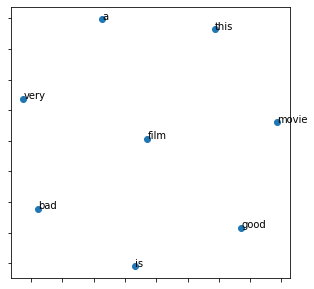

In [66]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
vocabs = model.wv.key_to_index


tsne_model = TSNE(perplexity=40, n_components=2, init="pca", n_iter=5000, random_state=23)

vectors_tsne = tsne_model.fit_transform(model.wv[vocabs])

fig, ax = plt.subplots(figsize=(5,5))
ax.scatter(vectors_tsne[:, 0], vectors_tsne[:, 1])
for i, word in enumerate(list(vocabs)):
    plt.annotate(word, xy=(vectors_tsne[i, 0], vectors_tsne[i, 1]))
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show()

### 【問題5】コーパスの前処理

In [113]:
words = {}
words_all = []
for row, sentence in enumerate(x_train):
    words[row] = sentence.split(" ")
    words[row] = [w.lower().replace('!', '').replace('.', '')  for w in words[row]]
    words_all.append(words[row])


### 【問題6】Word2Vecの学習

In [112]:
from gensim.models import Word2Vec
sentences = words_all
model = Word2Vec(min_count=1, vector_size=10) # 次元数を10に設定
model.build_vocab(sentences) # 準備
model.train(sentences, total_examples=model.corpus_count, epochs=model.epochs) # 学習

print("語彙の一覧 : {}".format(model.wv.key_to_index))
for vocab in model.wv.key_to_index:
  print("{}のベクトル : \n{}".format(vocab, model.wv[vocab]))

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



sayingのベクトル : 
[-0.5116199  -2.0701935   5.4979596  -0.9223855  -0.06116186  1.450042
  0.18807276  0.7948585  -0.6097025   0.6601951 ]
easilyのベクトル : 
[-2.9310954  -0.85280025  4.693808    2.108093    0.52632415  2.1836374
  0.9123187   0.41463104 -0.8737638  -0.56830037]
mostlyのベクトル : 
[-2.0022733   1.0722812   3.2941682   2.553616    0.92828995 -2.3284385
  1.0901831   2.2403486  -0.37437138 -2.0670106 ]
fact,のベクトル : 
[-0.9991971   1.1816062   5.4277067   1.9988774   0.58809    -0.7328073
  0.43523297 -0.57850736 -1.0919466  -1.5859942 ]
/>thereのベクトル : 
[ 1.553941   -7.9583416   1.844952    3.3042018  -4.6314154  -8.645017
  2.5381694   6.6183624  -0.22476745 -0.51920396]
davidのベクトル : 
[ 2.4877872  3.7952564 -0.916303   2.3459055  2.1265142  1.786191
  4.055373   2.522106  -3.296143   4.227602 ]
annoyingのベクトル : 
[ 0.02193787  1.016666    3.3404741   1.832306    2.9608607  -1.816645
  0.9724318   1.8385967  -0.445914   -0.40743318]
importantのベクトル : 
[-1.8714964   0.02734479  3.1720798

  1.8894197  -0.81126374 -3.2214608  -1.0530801 ]
day,のベクトル : 
[-0.3688167   0.34413937  2.1542099  -1.9307983  -0.02039657  1.058148
  2.570235   -1.4587225  -1.809689   -2.0739887 ]
soldiersのベクトル : 
[ 1.6494584   0.04763189 -0.43992162  0.72525656 -0.54385483  2.5071962
  1.6432002   1.3206016  -1.7673663  -4.610109  ]
puttingのベクトル : 
[ 1.3163298   0.39570433  1.3793505  -1.4206743   0.8323677  -0.4643496
  1.6549895  -0.7803252  -2.2211123  -3.0830417 ]
"のベクトル : 
[ 0.93588084 -1.2720393   1.2868813  -0.99952257 -0.08756166  1.3411978
  1.89274     1.0704656  -2.0067134   1.69475   ]
christopherのベクトル : 
[ 1.1397024   2.7250834  -1.3365252   2.413011    3.6984336   0.79152954
  3.0683897   3.2873168  -3.5164905   3.1132095 ]
mysteriousのベクトル : 
[ 2.638403    2.778544   -0.19283076 -0.05468606  1.7493622   0.28507033
  2.54116     1.9160471  -1.1905483  -2.7942476 ]
tasteのベクトル : 
[ 0.42861256 -1.5031775   3.3273532   0.67810076  0.35976464 -0.32314634
  1.4435933   0.05821852 -0.5181787

discoveredのベクトル : 
[-0.24138007  1.9213084   1.6459347  -1.014154    0.5352896   1.9310585
  1.0381513   0.02948094 -2.8860683  -1.1037754 ]
guy,のベクトル : 
[ 1.4398777   0.694961    1.7876829  -0.14342847  2.8453596   0.56510913
  1.6680418   1.4845872  -0.54264003 -0.08622099]
geneのベクトル : 
[ 0.86949676  2.409336   -1.0069143   1.0581273   2.308092    1.4885297
  2.8211884   2.054234   -2.7084274   0.67699534]
adamのベクトル : 
[ 0.8512854   1.0313673   0.26096955  0.74932563  0.9956589   1.9171336
  2.210295    1.4862393  -2.3275938   1.33264   ]
fan,のベクトル : 
[-1.2562983  -1.4656109   1.970959   -0.87428564  1.2807972   1.4157389
  1.694768    1.4391793  -1.5047355   3.0889115 ]
vhsのベクトル : 
[-0.86127967 -0.9731328   2.8559663  -1.8551205  -2.3735778   0.6630439
  2.342066   -2.498669   -3.6060934  -0.24957092]
fightsのベクトル : 
[ 1.467064    0.26250008  0.3283757   0.62853837  1.1335579  -0.28080207
  1.300287    1.0981967  -1.4391959  -2.8774772 ]
pilotのベクトル : 
[-0.26320857  0.8430305   1.1932

  2.0838294   1.8142692  -0.88428396 -1.9633356 ]
woodのベクトル : 
[-0.23033315 -0.12231192  0.37372568  0.6601824   0.8238679   0.79449457
  1.9470283   1.3462117  -1.3794715   0.52365106]
/>don'tのベクトル : 
[ 2.5633066 -3.257879   1.7509748 -1.8553121 -3.9620078 -2.686699
 -0.52464    2.8792005 -3.1635294  1.6202503]
episode,のベクトル : 
[-0.3456332   0.24764027  2.177204    0.3685591   0.33730885 -0.6076728
  2.1615198  -0.9929146  -2.2593777  -0.07993813]
irishのベクトル : 
[ 0.43447596  1.2068323  -0.35825786  0.87354326  0.80102676  0.45134717
  3.065015    1.8049594  -1.8803337  -0.99274814]
primeのベクトル : 
[-0.8229458   0.7765221   0.7673256  -0.46833724 -0.6013426  -0.5490637
  2.9951723   1.0548809  -1.4280639  -1.0160472 ]
frameのベクトル : 
[ 0.47414845  0.19229779  1.9143553  -0.26607516 -0.10788605 -0.86041486
  2.0208144  -0.4820552  -1.2941942  -1.7680895 ]
beginning,のベクトル : 
[ 0.71343815  0.6535852   2.6891744   0.60773814  0.5997542  -1.3490111
  1.5388964  -1.1247606  -1.3836969  -1.257036

peaceのベクトル : 
[ 1.6225448  -0.128224    0.742867   -0.45771253 -0.00787748  0.86268616
  1.3289057   1.5014975  -1.4162862  -1.8497851 ]
movementのベクトル : 
[ 0.8835935  -0.0518341   0.82371485  0.58904654  0.7715697  -0.94928426
  1.8848289   0.8316287  -1.2416074  -1.902331  ]
praiseのベクトル : 
[-0.14269471 -0.66223764  1.8308382   0.8135651   1.1586404   0.16841793
  1.0041531   0.5869701  -1.08084     0.04075964]
leagueのベクトル : 
[ 0.61071867  0.2589779   0.8864296   0.81868356  0.21528557 -0.42372867
  2.2353168   0.09116034 -1.7865838  -1.0198691 ]
sundayのベクトル : 
[ 0.3377866  -0.45301226  0.75219244 -1.5089539  -1.0740206   0.8483168
  2.9312766  -0.59191656 -2.894826   -0.29718664]
consistsのベクトル : 
[-0.6687883  -0.55631703  0.3215752  -0.5392512   0.9334025  -2.66278
  2.20022     0.50511247 -2.2497008  -1.7687871 ]
thousandsのベクトル : 
[-0.28194633 -0.61542106 -0.27891263  1.5985553  -0.86682254  1.5156142
  1.322007    0.39179462 -2.900346   -3.0542533 ]
ringsのベクトル : 
[-0.6134598   0.488

  2.1987247   1.2997459  -1.8619007  -0.66248405]
tenseのベクトル : 
[-0.11866588  0.5908552   1.1660045   0.7458732   0.76875216 -1.9636084
  1.3984559   1.187913   -1.0715146  -0.52604824]
instantlyのベクトル : 
[ 0.37240478  0.3293856   0.909419   -0.42464077  0.1841076   0.49801022
  1.5134964   1.2939066  -1.3951219  -0.76333237]
quoteのベクトル : 
[ 0.9335513  -0.92166215  1.4218763   0.18254495  0.47982818  0.7508935
  1.2465231  -0.12842478 -2.032192   -0.04198887]
entertainment,のベクトル : 
[ 0.3879087  -0.6082541   1.8500742   0.21465905 -0.16347146 -1.1433071
  0.44805142  0.922778   -1.3176122   0.05586646]
grossのベクトル : 
[ 0.5708947  -0.252702    1.400094    1.1809167   0.85641956 -1.0129972
  1.0063      0.8796993  -1.0115559  -0.95491123]
reedのベクトル : 
[ 0.77764606  1.3671087  -0.2167764   0.5704658   2.0233111   0.7429757
  2.6471603   1.6316158  -1.8497969   0.8240148 ]
innocenceのベクトル : 
[ 1.2463895   0.59709275  0.5312919   0.14905065  0.8830958   0.21061772
  1.9977752   0.72144926 -1.32

agreesのベクトル : 
[ 2.321611    0.42830145 -0.05164752 -1.6926259   1.4130372   1.3448117
  1.2651062   1.3051519  -1.6829703  -0.6622028 ]
dinosaursのベクトル : 
[ 0.3531388  -0.72022754  0.74119     0.36470106 -0.17194156  0.54206866
  0.71180886  1.2137986  -1.3492523  -1.2008033 ]
notesのベクトル : 
[ 0.5277468  -0.15895793  0.54295146 -0.21504009 -0.10431222  0.00637633
  1.6530263   0.32907593 -1.8057661  -0.47570643]
mentioned,のベクトル : 
[-0.96135116  0.04482471  0.99997526  0.72644275  0.3023619   0.45889884
  0.5476086   1.3081564  -1.5836309   0.41176102]
subjectsのベクトル : 
[ 0.35703903 -0.62386036  0.65251404  0.76383036  0.18523356  0.17719595
  0.996949    1.2054039  -0.9178038  -1.7876694 ]
improveのベクトル : 
[ 0.48770213 -1.0065362   1.6914264   0.06309485  0.7294366   0.6776232
  1.0772189  -0.37666577 -0.62104607 -1.2276133 ]
destroyingのベクトル : 
[ 0.6047518  -0.44129032  0.15548792 -0.95978427  0.49245402  0.14645255
  1.432667    0.99362046 -1.423762   -1.4658083 ]
/>maybeのベクトル : 
[ 1.419

toysのベクトル : 
[ 0.81620485  0.2350347   0.6924136   0.44700783  0.23935394  0.13521925
  1.0309759   1.0383426  -1.183654   -1.0702027 ]
charlotteのベクトル : 
[ 1.0572828   0.42529815  0.18446895  0.7153863   0.9166633   0.37856355
  1.971962    0.9870723  -1.7899973   0.34995133]
should'veのベクトル : 
[-2.125571    0.29137385  0.6366043  -0.9981564   1.4110137   0.80977505
 -0.6998153   1.1205364  -1.6868429   0.31158662]
showdownのベクトル : 
[ 0.9486397   0.2867151   0.44570813  0.3458639   0.531348   -0.7388412
  2.3711681  -0.02365597 -1.3926651  -1.0704564 ]
reflectionのベクトル : 
[ 0.75176215 -0.1264532   0.45193726  0.38220087  0.19444667 -0.5126257
  1.7162105   0.37321585 -1.0139927  -0.5281616 ]
women'sのベクトル : 
[ 0.518929    0.27088895 -0.0109454   0.29692093  0.21826482  0.51955825
  0.9743622   0.84979904 -1.5668255  -1.5393922 ]
/>itsのベクトル : 
[ 1.1370596  -1.7074705   0.8033442  -0.08397057 -0.62263966 -2.4558144
  1.1797043   0.6902378  -1.6042984   0.5482291 ]
splatterのベクトル : 
[-0.326019

steadyのベクトル : 
[ 0.37256497  0.7191518   0.5628969  -0.04185744  0.5429652  -1.06766
  1.0939897   0.89439505 -1.0740337  -0.37852395]
firmlyのベクトル : 
[ 0.68851787  0.14469479  0.61663204  0.15479927  0.03194025 -0.04250578
  1.204554    0.6842975  -1.5548058  -0.3158842 ]
confessのベクトル : 
[ 0.24124213 -0.8588416   1.1645784   0.11704404  1.0707254   1.3616611
  0.5386787  -0.04755434 -1.2509533  -0.09636185]
rangersのベクトル : 
[ 0.16724378 -0.55784667  0.4483176  -0.32765192 -0.55476975 -0.09568518
  0.63087094  1.4705691  -0.98965955 -0.8529978 ]
prestonのベクトル : 
[ 1.1310989   0.43161047  0.37509218  0.00680328  0.16137937  0.6864969
  1.5826912   0.8861298  -1.1049104  -0.47664863]
grotesqueのベクトル : 
[ 0.5296845   0.16460828  0.5460958   0.31205082  0.71465075 -0.7276523
  0.87131625  1.0532991  -1.0334264  -0.82947874]
bladeのベクトル : 
[ 0.8416546   0.0344347  -0.02248207  0.16842872 -0.08526428  0.24383543
  1.6424394   0.62181926 -1.5400553  -0.6657272 ]
pictures,のベクトル : 
[-0.32407036 -0.0

  1.2493827   0.6989316  -1.1333344  -0.6533426 ]
maidのベクトル : 
[ 1.0424908   0.43178648  0.156688   -0.16351932  0.9908583   0.5914426
  1.5710714   1.0931622  -1.1440759  -0.40713587]
(that'sのベクトル : 
[ 0.46622765 -0.35788247  0.7456314  -0.29040575  0.64603263  0.30012178
  0.53288126  0.71560556 -1.4735155  -0.21762066]
liftのベクトル : 
[ 1.0013146  -0.19530421  0.9431163  -0.40894672  0.8086589  -0.08251882
  1.1817644   0.20345703 -0.5609751  -0.8963299 ]
marlonのベクトル : 
[ 0.3647891   0.38338488  0.21461512  0.27793443  0.890528    0.4502741
  1.4292364   1.0698631  -1.1055574   0.31031504]
minorityのベクトル : 
[-0.19148777 -0.22787778  0.44546977  0.37058753  0.09574905  0.30020145
  1.0507911   0.9566935  -1.1784276  -0.5420837 ]
boyfriend,のベクトル : 
[ 0.98916334  0.12842129  0.343057   -0.55367094  0.9088074   0.83691806
  1.6805346   1.1027156  -1.4341145  -0.33543995]
pitのベクトル : 
[ 1.0441821  -0.13129242  0.43919855 -0.19501354  0.23635538  0.50225204
  1.3355359   0.2123158  -1.3877238 

tapedのベクトル : 
[-0.08811134 -0.15966761  0.79799324 -0.5853398   0.12817608  0.15751822
  0.5615048  -0.47354284 -1.8951257  -0.54580605]
accessibleのベクトル : 
[-0.05519046 -0.34256434  0.99977475 -0.00554274  0.85247153 -0.38076532
  0.56533235  0.8114263  -1.0728968  -0.11944175]
snakesのベクトル : 
[ 0.4090477  -0.40430036  0.8637279   0.17530991 -0.0343778   0.14557657
  0.7096035   0.56310683 -0.8011589  -0.8547135 ]
poleのベクトル : 
[ 0.9974615  -0.09300993  0.01054703 -0.75557864  0.03799862  0.47077966
  1.528029    0.25250337 -1.4640172  -1.03396   ]
aidedのベクトル : 
[ 0.7382325   0.5004328  -0.05295163  0.5993489   0.7410294   0.23693042
  1.8923779   1.0696778  -1.8692522  -0.46824712]
well-doneのベクトル : 
[ 0.05698871  0.00436031  0.7353824   0.72583616  0.2805897  -0.8333578
  0.73685795  1.0013812  -0.9326786  -0.06416278]
inspirationalのベクトル : 
[ 0.1936866   0.12968779  0.9726555   0.11909635  0.65144867 -0.4043308
  0.55599195  0.5876252  -0.70342785  0.18381047]
pacificのベクトル : 
[ 0.441092

  1.0470673   0.45939532 -0.8852888  -0.39181477]
depictionsのベクトル : 
[ 0.3344324  -0.40562072  0.20815656  0.60031027  0.41455224 -0.27994823
  1.1591336   0.7360208  -1.007338   -0.8587393 ]
hopkinsのベクトル : 
[ 0.6409633   0.2853099   0.24359642  0.40339023  0.6378533   0.5203665
  0.883116    0.7663443  -0.9776375   0.4066873 ]
jarringのベクトル : 
[-0.08505759 -0.16535145  0.82343644 -0.06979527  0.08356876 -0.4902209
  0.6508787   0.84071374 -0.81547105 -0.17171878]
ignoresのベクトル : 
[ 0.23885688  0.11825767  0.22827445 -0.4300572   0.9987011  -0.2706153
  0.7056864   0.7144944  -1.4411174  -0.42586097]
maintainsのベクトル : 
[ 0.11416513  0.2592722   0.35391706 -0.34381825  1.1923041  -0.73471
  0.900464    1.0766807  -1.0785974   0.17087236]
mirrorsのベクトル : 
[ 0.5789809  -0.02987416  0.1461167  -0.2156816   0.4415699  -0.52639997
  1.1133184   0.46647614 -1.0983158  -0.69287944]
zombiのベクトル : 
[-0.44893014 -0.5903637   0.7224537  -0.1599163  -0.4577137   0.13550442
  1.1776639  -0.2611678  -1.17

potterのベクトル : 
[ 0.23025629  0.14495674  0.05064414  0.02031101  0.4486067   0.04913156
  0.9993148   0.63331914 -1.2022775  -0.01261143]
stumbleのベクトル : 
[ 1.0275234  -0.10921644  0.23621127 -0.47175443  0.51844454  0.29782963
  0.34184837 -0.36252233 -1.2495979  -1.2446766 ]
stereotypes,のベクトル : 
[ 0.15481748 -0.2254043   0.20289907  0.5750946   0.44628474 -0.31101522
  0.9754631   1.0652529  -0.88847965 -0.84684014]
safelyのベクトル : 
[-0.00737412 -0.4605868   1.1020403  -0.11792184  0.13641949  0.9226597
  0.5849858   0.584374   -0.9266018  -0.23890875]
try,のベクトル : 
[ 0.13403617 -0.52847415  1.0359343  -0.28359017  0.42176217  0.1533084
  0.15231197  0.44991687 -0.8062745   0.20964788]
controlsのベクトル : 
[ 0.66088414 -0.15063691  0.05486962 -0.417215    0.438593   -0.19513904
  0.66457105  0.9711513  -1.1060883  -0.7141919 ]
egyptianのベクトル : 
[ 0.68965244 -0.02351321  0.1013031   0.25948057  0.5080493   0.04135827
  1.1053472   1.1721213  -1.1788086  -0.4257323 ]
newcomerのベクトル : 
[ 0.707358

  0.12237023  0.33817273 -1.2332504  -0.15966666]
pacing,のベクトル : 
[-0.06498722  0.07491755  0.5619293   0.8024839   0.5797077  -1.1619059
  1.1536458   0.559728   -0.7933509  -0.14410527]
scenariosのベクトル : 
[-0.02490888 -0.07269247  0.41845354  0.7672225   0.2109804  -0.25556782
  0.5318      0.59048885 -0.8887592  -0.32833174]
columbiaのベクトル : 
[ 0.25282776 -0.03041567  0.29754892  0.0567102  -0.05034211  0.35975072
  1.2613658   0.46467018 -1.3472369  -0.36549208]
she,のベクトル : 
[ 0.8412988   0.3131041   0.71935296  0.6292359   0.48728475  0.48678097
  0.95561624  0.5318564  -0.8631633   0.07507215]
jokerのベクトル : 
[ 0.22508048 -0.15315048  0.9042617   0.25692615  0.3386848   0.04459203
  0.9429176   0.71932095 -0.65452635 -0.12525082]
lopezのベクトル : 
[ 0.38556325  0.39656252  0.2039031   0.1141342   0.6358211   0.04520421
  1.1420208   1.0892642  -0.8341939   0.42417568]
rich,のベクトル : 
[ 0.36498833  0.28668603  0.44792455  0.392283    0.7310522  -0.10045949
  1.4021894   1.2161881  -0.767403

  0.6667283   0.84479797 -0.78738195 -0.16620308]
do)のベクトル : 
[-0.10550914 -0.3894863   0.7168836  -0.201976    0.61537254  0.30694038
 -0.02185534  0.7190224  -0.44632956 -0.13241205]
slimのベクトル : 
[ 0.5556198  -0.00466961  0.38237414 -0.04803493  0.29092386  0.07216334
  1.086537    0.64680856 -0.89585686 -0.36037233]
smith'sのベクトル : 
[ 0.4465139   0.2500766   0.40514725  0.3334291   0.14315283  0.3742144
  0.8621563   0.6894862  -0.72939163 -0.09141647]
rosarioのベクトル : 
[ 0.39715597  0.59312606  0.24902767  0.24011198  0.45626777  0.28203118
  0.9709277   0.6240088  -0.91266143  0.16452171]
younger,のベクトル : 
[ 0.3712087   0.22440943  0.3311712   0.07320269  0.45751432  0.39908245
  1.0309339   0.70950544 -1.1611114  -0.16014445]
batesのベクトル : 
[ 0.7306748   0.50866     0.16729096  0.15585873  0.43441948  0.39420256
  1.0780369   0.960448   -1.3066673   0.06548939]
woundsのベクトル : 
[ 0.46681145 -0.04415611  0.11681209 -0.16781847  0.19474934  0.42489406
  1.052295    0.71351177 -1.1092168  

  0.98299426  0.96320736 -0.96049374 -0.6811935 ]
mockeryのベクトル : 
[ 0.1363439   0.01937586  0.71404874  0.30240852  0.04495279 -0.3083823
  0.7952314   0.28386405 -0.54922247 -0.18705878]
death"のベクトル : 
[ 0.32138726  0.05694504  0.29802206  0.10578942  0.10480924 -0.11865665
  1.0254617   0.29194438 -1.185093   -0.25601268]
curiouslyのベクトル : 
[ 0.66717213  0.14085703  0.57056266  0.16670379  0.79471666 -0.03964863
  1.0682629   0.71494675 -1.2091004  -0.08170649]
accurate,のベクトル : 
[ 0.16594009 -0.01737815  0.65977484  0.7274543   0.48121056 -0.11267709
  0.5787315   0.8176985  -1.1155618   0.03503459]
toxicのベクトル : 
[ 0.5389127   0.04574715  0.12524733 -0.23884602 -0.16993065  0.0187896
  0.8801553   0.36306593 -0.7538257  -0.40861621]
recklessのベクトル : 
[ 0.82558244  0.14197418 -0.00677401  0.10718033  0.30349943  0.4132721
  0.72344625  0.67648834 -0.9160755  -0.6366578 ]
sharp,のベクトル : 
[ 0.42687106  0.3491947   0.46358737  0.42405945  0.48457885 -0.75069404
  1.0489136   1.3937813  -1.0

mandatoryのベクトル : 
[ 0.12210002 -0.20293517  0.44765064  0.28186432 -0.14020465 -0.07273175
  0.8782968   0.53898245 -0.80767846 -0.34738344]
britのベクトル : 
[ 0.26180664  0.0895033   0.27607313  0.24005738  0.28238925 -0.06966422
  0.62458384  0.7043145  -0.74284744 -0.02753974]
viscontiのベクトル : 
[ 0.28794307  0.219526    0.71603835  0.41290557  0.19162257  0.46261176
  0.91073585  0.34949443 -0.84980595  0.09274836]
ughのベクトル : 
[ 0.1892075  -0.295588    0.617606   -0.15848492  0.2369594   0.05904879
  0.34374702  0.7375303  -0.78132874  0.14078653]
shamelesslyのベクトル : 
[ 0.5364629   0.0096541   0.15834844  0.01676597  0.21980691  0.02705367
  1.0075597   0.5605875  -0.8114172  -0.24936222]
empathizeのベクトル : 
[ 0.68636835 -0.3091008   0.6938738   0.18422152  0.4763773   0.32507074
 -0.05124148  0.37608632 -0.22316858 -0.71574193]
brunetteのベクトル : 
[ 0.2986147   0.36589196  0.2293612   0.19635046  0.617641    0.37041187
  0.99757546  0.9008698  -0.79102796 -0.01677251]
anything<brのベクトル : 
[ 0.

  0.37014627  0.2672763  -0.6290096  -0.45018896]
crassのベクトル : 
[ 0.13181499 -0.34400344  0.24825366  0.31328884  0.12365754 -0.25265697
  0.54744375  0.5902508  -0.636852   -0.3054623 ]
him;のベクトル : 
[ 0.53584445  0.19392961  0.48956177 -0.31532887  0.41923025  0.44588956
  0.7175502   0.40743446 -0.7117908  -0.29454038]
myraのベクトル : 
[ 4.63217765e-01  7.35978112e-02  4.01087791e-01  2.20899299e-01
  3.04470330e-01  1.05045795e-01  9.73938704e-01  8.99285197e-01
 -7.88348973e-01  6.43812353e-04]
mccarthyのベクトル : 
[ 0.35394627  0.1425621   0.01932202 -0.08699113  0.41639575  0.45026383
  0.9661618   0.8879797  -1.2180134   0.12247469]
seriously<brのベクトル : 
[ 0.6695093  -0.62352717  0.32919905 -0.06875627  0.07875314 -0.64656353
 -0.10832805  0.45741096 -0.48710948  0.4609614 ]
goatのベクトル : 
[ 0.6025471   0.06328019  0.2912236  -0.04812474  0.35432857  0.5165937
  0.90138036  0.5356079  -0.65253466 -0.40905398]
sitesのベクトル : 
[ 0.3908532  -0.0230213  -0.0965769   0.09495419 -0.12459413 -0.043

starshipのベクトル : 
[ 0.29742828 -0.09007157  0.12146157  0.00494458  0.33178478  0.01773793
  0.9192033   0.69304943 -1.3338493  -0.2481708 ]
prestigiousのベクトル : 
[ 0.05329384  0.08167034  0.11318652 -0.141357    0.21199337 -0.04145944
  1.031852    0.6026086  -1.0810076  -0.25129387]
1982のベクトル : 
[ 0.43512017  0.2709889   0.60814875  0.47614497 -0.34500074  0.17127447
  1.0659326   0.30106005 -1.0519611  -0.10299594]
owningのベクトル : 
[ 0.3070706   0.0673075   0.43596914 -0.2957512  -0.07192587 -0.1782095
  0.61890036 -0.14651968 -0.98552424 -0.27713978]
dustyのベクトル : 
[ 0.5929764  -0.13455032  0.07402594 -0.14068408  0.1293444  -0.10683839
  1.0339977   0.28744018 -0.85149014 -0.53387123]
leader,のベクトル : 
[ 0.31615415  0.15341717 -0.11429574 -0.02444522  0.61388916  0.49616778
  1.2837925   0.6601272  -0.82319665 -0.39689216]
convertedのベクトル : 
[ 0.60880476 -0.14232235  0.43854415  0.175603    0.05350646  0.20972057
  0.7186589   0.16132163 -1.2633797  -0.2816717 ]
recreationのベクトル : 
[-0.0479

  1.0040832   0.6118452  -0.89723754  0.21980159]
hometownのベクトル : 
[ 0.22077294 -0.18077092  0.24910052 -0.23169148  0.3575428   0.34358072
  1.3680532   0.32925144 -0.79628175 -0.33790654]
"beforeのベクトル : 
[ 0.16539305 -0.09610169  0.31782746  0.04384961 -0.11729823  0.53016907
  0.6233708   0.7639416  -0.83690614  0.2935841 ]
dancedのベクトル : 
[ 0.31035015  0.00980637  0.41998002 -0.10514209  0.46619856  0.13455757
  0.584958    0.18711372 -1.0483382  -0.45209444]
whipのベクトル : 
[ 0.5917718  -0.15526114  0.47292745 -0.07187207  0.38822395  0.31123012
  0.9825425   0.38294476 -0.5540134  -0.39507496]
lubitschのベクトル : 
[ 0.39804137 -0.02546403  0.33814976  0.3473955   0.12102875  0.24178708
  0.7201126   0.62524176 -0.81276846 -0.15596172]
(he'sのベクトル : 
[ 0.2543404  -0.05634193  0.26812562 -0.12969226  0.37459013  0.36906186
  0.62377506  0.48458305 -1.1327295  -0.00595745]
"there'sのベクトル : 
[ 0.18416722 -0.26427755  0.51596797 -0.10599732  0.2590875   0.00250759
  0.5677387   0.35198808 -0.78

ideologyのベクトル : 
[ 0.3690985  -0.16686751  0.30902183  0.22297083  0.3775229  -0.07717191
  0.6523412   0.72263795 -0.8626959  -0.28941208]
backyardのベクトル : 
[ 0.07297114 -0.10425414  0.5319627   0.12109093  0.20229541 -0.07644963
  0.60533375  0.3132702  -0.5807376  -0.25089943]
agathaのベクトル : 
[ 0.54669744  0.24572016 -0.08428504  0.2745662   0.3364959   0.19301842
  1.0623708   0.74509835 -1.3675209  -0.02488155]
collection,のベクトル : 
[ 0.00787999 -0.41123173  0.31452686 -0.2530443   0.15086202  0.24421437
  0.74845624  0.20587517 -0.8396982  -0.0030061 ]
bickeringのベクトル : 
[ 0.23374206  0.04270095  0.0844813   0.18211111  0.05176213  0.349388
  0.60149825  0.26444688 -0.86365336 -0.81681097]
clearly,のベクトル : 
[ 0.07475746 -0.02588859  0.30803886  0.18711759  0.06858577 -0.33258528
  0.5107115   0.5262698  -0.8674101  -0.22139329]
trickyのベクトル : 
[ 0.26206747  0.01667217  0.28926742  0.09054967  0.29718286 -0.12477847
  0.64854515  0.6855986  -0.4113351   0.02561198]
celebratingのベクトル : 
[ 

  0.73255086  0.77314323 -0.74227065 -0.11425002]
nortonのベクトル : 
[ 0.40265307  0.08038183  0.05085106  0.18042615  0.3631198   0.38370538
  0.8886644   0.91535056 -0.8450598   0.03954786]
mutedのベクトル : 
[ 0.06695272 -0.05398666  0.21063145  0.08088098  0.48588818 -0.3866771
  0.44610336  0.73522204 -0.69192564 -0.07051769]
arthur'sのベクトル : 
[ 0.46494985  0.42030206  0.18548045  0.17837065  0.39985174  0.15897168
  0.98589104  0.8122085  -0.9291762  -0.02458839]
geraldのベクトル : 
[ 0.4394564   0.17244498  0.12284267  0.12283496  0.5347612   0.22479124
  1.0957766   0.8529531  -0.87291485  0.04486832]
lieutenantのベクトル : 
[ 0.37848195  0.07831195  0.14314103  0.15665919  0.5249927   0.42092398
  0.9339026   0.4998143  -1.0033885  -0.3725249 ]
mitchell,のベクトル : 
[ 0.6196632   0.08890646 -0.15032338  0.07336003  0.9726285   0.39789915
  1.1703383   0.9726876  -1.1928266   0.29155898]
passiveのベクトル : 
[ 0.55127454  0.1548653   0.42710525  0.13295473  0.2901571  -0.10140097
  0.516344    0.4468308  -

mask,のベクトル : 
[ 0.08446744 -0.09905613  0.12385769 -0.1235698   0.3101182   0.22007002
  0.8913844   0.45351598 -0.6038712  -0.10647887]
dualのベクトル : 
[ 0.23885195  0.49335918  0.15925147  0.18512587  0.30069152  0.09929546
  0.8965145   0.7629638  -1.0724442  -0.14229062]
2001,のベクトル : 
[-0.09584787 -0.12087105  0.15503559 -0.10596181  0.02446031  0.28909338
  0.69770646  0.09197582 -0.94495595  0.10582324]
peckinpahのベクトル : 
[ 0.12692322 -0.05710165  0.2157767   0.01206876  0.26137635  0.16175358
  0.61543185  0.52982193 -0.74377096  0.23066457]
fairytaleのベクトル : 
[ 0.1704582   0.02557542  0.42274797  0.2092276   0.14048326 -0.60656977
  0.49831295  0.4182933  -0.6432096  -0.22605588]
crouseのベクトル : 
[ 0.02021085  0.36766738  0.17500474 -0.03263875  0.28268412 -0.07884713
  0.66193515  0.5770313  -0.6155506   0.04131176]
rajpalのベクトル : 
[ 0.5807445  -0.09519845  0.15343066  0.30301017  0.42171997 -0.12217413
  0.6062002   0.7165995  -0.85488063 -0.09467569]
hailedのベクトル : 
[-0.25591668  0.1

  0.89671767  0.40257174 -0.39838314 -0.18424907]
duryeaのベクトル : 
[ 0.36715925  0.24736352  0.24191947  0.05539209  0.7513865   0.30099186
  0.7548077   0.4404496  -0.59433615 -0.03490896]
yodaのベクトル : 
[ 0.2781378   0.2290113   0.62189716  0.09535244  0.17139533  0.40542716
  0.55777645  0.22764578 -0.567558   -0.16799745]
ineffectiveのベクトル : 
[ 0.3436451   0.12935391  0.36851013  0.2907514   0.2595462  -0.2783367
  0.62325764  0.58250934 -0.68860394 -0.1906264 ]
artist'sのベクトル : 
[ 0.30487788 -0.05355691  0.25094235 -0.07061142  0.16192822 -0.19942205
  0.80060595  0.5013386  -0.5299924  -0.2037218 ]
baker,のベクトル : 
[ 0.40775272  0.2215598  -0.1245322   0.14475708  0.7721381   0.43140316
  0.94831336  0.8858848  -1.0964414   0.11999471]
handingのベクトル : 
[ 0.49474305 -0.28970608  0.24531706 -0.12026432  0.42398512  0.14040624
  0.6448284   0.22798495 -0.881388   -0.5858801 ]
rumorのベクトル : 
[ 0.02573563  0.1844736   0.58697593  0.14567444  0.20954241  0.40525442
  0.41517535  0.12646925 -0.45

  0.6492111   0.14985353 -0.5598631  -0.35955462]
pillsのベクトル : 
[ 0.55371493 -0.01832754  0.18335906 -0.10490283  0.19204473  0.22709963
  0.71647114  0.21291149 -0.5609781  -0.3856285 ]
references,のベクトル : 
[ 0.3188564  -0.15765266  0.39252806  0.41615576  0.29221258 -0.14878625
  0.46373475  0.5699712  -0.5100102  -0.36613685]
humdrumのベクトル : 
[ 0.423462   -0.00183399  0.21984    -0.06316812  0.07610743 -0.06716215
  0.76028913  0.26003185 -0.581092   -0.6586896 ]
effects"のベクトル : 
[ 0.0176922  -0.15811215  0.22870207  0.47466817  0.13503009 -0.36563718
  0.41234812  0.45150068 -0.5800799  -0.10468184]
rosieのベクトル : 
[ 0.15554272  0.29185948  0.14035127 -0.17446108  0.11698096  0.11521288
  0.6954518   0.24556729 -0.63742834  0.18516032]
can<brのベクトル : 
[ 0.26812208 -0.5355322   0.10029701 -0.57232344  0.32677495 -0.20672733
 -0.04719041  0.32913825 -0.5419507  -0.096815  ]
yachtのベクトル : 
[ 0.58802754 -0.11384942  0.18700948 -0.08397663  0.17457387  0.2761967
  0.8432903   0.62190515 -0.86

  0.48114043  0.46769318 -0.6429834  -0.63630337]
gopalのベクトル : 
[ 0.3681703  -0.06667896  0.2733377   0.00208091  0.02055678  0.24759038
  0.34756738  0.4574727  -0.56518316  0.16330394]
protéeのベクトル : 
[ 0.46967173  0.17592275  0.07535789  0.02826911  0.3740977   0.11904367
  0.48921153  0.45349094 -0.5255848  -0.503007  ]
cagedのベクトル : 
[ 0.37843013  0.03652156  0.34351894 -0.06343167 -0.0771789  -0.09863345
  0.5775791   0.38156542 -0.37570834 -0.3941597 ]
decoratedのベクトル : 
[ 0.15157066  0.07827862 -0.01111447 -0.16455851  0.3636714   0.04084618
  0.61179066  0.48035744 -0.66167873 -0.09556784]
facetsのベクトル : 
[ 0.04337076  0.00368875  0.10561854  0.01570393  0.30679855 -0.13743529
  0.45417035  0.44638345 -0.25822183 -0.46353382]
viewer<brのベクトル : 
[ 0.5750135  -0.4331549   0.32322663 -0.02535002 -0.10312425 -0.39092308
  0.32166797  0.41630402 -0.21924497  0.19076836]
suck,のベクトル : 
[-0.1506551  -0.37355462  0.50867456 -0.03215849  0.34681886 -0.07320043
  0.06263298  0.30405214 -0.551

patentlyのベクトル : 
[ 0.33652464 -0.30795443  0.380395    0.15712628  0.06006722 -0.26927343
  0.22775912  0.5738734  -0.4375974   0.10358001]
publishのベクトル : 
[ 0.23959559 -0.06956137  0.3512266  -0.08064865  0.26335093  0.21488634
  0.3683165   0.02929901 -0.19125369 -0.3420085 ]
thのベクトル : 
[-0.01640401  0.21080564  0.28167632  0.01808736  0.00143405  0.17948408
  0.52626     0.23356049 -0.4105093  -0.138528  ]
volunteerのベクトル : 
[ 0.2021755   0.02571492  0.00876136 -0.1032586   0.07163893  0.28312165
  0.5386891   0.42064357 -0.5995576  -0.42911342]
"lost"のベクトル : 
[ 0.11271742  0.05374262  0.2465315  -0.1538551   0.06879705 -0.04889869
  0.14141849  0.57825357 -0.52356946  0.03185803]
merchantのベクトル : 
[ 0.3876604  -0.11549757  0.03444399  0.02058772  0.16488537  0.25947282
  0.64542663  0.43947703 -0.83055127 -0.22969295]
forward,のベクトル : 
[ 0.32678953  0.07944378  0.26093128 -0.5536938   0.2213877  -0.36976644
  0.43767744  0.27779892 -0.29310533  0.1205738 ]
bloatedのベクトル : 
[ 0.25370327

  0.4944845   0.2914075  -0.4528975   0.00736872]
communicatedのベクトル : 
[ 0.19435172 -0.13783966  0.21795583  0.00087461 -0.06201227 -0.14095168
  0.21195233  0.24533176 -0.32253557 -0.15945943]
fuller'sのベクトル : 
[ 0.01492372  0.3032362   0.01355901  0.00321219 -0.00102259 -0.51241076
  0.9699769   0.28905088 -0.50963986 -0.11854716]
mumbaiのベクトル : 
[ 0.14077109 -0.05188806  0.25705865 -0.04621876  0.00629912 -0.10587064
  0.5364163   0.2607004  -0.5551069  -0.42646295]
matteredのベクトル : 
[ 0.04041884 -0.2731568   0.45871472 -0.00105304  0.22725362  0.28883028
  0.08758366  0.1290529  -0.53861344 -0.14352715]
sidekicksのベクトル : 
[ 0.29028308 -0.07705577  0.07440728  0.25600278  0.41324356 -0.1354125
  0.44689113  0.52934915 -0.719919   -0.13173394]
kingsleyのベクトル : 
[ 0.05138524  0.09704626  0.10874188  0.2660556   0.47832763  0.12960646
  0.5304528   0.35898727 -0.37743247  0.1470946 ]
emotionally,のベクトル : 
[ 0.28180626  0.02987292  0.31295732  0.08063817  0.05674373  0.13828
  0.2796047   0.4

unmistakableのベクトル : 
[ 0.2675152   0.12187552  0.17541447  0.0064779   0.14338334 -0.06576544
  0.48601532  0.3235042  -0.5191618  -0.13956647]
documentaries,のベクトル : 
[ 0.01348861 -0.20291486  0.40576017  0.08625639  0.07026932  0.10389332
  0.29507798  0.22364086 -0.58259094 -0.14356123]
requirementsのベクトル : 
[ 0.11929747 -0.26694754  0.0643236   0.00587812  0.28809908 -0.09062303
  0.16897118  0.30117333 -0.28137374 -0.13785961]
graderのベクトル : 
[-0.00375425 -0.12038323  0.30020878 -0.02841794  0.03254681  0.1059883
  0.78603965  0.07083912 -0.4590313   0.08169786]
richesのベクトル : 
[ 0.17833881  0.05858349  0.33299294  0.15281008  0.10286239 -0.04554283
  0.421101    0.1525516  -0.2589247  -0.17802544]
"greatのベクトル : 
[ 0.0492752  -0.19204943  0.20365949  0.09663623 -0.01946229  0.08643205
  0.4641947   0.25219694 -0.41745147 -0.18750268]
widmark'sのベクトル : 
[ 0.00339514  0.3650202   0.0032962   0.04056604 -0.01592171  0.08832607
  0.20728445  0.19633225 -0.6692955  -0.03871464]
personifiedの

  0.5172724   0.5610317  -0.413736   -0.04914001]
chattingのベクトル : 
[ 0.28704315 -0.01746072  0.2714602   0.08276365 -0.01256568  0.15266727
  0.48244485  0.349023   -0.5061597  -0.15007457]
/>*1/2のベクトル : 
[ 0.7310656  -0.5975347  -0.00278048  0.03850127 -0.11647253 -0.297414
  0.67362684  0.19585873 -0.71342665 -0.3584344 ]
fisher,のベクトル : 
[ 0.32329127  0.07234503 -0.05990262  0.05079482  0.42370337  0.31176162
  0.7907956   0.51126075 -0.68579394  0.01510848]
"inspectorのベクトル : 
[ 0.40447578 -0.00126939  0.44357547  0.12054991  0.04360687  0.10872048
  0.81564635  0.23425221 -0.8250172   0.05572521]
pitcherのベクトル : 
[ 0.40897727  0.06882887  0.22290267  0.01110062  0.17916283  0.05202219
  0.5360452   0.10879105 -0.50740343 -0.11478589]
speakeasyのベクトル : 
[ 0.40344194  0.12038615  0.1210807  -0.31978706  0.3691276   0.32763466
  0.83113915  0.38785994 -0.3630538  -0.28376055]
ilonaのベクトル : 
[ 0.4979735   0.17409705  0.12845117  0.21665266  0.29098186  0.08172563
  0.85645044  0.53114706 -

  0.5553449   0.67101896 -0.5572014   0.11191888]
browのベクトル : 
[ 0.0398307  -0.3882988   0.16065373 -0.15724404  0.14466242 -0.11771936
  0.3479333   0.24301061 -0.43148193  0.04061639]
1988,のベクトル : 
[-0.14979543  0.10989582  0.23442563 -0.11829842  0.05831958  0.10566512
  0.35455337 -0.03571138 -0.6162287  -0.03386643]
underminingのベクトル : 
[ 0.25878736 -0.10245862  0.2046199   0.20560685  0.12993252 -0.05206988
  0.63347137  0.23694499 -0.57973886 -0.16638465]
(obviouslyのベクトル : 
[ 0.23977266 -0.00976648  0.08072069 -0.01810365  0.15312125 -0.00202549
  0.472848    0.35433027 -0.47658977 -0.24759874]
ray,のベクトル : 
[ 0.2084527   0.10822245  0.11537556  0.02434755  0.4241454   0.16920958
  0.5679185   0.5967508  -0.7070556  -0.02379562]
grenadeのベクトル : 
[ 0.4665326  -0.09334587  0.22584821 -0.10462674  0.1253996   0.2014982
  0.29977205  0.05856342 -0.50761396 -0.38956252]
lustingのベクトル : 
[ 0.33974087  0.24692751  0.17823227  0.0712517   0.23277727  0.08598546
  0.46500224  0.04474037 -0.4

(havingのベクトル : 
[-0.06852496  0.1552955   0.04309535 -0.13812883  0.2523313   0.35307574
  0.46870384  0.29153016 -0.64011514  0.01239526]
snappedのベクトル : 
[ 0.15007564 -0.23292829  0.27833694 -0.02729751 -0.01030185  0.26691628
  0.4433733  -0.11803796 -0.52889633 -0.18560681]
racyのベクトル : 
[ 0.13376619  0.072545    0.23191707  0.2269898  -0.04733901 -0.16584592
  0.37433127  0.18863004 -0.4912098  -0.22863835]
improvementsのベクトル : 
[-0.1358093  -0.06448726  0.22681871  0.19838814  0.08681925 -0.1929564
  0.4976452   0.04348168 -0.362246   -0.37769863]
cheeryのベクトル : 
[ 0.29622838 -0.09409899  0.18727295 -0.14970396  0.23469663 -0.07079431
  0.31176874  0.46269768 -0.51795083 -0.07381001]
northwestのベクトル : 
[ 0.13607816 -0.07098311  0.03589614  0.03787114  0.1327313   0.0894215
  0.64049864  0.2661169  -0.65521365 -0.1912908 ]
sidney'sのベクトル : 
[ 0.60177153  0.11868596  0.08877073  0.20288531  0.03480684  0.10800016
  0.46655515  0.5831724  -0.6050376  -0.23096368]
inklingのベクトル : 
[ 0.30656

tribecaのベクトル : 
[-0.25379473  0.15900159  0.30815598 -0.08955216 -0.33712712  0.01521481
  0.5253035  -0.23553452 -0.3747297   0.19535574]
140のベクトル : 
[-0.29300106 -0.16254282  0.25693268 -0.31253642 -0.2971934  -0.06665207
  0.17398734 -0.18697113 -0.41286123 -0.1366601 ]
devonのベクトル : 
[ 0.26956967 -0.0454297   0.01808236 -0.03969586  0.08915377  0.16725163
  0.5182594   0.36829385 -0.80103695 -0.18341187]
horrifying,のベクトル : 
[ 0.12005694 -0.12459537  0.32314253  0.11511622  0.23283714 -0.16542798
  0.06637957  0.35921976 -0.29978022  0.07809237]
independent,のベクトル : 
[-0.0461508   0.08797649  0.22208998  0.16824228  0.3269773  -0.1753361
  0.56358045  0.17009822 -0.35935766 -0.08721503]
wageのベクトル : 
[ 0.21951881 -0.04549454 -0.00461851  0.09207905  0.22043297  0.08529369
  0.5939761   0.35956392 -0.58539504 -0.5130479 ]
memorable<brのベクトル : 
[ 0.23131084 -0.36004332  0.20053245  0.29140145  0.06039302 -0.27545634
  0.22887698  0.14233792 -0.5946052   0.30406952]
way)<brのベクトル : 
[ 0.047

  0.27353635  0.13147534 -0.3021822  -0.1361322 ]
archivesのベクトル : 
[ 0.15254517  0.01902955  0.12192085  0.10225009  0.05293064 -0.01935104
  0.33219415  0.31923687 -0.54001683 -0.00076123]
willis,のベクトル : 
[ 0.06077623  0.00879659  0.1880551  -0.03875539  0.3908748   0.16396824
  0.3858705   0.3289621  -0.468463    0.30184868]
gatorのベクトル : 
[-0.06422503 -0.07039417  0.17797427 -0.06338245  0.37290466  0.13107851
  0.0333344   0.2851341  -0.4012102  -0.17119128]
/>fullのベクトル : 
[ 0.39917713 -0.27989116  0.09869131  0.04016685 -0.11107534 -0.3522291
  0.5551347   0.33761835 -0.47963825 -0.08298686]
assaultsのベクトル : 
[ 0.26410317  0.05308802  0.16832615  0.16830759  0.12272636 -0.06452002
  0.49371582  0.2718012  -0.37524736 -0.3599046 ]
unbiasedのベクトル : 
[ 0.02533392 -0.01625809  0.28909084 -0.10349786  0.03949413 -0.03596763
  0.5183161   0.3183998  -0.3283224  -0.02121734]
pete'sのベクトル : 
[ 0.43219164  0.06523862  0.11882503 -0.15202561  0.17922573 -0.01814197
  0.3090701   0.40861735 -0.6

stereotype,のベクトル : 
[ 0.3232409  -0.03237704  0.14359857  0.02113841  0.22487347 -0.00516776
  0.35442758  0.23354475 -0.47640038 -0.15242335]
heightenのベクトル : 
[ 0.09021173 -0.0357419   0.1337854   0.10600094  0.2292909  -0.40729994
  0.47064045  0.4114736  -0.35635105 -0.17533642]
outburstのベクトル : 
[ 0.29443058 -0.05278587  0.31349394  0.03944196  0.04363477  0.02863807
  0.5033264   0.14046915 -0.37196285 -0.22221965]
tear-jerkingのベクトル : 
[ 0.11298026 -0.0494      0.3049965   0.12831509  0.17394081 -0.3115545
  0.21536225  0.07067497 -0.18351369 -0.05454125]
heart"のベクトル : 
[ 0.3860467  -0.23096898  0.17576116  0.10534457 -0.00081362  0.08399076
  0.3986335   0.24270223 -0.35228157 -0.08419016]
bizのベクトル : 
[ 0.04448253  0.11391985  0.2997421  -0.00721302  0.14762689 -0.17599952
  0.01842533  0.22276969 -0.42709273 -0.02945426]
costs<brのベクトル : 
[ 0.08994323 -0.40364292  0.210068    0.04363022 -0.13997974 -0.12787601
  0.35413104  0.18438125 -0.5170738  -0.10083458]
wendy'sのベクトル : 
[ 0.2

  0.36729807  0.4100735  -0.38279226  0.06501139]
hostilityのベクトル : 
[ 0.2488732  -0.19967702  0.15758188  0.23737037 -0.05185921  0.04985062
  0.5233835   0.01924502 -0.30539522 -0.3700629 ]
reviews<brのベクトル : 
[ 0.14293385 -0.33244285  0.0135954  -0.07478588 -0.18113059  0.04437495
  0.19126405  0.06584104 -0.15474592  0.22824219]
plain,のベクトル : 
[ 0.29617888 -0.07648534  0.17282875  0.20435107  0.25597852  0.16135423
  0.34608734  0.36344084 -0.6114782  -0.09616283]
thread,のベクトル : 
[ 0.14453462 -0.08148797  0.19002019  0.07901493  0.09233294 -0.06604534
  0.16888529  0.19864541 -0.11584441 -0.04824151]
siegfriedのベクトル : 
[ 0.23561925 -0.01114942  0.11088874  0.19599625  0.15242122 -0.03308083
  0.65174484  0.18373138 -0.4269579  -0.17206328]
one-manのベクトル : 
[ 0.15676425  0.17022552  0.07706463 -0.11360952  0.13575181 -0.04320885
  0.4636299   0.24181762 -0.41867554 -0.05067862]
obscure,のベクトル : 
[ 0.01038068 -0.12346819  0.15229762 -0.01069701  0.17095606 -0.18824601
  0.3223906   0.2081

tv)のベクトル : 
[ 0.01177703 -0.03533447  0.21735848  0.09307258 -0.18293147  0.02909522
  0.08672284  0.01944566 -0.4526914  -0.25925288]
recorderのベクトル : 
[ 0.09646241 -0.07927307  0.1261729  -0.35531038  0.10690019  0.09611115
  0.12965676 -0.05720389 -0.384411   -0.08627592]
new<brのベクトル : 
[ 0.18884999 -0.46261904  0.09216526  0.01921567  0.1885477  -0.07501295
  0.06820661  0.4553817  -0.23502436 -0.00048816]
"chickのベクトル : 
[ 0.2677554  -0.04915162  0.27871937 -0.20301643 -0.00223745 -0.16893283
  0.16494367  0.18892545 -0.40532872  0.17436545]
'tilのベクトル : 
[ 0.06839841 -0.22969215  0.13731547 -0.3246765  -0.11717738  0.13993238
  0.22597405  0.1216728  -0.12750433 -0.09096576]
covertのベクトル : 
[ 0.21189597  0.02628498  0.14344534  0.01456626  0.16047786  0.3101034
  0.32356042  0.09854884 -0.3309361  -0.307847  ]
tauntingのベクトル : 
[-0.0135407   0.21368113  0.08305848 -0.12326704  0.21375531 -0.11689601
  0.52602786  0.33445027 -0.3547801  -0.15042676]
hat"のベクトル : 
[ 0.03090162  0.0020929

  0.37864593  0.48016724 -0.62621146 -0.04082385]
phdのベクトル : 
[ 0.1953708   0.01526924  0.11655523  0.18555053  0.06349659  0.09591802
  0.32840604  0.20145737 -0.2774224   0.02323274]
yayのベクトル : 
[ 0.26728538 -0.02626991  0.21427399 -0.04390334 -0.00358013  0.04219801
  0.07369313  0.11463467 -0.21660997 -0.08999065]
improbablyのベクトル : 
[ 0.1285167  -0.13059437  0.21654908 -0.01442888  0.18855362 -0.08250246
  0.3469718   0.12947847 -0.28376484 -0.06460053]
dunkのベクトル : 
[-0.08021534 -0.17083198  0.18126762 -0.02088746 -0.13416494  0.00648026
  0.23623495  0.03351318 -0.31791458 -0.09207418]
adrenalinのベクトル : 
[ 0.16281447 -0.04284204  0.23816897 -0.03531988  0.16601844 -0.1424194
  0.22848082  0.28292742 -0.35722235  0.03037442]
studios'のベクトル : 
[-0.0914041  -0.00056052  0.07707673  0.03610369  0.08549503  0.01602898
  0.34114707  0.20229767 -0.41833434 -0.04036206]
babbanのベクトル : 
[ 0.0614253   0.07149068  0.24736565 -0.01778996  0.1384664   0.19404972
  0.29029796  0.27035952 -0.308698

"stars"のベクトル : 
[-0.07412875  0.03091552  0.01840199 -0.09822601  0.18523405 -0.05091589
  0.2186781   0.38813534 -0.24038379 -0.07940365]
consumeのベクトル : 
[ 0.11573373 -0.1580025  -0.12324869  0.17367926  0.09103336  0.15155831
  0.2884508   0.28573003 -0.38125396 -0.01278304]
critic'sのベクトル : 
[ 0.12541075  0.10195788  0.18564995 -0.04919494 -0.05834994  0.00888723
  0.08664842  0.296239   -0.29007703 -0.02356271]
/>soundsのベクトル : 
[ 0.48005894 -0.14062199  0.19454154 -0.02414582  0.08209627 -0.09478775
  0.08531227  0.2073158  -0.15099062  0.19376764]
landoのベクトル : 
[ 0.29507634 -0.05427398  0.08990874 -0.05299327  0.05981456  0.13897334
  0.24863513  0.26688334 -0.59172857 -0.15641986]
connery,のベクトル : 
[ 0.27179098 -0.03551568  0.21878059  0.10707354  0.36471274  0.18358631
  0.312321    0.35214493 -0.3929995   0.18843597]
curiously,のベクトル : 
[ 0.02066725 -0.14681368  0.24713588 -0.05272335  0.22518006  0.06783804
  0.27315933  0.22688167 -0.41930333 -0.03251033]
(littleのベクトル : 
[ 0.303

  0.317718    0.39660847 -0.42974368 -0.03963214]
beavisのベクトル : 
[ 0.18490036 -0.19391324  0.3434038   0.03812411 -0.07827446  0.0866719
  0.19777167  0.00813507 -0.06286146 -0.05043247]
yourself"のベクトル : 
[ 0.19335431 -0.06164826  0.14321695  0.03042878  0.06243625  0.07702828
  0.33079886  0.40631312 -0.3608264   0.0321418 ]
bradshawのベクトル : 
[ 0.24553874  0.03232183  0.17564505  0.22141421  0.12487859  0.05839805
  0.27654788  0.27546751 -0.36194986 -0.07293735]
america:のベクトル : 
[ 0.10667369  0.05199521  0.1857551  -0.23270918  0.03815464  0.09637057
  0.30548748  0.49150562 -0.4576596  -0.0141564 ]
bruisedのベクトル : 
[ 0.13699587 -0.11581603  0.14289592 -0.04562363  0.06418017  0.14244822
  0.38305894  0.2780469  -0.30765668 -0.0766919 ]
jacketsのベクトル : 
[ 0.34779117 -0.03591725 -0.14020185  0.12186328 -0.14941444  0.18517609
  0.4371398   0.3001631  -0.38474295 -0.27034482]
stallのベクトル : 
[-0.02093612 -0.02851615  0.08580977 -0.06758422 -0.00761683  0.03903546
  0.34547815  0.20012271 -0

demunnのベクトル : 
[ 0.09540189  0.02928364  0.08942714  0.26999402  0.22642286  0.02387988
  0.30808163  0.35211664 -0.41846204  0.03257472]
pursuitsのベクトル : 
[ 0.14061525 -0.00178655  0.04532297  0.04325221  0.03255914 -0.09844404
  0.3588547   0.13804969 -0.29831016 -0.27460137]
warringのベクトル : 
[ 0.17503549 -0.04867592 -0.00924098  0.10979234  0.02451453  0.00389568
  0.4618612   0.11260489 -0.40720576 -0.25566402]
eye-openingのベクトル : 
[ 0.03515808 -0.03697249  0.15791225  0.04585952  0.03762021  0.05238231
  0.26276025  0.37996265 -0.23366192  0.05794668]
ramblesのベクトル : 
[ 0.17121038 -0.01058549  0.04660948  0.11709078  0.15637499 -0.22000577
  0.2746702   0.08091114 -0.27930948 -0.12529837]
director"のベクトル : 
[ 0.10834669 -0.0561714   0.16876961  0.11948225  0.18174754  0.15293734
  0.33655074  0.20533799 -0.25890344  0.17169112]
preconceivedのベクトル : 
[ 0.00045556 -0.19273394  0.238359    0.05206262  0.15023123  0.07047577
  0.04179219  0.19235693 -0.24459708 -0.11708332]
super-heroのベクトル 

  0.10448033  0.02002639 -0.3179339  -0.19805354]
'ifのベクトル : 
[ 0.08444539 -0.0654427   0.3026874  -0.22215785  0.14590292  0.34387398
  0.1367023   0.2002313  -0.24154128 -0.04056598]
(1992),のベクトル : 
[ 0.18960755 -0.04819905  0.13716197  0.06682912  0.13448527  0.11360054
  0.50143564  0.36283216 -0.49597016 -0.151609  ]
(glennのベクトル : 
[ 0.18192317  0.0535809   0.0121566  -0.12355484  0.2728793   0.17261678
  0.37096116  0.37085268 -0.49250615  0.02348995]
assistingのベクトル : 
[ 0.28301874 -0.07184402  0.0659321  -0.14235581  0.3254406   0.15289871
  0.35550162  0.15540549 -0.32725057 -0.06266654]
inc"のベクトル : 
[ 0.01694964 -0.16825064  0.10931334  0.13922074  0.05931681 -0.0657469
  0.31729585  0.25222203 -0.34307146 -0.04801218]
extinctのベクトル : 
[ 0.0688358  -0.02960656  0.2799778  -0.03878708 -0.00151044 -0.12819481
  0.17892055  0.13953161 -0.4767114  -0.15625878]
characters),のベクトル : 
[ 0.15733454  0.09434955 -0.04989919  0.3049926   0.03362071  0.0222918
  0.43465635  0.23461053 -0.15

mainstayのベクトル : 
[-0.05243836  0.0905721   0.14541936  0.07818029  0.01001696  0.01975501
  0.4094683   0.47305802 -0.3202196   0.00082884]
pupのベクトル : 
[ 0.13588892  0.01562804  0.12149176 -0.1202546   0.02481283  0.16264524
  0.32025713  0.23455524 -0.28318673 -0.03834686]
lowersのベクトル : 
[ 0.14174208  0.02125376  0.02942984 -0.03085498  0.12178393 -0.16896468
  0.21502444  0.20818676 -0.12848344  0.01662615]
pledgeのベクトル : 
[ 0.25491834 -0.06108319  0.21865214 -0.15928383  0.13790265  0.18979491
  0.3483551   0.29707205 -0.3806154  -0.14703499]
frantic,のベクトル : 
[ 0.14776732 -0.05116291  0.17675404 -0.01450814  0.06267986 -0.07574429
  0.32573664  0.25967366 -0.35946214 -0.15786989]
psychological,のベクトル : 
[ 0.12181389 -0.07858647  0.19211392  0.03356404  0.2389104  -0.25969216
 -0.03470741  0.16913262 -0.19476268 -0.01889514]
topics,のベクトル : 
[-0.02250491 -0.03269434  0.13321762  0.1589247   0.22327147 -0.1664574
  0.09589731  0.2826992  -0.1759632  -0.18995075]
featurette,のベクトル : 
[-0.0

  0.34030777  0.08832381 -0.2870446  -0.07299322]
hickcockのベクトル : 
[ 0.18438569 -0.07446393  0.14975359 -0.09836915  0.15148818  0.1925609
  0.04818357  0.07580092 -0.3035314   0.0035835 ]
balkanのベクトル : 
[ 0.10165449  0.11340263  0.17959185 -0.00566983 -0.09528031  0.0342127
  0.19247894  0.2013773  -0.2453606  -0.08134966]
yasminのベクトル : 
[ 0.05612817 -0.03622244  0.16992454  0.09668121  0.06863811  0.03722757
  0.13947785  0.22639172 -0.2685025  -0.10193679]
mood<brのベクトル : 
[ 0.11441574 -0.25556257  0.08979546 -0.10493606 -0.0719089  -0.38147548
  0.08853171  0.17758335 -0.2596458  -0.00629491]
on?"のベクトル : 
[ 0.186731   -0.33894813  0.17710027 -0.20847681  0.29563004  0.01410082
  0.04545658  0.2983325  -0.17702349  0.04854998]
trippedのベクトル : 
[ 0.32904887  0.1495884   0.05541647 -0.08476683  0.12999761  0.0667992
  0.26409972  0.00817128 -0.39508602  0.0340695 ]
generouslyのベクトル : 
[ 0.13478993 -0.09937046  0.01273565  0.02238027  0.16050677  0.01746424
  0.43197286  0.27773836 -0.361

46のベクトル : 
[ 0.15296283 -0.0668784   0.14770116 -0.01715575  0.11880463  0.17415789
  0.39614713  0.22762464 -0.32613248 -0.05940179]
1/2"のベクトル : 
[-0.1414001  -0.08986125  0.13537873 -0.08968352  0.07992558 -0.02510929
  0.3166225   0.07734445 -0.3267777   0.1723387 ]
thickerのベクトル : 
[ 0.36442125  0.04315759  0.11360762  0.14284958 -0.21978211  0.10480905
  0.28569514  0.28307185 -0.37019634 -0.06396463]
careful,のベクトル : 
[ 0.1066183  -0.03872427  0.10940243 -0.05031694  0.08482786  0.05328281
  0.15913929  0.30157754 -0.20064683 -0.04458842]
callahan,のベクトル : 
[ 0.01043472 -0.07579263 -0.04802609 -0.00788737  0.18110412  0.12694396
  0.23816185  0.12680726 -0.33784103 -0.12329523]
youngsters,のベクトル : 
[ 0.09952202 -0.16180088  0.05380617  0.06757922  0.02796855  0.00285293
  0.01670841  0.24468526 -0.15134083 -0.1741887 ]
seats,のベクトル : 
[-4.4649642e-02 -2.3056205e-02 -6.7797884e-02 -1.9154741e-01
 -1.3314723e-04  4.7984887e-02  2.9816023e-01  8.8822566e-02
 -2.4365135e-01 -8.0105931e-02

  0.28119838  0.03589698 -0.31689367 -0.17295215]
niのベクトル : 
[-0.10174113  0.06720869 -0.0383054  -0.0477067   0.21319726  0.06643425
  0.34932774  0.05500087 -0.3055084  -0.13279672]
unraveledのベクトル : 
[-0.09403677  0.21950747  0.07419505  0.08795186 -0.07660868 -0.25356513
 -0.0083062   0.24370873 -0.2641814  -0.09747757]
loyalistのベクトル : 
[ 0.09982211  0.06280349  0.03003729  0.09799941 -0.0487137   0.05446233
  0.3432296   0.31044698 -0.15783587 -0.29802558]
caan,のベクトル : 
[ 0.09012139 -0.09736536 -0.04383684  0.06079527  0.23880056  0.15638848
  0.55817276  0.4496123  -0.5198961   0.04536453]
reparteeのベクトル : 
[ 0.07241064 -0.00164583 -0.00253658  0.04783615  0.00978549 -0.02176411
  0.3080483   0.25087208 -0.05011545 -0.04987964]
hairy,のベクトル : 
[ 0.26736698 -0.07153871  0.03541551  0.0365197   0.1303691   0.2009436
  0.21765886  0.24591297 -0.18433182 -0.08422133]
matriarchのベクトル : 
[ 0.20450002  0.07871775 -0.01399537  0.07595937  0.150148   -0.0682032
  0.26515245  0.26278007 -0.197

nightclub,のベクトル : 
[ 0.08266501  0.10223742  0.13537878 -0.01131094  0.08938808  0.0200406
  0.28976768  0.20782845 -0.27061316 -0.13945274]
tap-dancingのベクトル : 
[ 0.27071166  0.11396503  0.11739594 -0.01503872  0.0100095   0.15768544
  0.20520596  0.14426869 -0.39362004 -0.04571938]
intentional,のベクトル : 
[ 0.15837146  0.0444177   0.15172301  0.09916667  0.11734465 -0.01530922
  0.27344114  0.2042133  -0.14570828  0.1034974 ]
horror'sのベクトル : 
[ 0.03989123 -0.07156742 -0.04576585  0.10052965 -0.01435015  0.08272493
  0.35887232  0.34644824 -0.28340605 -0.14270058]
crappiestのベクトル : 
[-0.30041578 -0.04658905  0.19546205  0.01627746 -0.07184222 -0.07070852
  0.0056823   0.18626285 -0.1539535  -0.04716028]
penalのベクトル : 
[ 0.10050947  0.03488583 -0.04573083 -0.11842053 -0.02924908  0.03064594
  0.13225284  0.20407549 -0.19818054 -0.12585847]
(1948)のベクトル : 
[ 0.07519891 -0.00191856 -0.12784085  0.00623823  0.1071456   0.05889462
  0.2646662   0.23951983 -0.33450758 -0.00976491]
nastiesのベクトル : 


  0.19383737  0.18143237 -0.26857585 -0.11361676]
1-10のベクトル : 
[-0.00216456 -0.1020602   0.16147096 -0.04300841 -0.05962612 -0.0071442
  0.14753824 -0.02385516 -0.23869897  0.03312476]
(areのベクトル : 
[ 0.02929562 -0.08579028 -0.07233468 -0.11233013  0.12353405 -0.00454644
  0.02535921  0.14294097 -0.29695812 -0.14989644]
uneのベクトル : 
[ 0.2571424  -0.10855642  0.15919185  0.09247595  0.17008795  0.1282091
  0.56231105  0.44604486 -0.8078274   0.02354212]
"foodのベクトル : 
[ 0.21446043 -0.12005312  0.06531745  0.14101264  0.19943109  0.09704188
  0.44763207  0.28012964 -0.43391883  0.0639578 ]
momentousのベクトル : 
[-0.0400951  -0.07454681  0.30560374  0.07248286  0.12416996  0.01696873
  0.1004099   0.17572314 -0.1362769  -0.08913404]
breadthのベクトル : 
[ 0.02243464  0.10076965  0.08640994  0.10515465  0.14073974  0.06679175
  0.21757388  0.13893914 -0.3607458  -0.02740496]
massimoのベクトル : 
[ 0.25798747 -0.04939187 -0.01102022  0.06722485  0.25252914  0.04234676
  0.4251617   0.30511707 -0.4354857   0

differingのベクトル : 
[ 0.12154242  0.02034961  0.06091652  0.16376774 -0.0125358  -0.09172625
  0.15068717  0.01743289 -0.06251256 -0.22658642]
donnedのベクトル : 
[ 0.10348798  0.02866962  0.02790437 -0.02807312  0.10611676  0.18676795
  0.42649612  0.19127706 -0.35231194 -0.20725301]
fast-movingのベクトル : 
[ 0.12914374 -0.1663029   0.19660318  0.03900745  0.11439604 -0.18556438
  0.23532815  0.10995615 -0.20651694  0.0290832 ]
geography,のベクトル : 
[ 0.0245503   0.09219634 -0.08556242  0.03791588  0.03514189 -0.11294291
  0.3083914   0.24020325 -0.35131308 -0.22708137]
audiences<brのベクトル : 
[ 0.2311108  -0.11546221  0.12076272  0.07713623 -0.09092455 -0.10993131
  0.2191455   0.1089417  -0.33704698  0.05064758]
rejoiceのベクトル : 
[-0.06255175  0.05371766  0.05197474  0.00711887  0.12885876  0.0571066
  0.14222352  0.08786665 -0.24918798 -0.11565898]
hit<brのベクトル : 
[ 0.13785103 -0.09687763  0.304123    0.06179611  0.03493604 -0.05528293
  0.31743765  0.08613729 -0.3631119   0.0862449 ]
fiancée,のベクトル : 

  0.26811102 -0.02156803 -0.08764849 -0.09965768]
lifelikeのベクトル : 
[-0.02913371 -0.12095977  0.14605196 -0.02344202  0.08612893 -0.13820003
  0.18990095  0.07974517 -0.15630735 -0.02966828]
/>somehowのベクトル : 
[ 0.30886817 -0.12581627  0.09409992 -0.07931493 -0.15400417 -0.11462696
  0.27596843  0.07321048 -0.19316344  0.08828264]
108のベクトル : 
[-0.1757542  -0.09831987  0.12473404  0.07780885 -0.1741921  -0.09466471
  0.09967008 -0.05176639 -0.26669312 -0.03531986]
watergateのベクトル : 
[ 0.06502891  0.01936244  0.1298493  -0.0319437  -0.1046863   0.11378755
  0.11413794  0.04301526 -0.09786195 -0.0544132 ]
vinのベクトル : 
[ 0.1504822  -0.11529437  0.23875445 -0.07409985  0.13382123  0.03054702
  0.24284147  0.23670942 -0.23066145 -0.02613607]
they?"のベクトル : 
[ 0.09986996  0.0643651   0.07170846  0.14061023 -0.03793514  0.17436922
  0.1587182   0.2947357  -0.06816086 -0.11835212]
"edgy"のベクトル : 
[-0.00464981 -0.00775715  0.08970496 -0.1095494  -0.04141968 -0.05694522
  0.18071507  0.18616992 -0.2576

gailardのベクトル : 
[ 0.06977493 -0.05667073  0.04376724  0.040577    0.29078993 -0.0498521
  0.21051224  0.29939738 -0.28337625  0.04132593]
strokingのベクトル : 
[ 0.14075883  0.06104893  0.02947543 -0.09272647  0.00121553  0.0231742
  0.18595314  0.22634844 -0.31177583 -0.10824658]
seems)のベクトル : 
[ 0.16943033 -0.04739207  0.23014624 -0.12485797  0.17350759 -0.10087433
  0.01182166  0.14241534 -0.14621416  0.05103402]
indignantのベクトル : 
[ 0.01370586  0.04957987  0.08338744  0.11307494  0.1544572   0.06112512
  0.14689559  0.10630537 -0.14936852 -0.0968128 ]
umbrellasのベクトル : 
[ 0.18571098 -0.13238457  0.12134232 -0.09113602  0.14054342  0.07647701
  0.2370312   0.44204968 -0.25931942 -0.2834664 ]
shoddy,のベクトル : 
[ 0.12903193 -0.04263391  0.07721598  0.09100509  0.10990251 -0.14794283
  0.11004145  0.28079608 -0.13903701  0.05930214]
bagdad"のベクトル : 
[-0.06079347 -0.06209241  0.08233008  0.04024304 -0.08863074  0.02606867
  0.35519105  0.05441541 -0.14214559 -0.10429157]
fatheredのベクトル : 
[-0.0310

  0.15493837  0.16269425 -0.2119904  -0.02309139]
better),のベクトル : 
[-0.01279354  0.10376817  0.29425618 -0.096132    0.03291661  0.06146154
  0.01293268  0.0729105  -0.11344682  0.07253226]
stimulating,のベクトル : 
[-0.05590688  0.04544168  0.03483756 -0.06391278 -0.01093181 -0.06266289
  0.02635544  0.0683236  -0.18018629  0.04057155]
clappingのベクトル : 
[ 0.16258441 -0.1632278   0.16404198  0.06250933  0.04648133  0.07051997
  0.31879318  0.21844223 -0.2765937  -0.10361104]
existent,のベクトル : 
[ 0.00570307 -0.05986853  0.01569394  0.00266387  0.07327329 -0.24997678
  0.07158737  0.26421794 -0.22790334 -0.00478948]
/>jackieのベクトル : 
[ 0.22421268 -0.10421246 -0.13786907  0.11304607 -0.20677936 -0.02644416
  0.45038876  0.05525043 -0.18223222  0.07527816]
babelのベクトル : 
[-0.05372936 -0.06945313 -0.00856048  0.03342887  0.01845878  0.05966786
  0.23182069  0.11520546 -0.12690304 -0.02181053]
well-drawnのベクトル : 
[ 0.03409742  0.0886936   0.01153273  0.17308308  0.21321593 -0.24659462
  0.184215    0.

jungle"のベクトル : 
[ 0.1961191  -0.06989817  0.09847521 -0.00593847  0.0399527   0.10172025
  0.3027355   0.15019552 -0.22201997 -0.01458539]
slingのベクトル : 
[ 0.09705379  0.03936901  0.06066713 -0.07624594  0.02477504  0.21112444
  0.25637135  0.13344648 -0.3342869  -0.1066371 ]
kristaのベクトル : 
[ 0.07266452  0.07591935 -0.00478255 -0.05352008  0.17436066  0.18261597
  0.12199911  0.22421335 -0.18840504  0.06333108]
viewableのベクトル : 
[ 0.16226806 -0.01109817  0.2598127  -0.00636872 -0.02827148 -0.06117667
  0.28285635 -0.01738103 -0.29444575 -0.07017896]
deliberate,のベクトル : 
[ 0.12675627  0.08531896  0.04320188  0.03553317  0.00938055 -0.26440838
  0.26183757  0.12970115 -0.04587493 -0.03897109]
recognisingのベクトル : 
[ 0.1643908  -0.06099457 -0.03532003  0.0817768   0.00936284  0.02421212
  0.20951529  0.15769479 -0.12046475 -0.13848287]
whereuponのベクトル : 
[ 0.07323083  0.08997222  0.08411851 -0.08956344  0.26505846  0.14515331
  0.36736465  0.26737767 -0.28561565 -0.02217525]
opinions,のベクトル : 
[

  0.18661879  0.06032693 -0.10279725  0.00057389]
díazのベクトル : 
[ 1.44718200e-01  3.47878970e-02 -2.15634296e-04 -2.97089294e-03
  1.21478111e-01  2.20569193e-01  3.08145911e-01  1.10001810e-01
 -1.89515829e-01 -1.18642345e-01]
"dramatic"のベクトル : 
[-0.0769072   0.03561059  0.2037632   0.01889803  0.23908028 -0.16612624
  0.20053461  0.20579651 -0.18820807 -0.14124587]
concepts,のベクトル : 
[ 0.0072314   0.0379616   0.00721174  0.0625997   0.05469813 -0.0750553
  0.21360962  0.29608887 -0.29841092 -0.16165519]
scourgeのベクトル : 
[ 0.24967918 -0.11141077  0.11361606  0.10035756  0.07638936 -0.01822488
  0.26058823  0.12866631 -0.10195632 -0.12330227]
"must-see"のベクトル : 
[-0.18242122 -0.14066792  0.12672603 -0.02678844 -0.02118318 -0.07845723
  0.08520243  0.12841311 -0.13932112  0.07282099]
fun;のベクトル : 
[ 0.01219182 -0.06779286  0.19424403 -0.05635905  0.03767831 -0.0673199
  0.17951517  0.17771988 -0.12041308 -0.00028079]
artifactのベクトル : 
[-0.01154239 -0.02806404 -0.00373768  0.01353353  0.057495

  0.267222    0.07865281 -0.284784   -0.10534635]
austen,のベクトル : 
[-0.07825797 -0.02154594  0.20408678 -0.00610047 -0.09757645  0.03907233
  0.13540825  0.1891488  -0.01467634  0.16337296]
pimpingのベクトル : 
[ 0.04175333 -0.14694719  0.1019452  -0.02233496  0.15179591  0.00222755
  0.18593433 -0.00640247 -0.22138922 -0.03319179]
tragedies,のベクトル : 
[ 0.11895902  0.13462554  0.01879708 -0.04362971 -0.06936397 -0.05505206
 -0.01985658  0.10197037 -0.14026952 -0.05976216]
out-doのベクトル : 
[ 0.06435707 -0.08520292  0.05291853 -0.16265127  0.1606051   0.17022541
  0.22509502  0.11723811 -0.1592143  -0.16701426]
hilarity,のベクトル : 
[ 0.15396918  0.04777877  0.1443195   0.01060521  0.03565327 -0.08123281
 -0.01649086  0.09767634 -0.02614815 -0.12446059]
yieldのベクトル : 
[ 0.0733131  -0.14112943  0.03372914  0.13557442  0.11120634 -0.04212903
  0.05514673  0.04034399 -0.04458099 -0.11491611]
experimental,のベクトル : 
[-0.14614221 -0.17226984  0.00848443  0.07993966  0.17918004 -0.05551268
  0.07962677  0.138

  0.26840618  0.24500577 -0.23375036 -0.04356404]
poorly)のベクトル : 
[ 0.11324907  0.08788254  0.03366525  0.05515961  0.13606359  0.18158017
  0.16455281  0.09916817 -0.16415016  0.0163564 ]
house,"のベクトル : 
[ 0.05511276 -0.05546934 -0.00374515  0.05143106  0.14365023 -0.01564102
  0.20540418  0.04978435 -0.17844509  0.08933732]
meghaのベクトル : 
[ 0.1511634   0.02488601  0.05882918 -0.12066555  0.1149416   0.10221945
  0.14360005  0.05674352 -0.2822174   0.06595434]
escapeeのベクトル : 
[ 0.05619335 -0.05831065  0.07214338 -0.0115338   0.12028725  0.00220317
  0.1681837   0.12770171 -0.25744098 -0.03558331]
hoping,のベクトル : 
[-0.01677453 -0.12539895  0.24937968  0.03647391  0.05587159 -0.044548
  0.13130276  0.16250697 -0.20205605 -0.00277899]
bullhornのベクトル : 
[ 0.09771875 -0.10830004  0.16517006 -0.08428346  0.04999139  0.03062425
  0.16290577 -0.02379517 -0.21534255 -0.16298565]
segment<brのベクトル : 
[ 0.14921027 -0.17760393  0.03690857  0.02355907 -0.06876799 -0.24473777
  0.17784056 -0.14039369 -0

career?のベクトル : 
[-0.01533153  0.03025469  0.11575136 -0.10917032  0.21640149  0.1375427
  0.20396163  0.02586069 -0.10606951  0.02242368]
texture,のベクトル : 
[ 0.18528935  0.05718016 -0.03840134  0.02649382  0.028604   -0.12962097
  0.15446365  0.09245879 -0.16217178  0.01150278]
nudgesのベクトル : 
[ 0.03968577 -0.08041403  0.03895659  0.04406103  0.12861188  0.02408178
 -0.05894355 -0.01205165 -0.21437894 -0.02559705]
ailmentsのベクトル : 
[ 0.10817578 -0.05024304  0.04472812  0.12294336 -0.00029151 -0.04422827
  0.04592471 -0.00700122 -0.1518323  -0.10438543]
"birthdayのベクトル : 
[-0.02937707 -0.03115986  0.12045611 -0.05711632 -0.02452742 -0.09844199
  0.0124943   0.0639511  -0.06157028  0.09195597]
aidingのベクトル : 
[ 0.10114771  0.01173163  0.16769277 -0.00817177  0.01764636  0.18338117
  0.2299155   0.16675086 -0.20159633 -0.11694843]
/>cypherのベクトル : 
[ 0.1416702  -0.11847977  0.12191577 -0.02991074  0.03255623 -0.24945676
  0.29042652  0.00542622 -0.05176592  0.08544815]
"streetのベクトル : 
[ 0.19000

  0.11277194  0.23443663 -0.17640364  0.05107833]
grandpa'sのベクトル : 
[-0.0088052   0.09555751 -0.00749767 -0.04543756  0.12693438  0.1939275
  0.0582208   0.02068746 -0.23754552 -0.07284377]
reflexionのベクトル : 
[ 0.12310932  0.13662146  0.11496323  0.1508717  -0.06920757 -0.11528162
  0.28796047  0.05072645 -0.15875913 -0.06330132]
producing,のベクトル : 
[-0.0265005  -0.12519069  0.07712999  0.06582261  0.2153907  -0.01225796
  0.22193684  0.17350627 -0.2620597  -0.11707004]
scratchyのベクトル : 
[ 0.01440023  0.03208524  0.1098312  -0.00241641  0.08772398  0.01366021
  0.2241819   0.06324603 -0.18672653 -0.05472425]
comedies)のベクトル : 
[ 0.05056418 -0.04023069  0.15760162  0.17672119 -0.11296981  0.14950041
  0.22792073  0.19261812 -0.10815787 -0.10001004]
visionariesのベクトル : 
[ 0.09502243 -0.06731441  0.07445545 -0.01004175  0.00395535  0.03857066
  0.30918443  0.1807271  -0.32370055 -0.06438332]
/>20のベクトル : 
[ 0.04342324 -0.1294957   0.11241199  0.1368189  -0.07284953 -0.12419053
  0.353999    0.1

deathtrap,のベクトル : 
[ 0.21241805 -0.00318285  0.08912852  0.12992872  0.03223498 -0.00112844
  0.13362418  0.10499842 -0.18852255 -0.09043122]
agreeableのベクトル : 
[ 0.19134076  0.02569015  0.0406671  -0.00628013  0.15413521  0.08508489
  0.22545525  0.26348147 -0.34512708 -0.15234601]
actresses'のベクトル : 
[ 0.01872724 -0.08267341  0.03843436  0.06340446  0.09715223  0.12740445
  0.14146684  0.07486069 -0.1205858  -0.078031  ]
indemnity"のベクトル : 
[ 0.14050174  0.0111378   0.11865776  0.00921053  0.00899598  0.17222732
  0.4062192   0.1114454  -0.5087601   0.03385269]
oniのベクトル : 
[ 0.13989325 -0.0362776   0.16329174 -0.02128118  0.07043448  0.02729404
  0.2780025   0.22285724 -0.21617143  0.0191244 ]
rearedのベクトル : 
[-0.01440289 -0.12496895  0.02075954  0.01371166  0.18343706  0.01867691
  0.18026777  0.03516422 -0.30415758  0.04209378]
cranksのベクトル : 
[ 0.10085789 -0.06848335  0.15412968  0.03411128  0.16168445 -0.02367243
  0.07939684  0.04222127 -0.10783633  0.02410142]
plungedのベクトル : 
[ 0.12

  0.27476367  0.14291371 -0.277612   -0.1216628 ]
stormedのベクトル : 
[ 0.17632663 -0.03705994  0.04233785  0.08293442  0.10951022  0.01609861
  0.15474032  0.12696369 -0.25710583 -0.06923327]
towelheadのベクトル : 
[-0.01085182  0.1106712   0.12162844  0.07631945 -0.15465663 -0.0652265
 -0.01012658  0.06882138 -0.10844123 -0.02785402]
sergeant,のベクトル : 
[ 0.09616821 -0.02757972 -0.02841241 -0.20794955  0.25447664  0.1429306
  0.37756217  0.39459726 -0.32066235 -0.0944071 ]
crayonのベクトル : 
[ 0.01472295 -0.04969317  0.20616806  0.04633516 -0.00057862  0.01562265
  0.08466399  0.01977674 -0.18400837  0.03916941]
dumbrilleのベクトル : 
[ 0.00063806  0.14414231 -0.05639071 -0.00835233  0.2951164   0.20438235
  0.25994924  0.12455879 -0.2187448   0.06845988]
pendantのベクトル : 
[ 0.1851565  -0.06656302  0.10543982  0.0160134   0.06990825  0.13889575
  0.18341842  0.20039073 -0.30936554 -0.09582005]
aaron'sのベクトル : 
[ 0.15407859  0.01182889  0.06619284  0.01857641  0.04935885  0.04377044
  0.01469359 -0.01263872

premiere,のベクトル : 
[-0.14746284 -0.02465831  0.15114297  0.01825873  0.03042041  0.02526991
  0.20334424  0.01400296 -0.03253283 -0.10869904]
bustlingのベクトル : 
[ 0.12659764  0.04458461  0.08912621 -0.01497477  0.00586755 -0.01030427
  0.26852298  0.22710146 -0.25970033 -0.06834646]
wretchednessのベクトル : 
[-0.0517339  -0.20383278  0.14743926 -0.01629622  0.0406256  -0.1571281
  0.30975148 -0.07951696 -0.09785791 -0.06169685]
compulsivelyのベクトル : 
[ 0.24988848  0.02629253  0.08031824 -0.00682185  0.06514539 -0.03499654
  0.2571533   0.06822766 -0.15795869 -0.06286205]
sighsのベクトル : 
[ 0.32722396  0.02778349  0.00918997  0.12289932  0.13057254  0.2528717
  0.41985124  0.17107248 -0.34607732 -0.05579382]
involving,のベクトル : 
[ 0.01943669 -0.00750432  0.10118251 -0.01113676  0.16198629 -0.10090762
  0.14803503  0.1975431  -0.00199647 -0.03221804]
beckinsale'sのベクトル : 
[ 0.09118677  0.03156111  0.06307359  0.11633433  0.17473204 -0.12477915
  0.14002573  0.16654815 -0.06804047  0.10429594]
beckinsale

  0.11346246  0.19751602 -0.04148    -0.12389722]
herman'sのベクトル : 
[ 0.13892268 -0.00833009  0.00824167  0.03725076 -0.05020767  0.03649211
  0.21411997  0.24463762 -0.247588   -0.09057026]
non-eventのベクトル : 
[-0.01079939  0.0182987   0.1624855   0.01586962  0.13166052  0.03872874
  0.0575112  -0.0207516  -0.09510702  0.0916269 ]
buchananのベクトル : 
[ 0.1149004   0.09538314  0.05159665  0.10328123 -0.01193978 -0.00066053
  0.11322247  0.08188178 -0.11241008  0.02954382]
overtakenのベクトル : 
[ 0.07409384 -0.05491657  0.01532227  0.00141466  0.01220727 -0.00931344
  0.10220067  0.18569545 -0.03856614 -0.19354795]
"stateのベクトル : 
[ 0.05689997 -0.04237859  0.16088794 -0.01211856 -0.0060965   0.04214266
  0.16781487  0.201542   -0.2814653   0.00381901]
/>againのベクトル : 
[ 0.08993566 -0.06626068 -0.00260785 -0.02783464 -0.05074236 -0.15503326
  0.09896611  0.20815463 -0.14485118  0.0250318 ]
safe?のベクトル : 
[ 0.11746176 -0.08064596  0.11921971 -0.01588425 -0.00729329 -0.02854767
 -0.00830327  0.08360756

passion<brのベクトル : 
[ 0.00233274 -0.10941985 -0.03377945  0.0037661   0.00646604 -0.04598898
  0.2654316  -0.10998713 -0.18786216  0.03429879]
bolsterのベクトル : 
[ 0.0512866  -0.08666576  0.08355805 -0.03037263  0.18700877 -0.04092154
  0.12259294  0.00808937 -0.0592388  -0.08237992]
lands,のベクトル : 
[ 0.1439079  -0.20165855  0.01831756  0.04418592  0.16127278  0.10699689
  0.12730141  0.15455481 -0.19744205 -0.0718425 ]
situation?のベクトル : 
[ 0.18957628 -0.08150708  0.05155301 -0.0063306  -0.05033088  0.09457483
  0.09632096  0.03970943 -0.16132715  0.03577437]
thesigerのベクトル : 
[ 0.06029753  0.02819069 -0.01819587 -0.00691676 -0.01232857 -0.04170791
  0.2765087   0.22961801 -0.293285    0.06627746]
cliché'のベクトル : 
[ 0.05442877  0.08543816 -0.0089349  -0.04293291  0.00307943  0.09535769
  0.03949961 -0.11774515 -0.18764386  0.05143572]
flimsy,のベクトル : 
[ 0.17732067 -0.12520887  0.21111932 -0.09814762  0.10111585 -0.04848909
  0.1684516   0.16913576 -0.24597226 -0.0090826 ]
dynamoのベクトル : 
[ 0.25

  0.11606017  0.07265013 -0.1914959  -0.04516708]
*******のベクトル : 
[ 0.13696864 -0.03457488  0.07185634  0.01288386 -0.04583491 -0.06064721
  0.29901356  0.16625774 -0.14957614  0.10141544]
offerings<brのベクトル : 
[ 0.07099381 -0.15001659  0.08130104 -0.03996659 -0.00588581 -0.06681035
  0.10931543  0.21550922 -0.14213215 -0.04022948]
ameliaのベクトル : 
[ 0.0189079   0.16428673 -0.01295539  0.15392514  0.11745553  0.20191996
  0.16395026  0.24840865 -0.22979937 -0.1579953 ]
tyler,のベクトル : 
[ 0.15647008  0.01439567  0.15932411 -0.01896273  0.11097663  0.03994292
  0.40320793  0.25287348 -0.33977705 -0.14734378]
inferenceのベクトル : 
[ 0.13807748 -0.00379355  0.13679323  0.03037672  0.16793099 -0.05492508
  0.05245003 -0.01324303 -0.13210924 -0.1264391 ]
celluloid<brのベクトル : 
[ 0.10847855 -0.12178308  0.02340315  0.04429798 -0.09303034 -0.11666972
 -0.0563004  -0.13502009 -0.04075991 -0.05113412]
filmthisのベクトル : 
[ 0.0158991   0.08833954  0.20578517  0.11607604 -0.05625036 -0.20347652
  0.19865395 -0.

cabotのベクトル : 
[ 0.11209717 -0.01839618 -0.08609371 -0.15188804  0.02508789 -0.0357683
  0.06557688  0.06385091 -0.14834315  0.14137688]
conspiratorsのベクトル : 
[ 0.13223392 -0.15201497  0.05565158  0.10865287  0.10781772  0.12932883
  0.06765047  0.14748095 -0.28571343  0.01251788]
promiscuityのベクトル : 
[ 0.18449561  0.03405736  0.15770496 -0.09266755  0.12963904 -0.04906848
  0.073423    0.10181774 -0.32241985 -0.03327994]
valorのベクトル : 
[ 0.09150381 -0.04323919  0.07988763 -0.08583585  0.01800783  0.00646078
 -0.00099188 -0.07848991 -0.22593734 -0.16452526]
pitiful,のベクトル : 
[ 0.02675919 -0.11490681  0.0764256   0.06279819  0.12252802  0.06558252
  0.10725461  0.25182337 -0.11002735 -0.09392931]
harrison,のベクトル : 
[ 0.07258457  0.09295432  0.03892618 -0.03958135  0.06762512  0.07394732
  0.12157505  0.28223738 -0.31384826  0.08499253]
235:1のベクトル : 
[ 0.17119642 -0.17271028  0.07485393 -0.00131632  0.00832526 -0.05738674
  0.26128715  0.21679305 -0.30637565 -0.02677696]
landon,のベクトル : 
[-0.00

  0.31346208  0.18011226 -0.11412083 -0.03274329]
tkのベクトル : 
[ 0.15853144  0.09043796  0.04133384  0.10100101  0.02689012  0.1511449
  0.26191434  0.17048256 -0.17656136 -0.13588895]
tilt,のベクトル : 
[ 0.10140385 -0.07128588  0.1418936   0.07028556  0.07521305  0.01373683
  0.08849077  0.19638239 -0.17464773  0.05555983]
philadelphia,のベクトル : 
[ 0.15492292  0.06270893  0.05997152 -0.08177623  0.12577294  0.10830592
  0.10062034  0.18380116 -0.15704215  0.01403578]
frenetic,のベクトル : 
[ 0.23665898 -0.01395088  0.2197073  -0.05675312  0.00093248 -0.09050899
  0.02123643  0.02848197 -0.17575413 -0.0336359 ]
"sister"のベクトル : 
[ 0.13167527 -0.13528043  0.14406149  0.04700842  0.02665298  0.16279234
  0.22651196  0.13030834 -0.1422322   0.00751565]
"soldier"のベクトル : 
[-0.04272636 -0.02605309  0.14535849 -0.00278975  0.12760961  0.11566313
  0.197885    0.12559183 -0.01512144 -0.03550049]
coherency,のベクトル : 
[-0.0724377   0.08559715  0.08182064 -0.04340751  0.07062288 -0.06987511
  0.03098387  0.05092

zapsのベクトル : 
[-0.00112584  0.00544245  0.0666071  -0.09958513  0.16036648 -0.08294246
  0.08705261 -0.08508085 -0.11557578 -0.14691563]
mcallisterのベクトル : 
[ 0.10742726  0.11751819 -0.00978939 -0.03279881  0.13333252  0.02743039
  0.14895518  0.03627661 -0.21349505 -0.03330595]
"buffyのベクトル : 
[ 0.14527696  0.02654747  0.05061584  0.09993447 -0.15204799  0.11769941
  0.11120842 -0.00715438 -0.11757226  0.03352891]
booth'sのベクトル : 
[ 0.10900109  0.11224238 -0.04380672  0.06974117  0.15916908 -0.0867548
  0.20691732  0.18285532 -0.09758876 -0.04814657]
(powersのベクトル : 
[ 0.17104837 -0.04753441  0.03898374 -0.01221432  0.19119737  0.02857189
  0.09763516  0.19697481 -0.34904563  0.01123378]
ethierのベクトル : 
[ 0.22087213  0.01053101  0.03707355  0.03198195  0.177514    0.00451388
  0.3576671   0.24450876 -0.32118595 -0.13017137]
diversionsのベクトル : 
[ 0.07507863 -0.05165206 -0.04752905  0.09693257  0.01956886  0.03973948
 -0.06592149 -0.01720091 -0.09205785 -0.01975244]
smith),のベクトル : 
[ 0.0769408

  0.16055627  0.00324783 -0.17097591  0.05877776]
inconsistencies,のベクトル : 
[-0.02687099 -0.12690595  0.08981922  0.12864386  0.03915992 -0.08889795
  0.0998703   0.1586655  -0.13151164 -0.22975478]
pendingのベクトル : 
[ 0.17318466  0.00392529  0.18496332 -0.03782439  0.14294882  0.09860399
  0.19919732  0.21372259 -0.26275864 -0.13622034]
leaving,のベクトル : 
[ 0.07637523 -0.09470397  0.21082114 -0.12751782  0.12967882  0.16473217
  0.01841743  0.17848662 -0.00047421 -0.02022627]
watergate,のベクトル : 
[-0.07958926 -0.02339157  0.02810617  0.0977336  -0.10156911 -0.01517157
  0.06992184  0.01210708 -0.20206532 -0.17468634]
republic'sのベクトル : 
[ 0.14072767  0.14146084 -0.0195989   0.10291525  0.1152411  -0.09500424
  0.06107006  0.09198131 -0.07694859 -0.01646727]
"0"のベクトル : 
[ 0.15671664 -0.06311889  0.16096804  0.17825042 -0.20920713  0.15020469
  0.16697384  0.04577836 -0.05088022  0.00243829]
menace"のベクトル : 
[-0.0461361  -0.01197539  0.10834372  0.11198836  0.06436455  0.04161882
  0.17065321  0

hungary,のベクトル : 
[ 0.17685339  0.01261719  0.1335012  -0.06911051 -0.0679672   0.10940125
  0.22885953  0.18152891 -0.1325519  -0.0423667 ]
eszterhasのベクトル : 
[ 0.15268388 -0.05780408 -0.05547168 -0.00593021  0.01580744 -0.0154968
  0.14626165  0.02910296 -0.17614439 -0.02635614]
italian'のベクトル : 
[-0.0377713   0.09508007  0.08016022  0.11343122  0.02911457 -0.04828647
  0.2868715   0.12178308 -0.00993858  0.08572695]
womanisingのベクトル : 
[ 0.10298963 -0.07136677  0.02067648  0.12484556  0.22455825  0.08479434
  0.1447764   0.22306183 -0.22673912  0.12348338]
"comicのベクトル : 
[ 0.01926805 -0.12971781  0.08738246 -0.02003782  0.10986306  0.11857454
  0.09832516  0.11112152 -0.09287188 -0.13982484]
coffinsのベクトル : 
[ 0.1759978   0.02190173 -0.00375084  0.02896468  0.09036198  0.18446158
  0.04765417 -0.03212235 -0.03137645 -0.09459754]
pecker,のベクトル : 
[ 0.00130172 -0.00040012  0.04348631  0.12409545  0.08834429 -0.01763945
  0.18050706  0.08211624 -0.1438947  -0.14672631]
framing,のベクトル : 
[ 0.0

  0.26031956  0.02792856 -0.26572147 -0.15632659]
creek"のベクトル : 
[ 0.0173766   0.03276957  0.04858183 -0.03301398  0.12171261  0.07650474
  0.03322664  0.08916088 -0.17224589  0.0031863 ]
sermon,のベクトル : 
[ 0.1085229  -0.07509549  0.08645603 -0.11686476 -0.00281168  0.10294348
 -0.0344054   0.10200298 -0.19130486 -0.05979566]
scarlett,のベクトル : 
[ 0.09899238  0.00524376  0.08602338 -0.03967451 -0.13791426  0.04972065
  0.3030859   0.02324602 -0.19094     0.01554187]
branaughのベクトル : 
[ 0.13881294 -0.00918094  0.09859996  0.01220305  0.07451419  0.11469881
  0.18349491  0.14306471 -0.09568308 -0.10312761]
combs,のベクトル : 
[ 0.16791922 -0.0559966  -0.05396114  0.08245991  0.21395995  0.13155697
  0.28321794  0.14790355 -0.32117555 -0.04295117]
"phantasmのベクトル : 
[ 0.08265318 -0.14133601  0.16425273  0.16463435 -0.03123511 -0.05291296
  0.12696566  0.15243155 -0.06816315 -0.09234542]
drives,のベクトル : 
[ 0.14619368 -0.02749273  0.06655123 -0.12875336  0.05988365  0.0890397
  0.10037388  0.17358291 

up,"のベクトル : 
[ 0.19490473 -0.02919594  0.09090631 -0.06279419 -0.00966057  0.1564153
  0.0135842   0.16052096 -0.23396823  0.03638143]
gobblesのベクトル : 
[ 0.14828546 -0.09952893 -0.1105405  -0.10053407  0.00641176  0.07645703
  0.05073896  0.23356996 -0.23734926 -0.10452528]
non-existingのベクトル : 
[ 0.11142647  0.07013681  0.1979424   0.13933113 -0.02296482  0.10030614
  0.10624214  0.12596606 -0.1644418  -0.10406668]
aspects<brのベクトル : 
[ 0.12275445 -0.02663363  0.06445345  0.01016921 -0.04911242 -0.04904998
  0.20006289  0.05219312 -0.10862845  0.07776517]
cockpitのベクトル : 
[ 0.16182397  0.01581534  0.15313849  0.00574383 -0.00687876  0.00622352
  0.12029821  0.0805876  -0.13368177 -0.01093722]
onandのベクトル : 
[ 0.12714235 -0.21240185  0.19931552 -0.17499165  0.14238396  0.08459204
 -0.03996791 -0.04605944 -0.00475186  0.03024977]
marx,のベクトル : 
[-0.03810402  0.03861792 -0.00238726  0.11135907 -0.03717296  0.04083939
  0.31448406  0.2892179  -0.3130878  -0.17685595]
burdensのベクトル : 
[ 0.1316146

  0.25069782  0.15483953 -0.12308223  0.02502991]
imperiousのベクトル : 
[ 0.19545881  0.09053802  0.07759037 -0.07691655  0.02134141 -0.04246294
  0.04624351  0.2646009  -0.1394572  -0.09569919]
/>edieのベクトル : 
[ 0.160016   -0.05212664  0.04876034  0.02952246 -0.0707927  -0.10045955
  0.18245721  0.18322934 -0.14583312 -0.14107512]
measured,のベクトル : 
[ 0.08871505 -0.04008203  0.1247701   0.08567669  0.11258807 -0.05171787
  0.1236933   0.12333994 -0.03098558  0.02751055]
mist,のベクトル : 
[ 0.10304879  0.01160856 -0.00978644 -0.03555992  0.00336001  0.08903711
  0.12400042  0.15882637 -0.29073074 -0.12921387]
overplayingのベクトル : 
[ 0.01992224  0.02896339  0.07421458 -0.0640958   0.19339629 -0.07385869
  0.08993088  0.07272029 -0.16856503  0.04956857]
nosediveのベクトル : 
[ 0.16873768 -0.01583247  0.08647636  0.16770746 -0.1438649  -0.21169999
  0.23370351 -0.05272357 -0.13491857 -0.23389983]
smoulderingのベクトル : 
[ 0.11404082  0.02795123  0.1106104  -0.12712413  0.13836594  0.05783082
 -0.01942781  0.0

begatのベクトル : 
[-0.09471007 -0.19838752  0.17993084  0.02903195  0.07752614  0.04010383
  0.22130877  0.25661296 -0.40209588 -0.16992077]
janssenのベクトル : 
[ 0.09529778  0.04892804  0.06844106  0.09508614  0.0944564  -0.03535612
  0.23627315  0.03011012 -0.25122544 -0.01561909]
workmanshipのベクトル : 
[ 0.21057513  0.14164601  0.11692491  0.06792528  0.05118141 -0.04649006
  0.06682495 -0.02563059 -0.28949523 -0.05260257]
inbetweenのベクトル : 
[ 0.07234453  0.01960609  0.07937896  0.07402991  0.01012763  0.02437607
  0.09531239  0.12568821 -0.10894803 -0.01726856]
/>stanwyckのベクトル : 
[ 0.02214578 -0.11473937 -0.01999569 -0.00036879 -0.03876378 -0.07177407
  0.04904495  0.0574123   0.04142294  0.15479553]
buoyedのベクトル : 
[ 0.03518841 -0.08331545  0.0545842   0.10937228 -0.03384422 -0.03826657
  0.12830058  0.09174725 -0.20722064 -0.18179287]
donen,のベクトル : 
[-0.01303969  0.10616838  0.10110663 -0.03298694  0.06138171 -0.01147659
  0.08405625  0.1388529  -0.13207987  0.00124157]
leaden,のベクトル : 
[ 0.19

  0.17777692  0.12849398 -0.11886157 -0.06440771]
longoria'sのベクトル : 
[ 0.07133393  0.03056121 -0.02671119 -0.08635075 -0.02259127 -0.06904493
  0.03655679  0.10042567 -0.03624028 -0.17022711]
break-upのベクトル : 
[ 0.04012432 -0.10182821  0.10495126  0.06123792  0.12974983 -0.05503165
 -0.00301908  0.10177361 -0.1093313  -0.26335075]
green-screenのベクトル : 
[ 0.10790802  0.16003089  0.09911119 -0.05486038 -0.01875943 -0.12596361
  0.16737059 -0.12211725  0.04671616  0.02633008]
frontlineのベクトル : 
[ 0.05840025  0.01868409  0.18477324  0.01414755 -0.12834491 -0.0091336
  0.29665825  0.07432955 -0.16348997  0.00898317]
unfortunate<brのベクトル : 
[ 0.02267494  0.0385275   0.05920055 -0.0876274  -0.11109749 -0.00841094
  0.05976644  0.10230294 -0.07370323  0.0225432 ]
scully,のベクトル : 
[ 0.1278206   0.04595976  0.07394867  0.14938281  0.16854146  0.05128628
  0.00216298 -0.00377484 -0.19321598 -0.07948833]
measuringのベクトル : 
[ 0.00094306 -0.07072996  0.1142308   0.03326069 -0.02981975 -0.03939128
 -0.0016

tourists,のベクトル : 
[ 0.07582255 -0.06421931 -0.01453584  0.13199657 -0.06872084  0.01044651
  0.08756579  0.10209434 -0.05238305 -0.25172335]
water;のベクトル : 
[ 0.21264386  0.08576074  0.10797137 -0.01177897 -0.09322482 -0.04095965
  0.15451556  0.06551363 -0.19557035 -0.16121955]
delegatesのベクトル : 
[-0.07429707 -0.02029225 -0.05299111 -0.03442192  0.02453504  0.02701217
  0.08012965  0.17961323 -0.1559297  -0.16047671]
hawのベクトル : 
[ 0.14976738 -0.1579373   0.00932834 -0.08095579  0.1136749  -0.03100906
  0.19116335  0.01758167 -0.28599116  0.06578372]
arrival<brのベクトル : 
[ 0.10754612 -0.18465376 -0.04647521 -0.00224828 -0.08672827 -0.06562883
  0.21367587  0.06768013 -0.11868246  0.01697851]
£20のベクトル : 
[ 0.06437052 -0.00399066 -0.02460253 -0.12677956  0.0631684  -0.00432788
  0.08012119  0.17642364 -0.08698804  0.03639597]
vcrsのベクトル : 
[-8.5440101e-03 -7.7095047e-02  7.8833640e-02 -2.3552304e-05
 -6.9759734e-02  6.7243464e-02 -3.5608560e-02  8.8229179e-02
 -3.9976727e-02 -8.4037252e-02]
1

  0.03290439  0.07232697 -0.1886684   0.00159656]
"sleuth"のベクトル : 
[ 0.00301985  0.0895117   0.01287501  0.04173197  0.14396581  0.00623628
 -0.06023375  0.10952272 -0.11019385 -0.0578678 ]
cannon)のベクトル : 
[ 0.15963228 -0.02111947 -0.05393361 -0.04153578  0.14797325  0.01341972
  0.14448512  0.08521811 -0.05813188 -0.0729901 ]
ambivalenceのベクトル : 
[ 0.1419      0.07184453  0.10332444  0.01870933  0.07882972  0.04298508
  0.1937786   0.01276495 -0.19103989 -0.05490134]
piquedのベクトル : 
[ 0.11112278 -0.10564864  0.16022564 -0.03544075  0.11489811 -0.15159704
  0.26857382  0.00238887 -0.02335612 -0.12183095]
collateralのベクトル : 
[ 0.12176263  0.18937157  0.07755556  0.01571172  0.11394896  0.06036304
 -0.01325368  0.01344411 -0.17230052 -0.0715145 ]
'they'のベクトル : 
[ 0.18415861 -0.15542296  0.04380134  0.07147758 -0.06537151  0.17655028
 -0.0650957   0.03646419 -0.22984906 -0.11320486]
uneroticのベクトル : 
[ 0.03443331 -0.05045985  0.08296876  0.06521627  0.13411842 -0.15760815
  0.17529272  0.1452

testaのベクトル : 
[ 0.14926717 -0.10008714  0.01786477  0.06148187  0.11188214  0.06986577
  0.1965235   0.04550126 -0.23098743  0.08291625]
files,のベクトル : 
[-0.08135337 -0.05861682  0.12883097  0.0043975  -0.06362615  0.03092146
  0.06617802  0.07305928 -0.21050617  0.04094309]
"controversial"のベクトル : 
[-0.02263153 -0.04620034  0.08884504 -0.0935149   0.04973337  0.0717652
 -0.11072096  0.06795903 -0.03658666  0.00628177]
sure-footedのベクトル : 
[-0.07328685  0.00807123  0.03449501  0.01876001  0.00388222 -0.06248145
  0.01707641  0.14117144 -0.11241527  0.11405092]
armingのベクトル : 
[ 0.1669243   0.05196764  0.13190573  0.1115464   0.13390578  0.1462832
  0.10438655  0.13455743 -0.22098173 -0.07130407]
hombre"のベクトル : 
[ 0.06016074 -0.11249047  0.15482242  0.0341014   0.02863854 -0.09627639
  0.22608034  0.14996052 -0.14593238 -0.03505881]
aoのベクトル : 
[ 0.15312313 -0.06679767  0.1402192  -0.01560558  0.01075679  0.14229633
  0.25470483  0.16189834 -0.33234745  0.08468135]
"aloneのベクトル : 
[-0.0509414

  0.1500276  -0.00304469 -0.06570201 -0.13995178]
brillのベクトル : 
[ 0.07331811 -0.08990153  0.09829344 -0.04944475  0.08059338  0.06231466
  0.01366341  0.03365736  0.0215695  -0.01468552]
oderのベクトル : 
[ 0.11422528  0.0975409   0.01615441  0.12809816 -0.00517786  0.02117277
  0.25956813  0.0115411  -0.14623791 -0.02191729]
imperioli,のベクトル : 
[ 0.07187693  0.06194222 -0.05555692 -0.02760739  0.25225416  0.0336624
  0.15524246  0.19744362 -0.3258038  -0.0193939 ]
satiricallyのベクトル : 
[ 0.0052856  -0.06373978 -0.04306868 -0.0104236  -0.0469748   0.0019467
  0.10081593  0.17676017 -0.13016471 -0.12633595]
east<brのベクトル : 
[ 0.13444011 -0.13562825  0.01952241 -0.02364684  0.01876697 -0.1076628
  0.04760409 -0.00014286 -0.04572823 -0.00526217]
patients'のベクトル : 
[ 0.04863539 -0.00575455  0.0703828  -0.00655967 -0.02347959 -0.00270185
  0.10745137  0.09246011 -0.12321943  0.01615182]
risky,のベクトル : 
[ 0.06020026  0.06809433  0.12075945  0.05345596  0.04418201  0.07024843
 -0.06045844  0.09351185 -0

sea),のベクトル : 
[ 0.02305295  0.02486593  0.03357338 -0.06518572  0.07147478  0.07472368
  0.03857301  0.07140855 -0.03784589  0.02923107]
aramaicのベクトル : 
[ 0.03917274 -0.04670287  0.05692802  0.00420489  0.03507179 -0.02950874
  0.13371691  0.04335745 -0.29169306 -0.16101302]
dissolvingのベクトル : 
[ 0.07760519 -0.03632763  0.07304271 -0.00626755  0.12373539  0.11084236
  0.01397354  0.06807895 -0.12048461 -0.11687902]
saget,のベクトル : 
[ 0.13845985 -0.01707089  0.04417504  0.03874455  0.02099006  0.01459226
  0.14242235  0.10403426 -0.26476356 -0.02533798]
ageyのベクトル : 
[ 0.10961651 -0.12107773  0.11027491  0.07944687  0.04358675  0.0949138
  0.08366705  0.07908051  0.00640282 -0.0072018 ]
flik,のベクトル : 
[-0.06892068 -0.0568516   0.12730831  0.06377106  0.03318866 -0.08124538
  0.21593356  0.0771528   0.05041808 -0.08951853]
high?のベクトル : 
[ 0.01603844 -0.03089283  0.14454015  0.03108495 -0.04079362  0.10506548
  0.16238719  0.1417352  -0.02087885 -0.08788224]
"jerry"のベクトル : 
[ 0.10949443 -0.083

  0.07310215  0.02867603 -0.11263286  0.02812006]
agitprop,のベクトル : 
[-0.01909579  0.03587192 -0.01451364  0.12072386 -0.00941001 -0.08665609
  0.04600338  0.04244538 -0.10803935 -0.11555345]
vacationersのベクトル : 
[ 0.03851711 -0.01021322  0.02097416  0.04032223  0.04778548 -0.04356804
  0.04573646  0.14026737 -0.00895378  0.02682139]
cartlandのベクトル : 
[-0.08394793  0.02797244  0.03751288  0.1070882   0.02043189 -0.06441071
  0.11564081  0.13740441  0.0294091   0.06217664]
tarquinのベクトル : 
[-0.05245474  0.00690321  0.09263285  0.05746716 -0.08340104  0.03715369
  0.05621299  0.1167229  -0.18807477  0.11636345]
"watchable"のベクトル : 
[ 0.1481485  -0.10723912  0.10421211  0.04933749 -0.01932178 -0.05329431
  0.09995864  0.18626495 -0.22047137  0.07137601]
over'のベクトル : 
[ 0.0607227   0.06388533 -0.00533929 -0.01155695  0.02161553  0.15627903
  0.25267112  0.12637089 -0.37680644  0.04391081]
mildly,のベクトル : 
[ 0.08178779  0.07490493  0.0984277  -0.05732854 -0.03327046 -0.07114715
  0.05258701  0.07

fantasiaのベクトル : 
[-0.07419062 -0.00338685  0.03689276  0.05910477 -0.0278179   0.05267308
  0.24627115 -0.0175461  -0.0968512   0.15644147]
show"?のベクトル : 
[ 0.06908947 -0.03624117 -0.00457814 -0.10778736  0.09305123  0.15361679
  0.14210711 -0.0042885  -0.18549335 -0.0440602 ]
wind<brのベクトル : 
[-0.04628772 -0.05210157  0.13958794  0.0246845  -0.01431525  0.02067012
  0.04044125  0.0597454  -0.17352915  0.07410934]
campesinos,のベクトル : 
[ 0.16331027 -0.09927421 -0.04915451  0.07066501  0.06023835  0.05397951
  0.20902157  0.19372512 -0.18566741 -0.13254508]
"bewareのベクトル : 
[-0.05093778  0.02034786  0.0482057  -0.06573427 -0.0708081  -0.05762626
  0.19296415  0.07317817 -0.12571505 -0.00798657]
furstのベクトル : 
[ 0.0074782  -0.01952323 -0.03617119  0.04674256 -0.0346312   0.14758326
  0.0535186   0.11704991 -0.21030308 -0.01059946]
helped,のベクトル : 
[-0.07534105  0.07656674  0.21104243  0.01406562 -0.04672138 -0.01972937
 -0.09278163 -0.05288639 -0.13816379  0.00472833]
re-electedのベクトル : 
[-0.02

  0.09871078 -0.01352889 -0.17493218 -0.15594743]
shakespeare)のベクトル : 
[-0.00326449 -0.02505534  0.12187364  0.06061694 -0.01211991  0.02599092
  0.06349162  0.19922966 -0.0045728  -0.05307892]
jauntyのベクトル : 
[-0.09088649 -0.18293598  0.04879045 -0.03189749  0.06754705 -0.04146518
  0.12962426  0.1716011  -0.13399374 -0.19486795]
/>particularlyのベクトル : 
[ 0.04521177 -0.05767227  0.13419853  0.10448307  0.05702072 -0.03430035
  0.13892531 -0.01783146 -0.05855347  0.11121624]
pillars,のベクトル : 
[-0.0060918   0.05561795 -0.07304685  0.04417475  0.05146674  0.05972738
  0.10661285  0.07952639 -0.10168017 -0.16467686]
weak;のベクトル : 
[ 0.07488905 -0.07046183  0.07328811  0.04928428  0.13295047  0.03243109
  0.017467    0.15876514 -0.01668887 -0.06469398]
gurinderのベクトル : 
[ 0.1857831   0.07436749  0.09290756  0.10926501 -0.01817593 -0.02077488
  0.35338357  0.23236413 -0.2528248   0.04850483]
overenthusiasticのベクトル : 
[ 0.01186187 -0.00182038  0.01186875  0.05363985 -0.05175253  0.02526757
  0.166

fraternity,のベクトル : 
[ 0.07063276 -0.106938    0.11477723 -0.09380604  0.10854388  0.06096538
  0.14297178 -0.00647559 -0.17707546 -0.1178018 ]
expressionless,のベクトル : 
[ 0.02983527 -0.09455401  0.03824721  0.08482267  0.180521   -0.03279116
  0.16190444  0.05804675 -0.03830968 -0.02953073]
intellectuals,のベクトル : 
[-0.05867125 -0.04078161  0.16948536 -0.093996    0.05962533  0.11430155
  0.01038103  0.14890409 -0.178049    0.05519002]
snotty,のベクトル : 
[ 0.10310249  0.13006502 -0.00360674  0.04815592  0.18904448  0.02167937
  0.05873518  0.03741051 -0.12703174  0.0663017 ]
furloughのベクトル : 
[ 0.07962511 -0.05872924 -0.0373858  -0.07052324  0.03527845  0.10591797
  0.07903504  0.03980093 -0.11628149 -0.0614001 ]
hiccupのベクトル : 
[-0.04487414  0.09155498 -0.00334769  0.11872225  0.02478924  0.00210365
 -0.01840164  0.0565162  -0.16306588 -0.04455381]
wanderingsのベクトル : 
[ 0.0293389  -0.06716146  0.06229362  0.12338644  0.09695014  0.00132536
  0.09709039  0.05445642 -0.1306067  -0.04498066]
;),のベ

  0.05330615 -0.02730639 -0.15414782  0.00709666]
chile'sのベクトル : 
[ 0.17661412 -0.00159916 -0.03886982 -0.04710456 -0.01631645 -0.01227963
  0.05860347  0.05463289 -0.17624281  0.04503697]
multi-characterのベクトル : 
[-0.03533006  0.05545769 -0.02005785 -0.06830034  0.09116925 -0.04690985
  0.11901677  0.02208342 -0.04792017 -0.02697405]
flintのベクトル : 
[ 0.16278556  0.02318447  0.05730842  0.03963244 -0.02002023  0.00092605
  0.2843131   0.10838763 -0.1759009  -0.1350823 ]
vanishing')のベクトル : 
[-0.1687901   0.08385703  0.08636687 -0.06067713 -0.07571533  0.02946681
  0.21711923 -0.07170663 -0.119647   -0.06092856]
pridefulのベクトル : 
[ 0.14753643  0.02897293  0.0543048  -0.03009861  0.08901978 -0.02510648
  0.11180858  0.0443661  -0.09678848 -0.15146446]
shardのベクトル : 
[ 0.10259105 -0.00123972  0.01344457  0.01449765  0.12758562  0.00529566
  0.2722487   0.17234246 -0.12128136  0.02966855]
formallyのベクトル : 
[-0.00847811  0.07174798  0.16271332  0.1414572  -0.05959849  0.00214025
  0.14475815  0.1

schumacher,のベクトル : 
[-0.00271527  0.06109579  0.10096484  0.02852684 -0.01880582  0.03460287
  0.01617623  0.12348697 -0.0739244  -0.01472945]
zombie<brのベクトル : 
[ 0.1871966  -0.007807    0.10157011  0.07521701 -0.02239084  0.13206798
  0.13168405  0.10221756 -0.05874031 -0.06682581]
tatum,のベクトル : 
[ 0.06292056  0.05812888  0.01382616  0.00289096  0.14372033 -0.05938985
  0.16868831  0.11487369 -0.04015024  0.13734356]
rayaのベクトル : 
[ 0.08213945 -0.06475554 -0.06598625 -0.05573491  0.0782124  -0.0975796
  0.11844603 -0.03591128 -0.11655244 -0.07670753]
decide<brのベクトル : 
[ 0.1445487  -0.11463345  0.08548664 -0.02113263  0.03708524 -0.05937881
 -0.09391355  0.06588858 -0.17628437  0.08166277]
dvd/vhsのベクトル : 
[ 0.18640019 -0.08731261  0.15714312  0.02048187  0.03962402  0.00906292
  0.1722263   0.08318719 -0.15995774 -0.09394283]
crackerjackのベクトル : 
[ 0.05629016  0.0404486   0.0787332   0.01727054  0.01104718  0.00279402
  0.0474848   0.10534645 -0.14454736 -0.01626167]
shop'sのベクトル : 
[ 0.1

 -0.03626148 -0.0169019  -0.06168867  0.06679292]
accordedのベクトル : 
[-0.06547934 -0.11404155  0.08220936 -0.09634042 -0.09362237 -0.15388541
  0.04368236  0.09911609 -0.06978478  0.01330756]
speed)のベクトル : 
[ 0.07167391  0.11383688 -0.01399486  0.02383387 -0.00502041 -0.07580375
  0.09782708 -0.01814782 -0.19862519 -0.10522293]
non-asianのベクトル : 
[ 0.08207303 -0.02625394 -0.05439131 -0.00622615 -0.06838678  0.06669921
  0.06045657  0.10019387 -0.05111492  0.03202607]
"dialogue"のベクトル : 
[ 0.08572484 -0.15707827  0.00088405  0.08811642 -0.09329259 -0.1261874
  0.00651158  0.13812596 -0.2505753  -0.06351101]
"dialog"のベクトル : 
[-0.03964985 -0.00339633  0.19512272 -0.00547083  0.0633759  -0.01305494
  0.07936987  0.12007589 -0.08248094 -0.08327296]
conversing,のベクトル : 
[ 0.01185282  0.04182491  0.0953538   0.06363662 -0.0364948  -0.01604171
  0.09261105  0.15090835 -0.01996893  0.03463278]
hathのベクトル : 
[ 0.00699057 -0.15183263  0.10127908 -0.09653356  0.04240767  0.01011509
  0.05051446  0.12262

alanisのベクトル : 
[-0.00788729  0.0150982  -0.00246111  0.12602405  0.00688427  0.0130634
  0.12242422  0.183362   -0.2146059  -0.08596668]
choのベクトル : 
[ 0.09566758 -0.0278453  -0.03421391  0.02528333  0.00862622  0.04486746
  0.09772036  0.03201629 -0.2795434  -0.11491878]
beach<brのベクトル : 
[ 0.08530953 -0.17975141  0.01881009 -0.06709614 -0.05109392 -0.1888235
  0.04707116 -0.00102568 -0.21267909 -0.07257067]
harvesterのベクトル : 
[ 0.11374574  0.05163112  0.09718016  0.03553098  0.04493844  0.0399385
  0.20669177 -0.08561673 -0.09715541  0.04507409]
barrels,のベクトル : 
[-0.07267501  0.08379766  0.07429114 -0.05081581  0.05213656 -0.03915273
  0.18162248  0.09712405 -0.20252568 -0.07866491]
gabelのベクトル : 
[ 0.04265439 -0.04303853 -0.02583216  0.12993938  0.05980187 -0.02212794
  0.04186954  0.16230859 -0.13261734  0.01855664]
/>martinのベクトル : 
[ 0.20151243  0.05056017  0.05479898  0.02375705  0.07982861 -0.15977083
  0.19290586  0.1316533  -0.07548757  0.17353043]
gay?のベクトル : 
[ 0.06512387  0.037

  0.0852926  -0.02281379 -0.18996015 -0.09269962]
giannini,のベクトル : 
[ 0.11076921  0.01883434 -0.04284348  0.12610446  0.1123598  -0.12384687
  0.11376324  0.15273556 -0.28065738 -0.08299573]
woods"のベクトル : 
[ 0.18414652 -0.06467078  0.1383023   0.12388557 -0.06254269  0.04130605
  0.1983033  -0.01074778 -0.25415444 -0.0464607 ]
unaccountablyのベクトル : 
[ 0.15414155 -0.0560004   0.0674905   0.09438902  0.13072212 -0.00035733
  0.17672753  0.06783069 -0.10061054  0.02327446]
stage?のベクトル : 
[ 0.01783941 -0.02735615 -0.03094201  0.07337489 -0.11061741  0.11485371
  0.08519126  0.00375452 -0.02457795 -0.22327726]
adrianoのベクトル : 
[ 0.16053253  0.10079466  0.10200176  0.05592256  0.018505    0.04222922
  0.20596623  0.1772055  -0.17103703  0.01426947]
analysesのベクトル : 
[-0.00148648  0.04710469  0.12246645  0.14291038  0.02552362  0.04799538
  0.04914279  0.15626602 -0.14892855 -0.09611774]
bobbiのベクトル : 
[ 0.12122691  0.08660595  0.12493358 -0.11942525 -0.00987464 -0.0113357
  0.22068667  0.1785073

insurance,のベクトル : 
[ 0.03017759  0.02368387  0.05870808  0.02379539  0.02727412 -0.01915519
  0.21760172  0.03655516 -0.16073821 -0.10308848]
starlets,のベクトル : 
[ 0.01145879  0.04785381 -0.034761    0.12467757 -0.04077671 -0.0479765
  0.16019866  0.08897012 -0.22057307 -0.07981768]
"londonのベクトル : 
[ 0.15246713 -0.10651128 -0.03537298  0.03719592  0.17872433 -0.01534043
  0.08191787  0.19986065 -0.29294434 -0.11873744]
bonham-carter'sのベクトル : 
[-0.05530269 -0.01072648 -0.0074507  -0.08904835 -0.05171394 -0.12009579
  0.07515208  0.13323855 -0.15368588  0.00978699]
iterationのベクトル : 
[ 0.08328252 -0.01830266 -0.02952289 -0.02501743  0.02127176  0.08504999
  0.09545218  0.08624064 -0.0156613  -0.06652205]
infinitum,のベクトル : 
[ 0.07250383 -0.09344038  0.08479588 -0.0800448   0.10344239  0.09456436
  0.01999765 -0.00914145 -0.25354534 -0.13831563]
contradictory,のベクトル : 
[-0.03105763  0.05064129  0.08024137  0.08640634  0.15952979 -0.10799358
 -0.00115626  0.0875129  -0.11452866  0.01036011]
ola

  0.23977697  0.17881036 -0.16308998  0.02519908]
hiv/aidsのベクトル : 
[ 0.15497409  0.03219864  0.06350457  0.03155584  0.00776378 -0.02239446
  0.07106357  0.17146564 -0.23187685 -0.06556247]
doltのベクトル : 
[ 0.16321686 -0.02114953  0.02150385 -0.00377207 -0.02207231 -0.04788954
  0.06552971  0.16329964 -0.06124182  0.01624895]
heterosexualsのベクトル : 
[-0.01497676 -0.07600647  0.09676004 -0.09454653  0.08219566 -0.00837211
  0.00813994 -0.08274225  0.01585967 -0.14583142]
naïve,のベクトル : 
[ 0.08281581 -0.09505357 -0.06329796 -0.0042257   0.06610991  0.07969248
  0.22160673  0.09344961 -0.13709275  0.00123716]
transcendenceのベクトル : 
[ 0.00763933 -0.00919583 -0.04838519  0.03620938 -0.04555731  0.04744212
 -0.0038876   0.14403929 -0.13700292 -0.055671  ]
part2のベクトル : 
[ 0.14426334 -0.05101061  0.05383318  0.09050872  0.13317442  0.08236759
  0.15474235  0.14940552 -0.27284008  0.02161969]
virus?のベクトル : 
[ 0.12775072  0.07716491  0.11368833 -0.07316469  0.15911186  0.07341605
 -0.07135049  0.13827

doleのベクトル : 
[ 0.07184641  0.11581358  0.01063795  0.04598641  0.02250955 -0.08533843
  0.0135263  -0.00242544 -0.0769948  -0.02563671]
bilcockのベクトル : 
[-0.01956001  0.06758688  0.02183632 -0.074383    0.14710388  0.00646828
  0.05600297  0.05635728 -0.10439398  0.03347433]
playhouse,のベクトル : 
[ 0.01165453 -0.0526352  -0.05846326 -0.0138792   0.06795575  0.06438184
  0.07374743  0.02822764 -0.1370945   0.02299196]
"bojangles"のベクトル : 
[ 0.08519614 -0.05220714  0.02179594 -0.02252115  0.14132571  0.05257034
  0.20159899  0.0707206  -0.21905172 -0.04956859]
"manager"のベクトル : 
[ 0.13505964  0.01263449  0.0423484  -0.10319452 -0.03266834  0.06328483
  0.16622168  0.176838   -0.10833029 -0.03662238]
waller,のベクトル : 
[ 0.19711539 -0.01154775 -0.00547447 -0.07104658  0.2114588   0.1071779
  0.25958046  0.30452478 -0.26881668  0.00334931]
anti-germanのベクトル : 
[-0.1070876  -0.11606541 -0.04266755  0.04243947 -0.01644196  0.09185614
  0.09748071  0.00730804 -0.06259992  0.01456362]
awards;のベクトル : 
[-

  0.04337642 -0.07324367 -0.1852507  -0.0327519 ]
janitorsのベクトル : 
[-0.03776569 -0.04108291  0.0062433  -0.08319919 -0.07529976 -0.00676683
  0.0202944   0.00417484 -0.17168456 -0.06613652]
court"のベクトル : 
[-0.00428642 -0.04944015  0.16768664 -0.13818352  0.02947823  0.05329467
  0.13042657  0.12847014 -0.19567582 -0.01555745]
cliché<brのベクトル : 
[ 0.14567886 -0.09833602 -0.08928238 -0.04703086 -0.11846624 -0.01412846
  0.07775827 -0.07162641 -0.2052653  -0.04323977]
/>pollyのベクトル : 
[ 0.07446234 -0.00442142  0.04716943  0.06485863 -0.00859967 -0.03338659
  0.16371714  0.1104526   0.00274577 -0.03007772]
scenario<brのベクトル : 
[ 0.14786164 -0.09546544 -0.06797501 -0.11212874  0.04502828  0.04969219
  0.08143339  0.15486778 -0.1134228  -0.06178015]
formidablyのベクトル : 
[ 0.13318555  0.10943517  0.04875881 -0.07184095 -0.00859892  0.01608457
  0.23966931  0.04882045 -0.20122902 -0.05199165]
bubble,のベクトル : 
[ 0.10729437  0.11718337  0.16708314 -0.06764561  0.13140807  0.02212265
  0.04884349 -0.00

hyper-violentのベクトル : 
[-0.07845271  0.09570608  0.15075554 -0.03917503  0.036454   -0.010334
  0.07977469  0.03847042 -0.14151372  0.03594077]
audience"のベクトル : 
[-0.05267275 -0.14343661 -0.00275779 -0.07666678  0.02873871  0.11243326
  0.12155941  0.05950524 -0.01598674 -0.1314286 ]
higher',のベクトル : 
[ 0.07558454  0.09402335  0.03524064 -0.06710906  0.05562469  0.05856804
  0.19472137  0.15978019 -0.02441411  0.07922312]
changeling,のベクトル : 
[ 0.08197778  0.00943364 -0.09006648 -0.10137183  0.01546899 -0.00895193
  0.06720924  0.14909379 -0.15089189  0.04582038]
score;のベクトル : 
[ 0.00279161 -0.06170687  0.12719564  0.07033405  0.05601062  0.04415087
  0.06625225  0.14519402 -0.05751989  0.07906407]
abyss"のベクトル : 
[-0.07154911 -0.09198956  0.07389049  0.08867271  0.00324248 -0.02847948
  0.11387549 -0.0577728  -0.01321866 -0.01153508]
(here,のベクトル : 
[ 0.10583739 -0.07511517  0.02549406  0.05838016  0.01308189 -0.11885002
  0.16366377  0.11382139  0.01251397  0.01097537]
"hammer"のベクトル : 
[-

  0.12855062  0.09267149 -0.090245    0.05305758]
cobのベクトル : 
[ 0.06396075  0.01232333  0.1462975  -0.04571486  0.03149318  0.11741953
  0.07404388  0.02609339 -0.10964515 -0.13697377]
tone)のベクトル : 
[ 0.01056559  0.05558589  0.03473436  0.16238225  0.12755114 -0.07316151
  0.1274808   0.17216758  0.04795586  0.04557923]
rizのベクトル : 
[ 0.0396213   0.06923215  0.08242854 -0.02688264  0.16861239 -0.10042433
  0.20998406  0.09957986 -0.27233535 -0.05675202]
margareteのベクトル : 
[ 0.10928652  0.06666389  0.02093031  0.04496127  0.0566045   0.02927361
  0.13793185  0.1341473  -0.16480076 -0.03140374]
director-のベクトル : 
[ 0.02151122 -0.07807139 -0.07579872 -0.00069501  0.07334191 -0.03658364
  0.03575078  0.03877929 -0.3102935   0.02677902]
interesting-のベクトル : 
[ 3.0315869e-02  2.9045623e-02  8.0083385e-02 -2.2539828e-02
 -4.1509368e-02 -1.3562301e-04  3.6842886e-02  1.3741422e-01
 -3.9502620e-03  8.7398119e-02]
/>'midnightのベクトル : 
[ 0.10403784  0.02532551 -0.02902419 -0.07264156  0.00375218 -0.04

cube)のベクトル : 
[ 0.13360599 -0.00575829  0.16145839  0.04710434  0.03576417  0.0257726
  0.23768927  0.19102208 -0.17003384 -0.13837828]
solution<brのベクトル : 
[ 0.09173995 -0.17667006 -0.07644502 -0.06942593 -0.04371154 -0.09719271
  0.11750694  0.01154483  0.05601001 -0.18581527]
poo<brのベクトル : 
[-0.06181476  0.02219147  0.08847832 -0.09072559 -0.01929888 -0.07914298
 -0.01636069  0.08856642 -0.01484925  0.0293252 ]
series?<brのベクトル : 
[ 0.08392461 -0.17675555  0.06970318 -0.10524999 -0.04516215 -0.09288306
  0.07794991  0.06117002 -0.05470817  0.03584354]
davisonのベクトル : 
[ 0.11592838 -0.04931044  0.07290141  0.02299386  0.1348426  -0.03765251
  0.13456935 -0.01616521 -0.04065755  0.10724752]
home)<brのベクトル : 
[ 0.12398    -0.01396042  0.03151494 -0.06517416 -0.07370955 -0.04971806
  0.0116256  -0.06131701 -0.211246   -0.12899323]
confusing)のベクトル : 
[ 0.0993233   0.11376821  0.03690899 -0.02434469  0.03732084 -0.1237504
 -0.00935373  0.10474362 -0.12678862  0.10768723]
greerのベクトル : 
[ 0.149

  0.03606131  0.00077339 -0.18780346 -0.18424885]
suprisesのベクトル : 
[-0.03154763  0.08584629  0.08986495 -0.0432639   0.01776939  0.01785317
  0.13983372  0.04124259 -0.00069758 -0.0237472 ]
unintelligent,のベクトル : 
[-0.06769238  0.07639713  0.15030107  0.05237558  0.10942231 -0.01883526
 -0.07975714  0.04404865 -0.20574865  0.01374545]
next"のベクトル : 
[ 0.11767357 -0.11636577  0.00579097 -0.0394619   0.00769042  0.17901643
  0.11447223  0.0201737  -0.04362561 -0.06773772]
memoir,のベクトル : 
[ 0.09421317 -0.10327315 -0.00617187 -0.00715959  0.12395961  0.00846463
  0.10296699  0.02179296 -0.03414419  0.06739324]
regimentalのベクトル : 
[ 0.16241364  0.13128002  0.06352092  0.14352742  0.1533232  -0.01019633
  0.15498082  0.14908546 -0.25885096 -0.07370701]
suffer<brのベクトル : 
[-0.02312734 -0.0707964  -0.07371824  0.16429529  0.01874403 -0.07262579
  0.17801294 -0.00728149 -0.10439087 -0.06655199]
fiedler,のベクトル : 
[ 0.05257929 -0.00032621 -0.01567295  0.03642071 -0.02188441  0.02661358
  0.29469916  0

oj'sのベクトル : 
[ 0.19548936  0.01111273  0.02544503  0.00778478  0.05452547 -0.0044839
  0.13002397  0.02875955 -0.19016473 -0.00540586]
bengalのベクトル : 
[ 0.11942023  0.02650467  0.02510263 -0.00687554  0.03281816 -0.05554766
  0.3106815   0.1247738  -0.17403919 -0.05004964]
"farのベクトル : 
[-0.07510164  0.08214862  0.05079043 -0.03703686  0.01755313  0.14907373
  0.10058257 -0.07427446 -0.18936874  0.02254676]
complications<brのベクトル : 
[ 0.11389527  0.01033875 -0.01601403  0.06605424  0.06733294  0.03263608
  0.07715946  0.08155285  0.00432405  0.05444645]
(liveのベクトル : 
[ 0.02843817 -0.03181391  0.02025974 -0.05709888 -0.00233296  0.07311303
 -0.08958653  0.13199936 -0.05053282 -0.00869055]
pickpocketsのベクトル : 
[ 0.09498617  0.12254024  0.11260742 -0.059501    0.18293127  0.07264527
  0.13894647  0.18980877 -0.18003374 -0.05604373]
teary-eyedのベクトル : 
[ 0.01029691  0.03334084 -0.02115684 -0.06429418  0.01382329 -0.01487933
  0.07161193  0.13736992  0.00581243  0.03968933]
scaledのベクトル : 
[ 0.17

  0.09146112 -0.04140182 -0.01253135  0.00515676]
revivesのベクトル : 
[ 0.09763367 -0.04807358 -0.04172721 -0.09003202  0.206975   -0.00780077
  0.12072859  0.02398278 -0.253088   -0.01322648]
rushtonのベクトル : 
[ 0.05958201 -0.07017372  0.05502794  0.01801513  0.17398988  0.020618
  0.10295618  0.19831388 -0.31900594  0.02187391]
tools,のベクトル : 
[ 0.09725227  0.04885051 -0.02719113  0.08236679  0.08743211 -0.01156697
  0.06386123  0.10037392 -0.20602319  0.04677229]
wars<brのベクトル : 
[-0.11749738 -0.09578265  0.01235038  0.03664716 -0.0114895   0.10530943
  0.11634885  0.11474411 -0.13715605  0.00253112]
us?"のベクトル : 
[ 0.09528138 -0.00028907  0.07470655  0.07723774 -0.06077084  0.12765749
  0.08149039 -0.01768236 -0.18816373 -0.10100492]
hush-hushのベクトル : 
[ 0.10169351  0.12933956 -0.04500035  0.01573307 -0.03040972 -0.08638781
  0.0071252   0.05100372  0.00638774 -0.10400436]
spelling,のベクトル : 
[ 0.1258492  -0.01742408  0.03991261  0.08448682  0.05989005  0.00295988
  0.0283442   0.126309   -0.1

huffmanのベクトル : 
[ 0.1585235   0.09904557  0.06354658 -0.09352333  0.18379986  0.08322608
  0.18246254  0.09423842 -0.04442877 -0.06207472]
mehraのベクトル : 
[ 0.12936993 -0.00208461  0.13040364  0.07813516  0.07269643  0.19365944
  0.20094652  0.08890428 -0.24406819 -0.00033844]
crime-dramaのベクトル : 
[ 0.03641743  0.05585833  0.08944137  0.04344108 -0.07768685 -0.0146067
  0.1864704  -0.00370232 -0.17313798 -0.01457962]
rapidly,のベクトル : 
[-0.0170151   0.09657916 -0.00511513 -0.06131509  0.09723064 -0.07475806
  0.11063095  0.16188791 -0.0676791   0.0072122 ]
"fishtail"のベクトル : 
[ 0.21598826 -0.02743281 -0.05319718 -0.12878802  0.12763318  0.14102308
  0.04203555 -0.02467066 -0.04694023  0.07056198]
teffeのベクトル : 
[-0.02054059 -0.01988919 -0.0070657  -0.03307645  0.07657524  0.12662645
  0.06736541  0.13322662 -0.10809814  0.09533786]
prison)のベクトル : 
[ 0.19376187 -0.01467    -0.01251865  0.10544973  0.09130277  0.1262708
  0.0814055   0.22528292 -0.13016044  0.06011749]
tides"のベクトル : 
[-0.033481

  0.16867019  0.04831036 -0.17472701 -0.03235075]
supervision,のベクトル : 
[ 0.12997773  0.04426168  0.10368217  0.09332158  0.07770515  0.1652411
  0.07457097  0.13095842 -0.12659502 -0.06281979]
dice<brのベクトル : 
[ 0.06456112  0.0018088   0.10694426  0.09790047  0.01572414 -0.11163051
  0.17703925  0.02978713 -0.13773626  0.12790929]
rea)のベクトル : 
[ 0.19103408  0.07244968  0.11483417 -0.00409163  0.0416338   0.04917141
  0.1577156   0.17515554 -0.15663119 -0.01484594]
choreographのベクトル : 
[ 0.11436098 -0.05822421  0.07919617 -0.02762657  0.12226856 -0.00769928
  0.07166502  0.02550662  0.04052403 -0.10638568]
hooplaのベクトル : 
[ 0.04218692 -0.05666842  0.1797292  -0.00864066 -0.01000634 -0.0298202
  0.03332301  0.07720987 -0.01726531 -0.13428453]
unlucky,のベクトル : 
[ 0.14102687  0.0336837   0.00452209 -0.06052371 -0.08013524  0.03676629
  0.00019004  0.06733426  0.03662705  0.06433482]
cinderella<brのベクトル : 
[ 8.5955925e-02 -2.9399362e-05  9.6814476e-02  1.2792885e-01
  4.1998178e-02  7.7908456e-0

(gunnarのベクトル : 
[-0.04212627  0.05616202  0.09617424  0.10797233 -0.04701703  0.07674278
  0.18271439 -0.01549959 -0.03986568  0.04525971]
wagon)のベクトル : 
[ 0.02037708 -0.02376208 -0.11193035  0.08443018  0.07866865  0.02935547
  0.08611885  0.09961056 -0.00896954 -0.07196644]
4-yr-oldのベクトル : 
[ 0.13663773  0.03994115  0.07080004  0.05049511 -0.0190191   0.05245264
  0.1569824  -0.07182228 -0.10579267 -0.01010458]
futherのベクトル : 
[ 0.06125803 -0.10947172  0.12784927 -0.06158605  0.07210165 -0.10216165
  0.11666231 -0.01151268 -0.17264421  0.00223599]
reynaudのベクトル : 
[-5.8925480e-02  4.8202328e-02 -2.7961707e-02 -5.0595887e-02
 -6.1179185e-03  1.2159447e-01  1.0910510e-01  1.5054838e-02
 -1.4033671e-01 -9.4071613e-05]
semi-truckのベクトル : 
[ 0.07140518 -0.06373204  0.10183211 -0.00723212 -0.020773   -0.00858933
  0.04388246  0.13418809 -0.11219928 -0.05910476]
"homerのベクトル : 
[ 0.07640233 -0.03209267  0.02631558  0.15161026  0.03644622  0.03209021
  0.14405157  0.20388532 -0.01539533  0.03742

  0.15387015  0.05327354 -0.09060469  0.10209183]
"dracula",のベクトル : 
[ 0.15770096 -0.06313323  0.06252643  0.02791009 -0.05569633 -0.01137726
  0.10029329  0.12031177 -0.1921399  -0.08243999]
sassinessのベクトル : 
[ 0.04316137 -0.10460756  0.04215393 -0.04499262  0.10926899  0.07040993
  0.11776629 -0.01480927 -0.1423013   0.00902483]
aranoaのベクトル : 
[ 0.00221547  0.08134717  0.17493744 -0.00186331  0.015297   -0.04069425
  0.11432195  0.11067571 -0.03804833  0.0289945 ]
close-ups)のベクトル : 
[0.05498236 0.03045622 0.11642677 0.04623793 0.09290349 0.1043116
 0.14815485 0.0850773  0.01923578 0.07332635]
atlantic<brのベクトル : 
[-0.00416421 -0.10264399  0.03042332 -0.10022625 -0.10334028  0.10397729
  0.0551299   0.06705971 -0.14533982 -0.00461909]
(freeのベクトル : 
[ 0.14242165 -0.01429436  0.05801683  0.06376578 -0.02588732  0.05653018
 -0.00297125 -0.01215656 -0.18496916 -0.0336917 ]
purerのベクトル : 
[ 0.10040706  0.05160518  0.0229571  -0.03336268 -0.07788659  0.03057284
  0.11734211  0.12630703  0.023

francophileのベクトル : 
[-0.03454057  0.04827063 -0.05465088 -0.01685953  0.06294905 -0.04390164
 -0.0204153   0.07140687 -0.00533243 -0.04153508]
f-86のベクトル : 
[ 0.16098571 -0.02962652  0.09133     0.09362352  0.01664017  0.02330516
  0.09435164  0.03892052 -0.19265473 -0.05761373]
wothのベクトル : 
[-0.02228987  0.00700679 -0.04503521  0.10569628 -0.06897838 -0.07531082
 -0.04502357  0.14853771 -0.09997287  0.10595212]
surerのベクトル : 
[-0.04858113 -0.04897991 -0.04283036 -0.07571516  0.02849401  0.07631429
  0.07866717  0.12148158  0.0553585  -0.16966446]
1/6のベクトル : 
[-0.017599   -0.13795514  0.10332476  0.02832852 -0.03496579 -0.11125985
  0.03257136  0.07265197 -0.02545975 -0.0702552 ]
/>unless,のベクトル : 
[ 0.03931257 -0.0027564   0.07770449 -0.03857338  0.04602286 -0.14771804
 -0.06886793 -0.033217   -0.019947    0.07049296]
shcのベクトル : 
[-0.00177503  0.13875961  0.09807336 -0.00455021 -0.02309782  0.00430223
  0.09519867  0.11812554 -0.08946363  0.06202961]
reason-のベクトル : 
[-0.10784183 -0.04077

  0.06510174  0.15122446 -0.15853317 -0.09069318]
"newhart"のベクトル : 
[-0.01544867 -0.01749957  0.02577207 -0.15822038  0.03776233  0.03534219
  0.13691202  0.01034397  0.07035661 -0.03744217]
exportsのベクトル : 
[-0.03870877  0.08487029 -0.05835014  0.0180242   0.06237029 -0.06564927
  0.11316905  0.07772283 -0.05800451 -0.09173787]
diedandのベクトル : 
[ 0.07442125  0.00511324  0.10481276 -0.06538251  0.09691419  0.1031056
  0.1098437   0.01974521 -0.157196   -0.12021654]
dough,のベクトル : 
[-0.01190711 -0.05270055  0.13290507  0.09728079  0.04024464  0.0205623
  0.13793246 -0.06929238 -0.03738536 -0.0639577 ]
nil<brのベクトル : 
[ 0.02623287 -0.11077207  0.02380509  0.00936545  0.05080174 -0.03040501
  0.03869725  0.03759422 -0.08571438  0.04220393]
dancing?のベクトル : 
[-0.02915792  0.01878116  0.00388749  0.00596391 -0.03597298 -0.03021674
  0.02113605  0.06440112 -0.05232596  0.06070353]
shumlin,のベクトル : 
[-0.12748432  0.08247541  0.03694547 -0.11749739  0.05007185  0.06558324
  0.05997128  0.05124192 -0

gold?のベクトル : 
[ 0.09034501 -0.04492493  0.1755163   0.12385516  0.1082117  -0.0203625
  0.0200658   0.04418669 -0.16004044 -0.00556676]
daisy)のベクトル : 
[-0.00774178  0.00476073  0.13648078 -0.03701548  0.02196289  0.00506063
  0.16171622  0.03484904 -0.09928966 -0.12102812]
resumingのベクトル : 
[ 0.10159616  0.011208   -0.05970489 -0.02995    -0.0216251  -0.08105964
  0.05093726 -0.02062262 -0.03173169  0.03457838]
doll",のベクトル : 
[-0.07403947 -0.0982032   0.07097451 -0.10339721 -0.01371514  0.02875136
  0.02243149 -0.06797989 -0.14266904  0.04460097]
"dallasのベクトル : 
[ 0.08925649 -0.08142072  0.08764108 -0.07128379  0.04066837 -0.10106824
 -0.01050873  0.08267701 -0.12532    -0.12044019]
fly)<brのベクトル : 
[-0.01366014 -0.02597976 -0.05084815 -0.09240056  0.07230867  0.04127487
  0.10479959 -0.03512792 -0.0321658  -0.00918315]
clumpedのベクトル : 
[ 0.03640269 -0.08997632  0.1071541  -0.03773978  0.12775515  0.02420047
 -0.09568231 -0.07672694 -0.03049276 -0.05289389]
feldshuh,のベクトル : 
[ 0.07655249 

  0.06125905  0.08174569 -0.13631393 -0.00066899]
'victims'のベクトル : 
[ 0.1685715   0.01626481 -0.04739388  0.09802726  0.09689288 -0.08881635
  0.04432091 -0.03745826 -0.09991786 -0.06252199]
157のベクトル : 
[-0.05482213  0.06804625  0.09239663 -0.09608334 -0.00284794  0.05602307
  0.01444003  0.05236325 -0.07128028 -0.14937063]
making"のベクトル : 
[ 0.04747505  0.0283961   0.00590422 -0.02859759 -0.00150694 -0.06175331
  0.08991383  0.00132457  0.06308352  0.05548519]
"hasのベクトル : 
[ 0.14156938 -0.07284848  0.04406095  0.08846526 -0.02003957  0.06650782
  0.04750494 -0.00594511 -0.13922565  0.00025775]
bernardaのベクトル : 
[ 0.14065108 -0.03590763  0.03959833 -0.04577126 -0.01230453  0.00886898
  0.14017363  0.02394784 -0.12042618 -0.0399994 ]
traumatizingのベクトル : 
[-0.03556794  0.02509557 -0.04402603  0.06761053 -0.01139923  0.01682049
  0.04500427  0.1191999  -0.06950362 -0.01421103]
niro),のベクトル : 
[ 0.11076033 -0.0534398   0.01239851 -0.03542707  0.17443515 -0.03014161
  0.13781594  0.08632258 -0

$25のベクトル : 
[ 0.15558444  0.05593977  0.09337308  0.05582954  0.04686496  0.08985886
  0.00091114  0.01314533 -0.1799545  -0.1194516 ]
games";のベクトル : 
[-0.06716988 -0.10409289  0.07927126 -0.00277864  0.02954061  0.02370032
  0.04017865 -0.03557139 -0.09199525 -0.0828933 ]
tiananmenのベクトル : 
[ 0.07692673  0.01386193  0.10939184  0.00307183 -0.03733837  0.00577605
  0.09688967  0.18816935 -0.04691828 -0.08756923]
"jayのベクトル : 
[-0.08235704  0.05654962  0.00632244  0.05790305  0.04118514  0.12049661
  0.01198166  0.15055376 -0.11470105 -0.04001898]
(he,のベクトル : 
[ 0.09110029 -0.03933167 -0.00499172  0.10891811 -0.07099543  0.1504665
 -0.02653817  0.04807088 -0.11148884  0.0890524 ]
roccaのベクトル : 
[-0.06513635 -0.11414     0.11331382 -0.03596729 -0.02232276  0.05453558
 -0.01380902  0.08353859 -0.15690929 -0.03954215]
35-year-oldのベクトル : 
[-0.01537545  0.02446281  0.10090137 -0.08486491 -0.01719224  0.08507899
  0.03015213  0.19160588 -0.04386954  0.08742958]
"stepのベクトル : 
[ 0.10609087 -0.0355

  0.0853769   0.04135519 -0.09220868 -0.12684241]
trident,のベクトル : 
[ 0.03773295 -0.02265931  0.0632919  -0.09779502 -0.07219662  0.11113001
 -0.02212481  0.09442719 -0.13227803 -0.00997991]
witch-huntingのベクトル : 
[ 0.05294396 -0.02609172  0.10742351  0.01426418  0.08497904 -0.01057726
  0.10052568 -0.00349195 -0.00765091 -0.08584445]
up-tightのベクトル : 
[ 0.15245643 -0.02685992  0.05307089  0.00078667  0.13424534  0.09951783
  0.02975666  0.13936359 -0.21601017  0.13075355]
emotionalism,のベクトル : 
[ 0.06290408 -0.02635013  0.0830046   0.01950046  0.01553662  0.08149209
  0.08816093  0.0115243   0.02319671 -0.04640662]
skalaのベクトル : 
[ 0.08244978 -0.10938766 -0.04062292  0.00988435  0.07686155  0.09185568
  0.15108484  0.05724718 -0.18767236  0.0211241 ]
roegsのベクトル : 
[-0.03687133  0.09766637 -0.02837153 -0.07711056 -0.10742147 -0.03524116
 -0.02520519  0.1260927  -0.08317944 -0.04431039]
humpbackのベクトル : 
[ 0.1651306   0.0135523   0.01614486  0.08055045  0.10912804 -0.04071262
  0.02090725  0.

indecipherable,のベクトル : 
[ 0.07841934 -0.10518962  0.00352218  0.00397666  0.03550453 -0.04505521
  0.08891665  0.1363041  -0.0637045  -0.04507556]
bissonnette,のベクトル : 
[-0.01812235  0.06853098  0.0485791   0.00659848  0.15730788  0.0940901
  0.19318792  0.03001856 -0.03073822  0.078368  ]
suranneのベクトル : 
[ 0.03679992  0.0053514  -0.0735604   0.13827679  0.00602001 -0.06097449
  0.19807047  0.16091803  0.02936665  0.0114927 ]
/>policeのベクトル : 
[ 0.10594984 -0.03769368 -0.00469369  0.02022302  0.09505564 -0.08959588
  0.06168264  0.03391999 -0.04056846  0.06286111]
get-のベクトル : 
[ 0.10812509  0.02176164  0.09106202 -0.09024822  0.06185094  0.06361526
  0.07651642  0.2026595  -0.1277085   0.03172441]
deadtheのベクトル : 
[-0.09889603 -0.03443493  0.09417313  0.05849692 -0.12498533  0.12858571
  0.10334579  0.05071792 -0.12620415 -0.10919432]
appointのベクトル : 
[-0.01736545 -0.04957384  0.07409292 -0.10640611  0.11186223 -0.00597426
  0.08226239  0.06475917 -0.05848088 -0.0491803 ]
fight)のベクトル : 
[ 

  0.14805333 -0.00223543 -0.11703559 -0.02033431]
tnt,のベクトル : 
[-0.05376678  0.00599136  0.05115611 -0.07723831  0.03274097  0.07136653
  0.11530966 -0.10665963 -0.02321487  0.04827519]
toni,のベクトル : 
[ 0.02208794 -0.03816992  0.01870166  0.0629469   0.04240527  0.08267154
 -0.0241667   0.00054819  0.04379509  0.05494272]
myrickのベクトル : 
[ 0.01278605  0.00536489  0.10470536 -0.04374354  0.10484935 -0.01715006
  0.02261164  0.00963642 -0.03398191  0.01813593]
extravaganceのベクトル : 
[ 0.05652176  0.05105051 -0.0356145  -0.01123333  0.08116528 -0.15094972
  0.12885943  0.03056569 -0.15769143  0.05711104]
universe",のベクトル : 
[ 0.12310923  0.01485154  0.11043348  0.05453831 -0.05109673 -0.00639905
  0.2286397  -0.00286946 -0.10355342 -0.0034184 ]
choice"のベクトル : 
[ 0.06643087  0.06637269  0.05145489 -0.09730573 -0.06097471  0.05340225
 -0.01619202  0.0033767  -0.1216983   0.02661348]
periods<brのベクトル : 
[ 0.00523641 -0.10073209 -0.0642803   0.09862161  0.00804313 -0.00418199
  0.09851472  0.038739

wish-fulfilmentのベクトル : 
[ 0.05185426 -0.11280389  0.02197419 -0.01630215  0.08245909 -0.02271551
  0.01836491  0.10909712 -0.15779312 -0.0012773 ]
"transvestite"のベクトル : 
[ 0.01438549 -0.01013885  0.00208683  0.03641304  0.14950438 -0.03706765
  0.03423826 -0.06703798  0.02453144 -0.07384644]
dugdale,のベクトル : 
[-0.00869763  0.15642892  0.08185914  0.07314988  0.01191433  0.04508036
  0.02790883  0.10467763 -0.12405976  0.09443605]
klineschlossのベクトル : 
[ 0.04271702  0.01825249  0.05230194  0.08889964  0.00666668 -0.02695793
  0.20375644  0.0859761  -0.07435546 -0.13921627]
schoenのベクトル : 
[ 0.06556064 -0.04813331  0.04662305 -0.0107909   0.08453363  0.1264408
  0.23489548  0.23139887 -0.32027313 -0.01025691]
belmore)のベクトル : 
[ 0.08408466  0.03620037  0.15160005 -0.06830019  0.10202648 -0.01138162
  0.20167963  0.18694167 -0.28873524 -0.10620421]
"gorgeousのベクトル : 
[ 0.13948415  0.04062635  0.01019322 -0.08267801  0.0112657  -0.00784354
  0.0986113   0.0923982  -0.21170795  0.03307436]
const

  0.17363188 -0.02530759  0.0118011   0.03154818]
"swedishのベクトル : 
[-0.05523469  0.00531682 -0.06177575  0.03342715 -0.03598159 -0.00408364
  0.18415315 -0.04636297 -0.09448072  0.04859966]
groupingのベクトル : 
[ 0.09394638 -0.0618538  -0.0877602  -0.00656605 -0.09079158 -0.22224398
  0.01227626  0.05464897 -0.01329155 -0.04818064]
cuckoosのベクトル : 
[ 0.01471175  0.02995158  0.02736382  0.01003109  0.01811966 -0.05033447
  0.13821404 -0.06063834 -0.07874948  0.00219853]
again?<brのベクトル : 
[ 0.03998238 -0.10683203 -0.04468692 -0.03721825  0.05536916 -0.04863902
  0.02179386  0.09419452 -0.03272042  0.01087951]
lin),のベクトル : 
[ 0.15798071 -0.00839824  0.02901165 -0.01411924 -0.04111305  0.13495386
  0.19869894  0.0498228  -0.17141911 -0.06394392]
luke",のベクトル : 
[ 0.00882464 -0.00402215 -0.02689155  0.04813383  0.1028631   0.02989337
  0.12069354  0.16566096 -0.20514181  0.05213197]
compared,のベクトル : 
[ 0.02734646 -0.00219879  0.14023636 -0.00036632  0.09683201 -0.07991344
  0.01352722  0.03293609

straight;のベクトル : 
[ 0.03607002  0.04804367  0.03073455  0.06112306 -0.0560569  -0.05530158
  0.04432517  0.00305286  0.10279942  0.00875805]
strata,のベクトル : 
[ 0.08941293 -0.17174241 -0.04507894 -0.08749755 -0.02898298  0.05914973
  0.06436377  0.01230121 -0.11036482 -0.12964064]
mildestのベクトル : 
[-0.06193222 -0.00042394 -0.03737277 -0.00020963 -0.11681237 -0.04392641
  0.02901822  0.12244345 -0.10673953  0.02019581]
leprosyのベクトル : 
[ 0.13957721  0.0728856   0.01139855  0.0359946  -0.13463506 -0.08018807
  0.07129015  0.07915221  0.02335449 -0.0764358 ]
kidding"のベクトル : 
[ 0.01767446  0.03590541 -0.03293141  0.06841939  0.05124193 -0.02973477
  0.14575762  0.04941745 -0.15837172 -0.03967949]
/>muniのベクトル : 
[ 0.04942147 -0.01904921  0.07271217  0.01040752  0.01934805 -0.0383415
 -0.00392928  0.07101116  0.06084765  0.05900517]
chabon,のベクトル : 
[-0.03854688  0.03190775 -0.08457334  0.07628369  0.11350679  0.08983732
 -0.03784434  0.13570303 -0.07639032  0.05848075]
hamburg)のベクトル : 
[-0.11335

  0.09265988 -0.01641976 -0.03087329  0.0894499 ]
'old-fashioned'のベクトル : 
[-0.03315656 -0.11232869 -0.04740054  0.10834032  0.12053481  0.03494515
  0.13176486 -0.00103104  0.01602455 -0.05870255]
/>"deadのベクトル : 
[ 0.17639384 -0.01042617 -0.0344139  -0.05696038  0.02044313  0.02160159
  0.15859132  0.13273191 -0.13058048  0.01530647]
undeliverableのベクトル : 
[ 0.03951439 -0.04238667  0.07320262  0.06379386  0.02415396 -0.10434926
 -0.05267746 -0.0022919  -0.15770975 -0.11526932]
otto)のベクトル : 
[ 0.12607327  0.07218154  0.06329516  0.03541731  0.13955039  0.02258601
  0.08744054  0.0369655  -0.19739965 -0.12013748]
driver)のベクトル : 
[ 0.12545301 -0.02235512  0.09670886  0.09677107  0.11832643  0.03016803
  0.07847758  0.00206474  0.04392738 -0.01033334]
butt-cheekのベクトル : 
[ 0.0570695   0.08996899  0.05350948 -0.06699844 -0.01591872  0.04663009
  0.10986287 -0.13048604 -0.04631839 -0.0754152 ]
moppetsのベクトル : 
[ 0.1176787   0.05834896  0.01600717  0.08613656 -0.04862256  0.08561026
  0.21762115

butler'sのベクトル : 
[-0.09167812 -0.08951633  0.04490428 -0.05956656  0.06151672  0.00578694
 -0.01292162 -0.09215439 -0.16839457  0.06596483]
burns&allenのベクトル : 
[-0.0670439   0.1025397  -0.0695673  -0.01862135 -0.05903598 -0.00096777
  0.15333198  0.09355581 -0.17464668 -0.05396021]
rio,のベクトル : 
[-0.03922037 -0.04143738  0.04916362 -0.02340728  0.06046453  0.19900963
 -0.08888117 -0.04655099 -0.0670451   0.01274768]
sake"のベクトル : 
[-0.05232919 -0.07737995  0.07875413 -0.05874044 -0.01785922  0.00522165
 -0.00475314 -0.03521744 -0.03850169  0.07498036]
wodehouse,のベクトル : 
[-0.00447671 -0.04060823  0.00452683  0.13513999  0.02867573  0.09177659
  0.11943231  0.14686285 -0.08743139  0.06556228]
layabout,のベクトル : 
[-0.06402106  0.05581343  0.05871578 -0.1036059   0.0530772  -0.04506911
  0.119018    0.01616096 -0.11986887  0.07207363]
sangre"のベクトル : 
[ 0.12019307 -0.02959846  0.05013181  0.05135028  0.17475039  0.03974449
  0.3051263   0.24559064 -0.29404005  0.09132043]
stratton)のベクトル : 
[ 0.

  0.02308346  0.11941912 -0.08657205  0.05892987]
depriveのベクトル : 
[-0.0574212   0.09915082 -0.05332552  0.07034528  0.12068822  0.01023691
  0.10025142  0.10686985 -0.07157692 -0.09677286]
landscape;のベクトル : 
[-0.07406689 -0.0647207  -0.01803342  0.13023429 -0.0340975  -0.1047456
  0.05355494  0.03082547  0.05382089  0.05685032]
dana)のベクトル : 
[ 0.13673306 -0.02263205 -0.11491415  0.00789955  0.06718645 -0.02998042
  0.07884865  0.12967408 -0.20812617 -0.08150572]
genius),のベクトル : 
[-0.08629306  0.07091157 -0.06163386 -0.00332502 -0.06917883  0.00223883
 -0.00275791  0.11248039 -0.01469946  0.10161949]
chicks-in-chainsのベクトル : 
[-0.11931244  0.0238802   0.11692713 -0.07657776 -0.04557832 -0.16224883
  0.07416714 -0.05849267 -0.13369882  0.07916705]
"hideのベクトル : 
[ 0.10078459  0.01714202  0.06289728 -0.09080719 -0.05207643 -0.00406534
  0.00954023  0.09165466 -0.03486274  0.05141591]
best'のベクトル : 
[ 0.0220505  -0.00027567  0.09512991  0.0703219   0.0473956   0.07580955
  0.02632236 -0.00920

thoughts<brのベクトル : 
[ 0.03707622 -0.03967747  0.08424503 -0.01847897  0.03960938  0.05208929
  0.03866479  0.12918691 -0.11931987 -0.03851889]
directing-のベクトル : 
[ 0.08616677  0.03917912 -0.07851037  0.07295766 -0.00835421 -0.05415021
  0.14964764 -0.07838239 -0.17146912  0.04939257]
/>thematically,のベクトル : 
[-0.01779857 -0.02532322  0.06488075 -0.09828925 -0.02414154 -0.09386048
  0.04504806  0.02419136 -0.13902682  0.06063243]
/>cのベクトル : 
[ 0.05094187  0.05427459 -0.07870474  0.06237604 -0.11659353 -0.08668704
 -0.02912555 -0.0164895  -0.07810579 -0.07793692]
hippoのベクトル : 
[ 0.08696455 -0.01524848  0.03570757 -0.11958707 -0.09946124 -0.03382564
  0.05700301 -0.04766902 -0.02213163 -0.11682605]
"cement"のベクトル : 
[-0.00724392 -0.0024901  -0.00797056 -0.00826435 -0.03321549  0.02928336
  0.00294496  0.10191428 -0.02351056  0.04831991]
worth'sのベクトル : 
[ 0.11879797 -0.0146776  -0.06322255  0.04396578  0.05397087 -0.03095164
 -0.01510378  0.0829661  -0.03277588  0.0213017 ]
gaddingのベクトル : 
[

 -0.01195214  0.06449959 -0.05511181  0.04082615]
roommate?のベクトル : 
[ 0.11720652 -0.00500562 -0.0167727  -0.06585279  0.12550059  0.0878672
  0.07437572 -0.01075562  0.0997606  -0.08543492]
war-eraのベクトル : 
[ 0.12465389 -0.0386412   0.00017059  0.01057606 -0.09454411 -0.01366193
  0.15023017 -0.08831217 -0.08863132  0.0117108 ]
atwoodのベクトル : 
[ 0.13277827 -0.03133672 -0.07408299  0.02382699  0.06919555 -0.0493742
  0.0768353   0.09039433  0.04152811 -0.07737462]
shock"のベクトル : 
[-0.04033412  0.00055139  0.11911879 -0.00591922  0.00605318  0.05692942
  0.02597682  0.17252918 -0.25706998 -0.01070666]
clichèsのベクトル : 
[ 0.0444635  -0.00668964  0.09889992  0.00275014  0.1111331   0.02769717
 -0.09763861  0.14274469  0.01507933 -0.07231368]
jacket)のベクトル : 
[ 0.08910834  0.09946923  0.11642448 -0.02521815  0.01627108  0.08892899
  0.09720889  0.08229767 -0.1473781  -0.10393503]
winters<brのベクトル : 
[ 0.09474411  0.03147039  0.03826046 -0.07062235 -0.05553684 -0.05701015
 -0.06679645  0.12383793  

prairies,のベクトル : 
[ 0.17222622 -0.09982618  0.09181746  0.11974631  0.11310751  0.02865827
  0.05806643  0.11430065 -0.19133075 -0.06379687]
corriのベクトル : 
[-0.039177   -0.08348572 -0.03692854 -0.03298371  0.01066537  0.06159998
  0.14111519 -0.05753187  0.02137129 -0.12526575]
reliable,のベクトル : 
[-0.06636026  0.11346696  0.11594045  0.03838408  0.03622849  0.00252696
  0.17119083  0.12374993 -0.19757763  0.05146056]
trudgesのベクトル : 
[ 0.11523495 -0.01145552 -0.0243117  -0.07256538 -0.09552305  0.00128477
  0.06791943 -0.01316894 -0.1919472  -0.02204602]
footholdのベクトル : 
[ 0.06254776  0.08141416  0.11577057  0.04739383 -0.09105094  0.02472261
 -0.00100249  0.07201614 -0.00993542  0.0660593 ]
(nicky)のベクトル : 
[ 0.08507893 -0.00175396  0.00299614 -0.0045333   0.04955097  0.02626683
  0.11723172  0.22982109 -0.08250458 -0.0473897 ]
homのベクトル : 
[ 0.09609395  0.06344708  0.10891499  0.07572489  0.09150905 -0.04208988
  0.11021104  0.08103344  0.01599314  0.08917636]
segal,のベクトル : 
[-0.02049038 

  0.10040183  0.1425129  -0.03981715 -0.11052554]
keeのベクトル : 
[ 0.02916107  0.00940389  0.09566341  0.07828781  0.07964724  0.04118371
  0.20253417  0.00169528 -0.06611837 -0.06443992]
nobles,のベクトル : 
[ 0.0386414  -0.02598363 -0.01113242  0.03045403  0.06016343  0.0823089
  0.0382076   0.05354746 -0.0336943  -0.07901908]
sunlight,のベクトル : 
[ 0.12776224 -0.01324187 -0.04915215  0.05060074 -0.05551033 -0.07123517
  0.12799352 -0.07124562  0.00391698 -0.14349149]
over-rated,のベクトル : 
[ 0.0483942  -0.0640675   0.02867756 -0.0416954   0.10853343  0.04091374
  0.08151344  0.08749244 -0.04185389 -0.05239224]
phoenix<brのベクトル : 
[ 0.13323079  0.04598926  0.1204233   0.03744572  0.06299483  0.07923348
  0.02664459  0.12240579  0.00852564 -0.03115376]
bailiffのベクトル : 
[ 0.13792625 -0.08745196 -0.02241775  0.07279797  0.02915495  0.01165953
  0.04969452  0.04383821 -0.15298536 -0.03609039]
movies,thisのベクトル : 
[ 0.13267007  0.08504853  0.08208331  0.06481134  0.06478088  0.01327211
  0.09600339  0.115

catch-phraseのベクトル : 
[-0.01168983  0.02184738  0.02631656  0.00851907  0.00532182  0.02086508
 -0.04780484  0.11453576 -0.20963958 -0.05872507]
(1961),のベクトル : 
[ 0.08931489  0.06156197  0.00884563  0.10600358  0.02976144 -0.05039688
  0.21373585  0.10783428 -0.13096215  0.03481099]
mbのベクトル : 
[ 0.1034787  -0.00395953 -0.01586053 -0.16559394 -0.12623194 -0.08128831
  0.11428317  0.14127591 -0.08054426  0.01882753]
unforgivable,のベクトル : 
[-0.06480269 -0.01862882 -0.01667771  0.0760069   0.0402736  -0.01544434
  0.07138676  0.07972472 -0.10383216  0.05115219]
crises,のベクトル : 
[ 0.07332602  0.0096871  -0.07201723  0.03202493 -0.05760655 -0.02473295
  0.12201449  0.06548844 -0.02132345 -0.07691579]
higginbothamのベクトル : 
[ 0.05602937 -0.09722436  0.05376699 -0.05624698  0.08491299  0.11310363
  0.07826223  0.12063417 -0.11702541 -0.00755235]
"charlesのベクトル : 
[-0.01785021 -0.07148194  0.09223621  0.08050305  0.02311025  0.11712191
  0.01167667 -0.01897881 -0.1191247  -0.09471706]
moriarty'sのベクトル

  0.11948716  0.12251112 -0.2037993   0.10738012]
monotonouslyのベクトル : 
[ 0.17319645 -0.09850237  0.04648797 -0.04572077  0.06877895  0.02232773
  0.25973713  0.22489107 -0.11586426 -0.09727035]
raft"のベクトル : 
[-0.01216936  0.0207031   0.08172599 -0.0292644  -0.07678511 -0.1215607
  0.1664996   0.01007136 -0.03717623 -0.0462723 ]
gornick'sのベクトル : 
[ 0.02897375 -0.058113    0.05405716  0.0471475  -0.00283163  0.00136899
  0.01505761 -0.10444008  0.04292849  0.05503251]
california:のベクトル : 
[ 0.06510423  0.03986639  0.09454702 -0.09013304 -0.03852231  0.07039566
 -0.02246106  0.11034243 -0.2833292  -0.05880526]
applicabilityのベクトル : 
[-0.06746121 -0.07804421  0.05519862  0.10351393  0.0530752  -0.01359686
 -0.01915363 -0.02430018 -0.15584755  0.04422087]
1973'sのベクトル : 
[ 0.0897753   0.02483426 -0.01511554  0.09317932  0.08410758 -0.04837145
  0.1185412   0.19568922 -0.2056556  -0.01240734]
(leaderのベクトル : 
[ 0.03062521  0.03276854  0.00492321  0.05171504  0.05524155 -0.03327537
  0.17827769 -

ruffinのベクトル : 
[ 0.0908883   0.01403554  0.10576066 -0.03902265  0.05724813 -0.00539205
  0.00712501  0.09058587 -0.06344851  0.1078321 ]
textbooksのベクトル : 
[ 0.03264136  0.05442465  0.09158291 -0.15658547  0.05912696 -0.01583254
 -0.04909801  0.06985542 -0.0590731   0.00890097]
obey,のベクトル : 
[ 0.06500866 -0.00383958  0.07105193 -0.10599043 -0.04081594 -0.06682415
  0.094428   -0.05171398 -0.07865463  0.02607769]
disrespectingのベクトル : 
[ 0.09838947  0.04795807  0.0133959  -0.12705038  0.08032148  0.14080739
  0.02004497  0.05624048 -0.00538933 -0.07883541]
''ranmaのベクトル : 
[ 0.00590985  0.00115876 -0.03616683  0.01791608  0.04373915  0.08785917
  0.01879633  0.04324754  0.00357978  0.04765588]
/>references,のベクトル : 
[ 0.18917394 -0.09518243 -0.02529151  0.02231248 -0.08390051 -0.08391486
  0.09841952  0.02158702 -0.12096734 -0.14643973]
fizzleのベクトル : 
[ 0.05250698  0.00284182 -0.06640273  0.00425051  0.08930817 -0.06790335
  0.18584143 -0.05019853 -0.07823627 -0.02314769]
heart-meltingのベクト

  0.10798636  0.1147495  -0.19600327  0.022207  ]
killings<brのベクトル : 
[ 0.01551961 -0.23149839  0.08014227  0.0113755   0.01304402 -0.03518372
  0.02076969  0.0515965   0.02683837 -0.12536241]
lauperのベクトル : 
[-0.00148016 -0.02947259  0.03373297 -0.04079236 -0.03492054 -0.02631059
  0.16733785 -0.02557197 -0.00807419 -0.05593654]
(seriously)のベクトル : 
[-0.09337126  0.06629343  0.01939887  0.01499111  0.01606416  0.03368925
  0.02384028  0.05906692 -0.14442958  0.08030843]
shown?のベクトル : 
[ 0.00588215 -0.03648657  0.0230427   0.09121045 -0.00038526  0.05618786
  0.08413732  0.02395022 -0.19864678  0.04834646]
"cartoonのベクトル : 
[ 0.04123266  0.02287228  0.10608737  0.0015695  -0.06811215  0.0529805
 -0.07641277  0.04457517  0.04363593 -0.04905795]
predictable?のベクトル : 
[-0.07710794 -0.01304947 -0.00770189  0.01640907  0.13004823 -0.05777295
  0.07280374  0.00500919 -0.08204265 -0.00936722]
cyndiのベクトル : 
[ 0.11311732  0.00389581  0.07285048 -0.01395213 -0.0168494   0.09221084
 -0.03487105 -0.04

tiradesのベクトル : 
[-0.06447251 -0.02255372  0.08700183 -0.05822543  0.00849488 -0.08333479
  0.04696622  0.02805991 -0.07512588 -0.06112425]
bellesのベクトル : 
[-0.02365801  0.05997511 -0.02971721 -0.00271132  0.05023001 -0.09067873
  0.09691574  0.00860766 -0.21535878  0.09030029]
hitler:theのベクトル : 
[ 0.09659049 -0.07460126 -0.0605457  -0.13596304  0.11725076  0.11341573
  0.03514457  0.15204036  0.00574886 -0.07610898]
hajeのベクトル : 
[ 0.08193233  0.0521735   0.04730763  0.16065599  0.02646824  0.0726881
  0.01188915  0.06397628 -0.17545943  0.04194731]
jolie)のベクトル : 
[ 0.13546164  0.05331774  0.00813532  0.03115279 -0.05484241  0.06061808
  0.09376678 -0.01530681 -0.12762292 -0.09024495]
middle")のベクトル : 
[ 0.11675456 -0.00975647 -0.03376041  0.08158405 -0.00777196  0.20436381
  0.04901105  0.09867309 -0.26840827  0.0525648 ]
times-のベクトル : 
[-0.10673133  0.06545351 -0.01039129 -0.0985653  -0.08852242  0.08820552
  0.03821278 -0.00652828 -0.01110359 -0.08232011]
symmetricalのベクトル : 
[ 0.067894

  0.1495235   0.07083613 -0.14337975 -0.09460815]
tutors)のベクトル : 
[ 0.06680349 -0.13315931 -0.04463181 -0.02210641 -0.06606038  0.06876015
  0.13670118  0.05975176 -0.05415615 -0.03546603]
woodsyou'reのベクトル : 
[ 0.1967365   0.01331035 -0.033636    0.15148221 -0.07236745 -0.02067209
  0.26273358  0.09211636 -0.11812344  0.06715944]
marley<brのベクトル : 
[ 0.02139428  0.10060758 -0.0069997   0.01029805 -0.08356131 -0.02583957
  0.16973126  0.06195622 -0.14542    -0.07005866]
kiethのベクトル : 
[ 0.20542167 -0.12067868 -0.00710904 -0.03213534 -0.07496285  0.07176023
  0.07234059  0.24104421 -0.20793183  0.10035293]
deductedのベクトル : 
[ 0.07965958 -0.02222126  0.06233754  0.09433117  0.04672377 -0.1425426
  0.20199552  0.06868763 -0.22754604 -0.005901  ]
pretension,のベクトル : 
[ 0.14319246 -0.06099338  0.09629724  0.03220381 -0.02745521  0.01958089
  0.10510404  0.07370973 -0.16479485 -0.02266171]
/>marley'sのベクトル : 
[ 0.12315962  0.05161329 -0.10660841 -0.09221717 -0.04857265  0.06104278
 -0.01097364 -0.

hyper-realisticのベクトル : 
[-0.040722    0.01096241  0.0438439   0.03524766  0.00503038 -0.09670388
  0.02743993  0.0886166  -0.15824515  0.05468038]
swedeのベクトル : 
[ 0.01513257  0.07241718  0.11936865 -0.06745831  0.10231822 -0.06683689
 -0.04934353  0.04552375 -0.10482526  0.0140135 ]
cinematographer<brのベクトル : 
[ 0.18070582  0.03456778  0.09354566 -0.03964464 -0.08256774 -0.0214776
 -0.03513863 -0.10623013 -0.04914191  0.00099871]
kidding?のベクトル : 
[-0.02599509  0.03056874 -0.02343656 -0.06555846  0.02937789 -0.02811978
 -0.0257238  -0.05056174 -0.12826039  0.03458415]
"exploitationのベクトル : 
[-0.04951699 -0.05310361 -0.05743917  0.02783945  0.06309138  0.09740964
 -0.09589063  0.00430903 -0.06507431  0.04968672]
haulocastのベクトル : 
[ 0.12520026 -0.03718458 -0.03038252 -0.12143671 -0.04795069 -0.01867301
  0.07115392  0.00068992 -0.03119521  0.01979925]
un-necessaryのベクトル : 
[-0.01688568 -0.12142123 -0.00993766  0.07680127 -0.01559637  0.02745452
 -0.03751752  0.00923113 -0.09426681 -0.1049127

  0.14413255  0.06369343 -0.04601678 -0.11840168]
archives,のベクトル : 
[-0.05327453 -0.04278898  0.07927902 -0.0650642   0.06071864  0.01704805
  0.16039675 -0.04190026 -0.03183115  0.06449277]
jail-houseのベクトル : 
[ 3.2468155e-02  5.9810225e-03 -1.1412397e-01  5.2756075e-02
 -9.1204524e-02  1.2499039e-01 -1.8478688e-04  2.2624579e-01
  2.5912480e-02 -7.1136944e-02]
/>fascinatingのベクトル : 
[ 0.14234588 -0.06364271 -0.03459286 -0.04032522 -0.15168785 -0.05695252
 -0.04319029  0.05887752 -0.13155824 -0.07665315]
portrayerのベクトル : 
[ 0.08972999  0.03692815  0.04665755  0.01852206  0.00912674 -0.00795011
  0.08284973 -0.01291346 -0.04167221  0.01309218]
clenteenのベクトル : 
[ 0.0858226  -0.03076261 -0.10890578  0.03276735  0.04697252 -0.05516995
  0.16755997  0.0922372  -0.07220569 -0.0044627 ]
re-enforcesのベクトル : 
[-0.05211996  0.03575959 -0.01112348 -0.10274035  0.06715265  0.05039956
  0.02542335  0.01159535 -0.04969453  0.09104425]
hikerのベクトル : 
[ 0.04193244  0.07052602 -0.07555588 -0.08798026  0.0

prc,のベクトル : 
[-0.15564114  0.05297643  0.02610922 -0.10882404  0.00329     0.07616267
 -0.01656107  0.16036722 -0.00624568 -0.10050526]
moon)のベクトル : 
[ 0.10174806  0.05827121  0.06706417  0.12257791  0.05213213 -0.07831113
  0.15893644  0.02683419  0.01928584  0.00861784]
(evilのベクトル : 
[ 0.02894817 -0.14290118 -0.04694904 -0.05885852  0.09087753  0.12370323
  0.21284018  0.12792222 -0.22438791 -0.0672186 ]
"fanny"のベクトル : 
[ 0.08586755  0.02128354  0.07830597  0.01174829 -0.01397526  0.06737989
  0.22861165  0.08559827 -0.05327227 -0.07855384]
kewlのベクトル : 
[-0.02868356  0.02370366  0.08244222  0.1271502   0.07663161 -0.02229445
  0.24033071  0.10422659 -0.08318557  0.01189231]
cathartic<brのベクトル : 
[-0.08667367 -0.00433896  0.09237957 -0.081477    0.10594828 -0.01364446
  0.03213098  0.02051885  0.09269992  0.02786293]
bugs)のベクトル : 
[ 0.07456665 -0.02143287 -0.03193099  0.09804797  0.05559387  0.03898489
  0.11236984  0.03564202 -0.05504995 -0.04881335]
superimpositionsのベクトル : 
[ 0.06864

  0.17155728  0.15909934 -0.04601303  0.07815938]
unknown)のベクトル : 
[ 0.10048412  0.06812856 -0.05426443  0.01778826  0.11246362  0.11358777
  0.11384748  0.19140941 -0.08380262  0.0086876 ]
2-1/2のベクトル : 
[ 4.8353937e-03  2.0995154e-05 -1.0420473e-02  1.0481474e-01
 -1.0595068e-02 -5.5845410e-02  3.5839137e-02  1.0343208e-01
 -9.5925055e-02  3.4137394e-02]
production)<brのベクトル : 
[-0.06405424 -0.03531769  0.02534028  0.11858312 -0.04424722 -0.15791166
  0.07407675 -0.02914605 -0.15255462 -0.01528561]
moments",のベクトル : 
[-0.00709032 -0.03728609  0.05674722 -0.04772708  0.0909506  -0.01879776
 -0.06296138  0.09168527 -0.10688391 -0.09086841]
shining,"のベクトル : 
[ 0.07462614 -0.02499757  0.03680838 -0.05136642 -0.13769586 -0.08307769
  0.04745957 -0.04991448 -0.147413   -0.08006421]
imply,のベクトル : 
[-0.00989494 -0.08114342  0.01258896  0.10940725  0.06898504  0.06580611
  0.04262624  0.08652671  0.02883788 -0.07556954]
disrespectfullyのベクトル : 
[ 0.11908243 -0.01111775 -0.06623074  0.10780566 -0.

*show*のベクトル : 
[-0.01597523 -0.05711616  0.07268096  0.04106013  0.04520581  0.10702682
  0.03725727  0.05925468 -0.06296083  0.13218766]
/>"dickのベクトル : 
[ 0.1007219  -0.16268703 -0.06087591  0.11046163 -0.07517575 -0.15550826
  0.16972877 -0.0337036  -0.18999767 -0.05723117]
afrikaans,のベクトル : 
[-0.00749251 -0.05307882  0.04722068  0.02768509  0.10399912  0.13539663
  0.07002447  0.10254247 -0.05412837  0.0996886 ]
/>(2)のベクトル : 
[ 0.10080719  0.0367353   0.11125161 -0.11275809  0.05817804 -0.03308857
 -0.15530859 -0.00897889 -0.05982351  0.01862111]
jehovahsのベクトル : 
[ 0.11147537  0.05761647 -0.03233347  0.04722702  0.02600478  0.10655946
  0.10594591  0.06063106 -0.02622625  0.08242573]
included;のベクトル : 
[ 0.00546488 -0.03600056  0.09472744  0.11622863 -0.03645344  0.14438365
  0.14910547  0.14225762 -0.17530581  0.08233342]
non-witnessのベクトル : 
[ 0.08676329 -0.03971063 -0.02247999  0.06120485  0.01373212  0.06052477
  0.06681723 -0.07642449 -0.04921341 -0.08838604]
jessie'sのベクトル : 
[ 0

 -0.00508682 -0.02005482 -0.10289457 -0.09919409]
comment/reviewのベクトル : 
[-0.00167719 -0.09295509 -0.03719321 -0.08811191  0.06755389  0.07889605
 -0.05601699  0.08388778 -0.0547271   0.05568883]
absurdismのベクトル : 
[ 0.06836565 -0.06284033  0.08077715 -0.02664215 -0.0275283  -0.07156401
 -0.02453205  0.07743265 -0.19625415 -0.06117741]
francisco'sのベクトル : 
[ 0.17058653  0.05702705  0.00440878  0.00391292  0.04311714  0.11431985
  0.16282621 -0.06475654 -0.10250549 -0.0814127 ]
stationary,のベクトル : 
[-0.04256354 -0.00305972 -0.01732684 -0.0475031   0.10754509 -0.07809445
  0.07489286 -0.00762228 -0.02923765  0.0590694 ]
drew'のベクトル : 
[ 0.0954178  -0.04960921  0.04818887 -0.04222824  0.02177086 -0.01307555
  0.01140084  0.04150531 -0.12393338 -0.01901861]
bad-asseryのベクトル : 
[ 0.04580481 -0.05777797  0.04593793 -0.01425906  0.1336554   0.08707154
  0.11860164  0.0190244  -0.24722242 -0.09061322]
wasn't:のベクトル : 
[-0.0542268  -0.07051843  0.02035015 -0.10905997 -0.02475388  0.09422724
  0.02914

stingersのベクトル : 
[-0.06406868 -0.04308222 -0.01496662  0.00532933 -0.09192687 -0.09805596
  0.07471792  0.10075322 -0.10378647 -0.09965438]
1915<brのベクトル : 
[ 0.12838258  0.03324134 -0.04175063  0.00024342 -0.03187648 -0.09985172
  0.01093101 -0.04810569 -0.07841887 -0.12575531]
oneginのベクトル : 
[-0.05036767 -0.04287745  0.019573   -0.04865688 -0.04476831 -0.09672076
  0.1345285  -0.04095193 -0.16315177  0.03524758]
vintage<brのベクトル : 
[ 0.02774749 -0.12552598  0.07152493  0.06766854 -0.03903384 -0.06270742
  0.11390766  0.02460133 -0.00716878  0.06929583]
partersのベクトル : 
[-0.08337117  0.04551645 -0.02097345  0.05512003  0.03678703  0.00332174
 -0.02485557  0.0538939  -0.11652054 -0.10271075]
tenementsのベクトル : 
[-0.06705841 -0.07133327 -0.03573406 -0.09149686 -0.10729095  0.05770275
  0.02224935 -0.01444891 -0.19875997 -0.0489254 ]
"cowboysのベクトル : 
[-0.01750217 -0.10562412 -0.03300149 -0.03951321  0.06024661 -0.03312656
  0.00904644 -0.05521619  0.01524768  0.00170233]
jerseysのベクトル : 
[-0.0

  0.0658403   0.08569985 -0.13307758 -0.1263076 ]
dickedのベクトル : 
[ 0.01319369 -0.04521216  0.10093868  0.0755868   0.07942111 -0.01674177
  0.20903875  0.06748006 -0.18491845 -0.09155924]
itamiのベクトル : 
[ 0.13466105 -0.01727342  0.08533361  0.07419894  0.02447288  0.13530523
  0.1413539   0.1871025  -0.18319957  0.04931758]
razor'のベクトル : 
[ 0.11526338 -0.11950989 -0.00880801 -0.03010965 -0.0366462  -0.03043262
  0.13163611  0.07058005 -0.31059945 -0.09495793]
cub),のベクトル : 
[-0.07008637  0.05668787 -0.0877208  -0.02800678  0.08931985 -0.09671668
  0.17228608  0.10977849 -0.15615632  0.05371277]
girl',のベクトル : 
[ 0.10551912  0.02100388  0.05304014  0.06230416  0.04385662 -0.08486663
  0.04448574  0.07287354  0.02905481 -0.04984345]
excretionのベクトル : 
[ 0.0951252  -0.00290021 -0.05879778  0.09717066 -0.03507547  0.09702432
  0.17260401 -0.01468764 -0.18059921 -0.15630321]
(allowingのベクトル : 
[-0.03295939 -0.09925903 -0.07992616 -0.04941511  0.07499065  0.05046178
  0.09346355  0.23046    -0.17

/>contentのベクトル : 
[ 0.11204852  0.01463713  0.00731173 -0.03135454  0.00506121 -0.14717
  0.10464766  0.07951508 -0.08624419  0.01776756]
recently),のベクトル : 
[-0.02733772 -0.07409696 -0.08415741 -0.07593887 -0.00350181 -0.00376421
 -0.04800006  0.06595872 -0.18171732  0.06380583]
perplexのベクトル : 
[-0.05838089  0.08216328 -0.02955225 -0.05783678  0.13000357  0.09436163
  0.01886861 -0.00981928 -0.08258023 -0.05794547]
shaken,のベクトル : 
[-0.07541938 -0.11117147  0.11720203 -0.02885423 -0.09947521  0.16534175
 -0.01286018  0.05330559 -0.07594724 -0.02582343]
pair<brのベクトル : 
[ 0.02883852 -0.06770929  0.06132717 -0.09935941 -0.02601291 -0.09080732
  0.1231335   0.21009544 -0.09136062 -0.02114241]
balduin'sのベクトル : 
[ 0.09746262 -0.01767869 -0.02981746 -0.00365704 -0.05913325  0.0678264
  0.18645406 -0.04947834 -0.00513692  0.06178483]
suspense"のベクトル : 
[-0.0663528   0.00201624  0.08226167 -0.1040137   0.0133266   0.13656735
  0.12751262 -0.03624789 -0.03264315  0.00739415]
vicious<brのベクトル : 
[-0

  0.08411679 -0.02820445 -0.15991701  0.04005851]
thatwell,のベクトル : 
[ 0.03623273 -0.01972921  0.06862793 -0.10025717 -0.00302015  0.01743684
 -0.02457334  0.11984672 -0.00038381 -0.04337782]
coffin<brのベクトル : 
[ 0.04740255 -0.03969348  0.06289149  0.1344276  -0.10477882  0.05940984
  0.05303398 -0.02115237 -0.11749665  0.02338693]
/>raquelのベクトル : 
[ 0.05953331 -0.07303379 -0.05598733  0.08519004  0.03708811 -0.05184879
  0.18493398  0.08236554  0.01865487  0.05364406]
producers?のベクトル : 
[ 0.03039609  0.03293845  0.14012457 -0.04763826 -0.02146431  0.05706589
  0.01724221 -0.02939923 -0.05083644 -0.00632243]
sorry),のベクトル : 
[ 0.06811482  0.02011895 -0.00172914 -0.12133314  0.11390061  0.05196725
 -0.03372885  0.02885834 -0.06912652 -0.07997994]
alohaのベクトル : 
[ 0.106894    0.09158732  0.09110987  0.06408615  0.06662983  0.04413233
  0.11775897  0.06011407 -0.03814941 -0.03213966]
crashinglyのベクトル : 
[ 0.06472462 -0.07952593  0.13324085  0.01029638  0.09140481 -0.01996221
  0.00513604 -0.05

white'のベクトル : 
[ 0.08116619 -0.02924074 -0.04784582 -0.02260034  0.0476946   0.15221494
  0.18061957  0.1617348  -0.11749196  0.16148418]
pronouncementsのベクトル : 
[ 0.1079779   0.0221846  -0.06133602  0.07399531  0.09502111  0.09743186
  0.00957265 -0.10527698 -0.12820427 -0.03749288]
monolithicのベクトル : 
[ 0.10955148  0.05359362  0.16678399 -0.00401697  0.00164506  0.03309876
  0.17041501 -0.02482705 -0.14199519 -0.01414033]
'indian'のベクトル : 
[ 0.00857923  0.01026169 -0.0665946   0.01527918  0.01409901 -0.07464249
 -0.03188329  0.03715953 -0.16219392  0.1362537 ]
'symphonyのベクトル : 
[ 0.11116911 -0.05772904 -0.03443007 -0.02546957  0.09590206  0.0646883
 -0.00525006  0.03050564 -0.19265999 -0.06038247]
lobby,のベクトル : 
[ 0.07454238  0.03124085  0.08446801  0.00477018  0.0123482   0.04480235
  0.01788309 -0.00128721  0.01812541  0.05517566]
moldsのベクトル : 
[ 0.07237589 -0.04705257  0.01157156 -0.03847044 -0.036893   -0.03984911
  0.15344036  0.02153612  0.01458156 -0.03133255]
beholder,のベクトル : 
[

  0.07518002  0.11759383 -0.04244694  0.02119955]
'prayerのベクトル : 
[ 0.05174211  0.05878279 -0.0651169   0.03162289 -0.00374365 -0.05981618
  0.15402737 -0.0006447  -0.2039069  -0.10245463]
saw:のベクトル : 
[-0.08346059 -0.07311396  0.02281456 -0.04393503 -0.02296044  0.01259768
 -0.11816467 -0.02792033 -0.01728154  0.03440246]
divergedのベクトル : 
[ 0.04853287  0.0368377   0.02446547 -0.07092459  0.02072982 -0.00760618
  0.05217631  0.07778815 -0.10092632 -0.04068581]
totalyのベクトル : 
[-0.03366492  0.03867198 -0.0393087  -0.03285829 -0.02449482 -0.00190362
 -0.00948609 -0.02692631 -0.10218205  0.11163811]
'dreamのベクトル : 
[ 0.10155978 -0.13493346 -0.02343608  0.03363753 -0.02547906 -0.03530387
  0.15942954  0.10221201 -0.03573952 -0.06252497]
websites,のベクトル : 
[-0.04413349  0.0837066  -0.06145034  0.07026544 -0.0789383   0.09371655
  0.09949797  0.02220196 -0.12951532 -0.14916378]
christophのベクトル : 
[ 2.1104695e-02 -5.7653189e-05  6.7606814e-02  1.2152066e-02
  4.1143235e-02 -3.2332532e-02  1.21530

rothrock'sのベクトル : 
[-0.03058954  0.09337961  0.00602872 -0.07546188  0.00077899  0.02929864
  0.02016076  0.02917136 -0.16628867 -0.10357572]
interrelatedのベクトル : 
[ 0.07574293 -0.02648261  0.03690463 -0.04405284 -0.01072101 -0.00328161
  0.1043676  -0.05667384 -0.11150025 -0.10078388]
hardship<brのベクトル : 
[-0.00923725  0.02310517  0.04427306 -0.03157432  0.0379972   0.08529466
  0.0093613   0.04256621 -0.01924246 -0.02193483]
well-mountedのベクトル : 
[-0.05037018 -0.0619761   0.06099857 -0.05816618  0.00818079  0.03484319
  0.06680378  0.05810841 -0.10365025  0.11518172]
pyramidsのベクトル : 
[-0.04557845  0.00057485 -0.0098795   0.05180812 -0.01772957  0.09881086
 -0.00051788 -0.05846126 -0.04287231 -0.08676142]
economic,のベクトル : 
[ 0.05980735  0.00735998  0.0491549  -0.04977962  0.08027964 -0.09375405
  0.10315331  0.11640906  0.04521042 -0.01490874]
sliminessのベクトル : 
[-0.10692459 -0.07224289  0.17775068  0.02737503 -0.00880586  0.0181529
 -0.04113359 -0.06789737 -0.08553647 -0.02821394]
/>omar

 -0.10079094  0.12250304 -0.02127632 -0.04531967]
rains,のベクトル : 
[-0.02995218  0.04575991  0.09315266  0.1180388   0.08533319 -0.07533342
  0.05567713  0.06128305 -0.0354416   0.01564595]
mallet,のベクトル : 
[-0.06369506  0.09489123  0.04955211 -0.0251467  -0.03914462 -0.02571242
  0.22931749  0.1850213  -0.1194656  -0.17859557]
elevator)のベクトル : 
[-0.00394073 -0.03509277  0.01354755  0.0287039   0.00890976 -0.05783752
  0.04084572  0.23930998 -0.16362111 -0.04924346]
chandu"のベクトル : 
[-0.02928953  0.07760641  0.05821727  0.00566033 -0.11944105  0.01959139
  0.16597892  0.05660302 -0.03687541  0.02061986]
farnham'sのベクトル : 
[-0.09930753  0.04202255 -0.0563096  -0.00843287  0.05084443 -0.01898917
  0.0577083   0.00742423 -0.15053985  0.07006723]
mostly)のベクトル : 
[-0.01566478 -0.08408648 -0.09584697 -0.06133418 -0.03978488  0.16772924
  0.07507893 -0.06155028 -0.01219196  0.05148923]
"randomのベクトル : 
[ 0.02018669 -0.03693996 -0.0086981   0.13736294 -0.04577127 -0.0646742
 -0.00496223  0.10507729 

sabretooth,のベクトル : 
[ 0.18583328 -0.10221583  0.09298573 -0.02481302 -0.00416836 -0.03360816
  0.08654004  0.04207462 -0.04728591 -0.08766999]
/>damnのベクトル : 
[ 0.09369014  0.00270077  0.06344462  0.07894994 -0.12859185 -0.07891175
  0.06136834  0.1255951  -0.06201215  0.0332761 ]
conveniently-placedのベクトル : 
[ 0.11573517  0.13122758  0.11482766  0.08265022  0.00695998 -0.04334465
  0.07728618  0.08311426  0.02655195  0.0638589 ]
wagのベクトル : 
[ 0.093654   -0.00757038  0.11663113  0.06635457 -0.00154661  0.15090726
  0.06798249  0.08867519 -0.14490317 -0.07802261]
peacocksのベクトル : 
[ 0.04152326  0.02665272 -0.11215224 -0.12657928  0.11694344 -0.01685742
  0.13089745  0.05176313 -0.14265014 -0.10364393]
seafrontのベクトル : 
[ 0.10883169  0.09990408  0.05440249  0.05386359 -0.03252148 -0.07151888
  0.13629457  0.07981398 -0.02592127  0.00744197]
webber,のベクトル : 
[-0.05035738 -0.02792669 -0.0819454   0.08223664  0.11795226  0.02105053
  0.17218868 -0.01525416 -0.08477062  0.01838363]
dentists*のベクトル

  0.13796236 -0.01334361 -0.05250129 -0.01115512]
evolves,のベクトル : 
[-0.03981899  0.08293766  0.05937185  0.0658235  -0.01009999 -0.14085156
  0.06008917 -0.00769183 -0.08352041  0.04144985]
assassin<brのベクトル : 
[ 0.09318713  0.07430983  0.06556908 -0.11386419  0.10676163 -0.01842581
 -0.06586909  0.13172384 -0.08463506 -0.13856247]
/>novak'sのベクトル : 
[-0.01309053  0.08994863  0.05334438  0.10310705  0.11682345 -0.03303
  0.06145602  0.19404978 -0.15249604  0.12131385]
happened;のベクトル : 
[ 0.16165414 -0.00126858 -0.05494001  0.05837758 -0.0084533   0.01046324
 -0.04336407 -0.00373202 -0.03398428  0.11528362]
captivating<brのベクトル : 
[ 0.12573847 -0.13706698 -0.01039089 -0.04742874 -0.09117015 -0.05754205
  0.10828634  0.0977627   0.0105564   0.054741  ]
79,のベクトル : 
[ 0.02858015  0.03886982  0.04848786  0.06092309  0.05877705 -0.00794107
  0.05188613 -0.01319336 -0.09920265 -0.041826  ]
h*llのベクトル : 
[ 0.07154081 -0.01904504 -0.02920111 -0.10554469  0.0887454  -0.03156212
 -0.03930145 -0.09617

huckのベクトル : 
[ 0.04027034 -0.01836108 -0.00263043 -0.01361551  0.05780857 -0.08144257
  0.0057947   0.06737614 -0.12388548  0.07903713]
ashby,のベクトル : 
[ 0.0675288   0.05744282 -0.08985536  0.12549445  0.1441818   0.05231258
  0.05063557  0.00209633 -0.19120303 -0.05678172]
venetianのベクトル : 
[ 0.01656408 -0.00185327 -0.05094862 -0.0300118  -0.04603862  0.05913097
  0.01382986  0.03396155 -0.04213556 -0.08421058]
ruscicoのベクトル : 
[-0.00372666 -0.05982661 -0.04581238 -0.0812567   0.05144845 -0.02505129
 -0.00704922 -0.06852273 -0.12313166  0.06978047]
widow'のベクトル : 
[ 0.00073622 -0.05157791  0.04189152  0.01553134  0.02332604  0.07576756
  0.0177999   0.00561168 -0.01401127 -0.01791092]
flicks"のベクトル : 
[ 0.06988499 -0.03488025  0.13640572 -0.06818055  0.07799491  0.01870298
  0.15980992  0.11595071 -0.24359028  0.00109373]
overnight,のベクトル : 
[ 0.13118178 -0.02806835  0.08047093  0.03881725 -0.11113228  0.12536639
  0.14189808  0.09381841 -0.12543945 -0.09394091]
english;のベクトル : 
[-2.8220335

  0.10322321  0.18374017 -0.15757968 -0.05740512]
disco,のベクトル : 
[ 0.04670332 -0.06369279 -0.04613189 -0.06032496 -0.01762778  0.06669867
  0.14150704 -0.02814579 -0.04330167 -0.04158541]
"fifteenのベクトル : 
[-0.08346934 -0.11077254  0.11014938 -0.08788693 -0.03842356  0.01420139
  0.07928948 -0.04906484 -0.22212979 -0.00798342]
typically)のベクトル : 
[ 1.7454833e-04  1.9210093e-02  1.7744459e-01  9.1649756e-02
 -2.5916545e-02 -3.5301283e-02 -3.8325977e-02  2.4868554e-02
  3.1209782e-02  8.7412588e-02]
'tunnel',のベクトル : 
[ 0.03780968  0.03802438  0.04335045  0.09762122  0.02504678  0.00223644
  0.04146329  0.04165554 -0.07359239  0.05995363]
arrondissementsのベクトル : 
[-0.03222162 -0.08065097  0.01719914  0.04644683 -0.01160611  0.05429039
  0.16127789 -0.01896099 -0.01383611 -0.08720854]
"thrillers"のベクトル : 
[-0.02359855 -0.01045313 -0.02206863  0.13572128 -0.04109046  0.02453474
 -0.09778623  0.06162125 -0.04874575  0.00444005]
'breakingのベクトル : 
[-0.04527973 -0.10507676  0.11006176  0.0284093   

sturmのベクトル : 
[ 0.05771644 -0.10796337 -0.04631049  0.00879505  0.02237044 -0.03806267
  0.03644686  0.2080478  -0.03274518 -0.12292735]
(rebeccaのベクトル : 
[ 0.12235182 -0.0514433  -0.01538843  0.02331619  0.15663715  0.10767933
  0.09914543  0.09565578 -0.1494953  -0.06343997]
"latinのベクトル : 
[ 0.02533983 -0.04830361  0.05521873  0.04965781  0.15342458 -0.04206448
  0.10411227  0.0483759  -0.11509421  0.02134459]
/>basilのベクトル : 
[ 0.03870548 -0.1063579   0.01250111  0.01471486 -0.08161981 -0.21142837
  0.06004216  0.11552458 -0.18288891  0.08369166]
burgess,のベクトル : 
[ 0.02191075 -0.01155791 -0.10795193 -0.00077394  0.00030096  0.07810804
  0.03157968  0.0530187  -0.17234726  0.00747956]
cannot,のベクトル : 
[ 0.01356902  0.02784047  0.01183968 -0.01537299 -0.08887425  0.03888749
 -0.00718055  0.04769038 -0.03334534  0.05788724]
"hesのベクトル : 
[ 0.08869986 -0.02542591  0.0255738   0.00064286  0.07766196  0.04532393
  0.09410362 -0.02178598 -0.06576375 -0.11137234]
/>solidのベクトル : 
[ 0.07398052 -0

  0.13101955  0.02239374  0.07216369 -0.15487644]
,horribleのベクトル : 
[-0.03135682 -0.08160202  0.08222183 -0.04425769  0.12304489 -0.11138338
 -0.098737    0.04910265 -0.16455853 -0.10544026]
screwball,のベクトル : 
[-0.02886189  0.13248284  0.13381395 -0.04299603  0.11846017  0.0034996
 -0.06382972  0.01563055 -0.05800214  0.11771628]
owen)のベクトル : 
[-0.00986786 -0.05178302  0.05273015  0.06230807  0.04166907  0.03328532
  0.19878589  0.15487666 -0.0309615  -0.05427479]
saxophonistのベクトル : 
[ 0.01809497  0.11589801  0.02311716 -0.00863313  0.0594224   0.03628735
  0.0284295   0.01959824 -0.01299683 -0.08626524]
actress:のベクトル : 
[ 0.10641512  0.07498989  0.04327537  0.06999715  0.04027135 -0.0182247
  0.04604491  0.03218605 -0.0340541  -0.05482916]
(emphasisのベクトル : 
[ 0.0124866   0.03448849  0.14557357  0.03911363 -0.03986273 -0.03169649
  0.2579932   0.06253813 -0.23243016  0.06276759]
wispのベクトル : 
[ 0.05727968 -0.12757795 -0.03286783 -0.00317234  0.15308516  0.03113265
  0.0152375   0.080084

omitted,のベクトル : 
[-0.029659    0.01321781  0.07755575  0.15402563 -0.08427243 -0.02948712
  0.00113183  0.19152644 -0.02446204 -0.13971886]
"algie,のベクトル : 
[-0.05094706 -0.0922626  -0.05061848  0.08648726  0.02449541 -0.05028458
 -0.00391642  0.01737056 -0.08453091  0.07447593]
dissolution,のベクトル : 
[ 0.06295446 -0.0320212   0.0052575  -0.09526515  0.04680038  0.01093048
  0.12345199  0.19246762 -0.05894948 -0.05885998]
nudgingのベクトル : 
[ 0.14196992 -0.08480847 -0.05604112 -0.01421643  0.18364228 -0.0592505
  0.00577148  0.06930195 -0.0466152  -0.05203903]
calderon),のベクトル : 
[ 0.1301249   0.10501446  0.02407075  0.04912152  0.01222709  0.11682919
  0.1503828   0.06693891 -0.04156779 -0.0965573 ]
counteractsのベクトル : 
[ 6.0592778e-02 -1.2644753e-04 -1.6060393e-02 -7.8408778e-02
 -6.3928254e-03 -5.6357596e-02  9.1564488e-03  9.3879141e-02
 -7.1767564e-03 -1.3795979e-01]
gainesのベクトル : 
[-0.03053945 -0.12155081  0.0536791   0.12034042  0.11078294  0.05594155
  0.11001263  0.04197268  0.0249636

  0.11981376  0.06959845 -0.18689615  0.01983875]
films-のベクトル : 
[-0.01107377 -0.00478821 -0.02836633  0.0402106   0.03506475  0.08468807
  0.03583255 -0.01742256 -0.14371233 -0.01440821]
editing--orのベクトル : 
[ 0.0922769  -0.05858583  0.09418079  0.19572413 -0.08943157 -0.06148508
  0.04153247  0.09687952 -0.1115487  -0.00103776]
reda'sのベクトル : 
[ 0.07943381  0.01996531  0.16504431 -0.07015169  0.02891534  0.03369312
  0.04612453  0.00083319 -0.19923063 -0.10498908]
nit-pickのベクトル : 
[ 0.08539841 -0.12016293 -0.05398759  0.07144272  0.02409443  0.02057036
 -0.01025539  0.15645288 -0.15900977 -0.06892989]
aside:のベクトル : 
[-0.04631841 -0.09711822  0.07880422  0.04299527 -0.03776212  0.09948836
  0.07442326  0.16440184 -0.14017719 -0.03661856]
juvenile)のベクトル : 
[ 0.13272245 -0.0814545   0.11689987 -0.05543459  0.06044131  0.07011415
  0.02826189  0.00293858 -0.16139394  0.10200883]
"consequence"のベクトル : 
[ 0.03298035  0.13942383  0.0472759  -0.00617059  0.057742   -0.0640372
  0.01858011  0.14

advise,のベクトル : 
[ 0.12183215 -0.10708907  0.01360427 -0.03911065  0.03820296  0.02965596
  0.08047336  0.1363912  -0.11584291 -0.14401038]
schumacher)のベクトル : 
[ 0.03488151  0.12290546  0.15361571 -0.02904972  0.02939906  0.04646687
  0.02847062 -0.01304188 -0.02195046  0.01530196]
pay<brのベクトル : 
[ 0.05301597 -0.17231166 -0.01211828 -0.08562139  0.11013111  0.08467431
 -0.02399778  0.07317759 -0.0504486   0.11073258]
*or*のベクトル : 
[ 0.03393677 -0.04523996 -0.00035978 -0.0070768  -0.04741439  0.10615829
  0.01638253  0.10529429  0.01377325  0.00939086]
/>positives:のベクトル : 
[ 0.07528559 -0.05932297 -0.01155747 -0.09192472  0.08163437 -0.08180302
 -0.04301069  0.16848825 -0.02333865  0.06425317]
quality-levelのベクトル : 
[ 0.09260192  0.03072713 -0.01987704  0.11227562  0.08265138 -0.00565191
  0.00295174 -0.02094402 -0.0511562  -0.05006946]
haunted?のベクトル : 
[ 0.09827122  0.0412584  -0.03583689  0.12544909  0.07524118  0.13207002
  0.07910939  0.10844454 -0.10345837 -0.05025578]
good--heのベクトル :

 -0.0052015   0.09359274 -0.02335767  0.07469407]
leek),のベクトル : 
[ 0.0676851  -0.01782007 -0.04719712  0.07330646 -0.05605511  0.10780726
  0.08717209  0.09097129 -0.08490236  0.10728695]
tans,のベクトル : 
[ 0.08360522  0.0570009   0.08611207 -0.03765364 -0.02091291 -0.0669874
  0.17241667  0.1130106  -0.15028799 -0.12355912]
enjoyablemuchのベクトル : 
[-0.05713024 -0.08693644  0.02216415 -0.08244908 -0.0193863  -0.1137277
 -0.04105729  0.11165015 -0.11624297  0.07701135]
tenable,のベクトル : 
[ 0.11515343  0.0666739  -0.02566399  0.04332093 -0.04947591 -0.02880817
  0.15335813 -0.05005858 -0.07253633 -0.0163737 ]
ultra-urbanのベクトル : 
[ 0.04162493 -0.11554144 -0.09574307  0.01966301 -0.0342626  -0.05812441
 -0.02433877  0.01550233  0.0488774  -0.08967436]
manhattan'のベクトル : 
[ 0.00500187 -0.05010895  0.07849627  0.03010571  0.02820557  0.07125904
  0.09525761 -0.03341212  0.09344333  0.03117363]
`superhero'のベクトル : 
[-0.1449264   0.12488215 -0.08451067  0.06109584 -0.0231229  -0.06660587
 -0.01896635  

changling'のベクトル : 
[-0.11775263 -0.01323115  0.05741782 -0.09904293  0.03794712 -0.05464203
  0.13924512  0.05251981 -0.04422407  0.05882807]
$3500/monthのベクトル : 
[-0.02293812  0.02214302  0.01730404 -0.11781234 -0.06296457  0.09242514
  0.12913918 -0.01668257 -0.15662037  0.0787039 ]
buzzkillのベクトル : 
[ 0.12889339 -0.14881933  0.04711462 -0.0060682  -0.0401984   0.07157504
  0.04294236  0.01968472 -0.11958124 -0.03908395]
uwe,のベクトル : 
[-0.01078392  0.02260023  0.11853061  0.08930617  0.04414761 -0.00937121
 -0.02533504 -0.048969    0.00158362 -0.04860156]
"mainstream,"のベクトル : 
[ 0.12012748  0.01229207  0.08396756  0.09557355  0.06739366  0.05567497
 -0.08316474  0.01814821 -0.14186332  0.08455721]
country-cowboysのベクトル : 
[ 0.09105612 -0.03579245 -0.01964547 -0.02507885  0.02105897  0.01711655
 -0.00089836 -0.03143166 -0.03084233 -0.02892687]
4(bothのベクトル : 
[ 0.0558842  -0.08961565  0.01437063 -0.08424045 -0.1234527   0.00219933
  0.01745128 -0.02034703 -0.01785528 -0.07935371]
vikkiのベクト

  0.01592669 -0.05999464 -0.00200735  0.096722  ]
appearantlyのベクトル : 
[ 0.0685732  -0.04277924  0.0239841  -0.04088411  0.03581979  0.01947706
  0.0548749   0.10716779 -0.08455744 -0.05162054]
otherbutのベクトル : 
[ 0.08531229  0.00776981  0.1035806   0.06586888 -0.08877704  0.11838443
  0.0760144  -0.04642446 -0.04137934  0.05332186]
ryooのベクトル : 
[ 0.00019886  0.01406325  0.0911683  -0.00170181 -0.06660079 -0.07161276
 -0.01628209 -0.05109078 -0.1212385   0.06208694]
"cavort"のベクトル : 
[-0.0921098   0.01584193  0.10678957  0.0976358  -0.07195155 -0.04652372
  0.00686438  0.09771474 -0.01994911 -0.03547284]
2,300のベクトル : 
[-0.09600372 -0.07708315 -0.05666962  0.13500711 -0.10298295 -0.03037776
  0.0060501   0.03549631 -0.04952749  0.02007031]
(actingのベクトル : 
[ 0.02432061 -0.01288739  0.13964538 -0.02951263  0.01081888 -0.06408954
  0.18330155 -0.00196482 -0.13466136  0.06857076]
authurのベクトル : 
[-0.02406013  0.00020804  0.05913348 -0.07013866  0.0601642   0.05407107
  0.07684956  0.08947489 -0

unscrupulous,のベクトル : 
[-0.02382002  0.08317858 -0.06204908 -0.0371961  -0.00668921  0.05840514
  0.12679502  0.11915808 -0.08980033 -0.08134411]
manipulative<brのベクトル : 
[ 0.03181451 -0.06768686  0.08337681  0.12406334 -0.13199876 -0.02826123
  0.05090485 -0.01943974 -0.05663016 -0.00067509]
"duplicity"),のベクトル : 
[ 0.02763944 -0.07225039 -0.05449815 -0.03141104  0.00352838  0.02563249
  0.08014809 -0.05795047  0.02573371 -0.05250051]
disappointmentbutのベクトル : 
[ 0.03349677  0.04374181 -0.09482109  0.02630939 -0.09979565  0.0030304
 -0.02345908  0.18345432 -0.18420757  0.03445366]
maximallyのベクトル : 
[ 0.03329481  0.03473609  0.04761028  0.0455176   0.02769319  0.042719
  0.07826039 -0.04764764 -0.08385745 -0.02741441]
sex,"のベクトル : 
[-0.00327084  0.07793252  0.03960557 -0.08743984  0.01193762  0.07976086
  0.01951581  0.06386281  0.0096728  -0.10148181]
it,onlyのベクトル : 
[-0.0487634  -0.08264748 -0.06308615  0.00544855  0.04385694 -0.03884888
 -0.00610762 -0.02506272 -0.0177763  -0.00213714]


  0.02368098 -0.03378473  0.05437451  0.07759111]
micheal'sのベクトル : 
[-0.01041607  0.07038371  0.07334643  0.10664214  0.04539577 -0.10485688
 -0.04134265  0.07231458 -0.00497399 -0.04583517]
unpersonsのベクトル : 
[ 0.0731857   0.06504589  0.00296279  0.0386594   0.02305378 -0.04467843
 -0.02621101 -0.10995722 -0.04806382 -0.02655522]
america",のベクトル : 
[-0.02271637 -0.04396882  0.01924803 -0.08185967  0.03564532 -0.10082391
  0.02067009 -0.03337251 -0.18594606  0.08077015]
origin<brのベクトル : 
[ 0.09580655  0.0511117   0.00766307 -0.05651461 -0.02588636 -0.06134411
  0.02197402  0.05983415 -0.05045833 -0.08782992]
deforceのベクトル : 
[-0.04541588  0.09535699  0.09966554  0.03017944  0.08463861 -0.04485887
  0.0581172   0.01713796 -0.04985255  0.00284997]
béartのベクトル : 
[-0.05782967 -0.06957661  0.04887077  0.0338056   0.0194132   0.0899487
  0.12771736  0.12821294 -0.02551485 -0.04188576]
mockery)のベクトル : 
[ 0.03871259 -0.01392279 -0.02978151  0.11140952 -0.01744829 -0.02238999
  0.00134571  0.01408

burtynsky,のベクトル : 
[-0.0715964   0.05803844  0.09846031  0.09196714  0.08797454 -0.12733419
 -0.08902625  0.06872618 -0.13406064 -0.09829471]
obvious,andのベクトル : 
[-0.06195831 -0.0134072   0.11604148 -0.0228599  -0.05811598  0.09342135
  0.01269057  0.02942066 -0.00671628  0.01687616]
'steal'のベクトル : 
[ 0.06493048 -0.06580137  0.05777721 -0.05505343 -0.03756535 -0.00381044
 -0.02985923 -0.09227228  0.01832282 -0.03511627]
parsons),のベクトル : 
[ 0.14198303 -0.018734    0.02923156 -0.11502995  0.02488994  0.01405833
  0.06005859  0.14770694 -0.04457495  0.027504  ]
cross-purposeのベクトル : 
[ 0.00773766  0.03980716 -0.00787781 -0.03397029 -0.05446745  0.04374821
 -0.01954339  0.12141965 -0.10080833  0.01572589]
turn-off,のベクトル : 
[ 0.05601158 -0.03033207  0.12909704  0.0284117   0.12659375 -0.1121644
  0.08241176 -0.03257359  0.00414834 -0.06132748]
16éme:のベクトル : 
[ 0.02189574 -0.00176202 -0.02963664  0.00553727  0.09657269 -0.01911877
 -0.02164946  0.03873843 -0.03527215 -0.00658472]
mccennaのベクトル

 -0.00061587  0.11670337 -0.03395946 -0.03329062]
mcguffin-andのベクトル : 
[-0.03577181 -0.05041047  0.08206026 -0.09227347  0.02380715 -0.00461162
  0.08827927  0.05377609 -0.0394101   0.07070213]
"plotlessのベクトル : 
[-0.01175775 -0.04712454  0.1186413   0.02279302  0.00042472 -0.09000314
  0.15905893  0.01730831 -0.09733532 -0.07078362]
douglas-heのベクトル : 
[ 0.00886449 -0.00330509  0.10900453 -0.04680497 -0.08535904  0.08596474
  0.10980514  0.12072562  0.06093698  0.03458793]
(luke:のベクトル : 
[ 0.02271983  0.04559343  0.00702041 -0.00049558  0.07794891  0.03153897
  0.10066181  0.12525888 -0.06871913  0.00501199]
gottowt)のベクトル : 
[ 0.1026451  -0.02742242  0.06531449  0.04197767 -0.03850783 -0.0237607
  0.0356142  -0.04088762  0.01267824 -0.10019232]
strong?のベクトル : 
[ 0.0502556  -0.10467618 -0.0216335  -0.06076196  0.05641311 -0.04926985
  0.14151566  0.02456293 -0.16291173 -0.05745607]
manner-andのベクトル : 
[-0.06325831 -0.0809658  -0.02488655  0.08241776  0.08704366  0.05986984
 -0.03555479 -0

punishment),のベクトル : 
[ 0.00287154  0.01775454  0.03055525 -0.02164956  0.07414195 -0.05532186
 -0.04160509 -0.00804081 -0.02748151  0.05284904]
tale,findのベクトル : 
[ 0.10929414  0.00960176  0.03959674 -0.11541761 -0.06201595 -0.0569262
  0.03858811  0.04872867 -0.14359784 -0.00628925]
/>"wendigo"のベクトル : 
[ 0.0729258  -0.0009795  -0.00043177  0.02367121 -0.07784756 -0.01971544
  0.05696836 -0.07055812  0.07512633  0.05304565]
whoppieのベクトル : 
[ 0.00228843 -0.01105361 -0.10910428 -0.05749472  0.06317779  0.12835225
  0.13494617 -0.00500465  0.00732063  0.05256271]
seat)のベクトル : 
[-0.06842124  0.07745228  0.0059785   0.04936739 -0.09975273 -0.05832225
  0.10453024  0.05570846  0.0637502  -0.08811811]
seat-belts,のベクトル : 
[ 0.04964389 -0.00450705  0.07788241 -0.09427308  0.04588323  0.05265822
  0.03731045 -0.01138629 -0.10720257 -0.10335538]
him,"goodbyeのベクトル : 
[-0.00524157  0.02858976  0.01445111  0.03450034 -0.04079954  0.0782164
  0.13181445  0.10738555 -0.07449511  0.02298808]
terrible'sの

  0.0280001  -0.01742926 -0.12286238 -0.06274208]
landsman,のベクトル : 
[-0.03441031 -0.08365972  0.10915431  0.01921994  0.09951226  0.03358251
 -0.00206446  0.04990795 -0.13208294 -0.09473275]
gomba,のベクトル : 
[-0.02467245 -0.02218852 -0.02371029 -0.10464238  0.04518529  0.11760964
  0.02345324  0.08292077  0.04362131 -0.07023067]
bitchiness,のベクトル : 
[-0.020951    0.0337979  -0.02391037  0.01650852  0.00509466 -0.01967238
  0.02670347 -0.01512681  0.02694886 -0.00019217]
francoisa,のベクトル : 
[ 0.01837043 -0.05817221 -0.01548591 -0.03551834  0.02847958  0.05669063
  0.08601898  0.1356078   0.00826143 -0.11672161]
artstheのベクトル : 
[ 0.01112867 -0.0024988   0.0785981  -0.01899716  0.02266245 -0.11696476
  0.07877582 -0.00741573 -0.03202915  0.01089546]
crystallizedのベクトル : 
[-0.00286416 -0.0818914  -0.04776972  0.02054238 -0.06455667 -0.06288715
  0.02934094  0.00096329 -0.10425556 -0.08909382]
(horribleのベクトル : 
[-0.00596718 -0.06069353  0.11380187  0.05868983 -0.00362809  0.07186861
  0.02544735

telemundo,のベクトル : 
[-0.05287983 -0.05412593  0.02193923  0.12194489 -0.07263045  0.11075309
 -0.03677597  0.01416514 -0.11842214  0.03324001]
honest-のベクトル : 
[-0.06369098  0.04506069 -0.03811639 -0.03304224 -0.08155799 -0.01817605
  0.05589309 -0.02654075 -0.09596908 -0.06957183]
heh-hehのベクトル : 
[ 0.08165557  0.01678649  0.14022364 -0.07814932  0.04715402  0.02163861
  0.08980842  0.04642938 -0.10791771 -0.04085104]
platitudes:のベクトル : 
[ 0.08250877  0.02584395  0.09035315 -0.02632583  0.0606399   0.04229316
 -0.01822924  0.15144219  0.01480935 -0.06014208]
1837thisのベクトル : 
[ 0.03289822 -0.07634921  0.10298411  0.0272229  -0.02114471  0.03499169
 -0.0095311   0.10446568  0.06229768 -0.10551229]
felinniのベクトル : 
[ 0.02198471 -0.02773529  0.09963238  0.00956656  0.04658938 -0.04182358
  0.08028742  0.10949023 -0.02648543 -0.11624722]
it-ego-superのベクトル : 
[ 0.02337028 -0.08535945 -0.05954862  0.0253306  -0.05523952  0.05643604
 -0.01449085  0.12708205 -0.15025176 -0.07798674]
331のベクトル : 
[ 

  0.00340528  0.00139915 -0.12684788  0.07135873]
beat'sのベクトル : 
[-0.05247959 -0.10743468  0.03651252  0.05411544 -0.06283794  0.04731841
 -0.01686224  0.08937719 -0.09444942 -0.05426519]
/>nicholson,のベクトル : 
[ 0.10386418  0.07333772  0.04265226  0.0058315   0.0570083  -0.11912054
  0.10973218 -0.07391576  0.05515172 -0.05259925]
"informing"のベクトル : 
[-0.06402492  0.09316608 -0.05056015 -0.01655594  0.06244454 -0.10604224
  0.0858686  -0.02537254 -0.07814596  0.0188268 ]
"rescuers"のベクトル : 
[-0.05360975 -0.02393829 -0.06754813  0.08129595 -0.10054106  0.08380829
  0.04972073 -0.10406382 -0.06759453 -0.08828664]
ira<brのベクトル : 
[ 0.040541   -0.03512182  0.06373925 -0.01176638  0.02967007 -0.11113717
 -0.08217274 -0.05643983 -0.12192062  0.07575552]
gentrifiedのベクトル : 
[ 0.09229317 -0.04985654 -0.06283829  0.13310549  0.01161896 -0.05161306
  0.05624947 -0.07712623 -0.02727841 -0.00968321]
atlas,のベクトル : 
[ 0.0016764   0.06937597 -0.04002056  0.03225024  0.02441955  0.01870719
 -0.01008158 -0

non-importantのベクトル : 
[ 0.07900882 -0.07429674  0.03243666  0.07231807 -0.00095018  0.02118746
  0.03495055  0.13743982 -0.0656847  -0.01022676]
necromaniac/schizophreniacのベクトル : 
[-0.01553773 -0.05396192  0.02458928 -0.10816374  0.00515181  0.0788393
  0.05377094 -0.05123471 -0.01774446 -0.07106035]
"heyshaveのベクトル : 
[-0.0014359  -0.03220227 -0.09006784 -0.00939703 -0.0253252  -0.01981764
  0.06906786  0.04499382 -0.0067324   0.06058847]
(philadelphia,のベクトル : 
[-0.08600724  0.03641322 -0.05409526 -0.03471859  0.02181841 -0.0478361
  0.14913923  0.1109879  -0.02945981 -0.07734881]
"cry"のベクトル : 
[-0.1017778   0.01996991 -0.05027087  0.04672201  0.02022569  0.00183016
  0.07078233 -0.04764462 -0.09958209  0.01761068]
atkins/johnのベクトル : 
[-0.05425663 -0.10288834  0.03602285 -0.0218758   0.10585546  0.02263242
  0.10759868  0.01530007 -0.13265957  0.07197337]
windscreen),のベクトル : 
[-0.00378122  0.02015873  0.09894352 -0.05846015 -0.07707947 -0.10122019
 -0.00543422 -0.07924034 -0.03391606 -

  0.11435957  0.0410862  -0.08140048 -0.06054908]
triumph-のベクトル : 
[-0.04623274 -0.0166705   0.10471103 -0.00975697 -0.07003061 -0.05127663
  0.0387515   0.0132488  -0.11169495  0.05860871]
"rehab"のベクトル : 
[-0.0345302   0.01585417  0.034893   -0.05804859  0.01519534  0.0420122
  0.03432317  0.11688453 -0.18279949  0.0778645 ]
corman-esquireのベクトル : 
[ 0.03803838 -0.04262724 -0.06052136 -0.04998355  0.01341927 -0.09200311
 -0.01109427  0.11462138 -0.03360328 -0.09839667]
molemenのベクトル : 
[-0.08122631  0.0017704   0.01550967  0.03748344  0.09529786 -0.01150638
 -0.00515527  0.09044545  0.0467447   0.01132046]
person"),のベクトル : 
[ 0.05839203 -0.00714833  0.01200622 -0.11105064 -0.01367036  0.03867963
  0.05994768 -0.06149754 -0.00227812 -0.06305046]
powder,のベクトル : 
[ 0.09673043 -0.02734389  0.07511859  0.00923221 -0.07804126 -0.01018105
 -0.01473716  0.05799502 -0.11120199  0.05623558]
'invisibleのベクトル : 
[-0.03609251 -0.04980939  0.07142505  0.04990691  0.05892096  0.05991348
  0.06955846 -0

cetcandのベクトル : 
[-0.02418935  0.09770292  0.06785459  0.06934641 -0.0770498   0.04237404
  0.02628446  0.05398854 -0.11501418  0.06554446]
mullinのベクトル : 
[ 0.00086828 -0.08069143  0.01823779 -0.07390255  0.06672266 -0.0208836
  0.05043051  0.08393592 -0.14575072  0.06704304]
("vampires"),のベクトル : 
[-0.08193001  0.06231822  0.08428901  0.04747562 -0.12553227  0.06233434
  0.066035    0.12563507 -0.06592301 -0.00267127]
plague-strickenのベクトル : 
[ 0.0847989   0.04911933 -0.05956838  0.10953163 -0.02294537  0.02383471
  0.11529221  0.01944192 -0.03342819 -0.09533066]
instinctive,のベクトル : 
[ 0.03271636  0.0479774  -0.07858875 -0.02109914  0.03160724 -0.04393071
  0.05902455 -0.01079371 -0.03116037  0.09389736]
shoudln'tのベクトル : 
[ 0.03713794 -0.05886446 -0.07033662 -0.06143906  0.00988285  0.08638065
 -0.00688943  0.03596818 -0.01592618  0.01667269]
hand?,のベクトル : 
[-0.01752517 -0.02236828  0.0617924  -0.06902896  0.06490821 -0.06383242
 -0.06313615 -0.00787025 -0.12912515  0.01629087]
frame"のベク

  0.0927567  -0.02579902  0.04594189  0.0238913 ]
drew(ronnyのベクトル : 
[-0.05397766  0.01431613 -0.03750265  0.04290278 -0.07968149 -0.05752518
  0.01550716 -0.04203327 -0.10395641  0.06511465]
cox,robocop)goのベクトル : 
[ 0.02076944  0.09764342 -0.02933208  0.00859971  0.04094151  0.13444069
  0.12554537 -0.00074239 -0.06346406 -0.07823828]
retartedのベクトル : 
[ 0.04866831  0.01331492  0.0297887   0.03097759  0.05761669  0.06246601
  0.00275634 -0.02698527 -0.04188195 -0.13698891]
banjo,のベクトル : 
[-0.07894748 -0.04011568  0.09475465  0.00601952  0.0322648   0.01325584
 -0.09168605  0.06820907 -0.10766918 -0.06307353]
curate'sのベクトル : 
[-0.02123222  0.06625929 -0.03360875 -0.03296444  0.0109224   0.05513442
 -0.07170012 -0.01643467  0.00735884 -0.10197716]
boorman(excalibur)のベクトル : 
[ 0.06108056  0.02652065 -0.04457555 -0.094575    0.10480786  0.08451243
  0.05724225  0.08707986 -0.0173825  -0.06946146]
voight(midnightのベクトル : 
[ 0.02679609  0.12236191  0.043433    0.01660485  0.04424575  0.000743

"pomeranianのベクトル : 
[ 0.07709805 -0.03469454  0.04405722 -0.08139151  0.01809453 -0.03529299
  0.06348573  0.09064154  0.0608753  -0.06322892]
navy,"のベクトル : 
[ 0.11186583  0.00841378 -0.0733861  -0.02674678  0.08107222 -0.02808449
  0.05927529  0.10250849 -0.10764327 -0.04727068]
danceのベクトル : 
[ 0.1316559  -0.06864643 -0.00822724  0.04125266  0.07417416 -0.01940299
 -0.08904123 -0.06711689 -0.00110119  0.02939294]
dancin'"のベクトル : 
[ 0.00032377 -0.08269379  0.10168884  0.06355803 -0.10969371 -0.05860319
  0.11278186  0.04892687 -0.09240055 -0.05568091]
/>elmer'sのベクトル : 
[-0.03720519  0.05451483  0.09355886  0.08885988  0.06524274  0.06335068
  0.03478799  0.01353469  0.03688329 -0.04156363]
later-eraのベクトル : 
[-0.07186163 -0.03312305 -0.06338634 -0.05847732  0.0502379  -0.05467979
  0.11937919 -0.07828061 -0.13230342  0.00438086]
wamb,"のベクトル : 
[-0.06347307 -0.05495782  0.03823056  0.05576475  0.08658541 -0.03289589
  0.07568453  0.13199891 -0.15014634  0.07882997]
wegのベクトル : 
[ 0.05027

  0.02396948 -0.08129697 -0.09115096 -0.00063369]
/>	alsoのベクトル : 
[-0.01151353  0.119949    0.04610642 -0.04134217  0.01679365 -0.04065154
  0.03426183  0.06650455 -0.14313692  0.05456467]
"russian"のベクトル : 
[ 0.10436959 -0.05794301 -0.06630216  0.14564317  0.07253732  0.04636904
 -0.03761381  0.09048764 -0.14087723 -0.02070357]
glenda?"<brのベクトル : 
[ 0.079248   -0.10160819  0.07817191  0.07302462 -0.0096807   0.07571182
  0.16190699  0.10435796 -0.06820562 -0.02069177]
weston),のベクトル : 
[ 0.06665811 -0.02822964  0.10351592  0.04896565 -0.0280387  -0.03636376
  0.2095874   0.08408848 -0.23722626  0.06244193]
/that/のベクトル : 
[-0.06915431 -0.02077312 -0.03528865 -0.06389782  0.09891546  0.04012442
 -0.00978081 -0.09460884 -0.0515978  -0.05558991]
woodhouse),のベクトル : 
[ 0.04140463 -0.06660724  0.14949882  0.02735608  0.01122599 -0.00302684
  0.15457001  0.09278721 -0.22765225  0.01663534]
roundのベクトル : 
[-0.05018717 -0.01435466  0.02972525  0.03182302 -0.07785333 -0.05926088
  0.17626967  0.13

unaccomplishedのベクトル : 
[ 0.05636491  0.08101831 -0.01185577  0.08145608 -0.05360233  0.01221176
  0.02886928 -0.02755814 -0.14032969  0.05047844]
allocationのベクトル : 
[-0.10582114 -0.00591303 -0.04139778  0.12005635 -0.07828619 -0.05469924
 -0.00675238 -0.03340656 -0.08567732  0.04351972]
"puffy"のベクトル : 
[ 0.12121468  0.06802752 -0.04484661  0.1458121   0.03017818  0.07791109
  0.06575784  0.10917772  0.01834844 -0.0795572 ]
"retireのベクトル : 
[ 0.07959384  0.07848468  0.08748288 -0.0235025   0.13293688  0.01151821
  0.0614994  -0.03316902  0.01304352  0.01346484]
soundtractのベクトル : 
[ 0.11047503  0.00836309 -0.01572554 -0.05658011  0.00463313  0.08505538
 -0.04464893  0.05770703 -0.11255414  0.0031442 ]
see/hearのベクトル : 
[ 0.10419635 -0.00554394  0.13618171 -0.03895845 -0.00204701 -0.0152704
 -0.02294001  0.08886743 -0.0990377  -0.10456828]
'synth'のベクトル : 
[ 0.06148922  0.01294298 -0.063773    0.0853097   0.00599504 -0.02780777
  0.14291114  0.11929733 -0.16492303 -0.12397832]
sychedのベクトル : 

  0.07624329  0.14466865 -0.03451912 -0.05397245]
hillermansのベクトル : 
[-0.0409948  -0.04038955  0.07209888  0.01298713  0.07771786 -0.05957332
  0.1030196   0.11058801  0.03313519  0.04743966]
exposerのベクトル : 
[-0.00808232 -0.03195242  0.06636804  0.04034508  0.05549899 -0.04898429
 -0.02747765 -0.00154996  0.00073095  0.03425502]
hawthorne(gordonのベクトル : 
[ 0.09984545  0.01586604  0.04811368  0.06840416  0.03791166 -0.05711439
 -0.0611704   0.0513098   0.00319978  0.01212267]
currie)isのベクトル : 
[-0.02935806 -0.05778806  0.01729907  0.05339917 -0.00170638  0.0131002
  0.03756576  0.03894507 -0.01748898 -0.07795659]
morty(jonのベクトル : 
[-0.01811639  0.03006208 -0.08476051  0.0206768   0.03137584 -0.02322858
 -0.05281726 -0.06868831  0.01444865 -0.15297304]
fearsmikeのベクトル : 
[ 0.09655229 -0.02088373 -0.01643312  0.04853552 -0.05944284  0.03627616
  0.02408924 -0.0360212  -0.00979207  0.01535016]
size???のベクトル : 
[ 0.00423426 -0.03320328  0.0097009   0.07396558  0.01605402 -0.01275344
  0.074405

1905のベクトル : 
[-0.07449107 -0.08400251  0.1320926  -0.06088299  0.01812931 -0.08139414
  0.05319415  0.06294839 -0.06001561 -0.11809722]
charmianのベクトル : 
[ 0.05357971  0.06621166  0.04200073 -0.02136153 -0.00917526  0.00658233
  0.08625402  0.10967612  0.026068    0.01017155]
kittredgeのベクトル : 
[-0.02693017  0.0775223   0.0611855  -0.10080706  0.06578954 -0.03993703
  0.12817869 -0.01559015  0.0360174  -0.09669697]
/>o'sheaのベクトル : 
[ 0.06421344 -0.02148091  0.10933942  0.06227469  0.04506839  0.08818331
 -0.06558529  0.03501159 -0.13060097  0.06007154]
'stilted',のベクトル : 
[-0.01427118  0.07408503 -0.01458894  0.09998737 -0.03441929  0.01811302
 -0.01304895  0.12872386 -0.01988265  0.05203787]
1973<brのベクトル : 
[ 0.09134313  0.00166773  0.05030356  0.00429221  0.02866886  0.03840886
 -0.0275298  -0.13196279  0.04511498  0.08724402]
pragmatismのベクトル : 
[ 0.14465433 -0.03566038 -0.06283296 -0.06532873  0.00429379 -0.03911195
 -0.05123005  0.00017764  0.01659916 -0.02909004]
bull*hitのベクトル : 
[-0

  0.07614042  0.00659502 -0.0940401  -0.08802519]
xmenのベクトル : 
[-0.05741129 -0.06675218 -0.1032576   0.02967191 -0.01060268 -0.06353696
  0.06052935 -0.04208541 -0.06881915 -0.06681196]
ocron'sのベクトル : 
[-0.00976851  0.0462921  -0.03380247  0.02399495  0.03452129 -0.01418118
  0.169439    0.11649991 -0.11468862 -0.09380993]
drollness<brのベクトル : 
[ 0.10472782  0.08828636 -0.03833508 -0.02666978 -0.00467594  0.01386169
  0.08510111  0.02877856 -0.00475548  0.02093023]
ocronのベクトル : 
[ 0.06914502 -0.11817781  0.05923371 -0.10926026  0.09003478  0.06642012
  0.09649116  0.03087656 -0.05539924 -0.04122581]
kilometreのベクトル : 
[-0.01716278 -0.08447032  0.05736662  0.01116091 -0.03207147  0.00955542
  0.13274068  0.03045992 -0.1430968   0.00093781]
"arty,"のベクトル : 
[ 0.07895178  0.09251726 -0.02515605 -0.04153719 -0.0437403   0.00451634
 -0.00854384  0.11090714  0.08627497  0.00914653]
interfered,のベクトル : 
[ 0.10315113 -0.00792099  0.08943757 -0.09846678  0.04035752 -0.01698769
 -0.0114464  -0.07879

five-secondのベクトル : 
[-0.08839555  0.00834173  0.00211277  0.05156877  0.04363778 -0.07829241
  0.01988414  0.00182821 -0.05266871 -0.1089046 ]
scorewhoのベクトル : 
[-0.11005037  0.03180769  0.03230805  0.03665199  0.09685557 -0.07917744
  0.12007742  0.10091816 -0.02306535 -0.08279865]
/>"joeのベクトル : 
[ 0.02335545 -0.01289706  0.05763768  0.03161801  0.05305099 -0.09719039
 -0.03673684  0.00074003 -0.02968003 -0.00797615]
scarecrowstheyのベクトル : 
[-0.00715946  0.02035682 -0.06940863  0.03405691  0.07203411 -0.03601349
  0.00052634  0.02222853 -0.03588009 -0.00054868]
numbers?)のベクトル : 
[ 0.00202475  0.06778289  0.02966075 -0.10864577 -0.05079155  0.10887907
  0.04463762 -0.04052662  0.11872225  0.09155313]
marriedwithのベクトル : 
[ 0.06554872  0.03193142  0.02998493 -0.07075048  0.00514738  0.01976431
  0.00761199 -0.00238706 -0.04641769 -0.16811764]
"titus",のベクトル : 
[ 0.11741125 -0.04774283  0.116109    0.04724403 -0.02594703  0.02355153
  0.04143532 -0.00262563 -0.12918708  0.06876636]
"futurama

dissolves),のベクトル : 
[-0.0673189  -0.09902252  0.07330346 -0.00338913  0.01805786  0.07012133
  0.02114076  0.08484732 -0.20956568 -0.02830411]
1950's-faithfulのベクトル : 
[-0.00972531 -0.04485266  0.02716009 -0.08485635 -0.01113415 -0.04712509
 -0.03497414 -0.01183281 -0.16312782  0.01252165]
kei)のベクトル : 
[ 0.08933609  0.11689615 -0.08464589 -0.03616504 -0.09730767 -0.02712711
  0.07086987  0.06357896  0.03477808  0.04348633]
slezak),のベクトル : 
[ 0.02812137  0.0382571   0.04655948  0.00186509 -0.04852722  0.06217507
  0.09103698  0.12556513 -0.09333941  0.02430928]
"specialty"のベクトル : 
[ 0.11252749 -0.05500435 -0.05552412  0.06141369  0.09653269 -0.05430127
  0.05555907 -0.05751461 -0.10222124 -0.05956616]
(gloriouslyのベクトル : 
[-0.024493    0.03574591 -0.07116058 -0.04728715 -0.05722305  0.01793562
  0.05770756 -0.08230021 -0.00303244  0.03108761]
dunn),のベクトル : 
[ 0.02570339 -0.04828355 -0.0193046  -0.03656192  0.12293432  0.06377405
  0.11082881  0.08357155 -0.13135521  0.11256687]
zezeのベクトル 

cmmのベクトル : 
[ 0.07636554 -0.00985061 -0.0419819   0.06214791  0.06316817 -0.07341817
  0.1196379   0.01333089 -0.11531584 -0.05725377]
cole)<brのベクトル : 
[ 7.32860863e-02 -7.79415760e-03  1.20874979e-01  7.59142684e-03
  1.29901797e-01 -5.26168197e-02 -1.15621486e-04  4.59650764e-03
 -1.19572856e-01  5.39591312e-02]
solution-likeのベクトル : 
[-0.04301072 -0.04279193  0.04263267  0.01104982 -0.05827182 -0.03748757
 -0.01093532 -0.02668563  0.01860426 -0.09578688]
strata<brのベクトル : 
[ 0.04277584 -0.02159202  0.07212942 -0.03047931  0.03003265 -0.11758645
  0.02895779 -0.06194616 -0.08249058 -0.14565518]
taxationのベクトル : 
[ 0.06381556 -0.00798572  0.07698453 -0.02715754 -0.07445073  0.04187342
  0.00413071 -0.10578523 -0.05886912  0.02753281]
borehamのベクトル : 
[-3.6473103e-02  7.2334200e-02  9.3694784e-02 -7.5325146e-03
 -6.7864940e-02  2.8867155e-02 -1.5695508e-03 -8.5710548e-05
 -1.8783151e-01 -2.5585178e-02]
reactor'sのベクトル : 
[ 0.00832929 -0.0645249  -0.00163506  0.06470837  0.00056725  0.002428

  0.12764715 -0.00652442 -0.0057593  -0.1734866 ]
full-time,のベクトル : 
[-0.08947574 -0.04668658  0.03877681  0.06174035 -0.02762498  0.08825873
  0.02934874 -0.0779402   0.06108654  0.0535067 ]
sake,'のベクトル : 
[ 0.10780713 -0.13253504  0.07051162  0.11123162  0.00908851 -0.02135325
  0.03583043  0.00410075 -0.07133994 -0.03644767]
ethnicity'sのベクトル : 
[-0.00161309 -0.02025509 -0.00961957  0.01960143  0.0481194   0.04652351
  0.14658181 -0.03940208  0.01594778  0.06545753]
actually'sのベクトル : 
[ 0.01536648 -0.0696971   0.05460504  0.06638514 -0.10131957 -0.02874803
 -0.06944203 -0.07435396 -0.0207327   0.00956785]
`ethnicityのベクトル : 
[ 0.1081365   0.04884505  0.07106184 -0.02439419  0.00040502  0.06404492
 -0.04228385 -0.0129859  -0.04556885  0.04555098]
"becomesのベクトル : 
[ 0.0274313   0.05946353  0.07790647 -0.00530941 -0.06319446 -0.09245446
 -0.03407649 -0.02741194 -0.00911181 -0.00897687]
loose?のベクトル : 
[-0.06961808 -0.08866936  0.08822682 -0.09782709 -0.04710382  0.03250597
 -0.08506986 -0

nostradamus)のベクトル : 
[-0.01885641 -0.0169286  -0.06380259  0.04912928  0.07790376  0.14693621
  0.04367762  0.05404429 -0.07417934 -0.04009451]
ontkeanのベクトル : 
[-0.03922097  0.06542674  0.07497145 -0.06317152 -0.00555669 -0.0175331
  0.08473577 -0.0793632  -0.06591038 -0.0383606 ]
thorsen)のベクトル : 
[-0.0830145  -0.01341437  0.06798659 -0.01788452 -0.07039906 -0.03879204
  0.10036102  0.04818778  0.04363902 -0.01993902]
dalens,のベクトル : 
[-0.0460316  -0.06060098 -0.05436337  0.05566055  0.08339848  0.06730334
 -0.06979055  0.0179749  -0.02320737 -0.0150838 ]
(french)のベクトル : 
[ 0.08437054 -0.04221882 -0.1247298  -0.06775308  0.08726861 -0.09287513
  0.02581835  0.09356194 -0.10985578 -0.04460815]
(nirgendwoのベクトル : 
[-0.04715949  0.01809802 -0.03401419 -0.04354711 -0.02434809  0.08393135
 -0.06870068 -0.05078865 -0.05247827 -0.07723433]
(2001)),のベクトル : 
[-0.02410208  0.03679164 -0.05574923  0.03360143 -0.10441283 -0.02907226
  0.04693549  0.01594583 -0.04547746 -0.05379512]
south-westernのベクト

  0.07798524 -0.00957202  0.00818285 -0.06225964]
eidos<brのベクトル : 
[-0.05022475 -0.03958775  0.0866458   0.07858887 -0.05695311  0.0016458
  0.03544633  0.11329249 -0.06138334  0.01162241]
'tacky',のベクトル : 
[ 0.05582896  0.09954907  0.02380542 -0.07051554  0.06547887  0.09913003
 -0.04611294 -0.02495303 -0.09560702  0.02745966]
camp:のベクトル : 
[ 0.04002773 -0.08190264 -0.03327286  0.06621534 -0.0565016   0.1096689
  0.106168    0.01266236 -0.10500509  0.10241645]
bootleggersのベクトル : 
[ 0.00942724  0.13707358 -0.0725884  -0.03123169 -0.03864914  0.07583494
  0.01977819  0.04458649  0.03390479  0.0099017 ]
blakewell)のベクトル : 
[-0.02992686  0.05092521  0.04709455  0.07973365 -0.0699114   0.02555453
  0.10653508  0.01952205  0.04290153  0.06407434]
"twist",soのベクトル : 
[-0.05895961 -0.00091013  0.07395138  0.08568364  0.07134753  0.02812055
  0.00223015  0.04939668 -0.10789843 -0.08907788]
pounds=sevenのベクトル : 
[-0.05163134 -0.08327577 -0.05686203 -0.00434504 -0.05718999  0.11609732
 -0.0307289  -

service'のベクトル : 
[-0.08465501  0.01195961 -0.06378777  0.08475135 -0.03208606 -0.10536945
  0.06339777  0.10329283 -0.0402993  -0.00308182]
tokeのベクトル : 
[-0.04632841  0.02401911 -0.08217248 -0.10601964  0.07755856 -0.0746832
  0.13197574 -0.01197173 -0.13559395 -0.11215548]
keaysのベクトル : 
[ 0.08712757  0.038089    0.00015015 -0.02522318  0.01012166  0.07508237
  0.01916681 -0.02377784 -0.04809452 -0.06362087]
bc<brのベクトル : 
[ 0.07203088  0.04500853 -0.00791134 -0.11475279 -0.04350128 -0.1078386
 -0.05579693  0.07553912 -0.11118236 -0.02956092]
(4/17/45)のベクトル : 
[ 0.09736643 -0.09778978  0.01890591 -0.00879125  0.07081821  0.08127306
  0.18181147 -0.00597504 -0.06108075  0.03401957]
tuneful;のベクトル : 
[-0.05927769  0.08774471  0.05853965 -0.04825524  0.00405029 -0.00771828
 -0.02854702  0.00985079  0.01411777 -0.09934003]
/>dylanのベクトル : 
[ 0.07092643 -0.05409754  0.05334904  0.08838475 -0.0270214  -0.06644213
  0.02343673  0.04699329 -0.00208872  0.00097675]
hoosierのベクトル : 
[ 0.01354804 -0.

  0.10274034 -0.09813223 -0.0505061   0.04353271]
freetakeのベクトル : 
[-0.07473749 -0.05203746  0.07170302  0.05211785 -0.00408711  0.10188255
  0.02667229 -0.08556319  0.02368404  0.05312057]
commentanyway,のベクトル : 
[-0.05579253  0.03853958  0.04357144 -0.06912506 -0.03517281 -0.08710612
  0.08595628  0.00422987  0.09078481 -0.07168575]
qualityinのベクトル : 
[-0.10063595 -0.0198259   0.0708516  -0.11941652  0.01131276 -0.00947698
  0.10682219 -0.01823906 -0.04789923  0.04706485]
crewguessのベクトル : 
[ 0.00925137  0.03489283  0.01950436 -0.12192217 -0.05683792  0.03110605
  0.07060635  0.05599831 -0.1315682   0.09989651]
fetishandのベクトル : 
[-0.04990415  0.05070706  0.06387977  0.06079407 -0.10341722  0.05219414
 -0.02078546 -0.02190141 -0.08723669 -0.00469669]
music???のベクトル : 
[-0.00366585  0.00473575  0.08762259 -0.0442974   0.03225844 -0.08246802
  0.08171634  0.12125924 -0.08539937 -0.00532604]
ajay'sのベクトル : 
[-0.04448643 -0.0354483  -0.03303853 -0.03063565  0.02487918 -0.05316417
  0.05835845 

great,livelyのベクトル : 
[ 0.08910029 -0.00839067  0.06864328 -0.07508287 -0.04519534 -0.05506705
  0.07755931  0.0394899  -0.08726564  0.02934228]
unreasonedのベクトル : 
[-0.04858549 -0.05814814  0.00960956  0.03733438 -0.03902546 -0.02730379
  0.05103801  0.11707857  0.03684487  0.01880624]
into:のベクトル : 
[-0.11461139 -0.10303626  0.04306871  0.01956837  0.09144758 -0.08316649
  0.04878542  0.07972106 -0.0217435  -0.06095469]
music(basedのベクトル : 
[ 0.01681518  0.09808423  0.03900078  0.07989731  0.09064028 -0.08699003
 -0.01740653 -0.06865609 -0.09397256  0.00698329]
rambunctious,のベクトル : 
[ 0.10084431 -0.08748993  0.10544645 -0.09837066  0.03154466  0.07557774
  0.09879778 -0.10037977 -0.00269384  0.04676347]
boy-child/man,のベクトル : 
[-0.03786382  0.01998225 -0.04829311  0.01197807  0.09244114 -0.07826479
  0.05890608 -0.05653996 -0.0650698   0.02627928]
foppington,のベクトル : 
[ 0.09932958  0.06893095 -0.0312826   0.01693785 -0.04293213  0.00978984
  0.04592589  0.04857489  0.01926527  0.03795588]


  0.0045641   0.05783567 -0.01925287  0.05045648]
saint-exupéry<brのベクトル : 
[ 0.04887878 -0.11746262 -0.01125252  0.02839862 -0.00083098 -0.06886315
  0.12899728  0.11595437 -0.04613254  0.08799086]
foreground?のベクトル : 
[ 0.00578445 -0.08738714 -0.01546402 -0.04725635  0.05415408  0.02265617
 -0.0479525   0.03947315  0.01405241 -0.08585759]
potteryのベクトル : 
[ 0.09307972  0.06786506 -0.02056421 -0.08845027 -0.0505226   0.05308129
 -0.05187828  0.04285811 -0.11015829 -0.00108196]
totalitarism,のベクトル : 
[ 0.02961359 -0.02945781  0.03690363 -0.06160791  0.11484727  0.01925771
  0.07685839  0.00691724 -0.00908685  0.09534588]
late-1960's,のベクトル : 
[ 0.05408069 -0.11382975  0.02164407 -0.0800115   0.10332317 -0.02848892
  0.11927565  0.15451796 -0.08560985 -0.03427572]
anti-thisのベクトル : 
[ 0.06487577  0.02623181  0.05676802 -0.07659707  0.09116667  0.12365487
  0.0752229   0.19124413 -0.08906014 -0.06791747]
sisk,のベクトル : 
[-0.04437329 -0.01558488  0.02816475  0.07105023  0.02087124  0.00457325
  0

/>internationalのベクトル : 
[ 0.00677689 -0.01396665 -0.08898542 -0.14384878 -0.04388063 -0.0772602
  0.04929097  0.09259555  0.02218388 -0.04946187]
*oeuvre*のベクトル : 
[ 0.01829683 -0.08651756  0.09796655  0.02840902  0.11518198  0.09344665
  0.03451829 -0.04097539 -0.14904378  0.01368696]
face?),のベクトル : 
[ 0.01064563 -0.08362696  0.07587826 -0.01565586  0.02019888  0.01796994
  0.02422924 -0.04404019  0.06074163 -0.07701713]
aja<brのベクトル : 
[ 0.07748582  0.01452592  0.07242916  0.06233869  0.07743362  0.14206667
  0.16357335  0.04484218 -0.13394919  0.06560688]
jester<brのベクトル : 
[ 0.09015536  0.03802382 -0.06895697 -0.01579146  0.01884987 -0.0401213
 -0.0325921  -0.00745315 -0.09981544 -0.09127241]
"maléfique",のベクトル : 
[-0.08707419  0.06144827  0.03544363 -0.00703567 -0.09947311  0.04990934
 -0.05949148 -0.0634447  -0.01792106  0.0863577 ]
speaks)のベクトル : 
[ 0.00191605  0.0050989   0.04586671  0.02014729 -0.03253337  0.06007769
 -0.04577576 -0.00092985 -0.12620854 -0.11968246]
(steve'sのベクトル 

 -0.04915467  0.10478915 -0.0787325  -0.01056183]
talk-ladenのベクトル : 
[-0.05864433 -0.01732036  0.10291472  0.07293226  0.00879724 -0.11358318
 -0.0229698  -0.06515826 -0.07068158  0.10019923]
"welcome"のベクトル : 
[-0.02251672 -0.07138681 -0.00736685 -0.07149002  0.07126475 -0.03284699
  0.04491829  0.00711874 -0.1120426   0.04815623]
endured,のベクトル : 
[-0.08951515 -0.11762794 -0.00424676 -0.03412169 -0.03583653  0.02900677
  0.03769804 -0.02646186 -0.07579463 -0.03835636]
type-withoutのベクトル : 
[-0.06750371 -0.0328186   0.03839255  0.00300805 -0.01405494  0.04797439
  0.06075198  0.04530691  0.01881508 -0.04446955]
/>	"goneのベクトル : 
[ 0.03948432 -0.03742071  0.03776646  0.06680706  0.06330496 -0.09401685
  0.11696753 -0.0429061   0.00772289 -0.06132152]
octaneのベクトル : 
[-0.06682059  0.02809262 -0.10534588 -0.05187467 -0.04551791  0.01755432
  0.12014767 -0.0459667   0.01946866  0.05370792]
ecologicのベクトル : 
[-0.07947472 -0.05264021 -0.03908451 -0.05820362 -0.06797855 -0.07594251
  0.09289189 -0

snow"moonstruck"のベクトル : 
[ 0.05844727 -0.02656735  0.10306119 -0.03007382 -0.0760432  -0.09031072
 -0.03963307 -0.08009043 -0.00247602 -0.06073108]
(nadir)のベクトル : 
[ 0.07039977 -0.08365746 -0.068363    0.05839656 -0.048762    0.00928321
  0.00051017  0.11226702 -0.01655996  0.07935506]
descasのベクトル : 
[-0.0260837   0.08009431 -0.0263434  -0.05391381 -0.00059229 -0.00594679
 -0.00987416 -0.03721107 -0.08079074 -0.09353699]
showthisのベクトル : 
[ 0.04613782  0.04343695  0.08467902  0.06168207  0.02851141  0.01740733
  0.07512386 -0.00296513  0.00533934  0.10542616]
safiyaのベクトル : 
[ 0.05747091 -0.03064546  0.01839978  0.06214146  0.04034061  0.0157515
  0.15415533  0.02742363  0.00455353  0.02828753]
salaamのベクトル : 
[ 0.10489424 -0.10432314  0.06821417  0.01264667  0.04989908 -0.01114501
  0.05718306 -0.0771108  -0.00144661 -0.01172265]
married??のベクトル : 
[ 0.00965582  0.03849021 -0.00940167 -0.01073483  0.01888878  0.10167175
  0.12223274  0.03984678  0.02565826 -0.04867514]
priyanakaのベクトル : 
[

 -0.02014195  0.06473514  0.01088797  0.00891008]
canada,ehのベクトル : 
[ 0.17065065 -0.11745783  0.0867678   0.03638582 -0.01807145  0.0346274
  0.102446    0.06453989 -0.0995722  -0.00415773]
langoriaのベクトル : 
[ 0.05320228 -0.01706925 -0.03971726 -0.12139984  0.12853639 -0.07509207
  0.11095177  0.00833158 -0.09460844 -0.03363281]
success),のベクトル : 
[ 0.04453322  0.08012444  0.07222828 -0.04867664  0.04969    -0.01987199
  0.0934376   0.09889068 -0.12581193 -0.05799697]
16mm;のベクトル : 
[ 0.07272012 -0.0385609   0.03313723  0.10113389  0.02900888 -0.00239679
 -0.03397916 -0.03009779 -0.10960532 -0.04208854]
worried-sickのベクトル : 
[-0.03818041  0.03462018  0.06172854 -0.07230686  0.00907659 -0.02456236
 -0.01529914  0.0663463  -0.0428992  -0.06259371]
ritt,のベクトル : 
[ 0.11270561  0.05056928 -0.03619003 -0.09283832 -0.00377028  0.02404379
  0.06748688  0.03598327 -0.05533506  0.07226796]
nah"のベクトル : 
[ 0.04937824  0.04403941  0.15433107  0.09047792  0.04437563  0.12337001
 -0.03245914  0.05099814 

1932;のベクトル : 
[ 0.11978614  0.00450254 -0.06411526  0.02599674  0.09154686  0.04670449
  0.02420897  0.09086508 -0.00666044 -0.04598862]
1924;のベクトル : 
[ 0.07153532 -0.10251307  0.05739368 -0.08144636  0.10457759 -0.01156847
 -0.02148411  0.02404414 -0.15481836  0.0343747 ]
potts'sのベクトル : 
[-0.04849348  0.00107363  0.09681494 -0.0595518  -0.01094018  0.04243482
 -0.00190684  0.08866558 -0.1032181  -0.04557588]
progressivecommandant;のベクトル : 
[ 0.04963348 -0.15116537  0.10196667 -0.07608837  0.05884141 -0.07392899
  0.06179921 -0.03073253 -0.21173464 -0.04863525]
youngestandのベクトル : 
[ 0.0956348  -0.00811686 -0.00407173 -0.10417921 -0.05285145 -0.10996285
 -0.00532003  0.05943388 -0.01313277  0.0604391 ]
point'sのベクトル : 
[ 0.10112451  0.01275197  0.07029767 -0.00826335 -0.01356172  0.00804814
  0.09096838  0.06573739 -0.14382543  0.04408877]
foolish"のベクトル : 
[-0.03209595 -0.011239    0.10411338 -0.00270565 -0.04952296 -0.0697178
 -0.0677199  -0.05517157  0.07997204  0.06970791]
general;のベ

  0.08197003 -0.02490409  0.01379004  0.01838453]
dreier,のベクトル : 
[-0.0102832  -0.01055345 -0.02159098  0.05145624 -0.05887758  0.03062753
  0.10134883 -0.01132884 -0.14208092  0.01213647]
dis-interesting,のベクトル : 
[ 0.09192657 -0.02205733  0.04144198 -0.01930103 -0.07267547 -0.02898503
 -0.02591958  0.11654568 -0.07026561  0.14068073]
edwards'のベクトル : 
[-9.5939991e-05  5.1306754e-02  6.7788452e-02 -7.6991841e-02
  6.0252417e-02 -4.4178016e-02  6.7256577e-02  5.9696974e-04
 -7.2934940e-02 -3.2025065e-02]
iterpretationsのベクトル : 
[-5.3252507e-02 -9.2953704e-03  1.4929159e-05 -6.6491021e-03
  2.1421978e-02  2.5016107e-02 -3.8852468e-03  2.6103931e-02
 -2.3956334e-02 -7.4835882e-02]
garcia'のベクトル : 
[ 0.10484949  0.06957249 -0.01468947  0.08544892 -0.03400698  0.05006174
  0.13066082 -0.09383355 -0.1542784   0.08002683]
orca)のベクトル : 
[-0.05983792 -0.05424568  0.07926481  0.09913187  0.09362708  0.03254121
 -0.04286494  0.01878811 -0.02322925 -0.02997314]
'bringのベクトル : 
[-0.00880219 -0.03859416

/>edmundのベクトル : 
[ 0.04105044  0.04500939 -0.00888606  0.02174893  0.01037321 -0.01967318
 -0.01785498  0.05741065 -0.12997247 -0.03503939]
flaggのベクトル : 
[ 0.0566198   0.00492997 -0.0928837   0.10774711 -0.05587412  0.02455249
  0.02703775  0.0149784  -0.06035846 -0.03887745]
quirtのベクトル : 
[-0.06135007 -0.031374   -0.11575349  0.03968153  0.10793985  0.06539321
 -0.04470534 -0.0271053  -0.04292648 -0.02508245]
/>dourif,のベクトル : 
[-0.04069035 -0.00331723  0.04437254 -0.02531229  0.00997149  0.00070732
  0.04523088 -0.00736518 -0.04799366 -0.00268991]
on-again-off-againのベクトル : 
[-0.05432697 -0.02042359 -0.07522524 -0.03230831  0.06982161 -0.00442275
 -0.04923124  0.03291786  0.07871611 -0.07368452]
under-exploredのベクトル : 
[ 0.08439852  0.04595274 -0.02868071 -0.07212283  0.12943631  0.03481607
  0.05897016  0.03369039 -0.11081722  0.06018203]
inescourtのベクトル : 
[ 0.09319257  0.08458194  0.02775267  0.0671143   0.08678073 -0.05937859
  0.09297208  0.04189432 -0.04176855 -0.01868285]
penny)のベ

  0.0906752   0.0648159   0.00133953  0.04959053]
jirarudan'sのベクトル : 
[-0.10207745  0.00832252  0.13358113  0.03762831  0.00406585 -0.04646529
  0.02363693 -0.06649754  0.05645239 -0.0443945 ]
`startedのベクトル : 
[ 0.07122456 -0.00029254  0.04969336 -0.07551602 -0.07495129  0.00410707
  0.09608129  0.02724726 -0.11453579 -0.04700204]
mewのベクトル : 
[ 0.06575449  0.01185679  0.12768115 -0.10320725  0.08361777  0.1183502
  0.10637838 -0.02138328 -0.05982692  0.02475613]
card?'のベクトル : 
[ 0.14411426 -0.06272335  0.08154623 -0.02147461  0.09813241  0.0033395
  0.15281111  0.05675699 -0.09805994 -0.08642323]
moltresのベクトル : 
[ 0.02060739 -0.07074399 -0.03125379  0.04960495  0.00371574 -0.03343817
  0.0346745   0.00268713 -0.1413127   0.05464328]
zapdosのベクトル : 
[ 0.01979966 -0.05652246 -0.0192105   0.07467626 -0.05997085  0.00273054
 -0.04974156 -0.00306861 -0.0400689   0.06764144]
pokéballsのベクトル : 
[ 0.08424146 -0.02933528 -0.07836084 -0.13334891 -0.00703773  0.04433459
 -0.02241991  0.06723063 -0.

e-ticketのベクトル : 
[-0.0180214   0.00324412  0.01088951 -0.06015574 -0.03693935 -0.03310402
  0.02020369  0.07833245  0.06973854  0.04721539]
/>skullduggeryのベクトル : 
[ 0.03870132  0.00993214  0.07100181  0.03409437 -0.0210927  -0.03036314
  0.06728426  0.04646207 -0.04579765 -0.01334951]
scorned:のベクトル : 
[ 0.0600196   0.00137584  0.07777084  0.10196536 -0.01809333 -0.00785521
 -0.02202976 -0.03903307 -0.00600963  0.02188581]
"quintet",のベクトル : 
[-0.01579478  0.06108925  0.0952023  -0.08461713  0.08588095  0.07851278
 -0.02392783 -0.0482973   0.01807906  0.02400052]
"health",のベクトル : 
[-0.06120538 -0.00159097  0.07332371 -0.10045864 -0.02578962  0.07504185
 -0.02577216  0.08076032 -0.06647075  0.06938738]
"popeye",のベクトル : 
[ 0.0107692  -0.10073099  0.01344153 -0.02901994 -0.01714542 -0.06751493
  0.03750144  0.07097578 -0.03758465  0.0045979 ]
stiggs",のベクトル : 
[-0.02520983  0.07809529  0.01719709 -0.08250982  0.04599243 -0.06086866
  0.15950593  0.11824476 -0.1526734  -0.02183615]
grange;のベク

  0.13805595  0.10054176  0.05796527 -0.06771213]
beaver'のベクトル : 
[-0.01181232  0.06687893  0.1317073  -0.02949136 -0.05324382  0.08476213
 -0.06231265  0.09681366 -0.03812928  0.05087644]
cigのベクトル : 
[ 0.04093963 -0.06870167  0.03435941 -0.09626761 -0.02126054  0.10308263
  0.04806543  0.09227473 -0.11966088  0.04382581]
boxers,のベクトル : 
[ 0.06153142 -0.07151809 -0.03195377 -0.08267155  0.11337938 -0.08109567
  0.1036687   0.02744806 -0.03952313 -0.01065737]
tv-qualityのベクトル : 
[-0.07273566  0.02727586 -0.08024883  0.08003466 -0.03792592 -0.14735818
  0.02952431 -0.03353155  0.04306249  0.08507464]
edgy)のベクトル : 
[ 0.0875746  -0.10374271  0.10767416  0.01380368  0.08039106  0.01596439
  0.11784211  0.07337188  0.03591081 -0.08342275]
homoeroticismsのベクトル : 
[ 0.00062838  0.08154709  0.09448685  0.06852837 -0.06051192  0.0084678
  0.01388644  0.01801107  0.01153493  0.08672098]
"physicality"のベクトル : 
[ 0.06383326 -0.06994665 -0.08588693 -0.05604329  0.01897756 -0.11706503
 -0.01670636  0.07

coke-headのベクトル : 
[ 0.04237088 -0.03708603 -0.07545646  0.05219755 -0.05546427  0.09917498
  0.08392496  0.15781386 -0.05707051 -0.06321386]
invierno"のベクトル : 
[ 0.02436166 -0.09463581  0.05629262 -0.03337995 -0.03129299  0.03373322
  0.09546136  0.12957637 -0.09045122 -0.00559452]
"fríoのベクトル : 
[-0.01859782  0.04512703  0.03499501 -0.05048807  0.04990633  0.07071913
 -0.08953051  0.06506865 -0.03763154  0.11531369]
babes)のベクトル : 
[ 0.05566932  0.04142971 -0.03612027 -0.08897942 -0.00980533  0.06559849
  0.03741863  0.01304774  0.01875228  0.02817325]
soadのベクトル : 
[-0.02306779 -0.07277007  0.07969263 -0.00223055 -0.05633268  0.00259952
  0.0113033   0.06534789 -0.10076638  0.06725761]
sub-tit-lesのベクトル : 
[ 0.10626517  0.05828812 -0.06654117  0.09292249  0.05490733  0.07668679
  0.01470666  0.0907314  -0.08933301  0.02031947]
jugsのベクトル : 
[ 0.06240096 -0.07161782  0.01454261 -0.0481537  -0.09587163 -0.10648283
  0.09649751  0.09752431 -0.03898906  0.0758634 ]
"aroused"のベクトル : 
[ 0.009713

  0.0791107   0.00562802 -0.07261495 -0.11535221]
out-of-date;のベクトル : 
[-0.10750371  0.05645461 -0.05340686  0.07448259  0.05699301 -0.0150139
  0.01415727  0.11112905  0.05664952 -0.03325281]
this?',のベクトル : 
[ 5.8374401e-02 -8.9797406e-03 -2.2268411e-02  3.0654859e-02
  2.1546358e-02  5.0193965e-02 -3.1830359e-04 -1.1107369e-04
 -1.1714306e-01  4.9355574e-02]
off?'のベクトル : 
[-0.05883997  0.00761291  0.07175671 -0.0343671  -0.02376279 -0.02071731
  0.037421   -0.01401396 -0.08556048 -0.11843925]
"tyrannical"のベクトル : 
[ 0.04661353  0.07194917 -0.03178297 -0.01283139 -0.05186837 -0.06361735
  0.05085137  0.06698164 -0.04149113 -0.03483642]
airwaysのベクトル : 
[-0.11049206 -0.02332708  0.07341249  0.05000929  0.0726577   0.1181243
  0.07600351  0.09371657 -0.00057341 -0.0696715 ]
substance--facts,のベクトル : 
[ 0.07943737  0.02285908 -0.01231944 -0.00608423  0.08411458  0.04392964
  0.04141265  0.09581421 -0.08264636 -0.04275169]
documentation,のベクトル : 
[ 0.03696379 -0.00068469  0.0879959   0.045036

woodsalone,のベクトル : 
[-0.07162982  0.05178787 -0.08014219 -0.03692185  0.05995272 -0.08952808
  0.00531567  0.0021811   0.04517668  0.05706557]
children(theirのベクトル : 
[ 0.10621353  0.06813227  0.00374929 -0.04119329  0.02216148  0.07630663
  0.08669141  0.04299311 -0.080962   -0.13004518]
unsettled(suchのベクトル : 
[-0.03006518  0.05686066 -0.00991036 -0.03680061 -0.0340525   0.02754422
  0.01605322 -0.0538016  -0.03739495 -0.03942872]
jones(whoのベクトル : 
[ 0.06582446  0.01088564 -0.05128855 -0.04517463 -0.06446472  0.07661732
  0.13598022 -0.04107784 -0.03549359 -0.00771432]
screentimeのベクトル : 
[-0.00197977 -0.03825123  0.07980768  0.08056143  0.09053756 -0.0139632
  0.04544018 -0.04700875 -0.16837797 -0.05578389]
assistancejohn'sのベクトル : 
[ 2.4405779e-02  2.9214974e-03 -3.7418071e-02 -5.4274611e-03
  2.9799141e-02  9.3319672e-05  3.0224722e-02 -2.5583832e-02
  6.5777518e-02  5.9815110e-03]
overheatingのベクトル : 
[ 0.07514485  0.04073345 -0.04867311 -0.10195779 -0.05815822 -0.01600762
  0.1805524

 -0.03625026 -0.01176378 -0.00132759 -0.08523276]
atoll,のベクトル : 
[ 0.09648643 -0.01676018 -0.06634328 -0.01673067  0.13179614 -0.07995664
  0.07769752  0.0534541  -0.07960445  0.04470943]
morrow)のベクトル : 
[ 0.12461127  0.03562291 -0.0397999  -0.03749883  0.05527804  0.05910616
  0.1045851   0.04434593 -0.07995297 -0.00437929]
foreseesのベクトル : 
[-0.00202059  0.02127438  0.0671578  -0.08238431  0.08564723 -0.00085821
  0.13165185  0.03853187 -0.13626888 -0.06754283]
domergue),のベクトル : 
[-0.00748595  0.05438001  0.07753136  0.03288834  0.06179399  0.06546381
  0.15232894 -0.00998112 -0.05751454 -0.05667967]
/>"shanghai"のベクトル : 
[ 0.0243596   0.04701363  0.0205277  -0.01602922  0.06782795 -0.02136009
  0.13363475  0.01115545  0.00819545 -0.01008629]
christopher:<brのベクトル : 
[-0.01204688 -0.08479469  0.06750413  0.08964233  0.0151054  -0.08336782
 -0.00988179  0.02473014 -0.10818282  0.06837629]
/>"ladyのベクトル : 
[ 0.07631325  0.0589343  -0.08551166  0.06458966 -0.01597387  0.04126269
  0.0464190

awsomenessのベクトル : 
[ 0.09893265  0.03243526 -0.08277414  0.07753497  0.07474995  0.0979335
 -0.01402224 -0.04886176 -0.00014206 -0.00792935]
big-boxedのベクトル : 
[-0.05768302  0.08403542 -0.04543022 -0.07359504 -0.02987971  0.04479726
 -0.0011112   0.10922278  0.0193917   0.07072228]
bloodbath<brのベクトル : 
[-0.13852353  0.03721157  0.08135495  0.03655231 -0.03133236 -0.07819863
 -0.00282778  0.08927918  0.04524861  0.03322458]
(venomous)のベクトル : 
[-0.03422285 -0.08938401  0.07144774  0.07860659  0.07572839  0.03960969
 -0.04087241  0.03346341  0.02325069 -0.08062928]
gore-scenesのベクトル : 
[-0.09130282 -0.07660721  0.04221887  0.05472002  0.07091811  0.05594052
  0.13419883  0.08147876  0.04633787  0.01111061]
awkward-soundingのベクトル : 
[-0.08124813 -0.05423352  0.0563663  -0.04539435  0.07787099  0.11094844
  0.07875449  0.09359553 -0.00383108 -0.08705647]
disasterpiece,のベクトル : 
[-0.08464719  0.01153675 -0.04698217  0.02503991 -0.07417918  0.05041818
 -0.05918489  0.07213122 -0.12533253 -0.05976

 -0.04372292  0.07424512 -0.1142165  -0.07128391]
lightweight<brのベクトル : 
[ 0.11653339 -0.11117219  0.0931717   0.05708299 -0.02089817 -0.02744697
  0.02480035  0.13869634 -0.07038244 -0.00224228]
talentwise,のベクトル : 
[ 0.0771428   0.0207485  -0.00607214  0.06089199  0.08002334 -0.08446993
 -0.02829815  0.06390102  0.02980731  0.02277184]
lets-upのベクトル : 
[-0.08973613 -0.04840242  0.00591372  0.00325037  0.04144531 -0.00755531
  0.02588038  0.09326493  0.00616389 -0.09051329]
curmudgeon)のベクトル : 
[ 0.03629258 -0.07118124  0.08889699  0.00601406 -0.02661428  0.03944015
  0.0314887   0.00562838  0.02926727 -0.01275439]
volcano)のベクトル : 
[-0.0196128   0.06596474  0.03528653  0.00018893 -0.11233246 -0.02532216
  0.03037852  0.04893638 -0.05504396  0.03697053]
motions"のベクトル : 
[ 0.04848835  0.0918507   0.03376105  0.02855118 -0.10412938  0.02045671
  0.1008938  -0.06879947  0.05246213 -0.09276283]
prateのベクトル : 
[ 0.09185246 -0.07398015 -0.0052039  -0.00935993  0.07904505 -0.00286917
  0.10854488

tale/aura/legacy/curseのベクトル : 
[-0.0498094  -0.03656168  0.11252704  0.04479314 -0.08506598  0.01334338
  0.0631781   0.07764127 -0.02520431  0.05189294]
dahlia")のベクトル : 
[ 0.02001598 -0.04289485  0.07773526  0.1003409   0.02968463 -0.04320856
  0.04754097 -0.08804809 -0.06079615 -0.07460436]
intersectedのベクトル : 
[-0.08595524  0.0758376   0.10273994  0.08549723  0.09933505 -0.00954202
  0.00507011 -0.03461581 -0.01628732 -0.06305517]
1940's)のベクトル : 
[ 0.05252726 -0.04639522 -0.02469007  0.05903954 -0.06942799  0.07382964
  0.16485138  0.00346541 -0.03275512 -0.08027722]
"hands-on"のベクトル : 
[ 0.09415027  0.06613385  0.00861571 -0.0565489   0.08916098  0.08296023
  0.10662665  0.08040356  0.01377983 -0.08710911]
nets"のベクトル : 
[ 0.03072258  0.03084423  0.01474392 -0.02528475  0.08048311  0.08396529
  0.02909532  0.08830046  0.03108128  0.00331642]
nordenのベクトル : 
[ 0.03702718 -0.00541857 -0.03541309  0.00520487  0.0418389   0.0410994
  0.12424605 -0.06563472 -0.00953431  0.05321289]
roman-a-

 -0.01808029  0.02859855 -0.11378822  0.09771597]
fascinates<brのベクトル : 
[-0.02112539  0.09527325  0.01618728  0.02593742 -0.00585107  0.0612627
  0.07457905  0.06124851  0.03464261  0.01409589]
anderson-likeのベクトル : 
[ 0.11967834 -0.036819    0.06477598  0.07271441 -0.06513491 -0.06781798
  0.16449699  0.0966059  -0.15866576  0.0655495 ]
liftoff,のベクトル : 
[ 0.03097593 -0.01971164  0.06846648 -0.01242094 -0.0356884  -0.05509806
  0.05673426  0.01151591 -0.05075449 -0.1002275 ]
mansfield-のベクトル : 
[ 0.07355399  0.0257089   0.02020508 -0.00814394 -0.03251189 -0.0931161
  0.05534212 -0.0226347   0.00740374 -0.03471436]
splashdown,のベクトル : 
[ 0.03112825  0.08245591  0.09896392 -0.05942168 -0.07930277 -0.0322086
  0.01734737 -0.00445281 -0.11498211  0.0358834 ]
mclellanのベクトル : 
[ 0.07620606 -0.05847554  0.02533184  0.01548143  0.00879702  0.05414274
  0.0237916  -0.00573432  0.04901075  0.11411411]
/>zoeのベクトル : 
[ 0.02062713  0.06308069  0.00651133  0.09955151 -0.10326443 -0.09497571
 -0.0544971

fonzのベクトル : 
[-0.05409965  0.03464312  0.04442124 -0.08525463  0.000839    0.09531926
  0.0675707  -0.03947132 -0.06944805 -0.0010246 ]
castwilliamのベクトル : 
[ 0.00317087  0.12642212 -0.03887797 -0.0803586  -0.02920068  0.06829615
  0.07033598  0.09824941 -0.07543867 -0.02625432]
delicatessen,のベクトル : 
[ 0.11670441 -0.04001775 -0.00447045  0.00117971  0.0714302  -0.10329974
  0.02655573 -0.09654447  0.00088298 -0.0262551 ]
rent-boyのベクトル : 
[-0.00174449  0.02359978 -0.04525007  0.03894431 -0.0130287  -0.02255189
  0.05320431  0.02172007 -0.07795177 -0.05393142]
citywideのベクトル : 
[-0.00736837  0.06952519 -0.09883884  0.03253057 -0.03750389 -0.07448123
  0.02419489 -0.03630073 -0.03937802  0.00989956]
city-politicalのベクトル : 
[ 0.07150997 -0.0684114   0.07420766  0.01210858  0.12523526 -0.09241119
  0.02433481  0.01463567  0.05662584  0.06609298]
ahead-of-its-time,のベクトル : 
[ 0.02804135 -0.01340122  0.04411307  0.11579132 -0.04371699  0.03635841
 -0.01834704  0.08213313  0.05157614  0.05291466]


 -0.0077111  -0.0243996  -0.03354634 -0.01817697]
(shakespeare'sのベクトル : 
[-0.03538866 -0.05791691 -0.05861808  0.06476195  0.08215632  0.02539923
 -0.03734483  0.07294618 -0.0412522   0.03727421]
other-worldly-futuristicのベクトル : 
[-0.02496524 -0.12493385 -0.06585221  0.08135608  0.0031268  -0.07411633
  0.10156949  0.14918819 -0.04825738 -0.08222298]
wars/trek,のベクトル : 
[ 0.03123025  0.0201317  -0.02829664 -0.08108335  0.00623587  0.03800458
 -0.03053251  0.1321911  -0.00028335 -0.05620025]
belgian,のベクトル : 
[ 0.0035455  -0.03008852 -0.00100289  0.03881751 -0.11875165  0.11072066
  0.0256549   0.05207999  0.05320384  0.04271484]
countries)のベクトル : 
[ 0.09038527  0.01405906 -0.05829035  0.05705585  0.05153816 -0.07381997
  0.0530833   0.04146849  0.12041049  0.02425942]
pro-peace,のベクトル : 
[ 0.08276686  0.07660415 -0.08145252  0.12290134  0.1116242   0.11144386
  0.11048479 -0.03503285 -0.046591    0.01404639]
misery),のベクトル : 
[-0.01460112  0.02484805 -0.01224025 -0.06197022 -0.07374599 -0.0

fiendingのベクトル : 
[ 0.05927191 -0.05726825  0.12715732 -0.01983757  0.07590949 -0.01030867
  0.02826895 -0.04045299 -0.16624922 -0.10245969]
frollo,のベクトル : 
[ 0.1479173   0.06328547  0.04593417  0.03197772 -0.03791451  0.01455242
  0.13926534  0.00371705 -0.00849536 -0.11763984]
,suchのベクトル : 
[ 0.09031642  0.04042082 -0.04678862 -0.08147104  0.05981892 -0.07868183
  0.10032697 -0.0351898   0.05813368 -0.08196881]
insomniac<brのベクトル : 
[ 0.0203939   0.05027175  0.04456331 -0.09354443  0.10960606 -0.01527017
 -0.01785499  0.08965189 -0.12245887  0.06916573]
hasn´t<brのベクトル : 
[ 0.09223938  0.05824712  0.09245083 -0.10927373  0.01202742 -0.09518403
 -0.00193294  0.06741556  0.03521792  0.07600287]
haven´tのベクトル : 
[-0.0282313  -0.11827016 -0.03345663 -0.08642414  0.04653601  0.10157946
 -0.00645212 -0.0397652  -0.08272664  0.0679278 ]
stacieのベクトル : 
[ 0.02598962 -0.04274112  0.03412033 -0.0087058   0.1339516   0.01383982
  0.05918817  0.07617146 -0.07371077  0.11872488]
(robocop,のベクトル : 
[ 0.

 -0.01002269  0.10398953 -0.07276007  0.06880834]
fishing"のベクトル : 
[-0.07075782 -0.09399738  0.03307449 -0.05074146  0.04809515 -0.03330767
  0.05567208  0.01543141 -0.11437086  0.03595293]
nittaのベクトル : 
[-0.00948112 -0.00371767 -0.0015358   0.03769975 -0.06732066  0.0815691
 -0.06243486 -0.03317327  0.00335504 -0.0792116 ]
sayuri?のベクトル : 
[ 0.09029104  0.08394186  0.10871219 -0.0184211  -0.10192994  0.08264446
 -0.01977346  0.06998657 -0.10783202  0.09273064]
timeline,のベクトル : 
[-0.04633814 -0.06648321  0.00573287 -0.03949776 -0.0619422   0.08177295
  0.15841448  0.07463407 -0.14330445 -0.0175702 ]
nomads,のベクトル : 
[ 0.09783421 -0.06723718  0.00706641  0.08558849 -0.01914361  0.06956315
 -0.01658414  0.02269915 -0.03735805  0.06329989]
"woody-lite"のベクトル : 
[ 0.02526188  0.09112585  0.11687677 -0.05885474  0.01706354 -0.08764262
  0.11196818  0.01023745 -0.15811668 -0.06916805]
'home'のベクトル : 
[ 0.10146714  0.08393186  0.00512644  0.06489702 -0.04029603  0.01379936
  0.09218912  0.0532824

away---iのベクトル : 
[ 0.0978798   0.08055509  0.00960743 -0.10483985  0.01752141 -0.00537367
  0.01556289  0.04344489 -0.17953593 -0.134721  ]
'guarontee'---overall,のベクトル : 
[-0.01965748 -0.0039497  -0.04379843  0.01196606  0.08135482 -0.09691726
  0.08184265  0.15393962 -0.1060177  -0.08563708]
gladstoneのベクトル : 
[ 0.04388638  0.03891223  0.07694547 -0.06207331  0.01849683  0.06867997
 -0.00664833  0.06819623 -0.10222307  0.07054925]
'media-quality'のベクトル : 
[-0.01773447 -0.06987322  0.06973684 -0.07440992 -0.04558032 -0.03189512
  0.03417556  0.09428416  0.05143718 -0.09398646]
'surviving'のベクトル : 
[-0.06328642 -0.12040117  0.05016273 -0.0464177   0.0829789  -0.08817908
 -0.05686356 -0.03132305 -0.13094518 -0.06885244]
'proprietary'のベクトル : 
[ 0.04609356 -0.06626438  0.1166533  -0.08101474  0.00277845 -0.0148416
  0.06634162  0.05569744 -0.12366115  0.00522267]
'colorization'のベクトル : 
[ 0.06936865 -0.02651623  0.02297618 -0.02317965  0.01266592 -0.0435982
  0.08737818  0.01168425 -0.16746747

  0.00161769  0.09355767 -0.05710442 -0.02054355]
moviesomethingのベクトル : 
[-0.06061495  0.02513541  0.10544427 -0.02318497  0.09587129  0.03996253
  0.0200119   0.1022552  -0.02892378 -0.06640215]
onourのベクトル : 
[-0.0132951  -0.02346391  0.05252949  0.03921297  0.10403554  0.02394708
 -0.04338715  0.03815515 -0.01219298  0.03421232]
clyveのベクトル : 
[ 0.0471408   0.02384811  0.0225234   0.05196429  0.06549092  0.00516488
 -0.00081779  0.07222914 -0.09758615 -0.09605119]
funny?doesのベクトル : 
[-0.03136191 -0.03512461  0.10025499 -0.11961938 -0.01369405 -0.06641304
 -0.08554566  0.12202042  0.04657437 -0.03575752]
pclevelのベクトル : 
[ 0.04844155  0.08399132  0.07713473  0.0405463   0.11399375 -0.01792902
  0.07536636  0.06561789 -0.06616267 -0.0569164 ]
leftsoのベクトル : 
[-0.00797112 -0.0805982  -0.09723935 -0.02643063  0.08972335  0.11239257
 -0.04093861  0.05155575  0.07068142 -0.11050718]
funny?well,のベクトル : 
[ 0.00566051  0.10765653 -0.05904035 -0.05055052  0.08309466 -0.13019995
  0.06034909  0.00

sayori'sのベクトル : 
[-0.01440704  0.03323066  0.00681251  0.01369481 -0.01735122 -0.04411532
  0.06914283  0.14883871  0.02860759  0.07121797]
gluey,のベクトル : 
[ 0.11530407 -0.0540918   0.06130572  0.03656161  0.10786003 -0.0808211
  0.01015701  0.09033167 -0.08353668 -0.09957176]
nittyのベクトル : 
[ 0.03321978  0.08413704  0.07644328 -0.00291864  0.06670336  0.00374832
 -0.01209204 -0.04160619 -0.02920788 -0.10246835]
folks**のベクトル : 
[-0.0528592  -0.12967925 -0.00160797 -0.05182501  0.01298211 -0.08748032
  0.05978972 -0.07620621 -0.00428508 -0.02653907]
yugiのベクトル : 
[-0.00065101  0.06545623  0.10811171  0.09562986  0.08597767 -0.03772695
  0.12330069  0.10407252 -0.09215542  0.03591084]
indefiniteのベクトル : 
[-0.00217252 -0.05487739  0.01964667  0.12419066 -0.02106151 -0.09631716
 -0.03392076  0.03072416 -0.01779677 -0.03695301]
book-basedのベクトル : 
[ 0.03807399 -0.06258749  0.05242754  0.02953895 -0.00831918  0.05660257
 -0.06428534 -0.04554847  0.03904876  0.03461264]
"sonny"のベクトル : 
[ 0.0738271

 -0.06792831 -0.11034186 -0.07591274 -0.05526262]
carriages,のベクトル : 
[-0.03031859  0.06652271 -0.07100858  0.04751816  0.03246769 -0.05092634
 -0.02503531 -0.02708154 -0.05412216  0.07320202]
10???のベクトル : 
[ 0.01883104 -0.04286555  0.06084709  0.07008845  0.06284031  0.01344611
  0.0252132   0.01486918  0.04526262 -0.04423531]
made,,,,のベクトル : 
[-0.09445495 -0.08228386  0.06663256  0.05067656 -0.03857529  0.03628377
  0.00812805  0.10833863 -0.11171707 -0.00993959]
overmastersのベクトル : 
[ 0.11419977  0.04315427  0.01918172 -0.11815888  0.04664068 -0.02092
 -0.06267931  0.01140237  0.03455746 -0.12843314]
"repentanceのベクトル : 
[ 0.00132501  0.06351256  0.05770638  0.01322664 -0.09879305 -0.06284466
  0.03481039 -0.07842434 -0.09545186  0.04584301]
kleinfeldのベクトル : 
[-0.06075686  0.01078701  0.02628073 -0.04004726  0.04671303  0.05800952
  0.07141693  0.07516849  0.05715659  0.02285936]
/>*veryのベクトル : 
[ 0.04657094  0.00629465 -0.00863599 -0.07467152  0.00477667  0.09592731
  0.09417079  0.03

respectively;のベクトル : 
[-0.07821967  0.06454612  0.07995154 -0.01518012 -0.0590679   0.05150329
  0.0087652  -0.06406964  0.07542621 -0.02948417]
totem,のベクトル : 
[-0.0216829  -0.06663888 -0.07686377  0.06564894  0.06771282  0.01979022
  0.10727102 -0.03183145  0.02015112  0.04134135]
gaudenziのベクトル : 
[ 0.07140689 -0.05433969  0.03205324 -0.06158718 -0.03021565 -0.008422
  0.04888795 -0.02334748 -0.0181962   0.01236825]
reanimateのベクトル : 
[ 0.02166859 -0.0788058   0.05769185  0.04256662  0.08329857  0.05027897
 -0.01834547  0.09019984 -0.07058419  0.01972993]
eastingのベクトル : 
[-0.02435449  0.06927999 -0.01168257  0.02644828  0.0573858   0.00966141
  0.08039761  0.01584176  0.03921356 -0.11148338]
(deranのベクトル : 
[ 0.03979667 -0.07856508  0.01472875 -0.0924061  -0.04996509 -0.06732954
  0.07551336  0.08939727 -0.03622469 -0.00642266]
sarafian)のベクトル : 
[-0.03658645 -0.09375177  0.01933817  0.00443618 -0.02759039  0.05069612
  0.07939073  0.03326164  0.01797753  0.05416168]
ring)のベクトル : 
[ 0.03

 -0.06981755  0.03253962  0.00243738 -0.01542936]
(1999-2007)<brのベクトル : 
[-0.02499949 -0.00148055  0.09017337 -0.08918962 -0.10188888 -0.03714592
 -0.01441536  0.03973254 -0.08577254  0.08890015]
greyingのベクトル : 
[ 0.06858426  0.02741878  0.00810038  0.11496332  0.05443092  0.0252915
  0.01028565 -0.06248942 -0.05726749  0.06415062]
just-out-of-prisonのベクトル : 
[ 0.16432148 -0.0581823  -0.07754961  0.0703894   0.01470296 -0.06528778
  0.0180155   0.16115704 -0.09922749  0.03977807]
consiglieriのベクトル : 
[ 0.12954426  0.06064845 -0.01320002 -0.02150684  0.12942675  0.018745
  0.11859172  0.12052545 -0.10316384  0.00212544]
mafiosi,のベクトル : 
[ 0.07844947 -0.03849377  0.10145135  0.10558592  0.09934326  0.0816371
  0.01909753  0.04975744 -0.14453466 -0.0660129 ]
aka:のベクトル : 
[-0.08986107 -0.0768735   0.00454528  0.06035683  0.01991279 -0.10505078
 -0.08896649 -0.05249604 -0.00994492 -0.08496738]
a&eandのベクトル : 
[-0.03130815  0.04432703  0.00951548  0.10550436  0.05441236  0.07273921
  0.01430123

"re-imagining"<brのベクトル : 
[ 0.08085078 -0.0183413   0.04553569  0.03972791 -0.06047367 -0.08131673
  0.03679623 -0.02753058 -0.01111603 -0.04460417]
kill-crazedのベクトル : 
[ 0.11564095 -0.0568485  -0.0509343   0.0659909   0.00444173  0.01743129
  0.08586647 -0.0788091  -0.00416907 -0.06849225]
skies;のベクトル : 
[-0.00126903 -0.01791858  0.10819338  0.02044146 -0.01109916  0.05637203
  0.00336386 -0.05828532 -0.00803331  0.04136355]
/>pleasenceのベクトル : 
[-0.03634115 -0.08371829  0.098262   -0.06858748  0.02867404 -0.01789488
 -0.01838229  0.12239957  0.03072758  0.10542894]
pleasence)のベクトル : 
[ 0.02210871 -0.03003195  0.10859239  0.06632371  0.06788708 -0.01250813
  0.08070568  0.07290751 -0.16397098 -0.06536551]
hunt-onのベクトル : 
[-0.0149995  -0.07297993  0.02603281 -0.04859246  0.06833099  0.02168162
  0.14343402  0.08609842  0.02402122 -0.07861648]
1963;のベクトル : 
[ 0.01990604  0.05996668  0.04904001 -0.08314908  0.0576858   0.03858306
  0.05552223  0.01183348 -0.09063458  0.04577589]
better--a

 -0.00647461  0.00100419 -0.11414498 -0.02965626]
moskowitz'のベクトル : 
[ 0.05076864  0.04541954 -0.05869514  0.04896881 -0.00269657  0.11506707
 -0.04989006  0.00852329 -0.00228444 -0.09346136]
"f--k"のベクトル : 
[ 0.08690424  0.06918834  0.05610412 -0.13620104 -0.01775349  0.06302778
 -0.0555665   0.05521165 -0.06857475 -0.0547381 ]
(title,のベクトル : 
[-0.02507774 -0.02783318 -0.02512782  0.05146445 -0.02716145 -0.09410867
 -0.06552035 -0.02582705 -0.01528888 -0.04867751]
over-hypeのベクトル : 
[-0.11363363  0.05861225  0.06081148 -0.11005711  0.05854683 -0.06957318
  0.06450095 -0.09152953 -0.08419295  0.03874597]
condon,のベクトル : 
[ 0.06763457 -0.00293192  0.03516325  0.12764896 -0.01653126 -0.04090234
 -0.01923939  0.02779398 -0.02331541 -0.00184843]
#58のベクトル : 
[ 0.034677    0.01069609  0.13790515  0.02923492 -0.041015   -0.08434229
  0.08793951  0.10498736  0.05741238  0.05401903]
severallyのベクトル : 
[ 0.04976016 -0.02058644  0.00561692 -0.04212673 -0.03617094 -0.0481311
 -0.05298156 -0.01231187  

dis-chordantのベクトル : 
[ 0.07673024 -0.0339872  -0.06783134 -0.02035616 -0.04553146 -0.09494196
  0.11195368  0.03869877 -0.12957607 -0.08828069]
sanity:のベクトル : 
[-0.03828063  0.0755069  -0.05508902  0.0405856   0.06588785 -0.0764107
 -0.09465375 -0.02666965 -0.1108232  -0.05986036]
marbles,のベクトル : 
[-0.01355536 -0.08942143 -0.03309199 -0.105696   -0.04887084  0.10157692
 -0.00063978  0.01333606  0.0569197   0.03543628]
barking)のベクトル : 
[-0.06604409  0.03371399 -0.07335003 -0.02573467  0.06307281 -0.07503388
 -0.06702389  0.11311598 -0.12359064  0.06672029]
guagingのベクトル : 
[-0.05496526 -0.01606468  0.05673576 -0.08666306 -0.10897157  0.05716582
 -0.00768334  0.09462901  0.01269632  0.09076036]
2hrのベクトル : 
[-0.06779031 -0.01809437  0.08436672 -0.01664462 -0.01044503 -0.03443222
  0.0115605   0.00827032  0.07639272  0.01162753]
ryker'sのベクトル : 
[ 0.02481008 -0.0313217  -0.09754616 -0.02613565  0.00255112 -0.07236533
  0.08781416  0.11029848 -0.11552291  0.00395572]
"lesbianのベクトル : 
[-0.0483

  0.13649063  0.07058214 -0.0929206  -0.04696341]
forty-sevenのベクトル : 
[ 0.02810247 -0.10485917  0.07729872  0.0802706  -0.02785489  0.00751694
  0.10852397 -0.0640556  -0.04618832 -0.0182866 ]
reiser,のベクトル : 
[ 0.01409958  0.03281036  0.0797601   0.08820876 -0.0339602  -0.05180208
  0.01576742 -0.07977258  0.07082979  0.00596454]
defelitta,のベクトル : 
[ 0.04182439  0.11821158 -0.116774    0.02299372 -0.07043783  0.05253047
 -0.03708975 -0.02107    -0.07945516 -0.06431568]
flawlessly-conceivedのベクトル : 
[-0.03526556 -0.05278353  0.10291509  0.06187205 -0.0614058   0.05643978
  0.03618659  0.06121827 -0.02140331  0.00747122]
murderers:のベクトル : 
[ 0.10281348  0.06640889  0.07612124  0.03036549 -0.09237938 -0.05369594
  0.05669538  0.02360919  0.01915501 -0.06431401]
stallone:のベクトル : 
[-0.09517188  0.07646067  0.03145642  0.06944867  0.01962329  0.05229374
  0.0629383   0.07147332 -0.05919538 -0.07307698]
lithgow:のベクトル : 
[-0.07904154 -0.03345283  0.10990955  0.04010864 -0.02913988  0.10598204
 

le,のベクトル : 
[-0.02351681 -0.0698051  -0.08140115  0.06692712 -0.09534238 -0.01894443
  0.0542263   0.09043489 -0.03446586 -0.10467304]
antics)のベクトル : 
[-0.04911975  0.09164437  0.02897334  0.09546684 -0.0820391   0.02298552
  0.06988079  0.04538312 -0.09588184 -0.09571849]
'blockbuster'のベクトル : 
[ 0.08226571  0.08437692 -0.01568569 -0.07791223 -0.02341123 -0.04916828
  0.06013423  0.0707292  -0.05522032 -0.00480918]
ciscoのベクトル : 
[ 0.10380682  0.09363813  0.02281589 -0.02195062 -0.05903604 -0.0728926
 -0.01942836  0.01350926  0.06395815 -0.01119222]
movieimho<brのベクトル : 
[-0.045403   -0.07286079 -0.06036111 -0.0801709   0.02339382 -0.05441257
 -0.00866786  0.06334083 -0.10601036 -0.04047915]
superbox-martのベクトル : 
[-0.00790014 -0.06336826 -0.0624393   0.07661995 -0.08140647 -0.01584807
  0.00842467 -0.02682943 -0.16968262  0.08192772]
never-heard-from-filmsのベクトル : 
[ 0.07427292  0.02571288 -0.03961949  0.02016481 -0.03351076  0.04008409
  0.1471143  -0.07333082 -0.08929767  0.01720027]
bi

  0.07914037  0.03744159 -0.01368059 -0.108561  ]
matriarch's<brのベクトル : 
[-0.00677805  0.04934556  0.09241585 -0.01608944  0.03382478  0.10834746
  0.02987881  0.00537197 -0.0113721   0.05223776]
fedjaのベクトル : 
[ 0.10202546 -0.07127585 -0.03509844  0.04672837 -0.01461783  0.07172547
  0.05813455  0.09025541 -0.02638526  0.02240027]
huetのベクトル : 
[-0.03632134 -0.10630222 -0.00307772  0.02322091 -0.01524838  0.04555881
  0.07299504  0.10919073 -0.03530555 -0.01030514]
(egon)のベクトル : 
[ 0.06013289 -0.04028484  0.03265882  0.04516235 -0.02061067  0.05232953
 -0.05166711 -0.02804556  0.01986952  0.05366394]
achieve)のベクトル : 
[ 0.03490784 -0.00146152  0.13286984 -0.06750119  0.00177654  0.00016457
  0.10021177  0.09611025 -0.00239934  0.05570761]
book's:のベクトル : 
[ 0.07086957 -0.03279635  0.05092418  0.08487633  0.00197549 -0.09437157
  0.0501662  -0.0330145   0.02654269  0.0523492 ]
('spoorloos'のベクトル : 
[ 0.06562813 -0.03031743 -0.05360631 -0.11763053  0.02939007  0.09378267
  0.0776768  -0.0075

appetite,のベクトル : 
[-0.07964373  0.00524006 -0.07567034  0.1107356   0.03802332 -0.00965482
  0.09574979  0.11011484 -0.15231231 -0.09878428]
teeth,andのベクトル : 
[-0.00552963 -0.00558553  0.03988826  0.0835453  -0.01413705 -0.04931735
  0.02496131 -0.06931333  0.00642311 -0.09512584]
universal-international,のベクトル : 
[ 0.07880051  0.01028154 -0.0370407   0.04844109 -0.07763476  0.03393463
  0.06334943  0.04057972  0.01034679  0.07429342]
fritzscheのベクトル : 
[ 0.06674118  0.07278539  0.10355469  0.01721061  0.00452503 -0.10331962
  0.06695617 -0.0549551   0.0312318   0.03990424]
saloon-ownerのベクトル : 
[ 0.07242145  0.10703582 -0.00908302  0.10228694  0.03707851 -0.02114155
 -0.07259563 -0.03763243 -0.08257829 -0.01941414]
steers,のベクトル : 
[ 0.07646845 -0.04571625 -0.0499323  -0.07006825 -0.03505205 -0.0226457
  0.07466992  0.03687186  0.04910157  0.0902107 ]
moseysのベクトル : 
[-0.0323898   0.01466347  0.00339678 -0.0904948   0.06675926  0.04286112
  0.06198401 -0.01959273 -0.0006791   0.08566314]
/

  0.09439888  0.08486637 -0.05703463 -0.00124293]
sovjetのベクトル : 
[ 0.08595765  0.03680774  0.00355653  0.01407164 -0.04653013  0.07429827
 -0.03581137 -0.02934249 -0.14769334 -0.04934238]
blottedのベクトル : 
[-0.09557822 -0.0956641   0.09181342  0.05382648  0.1112409   0.07399084
  0.05142052 -0.02472943 -0.00402866 -0.06306126]
lumet:のベクトル : 
[ 0.02425767 -0.01768643  0.06733956 -0.04062336  0.08676641  0.05401844
 -0.03393472 -0.0055055  -0.09669788 -0.0668397 ]
plague),のベクトル : 
[ 0.03799265 -0.09852257 -0.01962145  0.06293125 -0.02088621  0.10349357
  0.02503189  0.0496686   0.03377571 -0.03029417]
type-casting,のベクトル : 
[-0.11714678 -0.02090756 -0.00016103 -0.02968178 -0.05042812 -0.10471851
 -0.04076041 -0.00799286  0.0513997  -0.01238261]
*praying*のベクトル : 
[ 0.10191193  0.01473576  0.06999195 -0.05594445 -0.09663003  0.04194236
  0.07199988 -0.01135788 -0.15104686 -0.01724463]
/>haikuのベクトル : 
[-0.08197679  0.07240421  0.09872367 -0.03081348 -0.00064056 -0.14063376
  0.06434298  0.0693

wofのベクトル : 
[ 0.10867302 -0.02060102 -0.07021111  0.00365619  0.06953862 -0.01838683
  0.03270408  0.11343646 -0.02552229 -0.02028796]
addicted<brのベクトル : 
[ 0.0190193  -0.09442109 -0.05003452 -0.00996568 -0.0574779   0.08107305
  0.04593766 -0.05447782  0.0352273   0.04876595]
'20s,のベクトル : 
[ 0.06841543 -0.0221337   0.04458659  0.01735565  0.07150002  0.08290108
 -0.0873871   0.08933017  0.00409049 -0.03798183]
cravings,のベクトル : 
[ 0.01862849 -0.09363654 -0.05498555 -0.09316075 -0.00944401  0.06028979
 -0.01755502  0.00625291 -0.0356828  -0.03172736]
blankedのベクトル : 
[ 0.04486785 -0.01259769  0.01297261  0.06816418 -0.03243866 -0.0002387
  0.01233675 -0.00399738 -0.01453013 -0.0969914 ]
v-8,のベクトル : 
[ 0.15190463  0.01368036 -0.07555109 -0.01770316 -0.02963359 -0.07273029
  0.08947884  0.13851003  0.01155085 -0.0925942 ]
(wheelsのベクトル : 
[ 0.1556971   0.03723398 -0.08296271  0.08386931 -0.13142294 -0.0628939
  0.1182031  -0.018294   -0.0620674   0.01354261]
listenings<brのベクトル : 
[ 0.055100

  0.08584985  0.12195184 -0.12057975 -0.0924338 ]
whiz-kidのベクトル : 
[-0.01437146 -0.04094688 -0.0801317  -0.04117526 -0.01116117  0.04002568
  0.16891345  0.05800328 -0.14144617 -0.02515858]
mentally;のベクトル : 
[ 0.0759327  -0.0669798   0.08575673  0.10224535  0.00338975 -0.01485571
  0.07738665 -0.06430795 -0.01614709 -0.08018395]
conculsion:iのベクトル : 
[-0.01234338 -0.09424576  0.01584693  0.00038391  0.04884138 -0.06403543
  0.11886217  0.08004631 -0.00740048 -0.05977564]
seducer:のベクトル : 
[ 0.0852374   0.00309832 -0.03588844 -0.08827908  0.00782935  0.07542621
  0.0514842  -0.0080609   0.02627062  0.05359901]
brillentのベクトル : 
[-0.07824037 -0.11185312  0.02060319  0.07185665 -0.08196568  0.07333647
  0.07199477  0.02180014 -0.04499288  0.0506843 ]
bagatelle?のベクトル : 
[ 0.08998463 -0.02938743  0.07780557  0.00188883 -0.07497694 -0.06231405
 -0.02385892 -0.04466778 -0.00067172 -0.06903298]
flockandrewのベクトル : 
[-0.02417246 -0.0338324  -0.07706629 -0.02370589 -0.03587355  0.02807405
 -0.006211

"paint-by-numbers"のベクトル : 
[-0.05259011  0.04909731 -0.02472076 -0.03322322  0.04538409 -0.09996601
  0.04355917 -0.058022   -0.10648967  0.05261444]
large-breastedのベクトル : 
[-0.07703917 -0.04726591  0.04809346  0.12936933 -0.0339578   0.0567892
  0.01839544  0.14457162  0.002023   -0.01389109]
dismemberments,のベクトル : 
[ 0.01781547  0.01136707 -0.05020278  0.00740232 -0.02524756  0.08192644
  0.09589867  0.0273541  -0.05249799  0.04018636]
tundeのベクトル : 
[-0.03187084 -0.0444382  -0.01012925  0.02593646 -0.03367082  0.04216077
  0.07470813  0.10092332 -0.11384807  0.00813436]
yips,のベクトル : 
[ 0.03660239 -0.09628938 -0.05351838 -0.09245689 -0.11076444  0.1239963
  0.00889793  0.05519425 -0.13369633 -0.06967691]
telly?のベクトル : 
[-0.01865911  0.08351533  0.0114662  -0.04824756  0.07049207 -0.08657076
 -0.05239055 -0.0340008  -0.07591265 -0.06077812]
omgosh,のベクトル : 
[ 0.09679389 -0.04299594  0.02741406 -0.04422334  0.06033235 -0.07221331
  0.00967581  0.1009308  -0.11638425 -0.05650754]
flea'sのベ

  0.05443196 -0.00867437  0.04233615  0.08329161]
`dramatizeのベクトル : 
[ 0.1467351   0.01214267  0.04289648  0.08409167  0.07877214 -0.03146198
  0.12729822 -0.07450812  0.00513648  0.06811009]
filmmaking:のベクトル : 
[-1.3346272e-02  4.7540579e-02  6.3031688e-02  7.9855219e-02
  7.1928144e-02 -1.1383937e-01 -3.7776590e-07 -1.4066285e-02
 -7.3621407e-02 -6.9065064e-02]
`explaining'のベクトル : 
[ 0.09177064 -0.06224914  0.01809033  0.04008108 -0.01134044  0.04372886
  0.00964113 -0.07388161 -0.02254543 -0.08502346]
to-cameraのベクトル : 
[ 0.10314585 -0.04036509  0.00434578 -0.00364582  0.11302519 -0.07188541
  0.07894123  0.00549579  0.04412707  0.03114732]
sayのベクトル : 
[-0.08554565 -0.02500687  0.0215804   0.01737314 -0.04129212 -0.08460765
  0.06924675  0.06706746  0.009513   -0.06771488]
schmuck?のベクトル : 
[ 0.08955271 -0.02812767  0.01279353  0.00266307 -0.06752048  0.07128324
  0.02696129  0.13232219 -0.03181584 -0.01563018]
hairline,のベクトル : 
[ 0.02968467 -0.0181078  -0.05805223 -0.00235974 -0.04

"entertainments"のベクトル : 
[ 0.1165386  -0.07129303 -0.03458353  0.10728585  0.09346557  0.07377119
 -0.06310534 -0.04368041  0.00251161 -0.10602511]
"genre"のベクトル : 
[ 0.0895349   0.0233149   0.09658666  0.08762504  0.04836071  0.03447888
 -0.04640193 -0.08763207 -0.02184236  0.04818851]
one-dimensional)のベクトル : 
[ 0.13315569 -0.1386819  -0.00078974 -0.04767982  0.0102669   0.07487139
  0.11556071 -0.04999882 -0.12125894  0.00062808]
philosophy),のベクトル : 
[-0.06572586 -0.06909534  0.12707242  0.01674933 -0.00597166 -0.06660461
  0.05187341  0.00849591 -0.09671891 -0.0188024 ]
falcon,"のベクトル : 
[ 0.0129633  -0.05300359 -0.07374728 -0.10279238 -0.05557255 -0.08164103
  0.14730465  0.14103305 -0.11745378 -0.08185075]
"real,"のベクトル : 
[-0.00675403 -0.09621562  0.05923053 -0.05961556  0.0890909  -0.02310643
  0.07650789  0.07119617 -0.12255657 -0.11168891]
men";のベクトル : 
[ 0.03110024  0.11302661  0.0075129  -0.04140035  0.02217184  0.06156504
 -0.00156957  0.03943667 -0.09647027  0.04055721]
"papi

 -0.04727509 -0.12320256 -0.02693642 -0.06412633]
dangerously'sのベクトル : 
[-0.02355346 -0.03051326  0.0418805  -0.00720822  0.12034442  0.03944075
  0.09424147  0.03405808 -0.05435325  0.09771172]
cares??のベクトル : 
[ 0.04206536  0.03058912  0.01479437 -0.03370928  0.11231475 -0.03626427
 -0.1003629   0.11012501  0.0485754  -0.0351171 ]
unseriousのベクトル : 
[ 0.05516296  0.04861587 -0.00551104 -0.04076099  0.05901011 -0.04009147
  0.0072122   0.08425485  0.0423735   0.01316833]
hammerstein<brのベクトル : 
[ 0.02631819 -0.03473384  0.06899931  0.14420123 -0.08612455 -0.08454748
 -0.03369259  0.01720364 -0.06504159 -0.01045096]
english/northのベクトル : 
[-0.02489236 -0.01176208 -0.05935124 -0.09741027 -0.08341529 -0.07465968
  0.02216035  0.09847215  0.05321073 -0.09651676]
divulge,のベクトル : 
[ 0.02282511  0.05488649 -0.04589459 -0.02623084 -0.05083182  0.03730063
 -0.04082446  0.08370502 -0.11738651  0.03974412]
ungracefullyのベクトル : 
[ 0.06657279 -0.02945601 -0.05927463  0.08597662  0.11522692  0.0878996
 

52)のベクトル : 
[ 0.00884685  0.05502187 -0.06259973 -0.0290432  -0.09045231  0.05893679
  0.02257611  0.13668676  0.0089532  -0.0096454 ]
58)のベクトル : 
[-0.0328875  -0.00333086 -0.05104872  0.04601307 -0.05924187  0.02746727
  0.15750736  0.10991477 -0.07974721  0.0294659 ]
coffeshopのベクトル : 
[ 0.02070479  0.01495648 -0.08289555  0.01741599 -0.05207379  0.02249473
  0.0131808  -0.02163979  0.01752786 -0.00975897]
28%のベクトル : 
[-0.02946519  0.02206435  0.00259778  0.04201323  0.06136339 -0.06774291
  0.03845479  0.10022461 -0.14382176 -0.03657987]
53)のベクトル : 
[-0.09302979 -0.06322968 -0.02499853  0.01008667  0.08184589 -0.03920919
 -0.0217318   0.0110338  -0.16177155  0.0904562 ]
"jumpin'のベクトル : 
[ 0.03346678  0.07070791  0.02880315  0.02454498  0.01551588 -0.04973895
  0.08082908  0.02379408 -0.14524235  0.06280378]
44%のベクトル : 
[-0.04992365 -0.09865633  0.0643644  -0.08967634 -0.05962399  0.08351379
  0.1672708  -0.01940188 -0.03127325 -0.01617759]
defameのベクトル : 
[-0.04188453  0.02580559  0.0

 -0.05655805 -0.05815462  0.08916596  0.01541383]
(normal)のベクトル : 
[ 0.11712085  0.05762268 -0.09918638  0.09466957  0.05182643 -0.00230212
 -0.02200113 -0.00279379 -0.04286663  0.03574021]
'nutcase'のベクトル : 
[ 0.01562242 -0.05309583 -0.05824417  0.07327154  0.05190837  0.05154901
  0.10594109 -0.01280954 -0.02657811 -0.01423178]
occludedのベクトル : 
[-0.02256693  0.07761616 -0.06545864  0.0726959  -0.10656386 -0.07435063
 -0.06924944  0.05846151 -0.04472202 -0.02264209]
sequelandのベクトル : 
[-0.11058358  0.03733845  0.09239546 -0.0271394   0.04311003  0.12549838
  0.03473669  0.04087055  0.09814047 -0.03715833]
shotgun;のベクトル : 
[ 0.04512166 -0.05263916 -0.05993499  0.05512368 -0.07332698 -0.03668822
  0.10006811  0.04196047 -0.09556857 -0.01767839]
'teens'のベクトル : 
[ 0.00222494 -0.01702277 -0.03351785 -0.09509183 -0.02517674 -0.00068455
  0.11384325  0.13758732 -0.02184322  0.0805968 ]
beanbagのベクトル : 
[-4.86394875e-02 -1.04092240e-01  7.51833096e-02 -4.73185489e-03
  1.42905926e-02  2.29357984

photographer/brotherのベクトル : 
[ 0.01305063 -0.037874    0.05140762  0.11271489  0.13750204  0.12488919
 -0.02723378  0.0575816  -0.15789482 -0.00190282]
opfergangのベクトル : 
[ 0.03383867  0.02833565 -0.06253956  0.05006811 -0.01292964  0.0650148
 -0.00102827  0.0511008   0.00044291  0.07660698]
reached"のベクトル : 
[ 0.07629888  0.01528558 -0.02116242 -0.02212822  0.0912747  -0.02466423
  0.03791603  0.01172579 -0.12665048 -0.05251376]
suntanのベクトル : 
[ 0.03515147 -0.04631019  0.01347677 -0.07915121 -0.00321734  0.03551462
 -0.09543989 -0.0646904  -0.08909893  0.01992467]
inter-flightのベクトル : 
[ 0.13910459  0.0321259   0.02642759  0.00365942 -0.06627496  0.08444184
  0.10467758 -0.03367906 -0.1431696  -0.07068275]
bleibteu,のベクトル : 
[-0.06694335  0.06626207  0.03406991  0.11994049 -0.0466001   0.03538924
  0.10003689 -0.04350323 -0.13913307  0.02350257]
beethtoven,のベクトル : 
[ 0.0691533  -0.06130446 -0.04370644 -0.07128203  0.03736788 -0.05852651
  0.04203763  0.0763958  -0.01128477 -0.09226663]
ai

  0.10604057  0.14165224 -0.03403128  0.00846857]
projects)<brのベクトル : 
[-0.06258053 -0.03976473  0.07235564  0.10929168 -0.0849072  -0.07008658
 -0.03997406 -0.00789011 -0.01162597  0.01363078]
/>"rosenstraße"のベクトル : 
[-0.02799074 -0.13564497 -0.02641618  0.11809348  0.0867165  -0.02469644
 -0.04267497 -0.0032984  -0.02093576  0.09028858]
(storyline)のベクトル : 
[ 0.02844255 -0.0645738  -0.06046144 -0.00597646  0.0440691  -0.01407342
  0.03073629  0.13361767  0.021221    0.11495799]
cameron´sのベクトル : 
[-0.02628925 -0.09926132  0.03620009 -0.0320648   0.09302485  0.03475697
 -0.03009078  0.12009435 -0.04692975  0.01141265]
atkine,のベクトル : 
[ 0.00108466 -0.07586249  0.07573042 -0.05220126  0.11583038 -0.11830764
  0.06298204  0.02824177 -0.04855796  0.06214387]
feelings?のベクトル : 
[ 0.00781873  0.03438115  0.0800764   0.03464383  0.01213258 -0.10699771
  0.12215186  0.0791753   0.02591729 -0.09276605]
we´veのベクトル : 
[-0.13760386  0.08174229 -0.00447376  0.08128276 -0.10097628 -0.07183499
 -0.0261

shanleyのベクトル : 
[-0.05316095 -0.07396183 -0.05433891 -0.06010404 -0.06062695  0.08272163
  0.073353   -0.02884218 -0.05857874  0.08531443]
then-bride-to-be),のベクトル : 
[-0.02614356  0.02790929 -0.05261653 -0.04959142 -0.03411597  0.04889303
  0.12027486 -0.02896255  0.02210487 -0.04519929]
/>survive?のベクトル : 
[-0.07577302 -0.01448493  0.12071782  0.03581285  0.04479037 -0.02545079
  0.10125738  0.00574859 -0.03058333  0.12223426]
notifyingのベクトル : 
[ 0.00622502  0.02348828  0.01103897  0.03789141  0.0059875   0.10105985
  0.00638092  0.13853766 -0.0855321  -0.01607459]
verandahのベクトル : 
[ 0.06380948 -0.04589345  0.02548763 -0.00937483  0.07248175 -0.05521707
  0.00012971 -0.03137753 -0.09476554  0.01289551]
aiello),のベクトル : 
[ 0.04533641  0.03426573 -0.00436107  0.07596979 -0.06150497  0.02153309
  0.08659216  0.08005042 -0.07931293  0.0663665 ]
(cher)isのベクトル : 
[-0.10040748 -0.01789888  0.09423071  0.02484848  0.05595656  0.09003937
 -0.00374791 -0.02190749 -0.05694397  0.0638632 ]
kampのベクト

  0.07193882 -0.03898866  0.01747847  0.08149341]
policemen,spies,extravagantly-uniformedのベクトル : 
[-2.1802232e-02 -1.5372548e-02 -1.1631479e-04  9.4231300e-02
  9.3050599e-02  8.2823575e-02  3.3048321e-02  1.4198531e-01
 -1.0452917e-01 -8.3612897e-02]
saint405'sのベクトル : 
[-0.03349507 -0.0807595   0.00813376 -0.00919856  0.05741423  0.08072498
  0.11131305  0.0696114   0.02513348  0.06624934]
anywho,のベクトル : 
[ 0.07630335 -0.04026949  0.00640372 -0.0335007  -0.04146841  0.03430566
  0.03062038 -0.05332645  0.08536372 -0.00223526]
searching/bidding;)のベクトル : 
[ 0.12703791  0.10143948  0.00824801 -0.06900392  0.07868276 -0.06670254
  0.01825541  0.01319017 -0.06266376  0.06203842]
tailorsのベクトル : 
[ 0.02102535 -0.02194585 -0.0496978  -0.06458367  0.05632851 -0.06884316
  0.10232557 -0.04633969 -0.03464385 -0.12224221]
defeats,のベクトル : 
[ 0.00034788  0.01401011  0.06490276  0.00363789  0.03150262 -0.00528466
  0.1530628   0.05527906 -0.04030185 -0.0556403 ]
mooredのベクトル : 
[ 0.0034419  -0.090503

(lailaのベクトル : 
[ 0.1029476  -0.04544181  0.06171865  0.01726835  0.00377368  0.09631098
  0.02585237 -0.06721956 -0.1431769  -0.08488153]
jetpack<brのベクトル : 
[ 0.06953591 -0.04401306  0.03312952 -0.11907638  0.05160708 -0.042379
  0.04550242  0.06652068 -0.11049258 -0.01900895]
tredgeのベクトル : 
[-0.02027538 -0.10253645  0.0920461   0.05290839 -0.03004617  0.0992531
  0.0167939   0.07647452 -0.05812498  0.02883458]
despairableのベクトル : 
[-0.04698367 -0.01070027 -0.01024302  0.00126898  0.03652328 -0.02310354
  0.0557466   0.0326485   0.05104191 -0.04287697]
xlrのベクトル : 
[ 0.11048064 -0.03466908  0.08101375  0.11354502 -0.07626059 -0.00198599
 -0.00468464  0.11967748 -0.01079508 -0.08040413]
creed-miles)のベクトル : 
[-0.02009906 -0.03479147 -0.09075823 -0.08266394  0.02383957  0.06474356
  0.05597423 -0.0143489  -0.06920539 -0.05282129]
kiva,のベクトル : 
[-0.09994415  0.07397451 -0.0877991  -0.03504862  0.03338015 -0.02346893
 -0.04377266  0.1184872  -0.09074237 -0.02967299]
magnificent)のベクトル : 
[ 0.0

  0.00401427 -0.0400105   0.02805283 -0.10234096]
gasp)のベクトル : 
[ 0.13731928 -0.04767793  0.01006853 -0.08661899 -0.05752188  0.06974126
  0.11392552  0.04125804 -0.08248419 -0.03637192]
ismyのベクトル : 
[-0.04259537  0.0391418   0.11202478 -0.01044431  0.02663568  0.07735509
 -0.01605067  0.0583181  -0.07604521 -0.05986903]
'caprica'のベクトル : 
[ 0.05406475  0.10710278  0.11432571 -0.00492084 -0.04061392  0.0070998
  0.0766424  -0.05233862  0.07534955  0.06818462]
confident<brのベクトル : 
[ 0.08424359 -0.04679403  0.06576049  0.01653849  0.06896792 -0.02165475
 -0.02988985  0.10380205 -0.0333095  -0.07319255]
deadly")のベクトル : 
[ 0.03620095  0.04067454 -0.00497761 -0.10548408  0.01244356  0.10245042
 -0.0164161   0.06931397  0.00086069 -0.08118378]
apanowiczのベクトル : 
[ 0.08854443 -0.02620683 -0.08546475 -0.00067404 -0.04183069  0.02274899
 -0.00115563  0.1286781  -0.05766242  0.06771696]
rand'のベクトル : 
[-0.0215264  -0.01179322  0.12896463 -0.07317975  0.04267431  0.02351701
 -0.0592504  -0.00434218 

willona<brのベクトル : 
[-0.02514858 -0.06692266 -0.03671191 -0.11804739 -0.11593421 -0.03041884
  0.08512244  0.08018433 -0.01811016 -0.05329798]
lanternsのベクトル : 
[-0.09234811 -0.11194454 -0.05188093 -0.05486674 -0.06674071  0.04280287
 -0.01552584 -0.05092331 -0.09718648 -0.1207019 ]
chameleon,のベクトル : 
[ 0.06600426  0.09051516 -0.07390087 -0.08457834 -0.01033846  0.11958531
  0.01510832 -0.03931586 -0.18076633 -0.05283808]
swansongのベクトル : 
[ 0.00935752 -0.1068254   0.05784745 -0.0750907   0.00171818  0.03843932
  0.08940457  0.00466463 -0.02080639 -0.0727547 ]
codenamedのベクトル : 
[-0.01270721 -0.00022838  0.01442123 -0.05689664  0.03886272 -0.05376741
  0.12667869 -0.03599728 -0.12711352 -0.03970299]
ektaのベクトル : 
[ 0.02381791 -0.03173025  0.07103434 -0.05902902  0.1023655  -0.07091957
  0.03968165  0.1037767  -0.06753708  0.0899936 ]
(sylvester)のベクトル : 
[-0.04156464  0.06138472  0.01344574 -0.10106861 -0.01779101  0.01251491
  0.12212287 -0.02472431 -0.00050537 -0.03199293]
opener<brのベクトル :

 -0.04126761 -0.04018604 -0.0725126   0.07380657]
"it's",のベクトル : 
[-0.00856648 -0.10186427  0.13739662 -0.02348124  0.13645998  0.09353837
 -0.01194189  0.03603628 -0.06478758  0.04743201]
relaesedのベクトル : 
[-0.0403397  -0.0805591   0.06090048 -0.08055283 -0.02346649 -0.07641896
  0.11009107  0.02963333 -0.09717083 -0.0363278 ]
semanaのベクトル : 
[ 0.09625772  0.05337027 -0.01582091  0.01335617 -0.00142871 -0.05036955
  0.04472495  0.04797072  0.10418466  0.01498909]
"i'll"のベクトル : 
[ 0.0682705   0.02334904 -0.03712465  0.04274109  0.00027478  0.06116161
  0.06472727  0.10440928 -0.12695627  0.05820048]
"that's"のベクトル : 
[ 0.11588144 -0.11005189 -0.00370619 -0.04168733  0.02291321 -0.05824752
  0.05886554  0.09032873 -0.12699102  0.06314511]
fell?のベクトル : 
[-0.0018353   0.07082078 -0.05683608  0.03654052  0.09240082 -0.01675847
 -0.04120037 -0.08849841 -0.09736779 -0.01122371]
aunt?のベクトル : 
[ 0.06681998  0.07969231  0.08744654  0.02161154 -0.02315837  0.12534589
  0.05848766  0.04865102 -0.053

(mohdのベクトル : 
[ 0.01096537  0.04122889  0.06841673 -0.04945002  0.06500579 -0.03402913
  0.03103566 -0.0777623  -0.10056688 -0.01412888]
matches<brのベクトル : 
[ 0.11988837  0.01665804 -0.09658528  0.00705533 -0.10519436  0.03636922
 -0.0023857  -0.02528397  0.08092132 -0.02127787]
wellroegのベクトル : 
[-0.00836217 -0.00101863 -0.03505706 -0.03463473 -0.03978527  0.07610205
  0.03230564 -0.06079254  0.00436593  0.09841299]
"masak-masak"のベクトル : 
[-0.06770195  0.04234777 -0.00765487  0.05711279 -0.0898047   0.02863767
 -0.00515052  0.09172453  0.027472    0.05652508]
dotedのベクトル : 
[ 0.09275876  0.07849614  0.04592833  0.0810233   0.09228355  0.02856285
 -0.03379221  0.03606262 -0.03212943  0.05738699]
advice)のベクトル : 
[-0.02706286 -0.08590849  0.0395634   0.08063731  0.09360985 -0.0258117
  0.10323408  0.08426914  0.08066573  0.05418466]
hipper-than-thouのベクトル : 
[0.09925062 0.06002633 0.02549337 0.08593466 0.06390719 0.0202665
 0.01712311 0.09747435 0.01641012 0.02550405]
rabun),のベクトル : 
[ 0.0806

 -0.05339761  0.06128437  0.04367818 -0.01650877]
good--thereのベクトル : 
[ 0.0413815   0.00832868  0.03134529  0.06428958 -0.02458435  0.03712021
  0.08694304 -0.05722088 -0.10505491 -0.08102462]
hysterics)のベクトル : 
[ 0.03328581 -0.04852782  0.10138055  0.05206254  0.08346261 -0.08285993
  0.02473664  0.0309551  -0.061253   -0.08253689]
awards)のベクトル : 
[-0.01190473 -0.05129568 -0.0979615  -0.0155157  -0.01441531  0.12552524
  0.13188998  0.03178901 -0.08362594 -0.01157147]
war(1898)directorのベクトル : 
[-0.02220292  0.07276062  0.08322867 -0.00443882  0.02625282  0.04512538
 -0.04199213  0.06014127 -0.08887273 -0.09858555]
"defendingのベクトル : 
[ 0.09419768  0.09308348 -0.10042839 -0.05385386 -0.04239038  0.01443289
  0.02193953  0.00194126 -0.01848599 -0.03910615]
dishum-dishumのベクトル : 
[ 0.1090002  -0.08555664 -0.0130076   0.13791257  0.02891007  0.052239
  0.06789069  0.12191792 -0.0842616   0.03667795]
pino'sのベクトル : 
[ 0.01730309  0.10218374 -0.08598638 -0.05753366  0.12594381  0.02661896
  0.

timereallyのベクトル : 
[-0.04109229 -0.06457033 -0.06749959 -0.02481776  0.07691719  0.03027757
 -0.01887223  0.03521115 -0.01003157  0.02592038]
buchholzのベクトル : 
[-0.04209711 -0.10865062  0.07720893 -0.08822098 -0.04019657  0.02569359
 -0.02147007  0.06014871 -0.10172059 -0.04421078]
arnold)のベクトル : 
[ 0.09164602 -0.03645029  0.06596649  0.10487498  0.0132968   0.01170991
  0.0764728   0.02268987  0.03180836 -0.00932745]
'bibbity-bobbity-boo'のベクトル : 
[ 0.08314693 -0.10343877  0.1295005  -0.05035508  0.04592539  0.11832916
 -0.04492666  0.06454508 -0.12843037 -0.07648585]
grimms'のベクトル : 
[ 0.14614078 -0.0519197  -0.00778959 -0.06087714  0.03205474 -0.07697927
 -0.03227371 -0.0591877   0.06364201  0.07057709]
official;のベクトル : 
[ 0.08686216 -0.02991615 -0.00468454 -0.06687246  0.03053783  0.01298812
  0.03327782 -0.04003699 -0.14074469  0.09597537]
whacked<brのベクトル : 
[-0.04798995 -0.01134127 -0.05171137 -0.126821    0.09437194 -0.00435052
  0.07857785  0.139621   -0.15714704  0.07804364]
"yô

  0.02755623  0.07184121  0.01758684 -0.02227609]
not-so-tinyのベクトル : 
[ 0.08312482  0.04168053  0.0497638  -0.04895519 -0.00358469  0.05492061
  0.05206575  0.01718353 -0.01539984  0.04760911]
okjustのベクトル : 
[-0.07414298 -0.07082895  0.03877359 -0.05994742  0.02329874 -0.0369364
  0.0995011  -0.0177563  -0.09457611 -0.00692622]
paycheck?のベクトル : 
[-0.02661496 -0.02006469  0.00146332  0.04965066  0.03296732  0.02079747
 -0.06966002 -0.01381162 -0.00154638  0.05467913]
ityaのベクトル : 
[ 0.00244337 -0.02459861  0.06369989 -0.0709427  -0.03489612  0.07022906
  0.03217796  0.07043895 -0.15305766 -0.10112134]
possessbutのベクトル : 
[ 0.08312709  0.09645127 -0.01426922  0.0918356  -0.01982609 -0.04960011
 -0.05153877  0.11601412  0.01195961  0.06181832]
lilli"のベクトル : 
[-0.08796918  0.03381877 -0.02271819 -0.09006546  0.10764147  0.02296701
  0.00913679  0.05882817 -0.11326614 -0.0575691 ]
furballのベクトル : 
[-0.00381851  0.0209432  -0.03974376 -0.02591562 -0.06814443  0.03596536
 -0.04985359  0.04623092

"stoners"のベクトル : 
[ 0.09140529 -0.05408525 -0.00612688  0.1569161   0.00593227 -0.04349845
  0.06260495 -0.02778664 -0.09471358 -0.01306438]
zombies---withのベクトル : 
[-0.10007128  0.10052606 -0.03077978 -0.06155045 -0.06226074 -0.08688625
  0.06403813 -0.08097893 -0.11357675 -0.05426811]
zombielikeのベクトル : 
[-0.03252661  0.01245202 -0.05273153 -0.06300264 -0.09109567  0.03272318
  0.08527814 -0.05440396 -0.0540816  -0.05904504]
shindigのベクトル : 
[-0.08225447 -0.04087212 -0.00726728  0.01748046 -0.02583985 -0.00102263
 -0.01680566  0.08869757  0.02216542  0.02217723]
mercer)のベクトル : 
[ 0.00038275  0.06489101 -0.06732022  0.05511126  0.00410384  0.09662803
  0.08953351  0.06486479  0.07051242  0.06783251]
same(grantedのベクトル : 
[-0.03338559  0.01955066 -0.0320971   0.00917126  0.03454573 -0.02160988
  0.08060744  0.04362025 -0.13301982  0.10843859]
mafia-hit-man(alsoのベクトル : 
[ 0.05952745 -0.00667582  0.10620132 -0.03053328  0.07896942 -0.05939103
  0.08933231 -0.06627969 -0.02740456  0.01903118]

  0.02829328  0.10402595 -0.08024167  0.05681457]
hole'"のベクトル : 
[ 0.02983178  0.0344107   0.05256929  0.03825364 -0.10239245 -0.03990373
 -0.03744187  0.04702586  0.05283329  0.07692076]
(ritchy:のベクトル : 
[ 0.11837066 -0.03676509  0.06672391 -0.07777365  0.0736765   0.08822013
  0.05930431  0.11550222 -0.00077498 -0.03202202]
randomheのベクトル : 
[ 0.04999533  0.02897457 -0.09146318  0.03955631 -0.04829475 -0.04876466
 -0.0503424   0.06351583  0.03742778  0.1115227 ]
japeryのベクトル : 
[-0.00442765 -0.04388107 -0.00662604 -0.0700646   0.09108455  0.086449
  0.00637287 -0.02048124  0.03221969  0.0364527 ]
(buggerのベクトル : 
[-0.03551036 -0.08270462 -0.02627389  0.04885187  0.08772944  0.00814205
 -0.09720805  0.06362213  0.0659413   0.08118764]
miracle)のベクトル : 
[ 0.09657679 -0.01907317  0.00992954  0.06046367  0.03074142 -0.07029724
 -0.02493315 -0.03858859  0.06208102 -0.00857903]
/>mst3000のベクトル : 
[ 0.0739864  -0.12512222 -0.08845671  0.05596519 -0.06130031 -0.08179337
  0.03777363  0.00102531  

readymadeのベクトル : 
[-0.00437979 -0.02527325 -0.00500586 -0.05016731 -0.07353584 -0.03736535
 -0.11430525  0.01755234 -0.08423372  0.05760662]
c-apのベクトル : 
[-0.08384342  0.01106191 -0.05525307  0.08702859  0.0103037  -0.02005573
 -0.06614024 -0.06188929 -0.06687641 -0.15188006]
job,boyのベクトル : 
[-0.06672513  0.05484157  0.10707549 -0.01348227  0.05002923  0.01606674
  0.00558282  0.08415389 -0.03647773  0.02660871]
friend,fiancéのベクトル : 
[ 0.05438766  0.00853722  0.05600489  0.01234293  0.05441168 -0.07342666
  0.09801348  0.04219052 -0.04255849  0.05189426]
mass-productionのベクトル : 
[-0.09227065 -0.12218694  0.02258523  0.10138766 -0.00156869 -0.00123985
  0.09338994  0.10989457 -0.02722969 -0.09092056]
unphilosophicalのベクトル : 
[-0.01962953  0.03188156  0.07391222 -0.03757395  0.0710193   0.02987658
  0.01012687  0.01746921 -0.09620013  0.07459477]
"subject"のベクトル : 
[ 0.04446088 -0.08059224 -0.07399268  0.00020287  0.01677277  0.11295729
  0.07283477 -0.05213372 -0.00960107 -0.08002861]
leni

  0.03813019  0.00372713 -0.01055322  0.00249373]
quasi-symbolicのベクトル : 
[-0.05491236  0.04731129  0.05914387 -0.04664547  0.08532547 -0.00198728
  0.10575068 -0.03941635 -0.11328069 -0.12701273]
kant"のベクトル : 
[ 0.13987106 -0.06841868 -0.04253854  0.05750739  0.06619656 -0.04703177
  0.00663466  0.09304479 -0.1349105   0.01127948]
mitchum,who'sのベクトル : 
[ 0.04815766  0.06643908 -0.03484473  0.00867747  0.09405167  0.02068308
  0.10721228  0.07952893  0.03029148  0.02506826]
elseobviouslyのベクトル : 
[-0.02464897 -0.01804317 -0.01531555 -0.07411986  0.10251571 -0.01572787
  0.07844365  0.03049209  0.02147696 -0.08130273]
worse-のベクトル : 
[ 0.06582676  0.10579833  0.07181136  0.10649587  0.07065905  0.07035488
  0.07106648 -0.0351227  -0.13781708 -0.05552328]
boring),のベクトル : 
[-0.00440754 -0.00752259 -0.02215691  0.00818799 -0.06459934  0.09123166
 -0.04353243  0.01872004  0.01221283 -0.06612202]
"montmartre",のベクトル : 
[-0.00408353  0.03668879 -0.02928087  0.06073432  0.00054144  0.07948269
  0.

everglades),のベクトル : 
[-0.0149592   0.02520759 -0.06274405 -0.07829987  0.05144798  0.00307744
  0.15020576  0.09975551  0.02796476 -0.06037667]
full-featureのベクトル : 
[ 0.12106719 -0.01875833  0.0600795  -0.0323079  -0.06327685  0.0906833
  0.0155251   0.08622209 -0.07879394  0.00073567]
interstellarのベクトル : 
[ 0.04684051 -0.03246536  0.10159533  0.06464999  0.00752159  0.01207553
 -0.00458468  0.04548899 -0.0551469   0.04318501]
movie-versionのベクトル : 
[ 0.14111815  0.06030264  0.12494073  0.04133862  0.07776149 -0.03077585
  0.02898202 -0.03862799 -0.18159226 -0.07953941]
"nature"のベクトル : 
[ 0.0057374  -0.02995474  0.0370608  -0.01348709 -0.05468221 -0.0028677
  0.10398141  0.02971804  0.00242905  0.06195856]
("circleのベクトル : 
[ 0.06422826  0.0315909   0.09441211  0.01846013 -0.02147599  0.08331119
 -0.04422857  0.11661508 -0.17561497  0.00161216]
style"),のベクトル : 
[ 0.12373472  0.06025964  0.01015042 -0.01430659 -0.02091722 -0.03566897
  0.05266904  0.02924228 -0.07710441  0.07998301]
"40%の

  0.0982455   0.02622884 -0.09022569 -0.02900514]
sabra,のベクトル : 
[ 0.0772242   0.08667543  0.0098169   0.04768911  0.02987693 -0.08630478
 -0.05580976 -0.02436514 -0.03585556 -0.03464314]
betrayed",のベクトル : 
[ 0.02787308 -0.01936537 -0.00266473  0.05413246  0.05357305  0.09272584
  0.01662267 -0.06755367 -0.0703894   0.07164674]
substituesのベクトル : 
[ 0.08677855 -0.11209354  0.09553262  0.04984891 -0.02398629 -0.1020163
  0.11338656  0.02545132 -0.05185995 -0.06795654]
meanspiritedのベクトル : 
[-0.05173994  0.08635588  0.14110968  0.04539406 -0.06948096  0.02175876
  0.10302889 -0.0323386  -0.1313163  -0.06552843]
devryのベクトル : 
[-0.10721115 -0.04622172 -0.08257435 -0.03054542  0.04209231  0.00117403
 -0.01891979 -0.01628988 -0.15352228 -0.11063419]
ittのベクトル : 
[ 0.04645749 -0.07232741 -0.00843734 -0.03856032 -0.05226663 -0.07614781
  0.10021387  0.06596146 -0.05070204 -0.03565118]
tech?)のベクトル : 
[-0.05436899 -0.08537801  0.07226155 -0.07471032 -0.07837642 -0.01936408
  0.04343043 -0.04594845 

occurrence<brのベクトル : 
[ 0.04078706 -0.06818843 -0.04383561  0.02764486 -0.00744777 -0.10911173
  0.04183033 -0.01301399  0.0037601   0.00722039]
consequence:のベクトル : 
[ 0.03966873  0.01341061 -0.04327423 -0.08807033  0.01636872  0.09722398
  0.13318014 -0.05026161 -0.0977746  -0.1010967 ]
(espesciallyのベクトル : 
[-0.02814886  0.01777063 -0.10903823  0.06052398  0.05291751  0.10532025
  0.11025226  0.09271713 -0.001897   -0.08879209]
boulders)のベクトル : 
[-0.05593185 -0.06407373  0.04339076 -0.08120967 -0.03049535 -0.05581756
  0.05404052 -0.04534268  0.02539442  0.00060712]
(crazyのベクトル : 
[ 0.07050552 -0.03850235 -0.044966    0.04212943 -0.08379331 -0.02927394
  0.10087789 -0.066392    0.04996445 -0.0953578 ]
hr,のベクトル : 
[-0.06805813 -0.04535119  0.03217365  0.06361955 -0.02818556 -0.04485326
 -0.05548807  0.06068907 -0.07979143  0.04953333]
nelliganのベクトル : 
[ 0.05855811  0.08570101 -0.02176431  0.04449757  0.10302686  0.06853767
  0.00055855  0.10789573 -0.03405329 -0.07496014]
inexpressive,

 -0.08201995  0.0907651  -0.02495558 -0.08609232]
spaceiのベクトル : 
[ 0.05432963 -0.11073697  0.09917534 -0.00726615  0.00492144 -0.06738007
  0.01216596  0.00433795 -0.03087041  0.00402248]
asynchronousのベクトル : 
[-0.0584099  -0.07707802  0.0740327   0.01969269 -0.07039341  0.02206886
  0.0999748   0.03801965 -0.00855586 -0.00834439]
"orbits"のベクトル : 
[ 0.11177278 -0.03197621 -0.10249635  0.10022337 -0.03796463 -0.02905433
 -0.00181517 -0.01821967  0.0099864  -0.07076608]
chalk,のベクトル : 
[ 0.06940135  0.00479807 -0.03987702  0.04977344  0.06284984  0.08025988
  0.13184634  0.05289256  0.01520249  0.05249194]
cue)のベクトル : 
[-0.00013765 -0.10502959 -0.04853038 -0.1024496  -0.00864138 -0.00587773
 -0.00753279 -0.0152142  -0.02960938  0.0955094 ]
nj?のベクトル : 
[-0.03870676 -0.03601305 -0.0181555   0.02129247 -0.01625205  0.07273015
 -0.02832389 -0.05094389 -0.14400077  0.03412741]
gymaktaのベクトル : 
[ 0.00686971  0.03051988  0.05649811  0.06424305 -0.06311921  0.04961462
  0.05952802  0.11502719 -0.03

"bloodthirstyのベクトル : 
[ 0.14577101  0.05034421  0.01507894  0.03015838 -0.0604817   0.08867758
 -0.0012839   0.04541662 -0.0246389  -0.01614813]
kneecap,のベクトル : 
[ 0.10620234 -0.04647219 -0.00224231 -0.1275808  -0.0470473  -0.10603443
 -0.01739492  0.03675567  0.02546866 -0.0189502 ]
mantagnaのベクトル : 
[ 0.06303671 -0.02891122  0.0064547  -0.0768156  -0.00723694 -0.05914013
  0.01401522  0.13255422 -0.12217966  0.05740942]
"shapingのベクトル : 
[-0.0732722  -0.05348802  0.0679843  -0.03107122  0.05070156 -0.06249406
  0.06223227  0.07440817  0.024011    0.04135769]
re-writes"のベクトル : 
[ 0.05797838  0.04504848  0.09938154 -0.05471899  0.05909596 -0.07278415
 -0.04784228 -0.02649315  0.09876829  0.0051825 ]
ullrichのベクトル : 
[ 0.06783412 -0.03293324  0.05073854 -0.02677254  0.06016451  0.06142242
 -0.00233694 -0.01834141  0.00769786  0.05492546]
/>fayeのベクトル : 
[-0.06801734  0.0792795   0.04362085  0.05470649 -0.09945537 -0.04290041
 -0.06095205 -0.0470644   0.02200457 -0.0653374 ]
supposed,のベクトル :

 -0.00198373  0.07866608  0.06233481 -0.05911012]
broken-englishのベクトル : 
[-0.04930955 -0.0092832   0.00311683  0.02985685  0.01592057  0.05327749
 -0.01411961  0.11183692 -0.10747302 -0.12767309]
enlivensのベクトル : 
[-0.04986788 -0.06296129 -0.07799741 -0.05451643  0.13947414 -0.00714857
  0.05438564 -0.03904397 -0.12961856  0.04680815]
haje)のベクトル : 
[-0.08660978 -0.00030437 -0.04025738  0.06724475 -0.05858147 -0.1008471
  0.04105962 -0.01491467  0.00491071  0.11416752]
multi-leveledのベクトル : 
[ 0.00874777 -0.09313516  0.09901807 -0.04058193  0.05100502  0.08603396
  0.07096639  0.01389654 -0.08711462 -0.05956155]
catwalks,のベクトル : 
[ 0.04013273  0.09217691  0.04731099  0.06326339  0.03870748  0.0974921
  0.11673778  0.05257616 -0.05021369  0.07727647]
slats<brのベクトル : 
[ 0.07220936 -0.0469895  -0.02226645  0.0411643  -0.0563486   0.03149161
  0.0274355  -0.07175723  0.01078989 -0.05902269]
rohauerのベクトル : 
[-0.0604347  -0.08735885  0.00563953  0.05159299 -0.02831772 -0.01967922
 -0.04993525  

cried-at-it-all-beforeのベクトル : 
[ 0.01232692  0.01665565  0.1058944   0.02711252 -0.06612615 -0.09917657
  0.07940104  0.05797123 -0.03220333  0.03636603]
blood(it'sのベクトル : 
[ 0.02290995 -0.07312522 -0.0770212   0.00312199 -0.09295094  0.04195202
 -0.11368051  0.02631335 -0.06544261  0.06358106]
otherssoのベクトル : 
[-0.04035278  0.03694894  0.13079903  0.06551872  0.05888924 -0.06042064
 -0.06564789  0.15894559 -0.07376689 -0.03795584]
snuff?),noのベクトル : 
[ 0.03009247  0.05997916 -0.00330177 -0.0169697   0.10354748  0.00492624
 -0.10467587  0.00337082 -0.01085863 -0.01891717]
90'tvのベクトル : 
[-0.04207931  0.00817436 -0.03025269 -0.04236103 -0.0795892   0.0598219
  0.06627629 -0.08643334 -0.08937345  0.02401165]
epicssoのベクトル : 
[ 0.02491926  0.04156606  0.00862692  0.00655841  0.08803844  0.11138459
  0.02068131 -0.03484475 -0.08902109 -0.00633385]
as:zombiのベクトル : 
[ 0.03461015 -0.0608279   0.06394394 -0.0404564   0.02547525  0.01202151
  0.15300103  0.10662891 -0.05470488 -0.05473932]
robowar

 -0.01094359  0.03579921 -0.11356751  0.01720199]
eyelashesのベクトル : 
[ 0.06384423 -0.04380316  0.01841583  0.03488345  0.04025092  0.09114117
 -0.01308105  0.016532   -0.14836788 -0.03295985]
pepoire'のベクトル : 
[ 0.14118294  0.07478467  0.01206808 -0.0381809   0.04179408 -0.06632565
  0.02596935  0.01741699 -0.04598069 -0.02350823]
'patriciaのベクトル : 
[ 0.10785846 -0.00934742  0.06704823 -0.07090501 -0.03567771 -0.08190589
  0.0268665  -0.04957037  0.09179187 -0.0313573 ]
snubbed,のベクトル : 
[-0.0331121   0.04177655  0.10511136  0.01023321  0.0663748   0.09725799
  0.07806531  0.11254638  0.01889114  0.08079547]
noodle),のベクトル : 
[ 0.11213983  0.08647702  0.07787698  0.05370164 -0.05905698 -0.02868564
  0.05040716  0.08966424 -0.01867786  0.0091913 ]
"のベクトル : 
[-0.05850532  0.0798848  -0.04642423  0.12404792  0.02788784  0.02898997
 -0.04080397  0.10056175 -0.06432386  0.0010811 ]
(haines),のベクトル : 
[-0.01027644 -0.0744648  -0.00926813 -0.08423399  0.0945057   0.00073195
  0.05485417  0.0220945

unfunny?のベクトル : 
[ 0.05813847 -0.10021012 -0.02809159  0.09358123 -0.0205455  -0.03615278
 -0.10698782  0.11291202  0.04588154  0.07536853]
bregovic'sのベクトル : 
[ 0.00554374  0.00250683  0.0233231   0.08896087 -0.09675479  0.04414757
  0.10272925  0.10495387 -0.0238034  -0.0593708 ]
overfilledのベクトル : 
[ 0.02913439  0.02505421 -0.02235511 -0.0278488  -0.0516798  -0.0804349
 -0.06993964  0.03955385  0.02017952 -0.08558183]
death,religion,suicide,loveのベクトル : 
[-0.07369851  0.09076048 -0.07590339 -0.04921088  0.04362193 -0.05113199
  0.06449001 -0.04466956 -0.1341022   0.07852844]
actionthisのベクトル : 
[ 0.02582432  0.00383594  0.00997283  0.11103687  0.00659924 -0.05610437
 -0.07440636  0.09405205 -0.05728885  0.05828958]
sensenoneのベクトル : 
[ 0.082118   -0.07686411 -0.01070209  0.06099656 -0.03148621 -0.10532816
 -0.09438034  0.10193268  0.02946099  0.05274375]
enigmaticのベクトル : 
[ 0.02582756  0.05131724 -0.03828043 -0.03591443  0.02087685 -0.03873864
 -0.03335237  0.09280296  0.04059248 -0.081

 -0.02033184 -0.06034055 -0.02862306  0.0265869 ]
natalia<brのベクトル : 
[ 0.05745329 -0.01093344  0.0913384   0.09206264  0.01840007  0.00148109
 -0.05613125  0.10656831 -0.05226875 -0.01361562]
/>sexuallyのベクトル : 
[ 0.07858695 -0.08062381 -0.05923052 -0.00889384  0.03687947 -0.01708483
  0.09671869  0.06318898 -0.05099769 -0.08294149]
relatonshipのベクトル : 
[ 0.0890175  -0.02945321 -0.04496867 -0.06829444 -0.03787497 -0.08774123
  0.09142014 -0.08049292 -0.00253383  0.05338392]
/>arquette,のベクトル : 
[-0.02805036 -0.07420396  0.01116474 -0.04051419 -0.03285746  0.04465665
  0.12813878  0.11922059 -0.01357248  0.04779878]
'eternalのベクトル : 
[ 0.1035976  -0.0968952   0.03303065 -0.06177216 -0.04324348 -0.00133837
  0.0031719   0.03432401 -0.02911803 -0.06153556]
innocence'のベクトル : 
[ 0.06625622 -0.08722914 -0.0033461   0.0726516   0.05305276 -0.07756915
  0.06661759  0.08063938 -0.17509532  0.07421166]
alarmist"のベクトル : 
[ 0.03932285  0.04353051  0.06107539  0.02840542 -0.03034675  0.07767411
  0.123

safans'のベクトル : 
[-0.02503433  0.02198601 -0.0572804  -0.06553558  0.05420712 -0.06579541
  0.03363253  0.09669479 -0.03163971  0.07021146]
database'sのベクトル : 
[ 0.0176126  -0.10880955 -0.06251611  0.02888408  0.06598637  0.00996683
  0.06844144  0.02099675 -0.11971735 -0.12966256]
campy/queen-yのベクトル : 
[ 0.06117082  0.02172464 -0.0126455  -0.09927937  0.01677157 -0.05586892
 -0.00370498  0.1422319  -0.02857071  0.04669416]
"elitists"のベクトル : 
[-0.05179923  0.00970651  0.04825093  0.09605213  0.0751462  -0.03895549
 -0.0501192   0.0517099  -0.11575865 -0.06741776]
twilight-zone-esquireのベクトル : 
[ 0.01109784  0.01636319 -0.02561325 -0.03189441 -0.10262409 -0.04702177
  0.02443526 -0.02637885 -0.10641663 -0.10865058]
supertexts,のベクトル : 
[ 0.12094215 -0.07642618 -0.03599173 -0.02992729  0.02905707  0.04170578
  0.05175897 -0.02058046  0.02896593 -0.10011375]
minglesのベクトル : 
[ 0.1075165  -0.04960539 -0.072357   -0.01027746  0.07685162  0.05166669
  0.10575191  0.10590427 -0.17305703  0.0732941

  0.10319653  0.08427789 -0.09908652 -0.06953681]
spanglish,のベクトル : 
[-0.07209027  0.02298638  0.03914709  0.00411927 -0.04706606 -0.00204485
 -0.02327998  0.03898451  0.06343618 -0.01969592]
dunham)のベクトル : 
[ 0.10073724 -0.02965394  0.0693785   0.10818758  0.06615862  0.09440273
  0.10522345 -0.02459894 -0.03224382  0.02902582]
masterwork,のベクトル : 
[-0.05465887  0.04554358  0.0294307  -0.03298542 -0.07133487  0.00726232
 -0.00028363  0.01649776 -0.07675656 -0.00891276]
(borrowedのベクトル : 
[ 0.09526948  0.02921583 -0.04587908  0.03635165  0.06949739  0.01229581
  0.06694949  0.01414586 -0.0225944   0.04072896]
lockers,のベクトル : 
[-0.08830187 -0.08475478  0.02391458  0.06718081  0.06189995  0.13568768
 -0.06406131  0.05335712 -0.01927257 -0.08049732]
(cutsのベクトル : 
[ 0.06497512  0.0604108   0.02340725 -0.01054605  0.00519391  0.04698071
 -0.00919128  0.00864519 -0.012575    0.01663996]
binevのベクトル : 
[ 0.02561029  0.06633414  0.09416012 -0.04659289  0.01143367 -0.05699239
 -0.0577169   0.12331

fraser`sのベクトル : 
[ 0.11371905 -0.0400514  -0.05009976  0.0130705  -0.0853409  -0.00642854
  0.03100033 -0.03955545 -0.11590324 -0.04322544]
tiger-pawのベクトル : 
[-0.03513576  0.01219137  0.14147255 -0.06977221  0.11293133 -0.01449829
  0.05001277  0.13581806 -0.12208074 -0.00779517]
overlookedtheのベクトル : 
[-0.06413893 -0.09562418 -0.05686355 -0.00427399 -0.05429369  0.04918541
  0.07664171  0.06014004 -0.11991931  0.00690907]
typing,のベクトル : 
[ 0.03495418 -0.00110367 -0.09673603 -0.09738964  0.02300707  0.09326039
  0.12039593 -0.06747459  0.0648616   0.00617076]
scaaaryのベクトル : 
[ 0.04770271 -0.08172796  0.10612991 -0.0244989   0.08631957  0.03486993
  0.02965448 -0.01667171 -0.03859038  0.04243413]
data-animationのベクトル : 
[ 0.01903884 -0.06266501  0.05736372  0.10493744  0.00637516 -0.00812635
  0.04540462  0.0408186  -0.14129013  0.07569908]
pensacola,のベクトル : 
[-0.00400489 -0.0629674   0.01363659 -0.0174485  -0.0581791   0.06056041
 -0.00371008  0.05282962 -0.0678228   0.03702197]
hotbedのベ

 -0.09500715  0.10504756 -0.0537488  -0.06358846]
hulbert'sのベクトル : 
[-0.12925316 -0.03444039  0.05668787 -0.01984898  0.04411964 -0.05946051
 -0.0080893  -0.01872996 -0.04959898  0.0315806 ]
bombshell<brのベクトル : 
[ 0.09198527 -0.01896914 -0.00711238 -0.02455357  0.07294064  0.02515403
 -0.02899614 -0.0154024   0.0185872  -0.08165355]
"humpty-dumped"のベクトル : 
[-0.0665248  -0.04048274  0.07605607  0.03368367  0.1082747  -0.04900112
  0.08596642  0.13937877 -0.13577582 -0.03299295]
kittens",のベクトル : 
[-0.06000577 -0.02315999 -0.07284287  0.07797375 -0.00373936 -0.02987658
  0.00617973 -0.0087111  -0.02946726  0.08141563]
momentum-killingのベクトル : 
[ 0.05586861 -0.05691295 -0.01079468 -0.03412752  0.05743809  0.04337142
  0.01035329  0.08071687 -0.12588304  0.05392523]
van'sのベクトル : 
[ 0.05577576  0.06979846 -0.00777951 -0.02474376  0.10035748 -0.07188583
  0.07844864  0.02553181 -0.04562227  0.02793323]
1970s'のベクトル : 
[ 0.04429948  0.10725871  0.05148263  0.084117    0.08417848 -0.0690711
 -0.0

(freshlyのベクトル : 
[ 0.01852166 -0.1115132  -0.06436998  0.03008002  0.06412473 -0.09500901
 -0.01788967  0.06389346 -0.12136743  0.0454483 ]
pseudo-art-idiot-directors,のベクトル : 
[-0.05467169  0.05255825  0.1030727  -0.05301086 -0.05502547 -0.01090129
 -0.06415949  0.11455028  0.03875119 -0.12044454]
touring,のベクトル : 
[-0.00652633 -0.06341013 -0.03014412 -0.05415658  0.00067635  0.01229464
  0.07914347  0.00840382 -0.01623503 -0.05090537]
zorrillaのベクトル : 
[ 0.07236321 -0.05302227 -0.08803076  0.09626026  0.01598554  0.05277417
 -0.02901101  0.11425012 -0.09302966 -0.030948  ]
tazmainianのベクトル : 
[-0.11409255  0.01106815 -0.05053612 -0.06042766  0.03195022  0.0374816
  0.00725342 -0.0698663   0.03933549  0.00538642]
wondering),のベクトル : 
[-0.00796376 -0.06119599  0.0825996   0.02871113  0.08126521  0.04034014
 -0.03662071  0.00825416 -0.03503409  0.00336263]
ethnicity<brのベクトル : 
[-0.06451475  0.01833569  0.0957071   0.03624027  0.06767502 -0.02608025
 -0.00474764 -0.04850708 -0.04455519  0.059

 -0.02231746 -0.07679595 -0.015801   -0.09079169]
interested)<brのベクトル : 
[-0.00024474  0.00771499 -0.06922121 -0.0828963  -0.03778997 -0.00495576
  0.08288697  0.04185322  0.08367242 -0.0363116 ]
topcoatのベクトル : 
[-0.04180707 -0.03138677  0.11301811 -0.02616702  0.00448887  0.01340908
  0.00099121  0.12132641  0.0643201   0.03696468]
carolingのベクトル : 
[-0.02990892  0.0885216   0.07533686 -0.05529658  0.08777794  0.0354568
  0.12516385  0.11430298 -0.0328514  -0.09530597]
beginningnowのベクトル : 
[ 0.08741394 -0.03762946  0.0388462  -0.11463196  0.00674577 -0.04329833
 -0.06020766  0.09784544 -0.02997022 -0.0822477 ]
jovial,のベクトル : 
[-0.00532881 -0.00073653  0.02886624  0.07172582 -0.06390803 -0.07260055
  0.06725997 -0.05295603 -0.00994823 -0.01948227]
warner)のベクトル : 
[ 0.06756467 -0.05941191 -0.07286008  0.01119003  0.06431992 -0.00386756
  0.06276219 -0.05239589 -0.12697025  0.06361817]
bailorのベクトル : 
[-3.7054766e-02  1.0540268e-01 -3.9962452e-02  1.2949613e-01
 -2.4363052e-02  1.0646425e-

soderbergherabracadabrablahblahのベクトル : 
[-0.08750944 -0.0341488   0.02441788  0.05745724 -0.04460739  0.11519037
  0.0549479  -0.01809953 -0.09207261  0.12287524]
(1954);のベクトル : 
[-0.04018217 -0.09626823  0.07974745  0.03602256  0.0414048  -0.08364137
  0.0127303   0.01278753 -0.13257366  0.09538542]
diaboliquesのベクトル : 
[-0.02375645 -0.08807315  0.07255121  0.07277126  0.05337881  0.00395968
  0.07267052  0.06265584 -0.06135065  0.07075671]
(1939のベクトル : 
[-0.01204786 -0.0304588  -0.05191889  0.02124533 -0.06985759  0.07225419
  0.0477298   0.13286978 -0.11517456 -0.00309849]
arabella,のベクトル : 
[ 0.02956108  0.00099433  0.03057901  0.07814936 -0.06843795  0.06153067
  0.03757053  0.02820248 -0.00944116  0.0826104 ]
mayhemhisのベクトル : 
[ 0.0226899   0.02484418  0.12315579  0.07715036  0.08144297  0.03693129
  0.11164905  0.07346597 -0.1443734  -0.08619814]
gore,laughableのベクトル : 
[ 0.0894882   0.06048682  0.07973994  0.04015207  0.12921095 -0.02904975
  0.14932962 -0.00301319 -0.16961062  0.

  0.14679739  0.07304014 -0.10770898  0.06483985]
british--thoughのベクトル : 
[-0.06101764 -0.08593357 -0.05569466  0.11759237 -0.00390695 -0.02129242
  0.08788721 -0.0314815  -0.06988314 -0.07747407]
corigliano'sのベクトル : 
[ 0.08396088  0.0256928  -0.06459766 -0.07335965  0.03382646  0.04263017
  0.03902792  0.00941249 -0.05088605  0.10743862]
meaninglesslyのベクトル : 
[-0.00890623  0.01635527  0.02810906 -0.06890131 -0.02334738 -0.05824796
  0.15648243  0.0957504  -0.07448641  0.05250005]
/>schneebaumのベクトル : 
[-0.02491322 -0.04538586  0.06453352  0.07256553  0.07843498 -0.04725248
  0.05366216 -0.01759353 -0.13207284 -0.0036578 ]
fresher<brのベクトル : 
[-0.04753478  0.02750925  0.01301194  0.08318708  0.10100731  0.02773275
 -0.0771167  -0.05988683 -0.04011627 -0.02195678]
monicelli<brのベクトル : 
[ 0.09928103 -0.0406302  -0.13449429  0.08078465  0.11427501  0.03805013
  0.05712076  0.11207864 -0.10707746  0.03982087]
perros)<brのベクトル : 
[-0.01079596 -0.02553897 -0.02133402 -0.05350809 -0.01114363  0.0

questionsandのベクトル : 
[-0.02839107  0.01838851 -0.01590056  0.04551854 -0.02556374 -0.09842512
 -0.07741836 -0.00919095 -0.12168054 -0.08645268]
1988--mostlyのベクトル : 
[ 0.0388529  -0.01305348 -0.00121925 -0.00626702 -0.00923959  0.05046969
 -0.03749207 -0.05001804 -0.11282103 -0.00921567]
kind(schoolのベクトル : 
[ 0.0903509  -0.07496579 -0.00415953 -0.11262415  0.07152367 -0.06050742
  0.10891853 -0.05155493  0.05480115  0.07283921]
coccio(theのベクトル : 
[ 0.0490105  -0.03651851  0.08331462  0.07121789  0.01127163  0.07701581
 -0.01310233  0.03976312  0.04958726 -0.05775119]
secrets?のベクトル : 
[ 0.02090519  0.03294846 -0.01824817 -0.02437861  0.00897307  0.12972915
  0.03912825 -0.0105972   0.00871194  0.06413701]
*excellent*のベクトル : 
[-0.07038008  0.06885763  0.1117148  -0.09271252 -0.03575368 -0.03361762
  0.067297   -0.0349903   0.07270063 -0.02631561]
artful(ifのベクトル : 
[-0.00951554  0.09896189  0.10652466 -0.09170741  0.10146259 -0.10930492
  0.03834782 -0.03990349  0.01616045  0.01097588]
wor

  0.05016927  0.12425695 -0.05270829  0.0997728 ]
87-minuteのベクトル : 
[-0.01158046  0.06428327  0.07727189 -0.06816458 -0.01554788 -0.09329712
  0.09112342  0.06106412  0.0047127   0.03419895]
creator(s)のベクトル : 
[ 0.00063575  0.07607923  0.06046184 -0.03392044 -0.12334457  0.03729141
 -0.08736013 -0.0709812   0.03576443  0.12980989]
kills,mostのベクトル : 
[-0.06501832 -0.05149996  0.08793602  0.14524381  0.02618714 -0.06457174
  0.00118932 -0.10180765  0.02802728 -0.15867749]
ubberのベクトル : 
[-0.01639806 -0.04034945  0.10354489  0.01611767 -0.09254941  0.02891509
  0.02899417  0.10406497 -0.09267176  0.07914562]
backstageit'sのベクトル : 
[ 0.06240691 -0.02170195  0.05986269 -0.05864852 -0.09155914  0.03244774
  0.04473829 -0.00655767 -0.04747522 -0.0872345 ]
"conspiracyのベクトル : 
[ 0.06824493 -0.0519921   0.09230916  0.06784949 -0.05793988  0.02009072
  0.14441106  0.08781084 -0.15515457 -0.06322163]
air",のベクトル : 
[-0.03625781  0.00356082 -0.07345343  0.04154007 -0.00475365  0.09248631
  0.13511148 

faruzaのベクトル : 
[ 0.13509765  0.01000351  0.07965197  0.10453993  0.04254025 -0.07012664
  0.00422499  0.04540034  0.06097903 -0.02211735]
baulkのベクトル : 
[ 0.08190288  0.05508739 -0.05305009  0.02797893 -0.03104205  0.08773255
 -0.02172692  0.0982738  -0.10367472 -0.05481527]
sometimes-harsh-but-ultimately-loving-and-acceptingのベクトル : 
[ 0.0570936   0.06728365 -0.09680662 -0.0128602  -0.01560165  0.095853
  0.04665992  0.08473525 -0.02519217 -0.03707755]
shame,becauseのベクトル : 
[ 0.06185036 -0.03153912  0.07122292 -0.09862418  0.05420797 -0.05972063
  0.06604078  0.0493318   0.08657297 -0.04665282]
guildernsternのベクトル : 
[-0.02466863 -0.05729116 -0.05638409 -0.06241282 -0.08867656 -0.02826899
 -0.00467035  0.13015352 -0.15464358  0.09885624]
crimefighter,のベクトル : 
[ 0.08922242 -0.13128485 -0.01313873  0.0516966  -0.02888524 -0.07863636
  0.09914622 -0.06544274  0.02551916 -0.06002832]
shipment<brのベクトル : 
[ 0.05950991 -0.00950063 -0.06984263 -0.01648199 -0.01533033 -0.07544415
  0.03073736  0.

 -0.02547686  0.05262183 -0.0084179  -0.0581833 ]
masts?のベクトル : 
[-0.02867314 -0.01329823  0.02130312 -0.00682869  0.05122685  0.118495
  0.11190244 -0.03838052  0.0285001   0.07284759]
dorothéeのベクトル : 
[-0.02470631  0.03709453  0.01339962 -0.08654518  0.00136033  0.1050413
  0.04077221 -0.02838893 -0.02407066  0.03059079]
bergheのベクトル : 
[-0.00246393  0.03130541 -0.03975901  0.06852642  0.12089784  0.03340428
 -0.02558699  0.08011962 -0.02480005  0.04847214]
"tempest"のベクトル : 
[-0.04426431 -0.10491347  0.00415006 -0.0186284   0.07337324 -0.06248429
  0.08439887  0.00598666  0.00672547  0.01132827]
"shakespeare"のベクトル : 
[ 0.05010127 -0.05122168 -0.02063304 -0.03897525 -0.0808863   0.04505116
  0.07131123  0.0608762  -0.00662485  0.0580754 ]
multi-timeのベクトル : 
[-0.01153409  0.08396757 -0.01530971 -0.07531247 -0.03927093  0.04745146
  0.12537752  0.12001839 -0.12720323 -0.09449469]
rouge"のベクトル : 
[ 0.0633302  -0.06415154 -0.0416267  -0.00129213 -0.02488898  0.01217591
  0.11275914  0.11018

rock,"のベクトル : 
[-0.00378652  0.03033214  0.06043605 -0.04441042 -0.08817011 -0.03521611
  0.00212819  0.0617667  -0.04270965  0.06895396]
fantasia<brのベクトル : 
[ 0.04826431 -0.05960785  0.07347236  0.0559184   0.02389725 -0.06863783
  0.01569218 -0.06165586 -0.01430984  0.03332328]
about--thatのベクトル : 
[ 0.037836   -0.09841516 -0.05029654 -0.10226814 -0.04230511  0.02250712
 -0.00486058  0.10987757 -0.08316658 -0.06615475]
down-the-drainのベクトル : 
[ 0.06717823 -0.03247622  0.04888859  0.04633231 -0.03807547  0.00853876
  0.00594284 -0.00890577 -0.11960619 -0.08318764]
middle-earth)のベクトル : 
[ 0.08053376 -0.00556141  0.04804795  0.13044208  0.0963624  -0.04642509
 -0.0745803   0.10683589 -0.15944234  0.05039297]
antagonist?のベクトル : 
[-0.00668477  0.05954817  0.11869139  0.06486242 -0.05072796 -0.02923139
 -0.02791366  0.11100487 -0.1218577  -0.01539832]
alfonso,のベクトル : 
[ 0.04738593 -0.01553374  0.12452976  0.0943917   0.07967458  0.01847233
  0.01854579  0.03443318 -0.09449119 -0.05177722]
be

 -0.08113798 -0.06822293  0.02315066  0.0492944 ]
end--whereのベクトル : 
[-0.06429267 -0.07829704  0.13535139  0.06909064  0.001357   -0.04050067
  0.11528689  0.09716588 -0.08352957  0.12228791]
nitpickers,のベクトル : 
[ 0.00887771  0.0221115  -0.00506289  0.02699023  0.06000584 -0.04278722
  0.10087512  0.10093942  0.08686287  0.06019475]
"nuts"のベクトル : 
[ 0.00820529  0.04328701  0.09074163  0.0742823   0.0543635  -0.0193908
  0.03460093  0.05028396 -0.16290447  0.07973084]
this--allのベクトル : 
[-0.00687617  0.04865086 -0.00052799  0.03710874 -0.0368585  -0.01498738
 -0.07192053  0.10366201 -0.10949902 -0.01867031]
seussianのベクトル : 
[ 0.05916062 -0.00545696  0.01199378 -0.07348323 -0.01671764 -0.12760618
  0.05206225 -0.0717213  -0.06090042  0.08146971]
voice/accentのベクトル : 
[-0.1113593   0.02050323 -0.01722391  0.00225759  0.07286622 -0.03817243
 -0.05391833  0.02903055  0.04906964 -0.04846284]
"washoe"のベクトル : 
[-0.07083823  0.09408604 -0.00894324  0.02243254  0.01485226  0.03782233
  0.15287785 

3:16のベクトル : 
[ 0.13879448  0.0208506   0.01306626  0.07655165 -0.02896919 -0.03064745
  0.14041094  0.04640178 -0.05497022  0.00539704]
nosiestのベクトル : 
[ 0.01708292 -0.04971305  0.09929372 -0.00090171  0.00333134  0.01031561
 -0.03711249  0.07388072  0.0500497  -0.0061755 ]
nuts<brのベクトル : 
[ 0.07893978 -0.07548627 -0.04922932  0.0450077   0.01538854 -0.05046547
 -0.08634751  0.05442305 -0.0552117  -0.08650209]
/>5/5<brのベクトル : 
[ 0.03479009 -0.03729988  0.01870666 -0.04134723 -0.01018784 -0.10074807
 -0.0273422   0.05805254 -0.04750024  0.0312668 ]
begun"<brのベクトル : 
[-0.04462379 -0.13374981  0.08081293  0.00692491 -0.12193492 -0.02814003
  0.11919363  0.1085595   0.0021771  -0.05241646]
novel/novellaのベクトル : 
[-0.04825184  0.09911258  0.01167101  0.00384995  0.04524696  0.13479625
  0.05737269  0.0355781  -0.07406182  0.1103173 ]
hitchensのベクトル : 
[ 0.01942809 -0.06090145  0.03161408 -0.11786591  0.01793304 -0.03526249
 -0.04347517  0.03213534 -0.13083585  0.00131914]
1911-12のベクトル : 
[-0.

  0.07576296  0.02061122 -0.0360884  -0.06317613]
"hilariouslyのベクトル : 
[-0.06486695  0.06071121 -0.0376642   0.02252314 -0.08699588 -0.03044504
  0.1719541   0.03554202  0.02966653 -0.02277431]
mismatched"のベクトル : 
[-0.06902436 -0.01138658  0.04477893 -0.0669075   0.09439705 -0.04488644
  0.01645011  0.0214185  -0.03412102 -0.00448036]
deb'sのベクトル : 
[ 0.00587573  0.07906077 -0.08224725 -0.06726599  0.09380919 -0.00650844
 -0.03979949 -0.04248464 -0.02710397 -0.10492016]
monger,のベクトル : 
[ 0.02672365 -0.05701079 -0.0007661  -0.0254707  -0.06417029 -0.01547508
 -0.02448708 -0.09592023 -0.00292957 -0.08235002]
space_のベクトル : 
[ 1.25596591e-04  1.03711225e-01 -3.25565897e-02  6.85646087e-02
  7.08303824e-02  7.43743181e-02  1.59679040e-01 -6.08089194e-03
 -6.42537549e-02 -7.76431113e-02]
night_のベクトル : 
[ 0.08543097 -0.07889076  0.07499706  0.00073934  0.01516434  0.00799686
  0.0511501  -0.0214627  -0.11759419  0.03144055]
ironistsのベクトル : 
[ 0.07353614  0.04962266 -0.00787766 -0.0655008  -0.0

trapedのベクトル : 
[-0.0636702   0.10443448  0.03088959  0.07113311 -0.04986642 -0.00212325
 -0.01142459 -0.04154801 -0.0120269   0.04665291]
adventureohのベクトル : 
[ 0.09524798  0.0313342   0.06704112 -0.09089801  0.00626971 -0.022693
  0.04716648  0.09170764 -0.09196377 -0.07173137]
etaのベクトル : 
[ 0.06628217  0.06234247  0.05762687 -0.09758718 -0.03590278 -0.12966214
  0.13201977  0.07853322 -0.11571338 -0.07791624]
huntweのベクトル : 
[ 0.10261677 -0.11312792  0.10394108 -0.04722135 -0.02559956 -0.09662506
  0.01449994 -0.00662819 -0.04118064 -0.02872862]
second-halfのベクトル : 
[ 0.04899303  0.06063934  0.00188519  0.12859489 -0.05208339  0.00905969
 -0.06561644 -0.11863407 -0.02129216  0.02976684]
weekyouのベクトル : 
[-0.00240559  0.0377165   0.06495901 -0.07546318 -0.027156    0.09895913
  0.11608919  0.03570724 -0.03392554  0.05854424]
ballet'sのベクトル : 
[ 0.09395333 -0.04393837  0.08136325  0.06257514  0.04204576 -0.12209102
 -0.00947306  0.11884675 -0.15328702  0.01923562]
/>balanchine'sのベクトル : 
[ 0

 -0.06110698 -0.09097303 -0.14043503 -0.04792036]
stolenbestのベクトル : 
[-0.15697005  0.08743007  0.11115344  0.04679644  0.06965131 -0.09060017
  0.09370772  0.04118624  0.04101346  0.0822736 ]
hewellのベクトル : 
[ 0.00880226 -0.0744464  -0.03786981 -0.02433515  0.02154956  0.09098464
  0.06940641  0.00899336 -0.01922905  0.07258178]
hahahahowのベクトル : 
[-0.03373997 -0.1030354   0.05428316 -0.07766306  0.01131751 -0.05883707
 -0.02112583 -0.03089918 -0.06219407  0.07294483]
"eh"のベクトル : 
[ 0.00539552  0.0118102  -0.02557721 -0.08344468 -0.02229091 -0.0040346
  0.11235165  0.08851942 -0.14536715  0.04876705]
star/producerのベクトル : 
[-0.02571253 -0.01043693 -0.06100212  0.070857    0.13735898  0.09994184
 -0.05690277  0.13644081 -0.05422618 -0.05673955]
zugsmithのベクトル : 
[ 0.05701789  0.04814325 -0.07556412 -0.10251721  0.04195059  0.00030129
  0.05118589  0.0044586  -0.0514528   0.02332941]
washed-out,のベクトル : 
[-0.01346583 -0.04410329  0.00233129  0.0434239   0.06785049  0.04034827
  0.08782032 -0.

sum'sのベクトル : 
[ 0.08204754  0.0371361   0.07962242 -0.09263004 -0.02353991 -0.09068787
 -0.06582733 -0.00137298 -0.06428138 -0.08166759]
dentures,のベクトル : 
[ 0.02955535  0.05731208  0.02763802  0.02799039 -0.02277564  0.03748247
  0.14758605 -0.06516766  0.05233402 -0.04529501]
tiffany,のベクトル : 
[-0.0541414  -0.05677612 -0.05361143  0.06817411  0.03295287  0.00637065
  0.0944926   0.05605874 -0.12668952  0.00126589]
drunk/stonedのベクトル : 
[-0.03587776 -0.01238077 -0.06459153  0.0379009   0.04698436  0.11820886
  0.08746924 -0.05681819  0.06209888 -0.12028256]
up-for-a-few-laughsのベクトル : 
[-0.03894271  0.0007326  -0.00396915  0.03429807 -0.05461277  0.01967901
  0.04559461 -0.06133829 -0.0677342   0.10680421]
(jeremeyのベクトル : 
[ 0.08321387 -0.08584521 -0.05157981  0.07941081  0.0062082   0.05591121
  0.00125209  0.03703039 -0.08182561  0.06512263]
spoilerphobic):のベクトル : 
[ 0.0821156   0.01480486  0.08301298 -0.05980576  0.0963688  -0.05243438
 -0.06864873  0.07151634  0.01830276 -0.09764172]


  0.00557313  0.1366931  -0.16704431  0.03033007]
(sashiのベクトル : 
[ 0.10262789 -0.09351278 -0.04492388  0.10989973 -0.06550328  0.03856096
 -0.0111968  -0.02429231  0.01636863 -0.10036075]
(parveenのベクトル : 
[ 0.08227018 -0.03901885  0.04429373  0.02545054  0.1262938   0.07235533
  0.09574567  0.15764876 -0.05985858 -0.03652637]
babhi)のベクトル : 
[ 0.10916095  0.10637884  0.03499722  0.13908267  0.09452187 -0.05012627
  0.15203293  0.02821592 -0.22900683 -0.08030751]
(smitaのベクトル : 
[ 0.02056384 -0.03487594  0.04827152  0.02918923  0.0704105  -0.00037119
 -0.04355401  0.07772107 -0.11639779  0.03168734]
not-too-convincingのベクトル : 
[ 0.0075736  -0.04486193 -0.04996199 -0.00372559 -0.10480192  0.06166886
 -0.02646804  0.02134581  0.04609088 -0.10428926]
jezebel--asのベクトル : 
[ 0.00908956 -0.02531341 -0.0005501  -0.01819576 -0.07127211  0.05952403
  0.02043486  0.10328803 -0.01778472  0.08775202]
'mollecularのベクトル : 
[ 0.00367001  0.01843256 -0.00161696 -0.0705374  -0.05079334 -0.03580284
  0.021989

pointlessit'sのベクトル : 
[ 0.01723964  0.09270324  0.02464317  0.04790875 -0.07468669  0.01813565
 -0.02879712 -0.04391134  0.06614453 -0.0521129 ]
"fbiのベクトル : 
[ 0.07340878 -0.11467262 -0.0158866  -0.06590392  0.0401146   0.10196793
 -0.02529218 -0.06135169 -0.09599974 -0.00723875]
files"のベクトル : 
[ 0.08266896 -0.00952993 -0.04291544  0.08159234  0.04813636 -0.01362573
  0.05517133  0.1099292  -0.01309561  0.00734089]
"arrestのベクトル : 
[ 0.02105249  0.02221699 -0.02970026  0.05362937  0.05592426  0.035682
 -0.0111533   0.0157921  -0.03314218 -0.02416284]
trial"のベクトル : 
[-0.03953991  0.07836097 -0.04113576  0.02316718  0.07352014  0.00854998
 -0.00390895  0.12106293 -0.06700961  0.11336216]
re-enactments)のベクトル : 
[ 0.09626397 -0.0042391  -0.00640087  0.04816603  0.0061063  -0.04530695
 -0.12038636 -0.03662831 -0.09421189  0.10964455]
ectoplasm)のベクトル : 
[ 0.04128157 -0.04326497  0.07424212 -0.0345946  -0.04476365 -0.09293705
  0.04781453  0.01630528 -0.05749832 -0.06170001]
cut-out,のベクトル : 
[

  0.05153422  0.04622073 -0.00551998 -0.01293938]
moviebecauseのベクトル : 
[ 0.09780348  0.06666507  0.06227566 -0.03597441 -0.09906948 -0.07754701
  0.09660485  0.00665067 -0.12194987 -0.08701819]
thirdrateのベクトル : 
[-0.06797052  0.02943983 -0.11374627  0.12352553  0.07035225 -0.0230311
  0.19459064  0.09607302 -0.11684806 -0.0179553 ]
thrillers;のベクトル : 
[-0.11359964 -0.09594788  0.09319048  0.04649335 -0.08446043 -0.03274061
  0.14786911 -0.01748503  0.01814711  0.02227759]
mordantlyのベクトル : 
[-0.03246267 -0.10727888  0.12885939 -0.04444188 -0.01854355  0.06295522
 -0.04910301  0.06691811 -0.0734886  -0.01789225]
),のベクトル : 
[-0.01051991  0.09606772  0.03814183  0.1024325  -0.02525859  0.0218283
  0.02199306  0.14229243 -0.09326205 -0.07962609]
lara'sのベクトル : 
[-0.03207022 -0.0617492  -0.01105991 -0.00397549  0.00860624  0.04521517
  0.14064038  0.04259165 -0.11813564 -0.08831659]
roamer,のベクトル : 
[-0.06352131  0.02947198  0.11844124 -0.08154847 -0.02851423 -0.05445904
  0.20132798  0.1291

freeman?)のベクトル : 
[ 0.0998606  -0.09825438 -0.0074658  -0.03418966  0.07717653  0.0194074
  0.05629628  0.00204528  0.08317059 -0.10659298]
moist,のベクトル : 
[ 0.07972933 -0.001263    0.04552275  0.01315436 -0.10643702 -0.13984326
  0.03371075  0.04634756  0.0616047  -0.02660756]
inmate-rolesのベクトル : 
[-0.0037075  -0.01632698  0.07824484  0.10456812 -0.03084627 -0.02922041
  0.10844094  0.06835385 -0.01479926 -0.02911105]
loopingのベクトル : 
[ 0.01619589  0.05648047  0.09855749 -0.04939651  0.09882934  0.09831945
 -0.02043028  0.07143453 -0.14483275 -0.10413023]
'tiny'のベクトル : 
[ 0.07726666  0.07642399 -0.09115316  0.03609757  0.00057044 -0.05948224
  0.11092719  0.10062982  0.0475979   0.03275104]
leisin'sのベクトル : 
[-0.0368426  -0.05272875 -0.02141135  0.06597265  0.01259403  0.05193635
 -0.08495812 -0.02564983 -0.1185488  -0.00688554]
cheese-flickのベクトル : 
[ 0.04574511 -0.08317475 -0.01356707 -0.06287993  0.03602904 -0.10632267
  0.17731331  0.10181978 -0.09705389 -0.00055088]
oughtsのベクトル : 
[ 

  0.1003667   0.0762733   0.06141051  0.05652274]
gotheのベクトル : 
[ 0.02445763 -0.00143819 -0.06761691  0.00430877 -0.03304375 -0.02522029
  0.08807608  0.03814835 -0.07428287 -0.09649456]
hagiaのベクトル : 
[-0.05841318 -0.0475993   0.01569009 -0.00844779  0.06288172  0.06086037
  0.08704238  0.02882298 -0.03227487  0.08694001]
greatdespiteのベクトル : 
[ 0.05478659 -0.01918669 -0.03893369 -0.07756387  0.13208373 -0.11119605
 -0.05056759  0.01028688  0.02836111 -0.09888594]
details(likeのベクトル : 
[-0.01946753  0.01389739  0.11990675  0.01661357  0.13439068  0.07792237
  0.03280507 -0.014463   -0.01182913  0.04554065]
girlfriend)theのベクトル : 
[-0.0765414   0.0011532   0.10668305  0.04178625  0.07088068 -0.00398626
  0.00551344  0.08538783  0.00961876 -0.09403198]
sensesgreatのベクトル : 
[-0.01973393 -0.04224608 -0.00447371 -0.11123598 -0.0181959  -0.00344758
  0.04913685  0.13627112 -0.0403704   0.10096073]
standish'sのベクトル : 
[ 0.04105474 -0.098104   -0.08096413  0.07863791  0.05160787 -0.02463457
  0.025

father-のベクトル : 
[ 0.0807523   0.06679827 -0.03720446 -0.0417542   0.11553003  0.00769842
 -0.0081775  -0.05775681 -0.11603341 -0.01160073]
abominationit'sのベクトル : 
[-0.01531333  0.05897402  0.04314252  0.02500401  0.06647942 -0.03648125
  0.00320581 -0.05679395 -0.0246953   0.10302846]
hallucinationlike,のベクトル : 
[ 0.03188574  0.04148613  0.05425885  0.07035827 -0.02231561  0.00807175
  0.10827615  0.07859068  0.07393927  0.01121103]
bearers,のベクトル : 
[-0.03990063 -0.05058678 -0.0272007   0.04872653 -0.05417906  0.04392171
  0.13323778  0.06489611 -0.134857   -0.0711346 ]
lacey"のベクトル : 
[ 0.06104523  0.02010842  0.0827455   0.05529016 -0.0388097   0.01380181
 -0.02436244  0.01563774  0.02086453 -0.02871428]
-50のベクトル : 
[-0.00428426 -0.02890845  0.00689271  0.03078401 -0.06728506 -0.04919948
 -0.01589883  0.11352529  0.00588125  0.03775894]
escarpment,のベクトル : 
[ 0.02898486 -0.01357663  0.07194675 -0.09508371  0.05647819  0.02148976
  0.15710048 -0.00455688 -0.1380873   0.03344864]
kasperのベ

 -0.02816066  0.10164571 -0.12509559 -0.00881453]
balloon-flight,のベクトル : 
[-0.00606056  0.01792559  0.02166649 -0.10341542 -0.02989105 -0.04943091
  0.10311668  0.11521346  0.02121501 -0.03341896]
slow/painfulのベクトル : 
[ 0.12022486 -0.04327292  0.0728955   0.06376634  0.10314954  0.03546458
 -0.00232718  0.07789159 -0.10710107 -0.05014921]
stable,のベクトル : 
[-0.07558936  0.12033898 -0.00422835 -0.08506945 -0.01433005  0.08874578
  0.01350779  0.12647636 -0.01062388 -0.04914948]
superficial)のベクトル : 
[-0.02987701  0.08997028 -0.0483409  -0.00745552  0.01342633  0.06358263
 -0.01762484 -0.02896565  0.03512662  0.08657742]
gernot,のベクトル : 
[ 0.09145423 -0.06674221  0.04959861 -0.02238882  0.10408806  0.0461574
  0.17765905  0.06258956 -0.13483708 -0.06102454]
adalbertのベクトル : 
[ 0.1102658  -0.08396078 -0.11247344 -0.07406929 -0.03455786  0.13245068
  0.0313405   0.07229509 -0.0353094   0.02343619]
schlettow),のベクトル : 
[-0.02785386 -0.05375968  0.03709761 -0.02201561 -0.06255497  0.04419689
  0.1

tropicallyのベクトル : 
[-0.04497004 -0.09934597 -0.05330258  0.08744515 -0.02432351 -0.08451483
  0.05567231  0.02768731  0.01985742 -0.00130937]
piranhas,のベクトル : 
[ 0.03909487 -0.08010033  0.04311229  0.0104063  -0.07760446 -0.01938203
  0.0459186   0.04009235 -0.04809643  0.04047494]
trash-valueのベクトル : 
[ 0.04179079 -0.04899884  0.10068786 -0.08265071  0.02609793 -0.03855976
 -0.11023948  0.10296169 -0.07207462 -0.0524039 ]
monks'のベクトル : 
[-0.03062201 -0.07158872 -0.00888526  0.01609681 -0.04765623  0.0984085
 -0.09252904  0.01209644  0.04453891  0.04424891]
continued",のベクトル : 
[-0.0495714  -0.05918391 -0.04346781 -0.0266642   0.03038655  0.09975921
 -0.03729173  0.04250418  0.04903258 -0.09094567]
actualizeのベクトル : 
[-0.00768042 -0.12824325  0.06264348 -0.05170368  0.14318863 -0.03363094
 -0.02844595 -0.01261893 -0.00964732  0.04237069]
"cat"のベクトル : 
[ 0.03095392 -0.04478522  0.06505494 -0.02253686  0.10534635  0.02111944
  0.01419136 -0.00776449 -0.18728478 -0.04263359]
fraticelli),のベクト

  0.09015942  0.09565683  0.05150785 -0.0182254 ]
reiterated--suchのベクトル : 
[ 0.07050224 -0.07105435 -0.07595892  0.06518455  0.06276078  0.11557098
 -0.02497412  0.03873754 -0.0823046  -0.05024815]
"claraのベクトル : 
[ 0.08022674  0.04899926  0.08388955  0.06029505 -0.02706564  0.0650033
  0.07295308 -0.06201921 -0.04354576 -0.0463181 ]
"ma'am",のベクトル : 
[ 0.07611115  0.08643115 -0.04888977 -0.05956952  0.07254779  0.0964896
  0.04254642 -0.04514496 -0.08089042 -0.0188315 ]
"clara"のベクトル : 
[-0.02736571  0.07233547  0.09137071  0.08381856  0.0978011   0.03072943
  0.18577477  0.1257426  -0.07531916  0.01850402]
reb,のベクトル : 
[-0.06654998  0.01234682  0.046687    0.0030005   0.09816538 -0.06980241
 -0.02874631  0.01440532 -0.14753696  0.041387  ]
rebel,"--almostのベクトル : 
[ 0.09854859  0.06336764 -0.08230275 -0.04107562  0.10048088  0.06154118
 -0.03360547 -0.00717464 -0.06977075 -0.03470595]
writing--period<brのベクトル : 
[-0.04733647 -0.03539453 -0.08566073 -0.07871878  0.01790332  0.03403842
  0.

film-making?"のベクトル : 
[ 0.08003777  0.04961479 -0.07362415 -0.01670734  0.13354938 -0.07946429
  0.05776284  0.00182437 -0.05707726  0.0362183 ]
defecates,のベクトル : 
[ 0.05153798 -0.00865213  0.05446079 -0.06358381  0.08425638  0.11989941
  0.13031045  0.04163005 -0.07015183 -0.00248401]
savage'のベクトル : 
[ 0.05652523 -0.07903028 -0.09050133 -0.10470262  0.08179437  0.03868097
 -0.00324699  0.02202295 -0.08591535 -0.02539387]
vain)のベクトル : 
[ 0.0978644  -0.04124324  0.08958667  0.01807154  0.02060017  0.07784607
  0.08917341  0.06471635 -0.12401978 -0.15035115]
overambitiousのベクトル : 
[-0.01463185 -0.0359378  -0.05888784 -0.03429621 -0.07001932  0.04380097
  0.13795093 -0.01846811 -0.07418235  0.06195292]
high-soundingのベクトル : 
[ 0.09287175  0.0517101   0.10015962  0.12748276 -0.04845386 -0.01791608
 -0.04235384  0.05341573 -0.017578   -0.06818165]
publicity-seekingのベクトル : 
[ 0.09479573  0.03166795  0.02284653  0.01017634  0.07294331 -0.09528511
 -0.04089416  0.12939231 -0.05384871  0.07730836

 -0.04603663  0.09623612 -0.16310948 -0.06703143]
loadersのベクトル : 
[ 0.06298698 -0.00140412 -0.04752361 -0.06824125 -0.06340697  0.03550324
  0.05418647  0.11932082  0.06624805 -0.08249652]
(dogのベクトル : 
[ 0.07750615  0.11426358 -0.05647307 -0.00495272  0.0015915  -0.14567475
 -0.08909005  0.08615914 -0.06396018 -0.11175144]
legitimatesのベクトル : 
[-0.05573861  0.03838883 -0.02673077 -0.01472645  0.0320119   0.00977462
  0.04005624  0.04024291 -0.05155963 -0.07444657]
reporting?のベクトル : 
[ 0.01521171  0.019639    0.10599211 -0.04287335  0.11009236  0.09953835
  0.11429477  0.12427903  0.01820273  0.00710883]
pinetreesのベクトル : 
[-0.00534762  0.02499599 -0.01948339 -0.00910693 -0.07256551  0.02066896
  0.11426501 -0.01606357  0.03040772  0.02300157]
appaerantly,のベクトル : 
[ 0.09901047  0.02892324  0.09292749 -0.0335125  -0.06689747  0.07130942
 -0.0622937  -0.02354256  0.01635906 -0.02240993]
russellsのベクトル : 
[ 0.12435655 -0.06308292 -0.01286299 -0.07344909  0.01788074 -0.005141
 -0.02845162 -0.0

incineratesのベクトル : 
[ 0.03205431 -0.0212215  -0.08757804  0.02906809  0.0070677   0.00965101
  0.0199693   0.07088869 -0.08755905  0.03977375]
tracks?<brのベクトル : 
[ 0.01872565 -0.0983396   0.01547836  0.10677383 -0.0661596   0.04463054
  0.01472857  0.06348383 -0.1089128  -0.00240488]
fatoneのベクトル : 
[ 0.06715234  0.04200628 -0.00090144 -0.01493543  0.05021132 -0.03787678
 -0.09035363 -0.03871404 -0.04854665 -0.08704205]
spectacular"???のベクトル : 
[ 0.07081337  0.0321584   0.00949158  0.04739599  0.07052627 -0.06202942
  0.05973941  0.11335471 -0.00813724 -0.02809668]
landscapedのベクトル : 
[ 0.0592833  -0.02271249 -0.01166856  0.01969085 -0.02337845  0.05794189
 -0.04303413 -0.06313016 -0.03766982 -0.03048691]
melbourne'sのベクトル : 
[ 9.3894325e-02  1.4778296e-02  8.6040585e-05 -8.4957995e-02
  5.7582442e-02 -2.1960977e-02 -1.2098158e-02  1.0329798e-01
  3.3284534e-02 -9.9807933e-02]
coronation,のベクトル : 
[-0.04637814  0.069681    0.07360825  0.05761692 -0.06354636  0.04665175
 -0.05159906 -0.02545

  0.08287963 -0.12702723 -0.06830297  0.03858972]
stapesのベクトル : 
[-0.07237781  0.00567774 -0.07882887 -0.08874342  0.01474302  0.06253181
  0.06284568  0.05784564  0.06490564 -0.01095708]
hedren'sのベクトル : 
[-0.06551424  0.03340077 -0.00879413 -0.11490504  0.01737589 -0.0030526
  0.11038671 -0.11311366 -0.15719476 -0.09563254]
booth;のベクトル : 
[ 0.05897241 -0.05083954  0.10701144  0.02208665  0.09171065  0.03859187
 -0.04313134  0.10135341  0.07923687 -0.08210605]
roxbury)のベクトル : 
[ 0.05015113 -0.01238929 -0.01356214  0.10395964  0.00409367 -0.06263462
  0.1558126   0.04988653  0.04720682 -0.04477282]
(laughableのベクトル : 
[-0.02851384 -0.02098366  0.02322766  0.07932123  0.09569794  0.00779694
  0.03884825  0.06283429  0.03104494  0.1306272 ]
physics"のベクトル : 
[-0.02870759 -0.09024288 -0.09017161 -0.12061127  0.08406031 -0.07671776
  0.0481286   0.15300342 -0.00073953 -0.10988469]
whatjustのベクトル : 
[ 0.04916822  0.00367274  0.04761679  0.05665518 -0.08718548 -0.05269399
  0.06043676 -0.0592310

apartment),のベクトル : 
[-0.02505611  0.03065689  0.0333879  -0.04733937 -0.02060241  0.05577257
  0.04822299  0.05764164 -0.07953652 -0.05163751]
pardonedのベクトル : 
[-0.03757533  0.09137205  0.06647018  0.12793787 -0.05244146  0.00786903
  0.07789707 -0.05813386 -0.10892217 -0.04064309]
enlists,のベクトル : 
[-0.00210907 -0.08854688  0.0266553  -0.03075362  0.07481672  0.02299063
  0.06415281  0.0484679   0.06839389 -0.08657542]
trains<brのベクトル : 
[-0.01621427 -0.00224363 -0.08632035  0.03928359  0.01166101 -0.01723647
  0.04185893 -0.03070136 -0.02448261 -0.02314066]
ethic)のベクトル : 
[ 0.12281796 -0.1174406   0.00703309 -0.08045101  0.1252483   0.06566311
 -0.12554024  0.05596599 -0.04057571 -0.05538641]
"carolynのベクトル : 
[ 0.09576201 -0.01307461 -0.05710281 -0.041201   -0.00036914 -0.05573405
  0.07540995  0.02327378 -0.06160283 -0.05010124]
veightのベクトル : 
[ 0.00479122  0.10437524 -0.02046766  0.01274937 -0.07085821  0.01990065
  0.04363395 -0.03567912 -0.04194989  0.04224186]
yearandのベクトル : 
[ 0.

 -0.10825406 -0.06565202 -0.05137432 -0.12586445]
'post-modern'のベクトル : 
[-0.05708752  0.12438755  0.01761449 -0.07835736  0.04306443  0.05469261
 -0.07018289  0.15507416 -0.0287175  -0.00105685]
"beach"のベクトル : 
[-0.02514515  0.11528011  0.12233066 -0.03248052  0.02441327 -0.1072499
 -0.03522141  0.03605861  0.01293076  0.05942889]
vampires,butのベクトル : 
[-0.07027491  0.0816236  -0.02333903 -0.02694981 -0.03945076 -0.04420224
 -0.0684457   0.0561455   0.11919877  0.03146012]
moon/surrenderのベクトル : 
[ 0.08540893  0.02736436  0.00562662  0.00924484  0.05045856 -0.09169789
  0.01037883  0.10491788 -0.04133462 -0.04659874]
jacqualineのベクトル : 
[ 0.13483885  0.06033757 -0.05072219 -0.10229339  0.00586766 -0.05739054
  0.10953154  0.04950142 -0.11623254  0.0692969 ]
"briliant"のベクトル : 
[-0.0051164  -0.08821493  0.05222486  0.05828428  0.09831283  0.00382205
 -0.03774172  0.06582318 -0.03132187  0.09351656]
weakness:のベクトル : 
[ 0.00644034  0.01593216 -0.00578697  0.04806484  0.0001604  -0.09579633
  

"ballroom"のベクトル : 
[ 0.02751765 -0.05974775  0.04875448  0.00452634 -0.12185984 -0.11565131
  0.05068789  0.0142591  -0.09164412 -0.04576555]
/>bobby,のベクトル : 
[ 0.08526643  0.03198754  0.01672123 -0.06168284  0.03748091 -0.06027438
  0.12483235  0.05669851 -0.08001436 -0.10249726]
bruiserのベクトル : 
[-0.00727793 -0.0786438   0.01446656  0.12108546  0.0283908  -0.02065797
  0.04394312 -0.02409331  0.07022846 -0.00483944]
remick)byのベクトル : 
[ 5.9417468e-02 -3.1101367e-02  4.8117094e-02  5.5227987e-02
 -5.4210354e-02  3.4734083e-05  1.3094701e-01  1.3454099e-01
 -1.0502001e-01  1.3892293e-02]
private(michaelのベクトル : 
[-0.02918189 -0.03541768 -0.06652417 -0.14839035  0.08298577 -0.08382819
  0.10044584 -0.0164539   0.09082713  0.08369873]
tarots,のベクトル : 
[ 0.07134417  0.03500859 -0.06319384 -0.01150126 -0.00230661  0.08666544
  0.03159134  0.04763205 -0.13062906  0.01160904]
juvieのベクトル : 
[ 0.01988203  0.01189572  0.02879011  0.05677145 -0.01651459 -0.03401286
  0.13709845  0.07781837 -0.094729

  0.02718724 -0.06259321 -0.10397619 -0.00117188]
aboriginal?"のベクトル : 
[-0.05070074  0.00479648 -0.01976053  0.01847946  0.08806986 -0.04709395
 -0.01125581  0.10991035 -0.01306096 -0.02023587]
triple,のベクトル : 
[ 0.08226421  0.04418763 -0.122316    0.0588531   0.07699675 -0.05445457
 -0.04228259  0.12271997 -0.12125009 -0.06701723]
rock"<brのベクトル : 
[ 0.00444762 -0.08262763 -0.08289628  0.10736661  0.05067161  0.08861337
  0.01166886 -0.09420527 -0.0726995  -0.05234411]
plimpton(alanのベクトル : 
[-0.04097759 -0.05770213 -0.06846011 -0.11550705  0.0711446   0.08697998
  0.10896045  0.04975929 -0.02849322  0.08948585]
alda)takesのベクトル : 
[ 0.01676709  0.011594    0.08364884 -0.08284516 -0.03798968 -0.02260348
  0.01849004  0.14206006 -0.06425823  0.1066756 ]
hutton<brのベクトル : 
[ 0.01639963  0.06996003  0.04594635  0.0222997   0.0128174   0.00635141
  0.17481981  0.02380898 -0.19142951  0.06894024]
plimton'sのベクトル : 
[-0.01255229  0.06960761 -0.06399578 -0.02875448 -0.07019927 -0.04493938
  0.0728

nonsensesのベクトル : 
[-0.046948   -0.08731371  0.01931519 -0.08056506 -0.10624658 -0.00914001
  0.07342653  0.05346676  0.08971675  0.04925826]
fecal-cartoonのベクトル : 
[ 0.03997282 -0.00442629 -0.06541615 -0.10047403  0.03407213  0.03002148
  0.05041926  0.0558359   0.03740176 -0.05537876]
shock-art,のベクトル : 
[-0.07322838 -0.03779104 -0.0340296   0.02932803 -0.00943051 -0.06723806
 -0.06375211  0.02123285 -0.08819631 -0.07092346]
fetishes<brのベクトル : 
[ 0.14894946 -0.12387445 -0.03101978  0.08199737 -0.04965672 -0.02883169
  0.00801564  0.05054199 -0.09202795 -0.0919945 ]
manovenのベクトル : 
[-0.00076436 -0.07477058  0.02013233 -0.01031235  0.12428566 -0.06386635
  0.01770716  0.02280056 -0.10229904  0.06449626]
farmhousechasingのベクトル : 
[-0.02601174 -0.07651582 -0.02927541 -0.0687764   0.07058825  0.05281715
  0.12691677  0.01411038 -0.04101296 -0.12099908]
property,manovenのベクトル : 
[ 0.00065427 -0.08978306  0.03507068  0.05577305 -0.03329061 -0.03351849
 -0.03610263  0.02026135 -0.03894696 -0.0497

 -0.04553416  0.07097145 -0.08219019  0.04311442]
handmaiden'sのベクトル : 
[-0.03078461  0.08014856 -0.08681913 -0.12757617  0.04654768  0.02793017
  0.09503631 -0.05029567  0.02519042 -0.00234893]
heel"のベクトル : 
[ 0.07780471  0.00441844 -0.02223418  0.07256654 -0.04176739 -0.04321891
  0.12438194  0.06307869  0.00044685  0.08528725]
triangledのベクトル : 
[ 0.01276217  0.05914261  0.0940652   0.00048592  0.02012039  0.10794297
  0.11006837  0.11796098 -0.0087495  -0.01382106]
1919)のベクトル : 
[-0.02659345  0.0578309  -0.01121782 -0.02793314 -0.0565777   0.04745944
 -0.01401445  0.08400144  0.02311316 -0.06094908]
lamest,のベクトル : 
[-0.07626623 -0.02566048  0.08258376 -0.04253167 -0.06713118 -0.07630876
 -0.06701666 -0.03364825 -0.01244033  0.05878612]
medusansのベクトル : 
[ 4.2352494e-02  2.8356826e-02  9.1987826e-02  7.4925721e-03
 -1.1512792e-01 -1.3973217e-02 -9.7486714e-05  1.2180521e-01
  2.3157073e-02  1.2916093e-01]
malevolent,のベクトル : 
[-0.03023943  0.09847696  0.03415054 -0.01643229  0.04787413 

bulging-eyedのベクトル : 
[ 0.0462039  -0.07754726  0.03043636  0.07998987  0.03116558 -0.03047584
  0.02361836  0.14371176 -0.14923008  0.04410981]
sacrifices)<brのベクトル : 
[-1.32317776e-02 -1.16078490e-02 -1.76902371e-03 -1.18086986e-01
 -3.89497145e-05  1.05060861e-01  1.16741605e-01  3.91391031e-02
 -1.69948772e-01 -8.57245475e-02]
/>employedのベクトル : 
[ 0.09700818 -0.04981267  0.00052715  0.00333972  0.07255252 -0.04347254
 -0.00231138  0.14210202  0.00764353  0.02387819]
$6millionのベクトル : 
[ 0.13617525 -0.07238089 -0.07362888  0.01334944  0.05146334  0.09864247
 -0.01920983  0.10562331 -0.03382235 -0.04377013]
'flambards',のベクトル : 
[ 0.00421506 -0.04922856  0.04422107 -0.04683959  0.08955386  0.10355677
  0.12425621 -0.03547643  0.01128123  0.05116548]
/>francoのベクトル : 
[ 0.0631754  -0.03634493  0.01259305 -0.05780412  0.06212714  0.0465362
  0.05202796  0.11606584 -0.13361393 -0.06790207]
trademarks:のベクトル : 
[ 0.07725811  0.03758863  0.01798762  0.10408878  0.06732481  0.03347464
  0.007682

 -0.0051478   0.0766278  -0.06428584  0.10416727]
priceless"goodのベクトル : 
[-0.03913159  0.06885629  0.03925635 -0.08741079 -0.02693914 -0.06541292
  0.01595448  0.02826969 -0.04325576 -0.07819385]
uranus"andのベクトル : 
[-0.01996302 -0.09210058  0.01161022 -0.02915854  0.01149288  0.02285228
  0.15078019  0.00859812 -0.15569742  0.05343788]
cat-styleのベクトル : 
[-0.00406228 -0.00340019 -0.01969988  0.06136474  0.04616406 -0.04594061
  0.1070658  -0.06503329  0.06241183  0.06125307]
enforcesのベクトル : 
[ 0.08533742 -0.11311681  0.02146886  0.05489456  0.01954749  0.04936283
 -0.02132432  0.03557213 -0.00720372  0.02593847]
policallyのベクトル : 
[ 0.02474408 -0.15031588  0.03048343 -0.01931088 -0.06348792 -0.04644082
  0.04414544 -0.05146677 -0.07318192  0.05541974]
cineasticのベクトル : 
[ 0.13211414  0.09877779  0.00649661 -0.03072535  0.09604659  0.04791465
 -0.00638353 -0.06485298 -0.08236227 -0.00784257]
undestandのベクトル : 
[ 0.07140642  0.07412425  0.02860408 -0.03900898  0.05487247  0.04798602
  0.1213

hooray"のベクトル : 
[-0.03354762 -0.01951836  0.08428476  0.05021439  0.12540753 -0.01711742
  0.00213916 -0.00591799 -0.08090631  0.08497504]
terorismのベクトル : 
[ 0.07028897 -0.06189153 -0.10702763  0.00663646  0.0109599   0.01263237
  0.16808018  0.04193418 -0.03952103  0.08241035]
gitaiのベクトル : 
[ 0.06495842  0.09393393 -0.11352423  0.06943419 -0.04968392 -0.06628689
 -0.01466431  0.02413007 -0.03437704  0.04188712]
1994<brのベクトル : 
[-0.0367252  -0.0329654  -0.06840184  0.09741214  0.01321002  0.04658913
  0.00890555 -0.03189069 -0.02371811  0.03613838]
doteのベクトル : 
[-0.03941933  0.08488333  0.07039364 -0.04122478 -0.04157506  0.04942252
 -0.07599758  0.01276181 -0.14667216 -0.11939376]
theater:のベクトル : 
[-0.09215391 -0.04874322  0.12537546  0.09298213 -0.02630168  0.02746823
 -0.1069136  -0.00341605 -0.13208055 -0.04802771]
family,andのベクトル : 
[ 0.09047779 -0.0211495   0.05822168  0.03403492  0.04480208  0.07360444
  0.06032507  0.09842313 -0.07020301 -0.08151435]
mikels'sのベクトル : 
[-0.019217

  0.03745087  0.10983349 -0.06666782  0.07631519]
pakistani?のベクトル : 
[ 0.10078115 -0.08604824 -0.06179238  0.04872825 -0.01894099 -0.0132731
  0.01000866  0.12173617 -0.18439227  0.12506242]
bearsoonのベクトル : 
[ 0.06118114  0.05842004  0.06962165 -0.02492653  0.04320905 -0.07586867
  0.01233717 -0.00115892 -0.03516744 -0.06265668]
knackers?のベクトル : 
[ 0.0600807  -0.1227729   0.06064648 -0.07818588  0.05600676  0.00415184
 -0.0068992   0.06653983  0.01258145  0.03692562]
loveability?のベクトル : 
[ 2.6420863e-02 -9.4377004e-02  3.6805566e-02  1.2250116e-01
  2.0863551e-03 -3.8561486e-02  1.6580135e-01  9.6946838e-05
 -2.8194783e-02  5.5996976e-03]
unforced,のベクトル : 
[ 0.01843957 -0.02541365 -0.00302887  0.0756016  -0.01234527 -0.07406097
 -0.01167935 -0.05229878  0.07538331  0.08127017]
malapropisms,のベクトル : 
[-0.0552178   0.02527735 -0.07378339  0.08407501  0.07214946  0.12854853
 -0.12191217 -0.0045444  -0.10166241 -0.09825049]
cremation";のベクトル : 
[ 0.12947285  0.04706907 -0.00495993  0.0503196

shakespeare,"のベクトル : 
[-0.05415524 -0.07318363  0.03205401  0.09459341  0.06574115  0.0872409
 -0.0143128  -0.01219016 -0.06591316  0.03656351]
television-のベクトル : 
[-0.10396607 -0.09195394  0.09020697 -0.05631867 -0.11121246  0.09449796
 -0.00226985  0.00140661  0.06636914  0.00648196]
(sliders),のベクトル : 
[ 0.0688416  -0.02169701  0.0655144   0.00872624  0.04896257  0.06736914
  0.07626201 -0.01591601 -0.11258091  0.00254178]
honors),のベクトル : 
[ 0.13388938  0.0282367  -0.06663331  0.08964882  0.11915386  0.07608316
  0.04290649 -0.00504952 -0.05003575 -0.03623316]
white-collar,のベクトル : 
[ 0.10651699  0.04748194  0.01637847  0.08591066 -0.02232159 -0.07697424
 -0.0301908   0.10130594  0.03906267 -0.03651816]
citizens--andのベクトル : 
[ 5.4651335e-02  9.2872772e-03 -1.8651623e-02 -6.7290843e-02
  4.2606946e-02  3.5016536e-05  4.9327683e-02  1.3827834e-01
 -1.5182843e-04  3.8625985e-02]
brickyのベクトル : 
[ 0.08559291 -0.11752583  0.07449608 -0.11107495 -0.02156445  0.04912199
  0.11293427  0.079240

  0.08860298  0.01939172 -0.09809282  0.0730059 ]
showing)<brのベクトル : 
[ 0.05674674 -0.10854816  0.10403395  0.01514965 -0.06675975  0.00931329
  0.05183578  0.02586525 -0.10575219  0.06229598]
mule-likeのベクトル : 
[-0.0393273   0.08287231  0.12359969 -0.03835051  0.07841428  0.12704612
  0.08920714 -0.02591333 -0.09754814 -0.07296732]
self-describedのベクトル : 
[-0.05060743  0.01106881  0.07236808  0.07959837 -0.08977488  0.06712624
  0.07469563  0.08976946 -0.08496912  0.02614456]
self-attributedのベクトル : 
[-0.07654845 -0.05102093  0.05352516  0.01594636 -0.04712407  0.01389343
  0.08932731 -0.01029193  0.06883673 -0.04627656]
4-(good)のベクトル : 
[ 0.02734216 -0.09006963 -0.01150048 -0.02863056  0.06923611 -0.02796523
  0.06853528  0.07736742 -0.04940926 -0.12043633]
lot()のベクトル : 
[-0.01915645 -0.0072692   0.13051008 -0.10698327  0.03589448  0.08710386
  0.10475444 -0.04147632  0.02542642  0.07977374]
valentinov,のベクトル : 
[ 0.05676878 -0.041449    0.05442641 -0.07740071 -0.0687771  -0.07597643
  0

cinenephileのベクトル : 
[ 1.1064233e-01  3.5715275e-02  5.4484952e-02 -5.1718544e-02
  9.1508813e-02 -6.3384883e-02  1.5572587e-02  2.8661156e-02
 -3.9691478e-02 -3.9278908e-05]
(piedrasのベクトル : 
[ 0.10715277  0.06253478 -0.08981582 -0.01997263  0.11635099 -0.06603185
  0.01136535  0.07197532 -0.11915164  0.04060175]
"stones"のベクトル : 
[-0.03012005  0.01798631 -0.03894359 -0.00897179  0.0795945   0.02233366
 -0.09154238  0.00450254 -0.11422092  0.03352041]
salazar,のベクトル : 
[ 0.01170578  0.09907219 -0.03730524 -0.01507806  0.05275622 -0.00571089
  0.04352149 -0.0105029  -0.00914988 -0.01293826]
1975-),のベクトル : 
[ 0.00542332  0.07179981 -0.05023692  0.04341142  0.00165884  0.1630321
  0.1253214   0.07506767 -0.23579219  0.03551701]
1955-),のベクトル : 
[ 0.08542677  0.02590953  0.09166969 -0.07500616 -0.01911529  0.06336358
  0.12424923  0.1722489  -0.3217809   0.00401371]
1961-),のベクトル : 
[ 0.10607397 -0.0690958   0.06657919 -0.03449562 -0.02284751 -0.02285926
  0.23256908  0.08905018 -0.28523713 -0.

  0.12013445  0.09138162 -0.02114452 -0.03385567]
releasedandのベクトル : 
[-0.13304496  0.13523823  0.08036445 -0.05142869 -0.00092071  0.0543075
  0.11633692 -0.05013924  0.04201066  0.11710986]
young-lookingのベクトル : 
[-0.03473069 -0.01123577 -0.05816071  0.06075193  0.08647665 -0.08027603
 -0.01488266 -0.02706813 -0.07894786  0.12283699]
adams"),のベクトル : 
[-0.021183    0.00777229 -0.02631136 -0.0717473  -0.02464379  0.08588497
  0.01302094  0.08135103 -0.11108401 -0.02368732]
re-doingのベクトル : 
[-0.09105492  0.02648046  0.06307612  0.02560057 -0.02240039 -0.0481342
  0.07730428 -0.00622624 -0.04422403  0.02540094]
"elites"のベクトル : 
[-0.03020137 -0.0615432  -0.03968017  0.12028953  0.006089   -0.07138298
 -0.03891298 -0.03807636 -0.01798376 -0.0309043 ]
(candaceのベクトル : 
[-0.00575263 -0.05390713  0.05676383  0.06162374  0.0792286   0.1387392
  0.02914748  0.09654178 -0.08697383  0.0420793 ]
wideescreen,のベクトル : 
[-0.01893321  0.01066778  0.06960229  0.10522675  0.05560568 -0.03816935
  0.0611625

blond"のベクトル : 
[-0.10593463 -0.03078703  0.14782593  0.025481    0.00742045 -0.02690286
 -0.04391199  0.04901388 -0.04388026  0.06448393]
(sagemiller)のベクトル : 
[ 0.00038746 -0.01255255  0.00703488 -0.10280176  0.10092012 -0.05880166
 -0.02433022 -0.03406233 -0.10638955 -0.07180347]
guys?<brのベクトル : 
[ 0.02766704 -0.08538758  0.08753397  0.06438047 -0.06614717  0.06422818
  0.00221693  0.02968421 -0.05318055 -0.12164504]
(owingのベクトル : 
[-0.08879668  0.08631552  0.09563921 -0.08306725  0.06863366 -0.08948112
  0.02675851  0.06090292  0.07675816  0.0524767 ]
period);のベクトル : 
[-0.00240901  0.05610845  0.06964086  0.07771126  0.02292003 -0.02538654
  0.08159222  0.00702079  0.06298628  0.01048691]
indeed;のベクトル : 
[ 0.05410305  0.07779306 -0.07797235  0.00423508 -0.04303104 -0.01580051
  0.0252291   0.03733876 -0.06649387  0.00739955]
gillanのベクトル : 
[ 0.11812508 -0.04494643  0.06568522  0.01991525 -0.02636975  0.09395716
 -0.04452814  0.01780065 -0.18439582 -0.09197522]
bremner,のベクトル : 
[ 0.04

  0.10313138 -0.0047982  -0.05302024 -0.00400739]
audienceaのベクトル : 
[-0.03038987 -0.02679367  0.0860437   0.00515829  0.1238097  -0.10944211
  0.13444985 -0.00622769  0.02637208  0.05328836]
("cujo"?)のベクトル : 
[ 0.03341435  0.04123878 -0.079667   -0.0661222   0.03227215  0.08482833
  0.01404979  0.03002471 -0.08152031 -0.11697249]
where-ever,のベクトル : 
[ 0.00465308  0.06659982 -0.09294242  0.06945217  0.09747957 -0.04974817
  0.08517008 -0.05806487 -0.07656123  0.01633101]
"su-su-sudio"のベクトル : 
[ 0.10141695  0.07535663 -0.07092024 -0.08187057  0.01725869  0.100504
  0.01883895  0.00263675 -0.12802163 -0.05598472]
saytheのベクトル : 
[ 0.01147829 -0.06926995  0.10420413  0.08730632  0.04301048 -0.02517928
 -0.00115358 -0.07760983  0.05865366 -0.12513372]
(oops,のベクトル : 
[-3.87759656e-02  4.27386053e-02 -4.82863337e-02 -1.04788125e-01
 -6.73002796e-06 -2.11196076e-02 -8.43065605e-02 -7.07322434e-02
  7.85328597e-02 -2.96039451e-02]
prior),のベクトル : 
[-0.04059233  0.12604266  0.02083794 -0.10620187 

weakness(es)のベクトル : 
[ 0.02562604 -0.10818461  0.0774707  -0.06316897 -0.05845368  0.06782839
  0.01706042  0.01961268 -0.00466084 -0.03267715]
yew,のベクトル : 
[-0.06860551 -0.0214242  -0.08396333 -0.04365181 -0.03122816  0.03146289
 -0.01163631  0.02669961 -0.0635958  -0.01594318]
rap/technoのベクトル : 
[-0.06194859  0.03068591  0.00939215  0.08229008  0.04648159  0.04306813
 -0.01076777  0.06390641  0.09717765 -0.01298025]
stapelton'sのベクトル : 
[ 0.08153303 -0.01765315  0.0379606  -0.07908298 -0.023316    0.00920855
  0.03370277  0.07389665  0.04196154  0.06858636]
itself-のベクトル : 
[ 0.00233502  0.02101883  0.08622538 -0.03479818 -0.03079446 -0.05308788
  0.04458721  0.11192434 -0.13223357  0.04586301]
stellasのベクトル : 
[ 0.07717858  0.0166136   0.04636583  0.02500173 -0.01195072 -0.02798028
  0.03157954 -0.07386579  0.017539   -0.05730211]
cult/campのベクトル : 
[-0.05444009  0.04267288  0.01047154  0.06789558 -0.03843845 -0.0834608
  0.09295136  0.03862923 -0.12982243  0.1055225 ]
bodythisのベクトル : 


 -0.0459614  -0.01175756 -0.04853661  0.08452662]
celler,のベクトル : 
[ 0.01593479 -0.03986045 -0.02973412 -0.02053779  0.11921835 -0.0478519
  0.10345228 -0.05392149  0.07381865 -0.03989628]
(thunderboltのベクトル : 
[ 0.02296078  0.0738228   0.0332877  -0.04399897  0.00989031  0.03185637
 -0.04912065 -0.02255769 -0.11500046  0.05116368]
lightfoot/coolのベクトル : 
[ 0.04841917  0.01784021 -0.0420729  -0.01054099  0.03607708 -0.05983232
  0.04680924  0.0990928  -0.13292788 -0.06161048]
skのベクトル : 
[ 0.05706533 -0.00850909 -0.0457105   0.040254   -0.03636702 -0.0400474
  0.08995529  0.07946003 -0.13211422 -0.06566348]
read)<brのベクトル : 
[-0.04479729 -0.09563444  0.00022195 -0.04399644 -0.02633283 -0.02167559
 -0.06823121  0.04052153 -0.00763343  0.1722686 ]
outstretchedのベクトル : 
[-0.0029228  -0.07621475 -0.00923837  0.06308836  0.00483699 -0.03077275
  0.05944589  0.13918999  0.01696918  0.00394086]
confidentiality,のベクトル : 
[ 0.031339   -0.0247839   0.05206842  0.07772911  0.04605781  0.08805995
 -0.003

unbelievably-のベクトル : 
[ 0.06835216 -0.05444144 -0.02509947 -0.01884505  0.02117588  0.00646087
 -0.02229744  0.11150503 -0.06825557 -0.00665323]
rushed)fallsのベクトル : 
[-2.4115710e-02 -4.2233154e-02  1.8393777e-02  5.3712785e-02
  7.9642676e-02 -2.6036123e-02  1.3900529e-01 -1.2136718e-02
 -6.5887034e-02 -5.9675483e-05]
over-lacqueredのベクトル : 
[ 0.03602844 -0.08992896  0.07504276  0.07962319  0.03004677 -0.06282345
  0.10331494  0.04660437 -0.14473663 -0.02547366]
movie))のベクトル : 
[ 0.07625455  0.09560319 -0.02332014 -0.02981395  0.05979628 -0.1168269
  0.07346273 -0.0581862   0.05704914 -0.11779567]
going-overのベクトル : 
[ 0.08112356 -0.00819888 -0.07209788 -0.09629729 -0.02742022 -0.06286073
  0.04466369 -0.09591676 -0.02143147 -0.05541323]
cloisteringのベクトル : 
[ 0.03701521 -0.0210833  -0.06463683 -0.04858463 -0.06958602 -0.04146248
 -0.07349828  0.05264822 -0.02101292  0.02681518]
old-hollywoodのベクトル : 
[-0.03626594 -0.05994522  0.04494576  0.02631732  0.0578345   0.04269938
  0.00682143 -0.

 -0.03611171  0.09723308 -0.01777304 -0.06624914]
"dodgeball"のベクトル : 
[ 0.07527605  0.09157258  0.05356877 -0.0571187   0.02919859  0.07465284
 -0.01703957 -0.04190116 -0.06430886 -0.08479316]
"terryのベクトル : 
[ 0.04548217  0.07230972 -0.04072446  0.06820124  0.01347774  0.02779777
  0.0863664  -0.02893684 -0.1624903   0.05491313]
tate:のベクトル : 
[-0.09083238 -0.06368919  0.07007071  0.03622764  0.046199    0.0624545
  0.16082844  0.10632906 -0.14284958 -0.00979794]
linebacker"のベクトル : 
[-0.00318158 -0.0996128  -0.00199385  0.02496377 -0.05032893 -0.00318433
  0.06609224 -0.06835068  0.01636289 -0.0352661 ]
saarsgard,のベクトル : 
[ 0.01710813  0.08047219 -0.01745407  0.08557044  0.02029258  0.04488991
  0.04172284  0.01041085  0.02353603  0.06529   ]
bechstein,のベクトル : 
[ 0.0323511   0.00208209 -0.03549986  0.05832599  0.07028894  0.01533972
  0.06973792  0.08055728 -0.09740551 -0.09151531]
girlfriend/boss,のベクトル : 
[-0.01926492  0.01047322  0.03317102 -0.01133069 -0.06076556 -0.02084038
 -0.0013

walking-throughのベクトル : 
[-0.05491042 -0.00856931  0.12740126  0.00500411  0.02124608  0.13121964
 -0.02854097 -0.00578108 -0.07920533 -0.05228666]
steretypedのベクトル : 
[ 0.0863997   0.00464416 -0.02814002  0.01806286 -0.01100726 -0.10230068
  0.02284435 -0.0710282  -0.15546705 -0.07891529]
un-funny,のベクトル : 
[ 0.02709674 -0.00381556  0.06784575 -0.03313242 -0.01472347 -0.08052927
  0.00815741 -0.03737597 -0.07856105 -0.07896545]
sensible<brのベクトル : 
[-0.02090101  0.03327977  0.08868853  0.02269114  0.09931973  0.08482562
 -0.00930178 -0.03095253 -0.00574229 -0.0350151 ]
mommasのベクトル : 
[ 0.12823987 -0.07106961  0.09808027  0.09708275 -0.04402877 -0.07567045
  0.06923211  0.06179606 -0.01356312  0.06272309]
dreamin'"のベクトル : 
[-0.07395755 -0.05321754  0.09196223  0.02087034 -0.01210532  0.0389842
  0.05756625 -0.03446583 -0.00384591  0.05617935]
godsakes,のベクトル : 
[-0.05913601  0.05637453 -0.00115554 -0.07972209  0.08175523 -0.02500516
 -0.06107358 -0.03917376 -0.04617904 -0.014673  ]
dreaminの

  0.02024739 -0.0977181  -0.05744437  0.09672415]
econovanのベクトル : 
[ 0.04793071 -0.04036685 -0.00961392 -0.06777427  0.1109083   0.06597182
  0.13895099  0.02803426 -0.12564164  0.02417082]
moragnのベクトル : 
[ 0.04532028 -0.01410189 -0.03692671  0.04911838  0.10106915 -0.05723698
 -0.0319193  -0.01993709 -0.09914114 -0.04235981]
outandのベクトル : 
[-0.05103071 -0.06645609  0.07674194  0.03398232 -0.0843396  -0.0603753
 -0.04467418  0.10329248  0.1140508   0.05734017]
people-"psst,のベクトル : 
[ 0.07674966  0.038831    0.0637271   0.0928639   0.07376116 -0.03492906
  0.08403051  0.05035922  0.07563195  0.00921252]
'him,'のベクトル : 
[ 0.10455524 -0.05461697  0.04279558  0.04762146  0.01329076 -0.06683544
 -0.07538388  0.05875025 -0.04264706  0.04444202]
brentwood,のベクトル : 
[-0.0244111  -0.12573163 -0.05455153 -0.16125952  0.04721817  0.02722672
 -0.0043702   0.02277688  0.02452706 -0.07300305]
blackberryのベクトル : 
[ 0.02844992 -0.04643286 -0.07864325 -0.08281334 -0.06678448 -0.07579708
 -0.05637505 -0.00

fido)<brのベクトル : 
[-0.01439254 -0.06342031 -0.02670839  0.01312506  0.01754559 -0.06115039
 -0.02055189  0.05108891 -0.16632098  0.00858813]
alone?<brのベクトル : 
[ 0.09938309 -0.02925601  0.04144463 -0.01783171  0.0031188  -0.13773051
 -0.12038562  0.10976563 -0.0797096   0.1801085 ]
pimp'sのベクトル : 
[ 0.06549159  0.10924254 -0.1033145  -0.00853051 -0.07718153  0.09243875
  0.03368784 -0.05674269  0.05977277 -0.0466124 ]
lago),のベクトル : 
[ 0.10953257 -0.0654468   0.0843024  -0.04343008  0.01300366  0.00027261
  0.04399263 -0.02825889 -0.06887741 -0.00496179]
unstoned,のベクトル : 
[ 0.13235329  0.02435574  0.02384003  0.03454699  0.10198537 -0.04209932
 -0.00565764  0.09505207  0.06166174 -0.03180199]
leaves--unwillingのベクトル : 
[-0.01402973  0.06791847 -0.04807096 -0.01037876 -0.01793613  0.00043129
  0.1306798   0.08932847  0.01161289 -0.01505914]
running--announcingのベクトル : 
[ 0.02713401  0.04789454  0.0846743  -0.08281723 -0.03179743  0.11757569
  0.05122482  0.03004053  0.1183722  -0.02445442]
pr

 -0.03984942  0.03994804 -0.05043842 -0.01165288]
gelbのベクトル : 
[ 0.03344104  0.11678261 -0.07791899 -0.08831281 -0.08006062 -0.04526384
 -0.00190932  0.15163264 -0.03550675  0.05346846]
eager-to-pleaseのベクトル : 
[-0.04385841 -0.06780616 -0.0699742   0.07066346  0.02025619  0.0109134
 -0.02451446 -0.04913596 -0.14704508  0.00188925]
re-materializeのベクトル : 
[-0.05476839 -0.0187404  -0.00916629 -0.03411205  0.01984251  0.07162903
  0.05777968  0.01494605 -0.04916443 -0.08144905]
"muddy"のベクトル : 
[-0.00068476  0.01723505  0.1407744   0.06145383  0.10028661  0.06361116
 -0.03335029  0.01306193 -0.00224993  0.06297363]
togtherのベクトル : 
[-0.00427663 -0.01464862 -0.00781015 -0.11377194 -0.03463283  0.07907314
  0.07272407 -0.06294622  0.02916795  0.00522004]
repetitevness)のベクトル : 
[ 0.08681764  0.01416953 -0.03459123  0.11035574  0.01328899  0.0592414
 -0.09279054 -0.04867545  0.01389045 -0.13532688]
dinosaur-likeのベクトル : 
[-0.1343339   0.05624125  0.04766866 -0.02177325 -0.07805016 -0.0706884
 -0.0

telephone?のベクトル : 
[-0.04699619 -0.00699473 -0.03205955 -0.04351663 -0.08216559  0.170163
  0.05368934  0.02934405  0.02036936 -0.06387827]
"deliverance")のベクトル : 
[ 0.04771424  0.11754433 -0.04224023 -0.02781918 -0.04547165  0.08527861
 -0.01837116 -0.04554951 -0.02836598 -0.07983652]
fishermen'sのベクトル : 
[ 0.03558322 -0.03397049  0.00381526  0.04282421 -0.03089182 -0.07585231
  0.07824766  0.09392118 -0.13095382 -0.12055227]
penis"のベクトル : 
[ 0.047969   -0.03882761  0.0513108   0.08259185  0.06085365  0.05021274
 -0.01963068  0.11039885 -0.07014815  0.06550107]
hyerのベクトル : 
[ 0.14286667 -0.03237074  0.05911781  0.10109547  0.09868763  0.03416753
 -0.05562786 -0.05773132 -0.12854652  0.07082883]
"chicagoのベクトル : 
[-0.01226838  0.10898825 -0.032113    0.02506404  0.11197765  0.03478185
  0.14538637  0.0532101  -0.18353002 -0.03506544]
"pig,"のベクトル : 
[-0.0131027   0.04595945 -0.0472583   0.05069349 -0.11588328 -0.00058221
 -0.02282237 -0.03158976 -0.06695311  0.11262996]
carre,のベクトル : 
[ 0.

  0.0757791  -0.05579375 -0.02498985 -0.01465534]
international(horriblyのベクトル : 
[ 0.04975989  0.04535329  0.01762974  0.02012138 -0.03706677  0.03594908
  0.13561176 -0.04655798 -0.07948333 -0.04263997]
john-rhysのベクトル : 
[-0.02673059  0.06836279 -0.09211693 -0.03518916  0.07202961  0.0214015
 -0.05511078 -0.02387897 -0.0129567   0.12502585]
parricideのベクトル : 
[-0.00421239  0.00600928  0.04982414 -0.08060592  0.00389338 -0.05554208
  0.09998491  0.13381284 -0.1509148  -0.10938038]
junctureのベクトル : 
[-0.00407492 -0.05592939  0.0391157   0.0574243   0.03592626  0.03668215
  0.1150566  -0.02327414 -0.10126578 -0.01840852]
reeds'のベクトル : 
[ 0.08435041 -0.06384032  0.04917104 -0.04644473  0.13948852  0.01057758
  0.11487598  0.07986641  0.03107661 -0.065533  ]
thimothyのベクトル : 
[ 0.10126985 -0.05075712 -0.00597144 -0.0355012   0.04505269 -0.11578229
  0.05369181 -0.04530459  0.00497676  0.09265124]
peplumのベクトル : 
[ 0.09661215 -0.03201381 -0.01936311  0.06016509  0.1244279  -0.09030826
  0.04044

pro-german,のベクトル : 
[ 0.0274241   0.03065294  0.02274646  0.07481079 -0.01207134 -0.05501256
  0.07752783  0.11261589 -0.07806132  0.04613699]
enigmas<brのベクトル : 
[ 0.0070467   0.00023097 -0.03384224  0.05111698 -0.03107746  0.03800659
  0.13318723  0.10093015 -0.07188773 -0.07370636]
sukowa,のベクトル : 
[-0.08723687  0.06790509 -0.02245784  0.0115782   0.05444296 -0.00614233
  0.06369253  0.12710841 -0.15462938 -0.00143059]
timetable,のベクトル : 
[ 0.07515494 -0.0615156   0.01993187  0.00922964 -0.03494021 -0.03523317
  0.05731349 -0.01775774 -0.09064421 -0.02705063]
rubesのベクトル : 
[-0.01878365  0.03455531 -0.04158487  0.10221869  0.02535359 -0.0014452
  0.1597647  -0.04898935 -0.13871169 -0.11369816]
over-matchedのベクトル : 
[ 0.09030198 -0.07693985  0.06007452  0.07549259 -0.06981426 -0.06960579
  0.08076297 -0.03693044 -0.05492145  0.07079135]
nguyen),のベクトル : 
[-0.00629193  0.05942732  0.07094458  0.01607953  0.03226576 -0.06851892
  0.15501395  0.07235251 -0.10761181 -0.00658771]
double-exposur

  0.09701557  0.04654097 -0.09720238  0.0400639 ]
charctersのベクトル : 
[ 0.09321792  0.03571186 -0.06749115 -0.00889487 -0.06974486  0.09859768
 -0.03485962  0.10952234  0.08059305  0.05666844]
pettit,のベクトル : 
[ 0.01373662  0.11971179  0.04626119 -0.04859484  0.12542768 -0.00679782
  0.06107518  0.00562291  0.01759709  0.08043868]
now,"のベクトル : 
[ 0.03622411 -0.05319869  0.02485656 -0.02787299 -0.10620632  0.0919016
  0.06829388  0.05161668  0.0444276   0.0171778 ]
byrdsのベクトル : 
[-0.11425459 -0.01541915  0.10773336  0.05381068  0.04166391  0.01385998
 -0.01528711  0.05000322  0.06564619  0.0499585 ]
disbelief",のベクトル : 
[ 0.00357304 -0.01809703 -0.03331963 -0.13964748 -0.07362022  0.05991218
  0.06283518  0.0791211   0.03201585  0.04360182]
documentaryveryのベクトル : 
[ 0.02268858  0.01348368  0.02727775 -0.03393606  0.11061342 -0.00877781
 -0.05310713 -0.0700531  -0.09096976 -0.07377633]
californiansのベクトル : 
[-0.01491634 -0.03339283  0.05813393  0.03159229  0.01049891 -0.07713986
  0.06963399 

dwivedi'sのベクトル : 
[-0.02824134 -0.02539739 -0.09356749  0.03766264  0.11160441  0.07777316
 -0.0021605   0.08164743  0.05384056 -0.06063259]
pritam'sのベクトル : 
[-0.06043775 -0.01727311 -0.0469135   0.05256622  0.05068475  0.12207899
  0.12691827 -0.02256417 -0.00276815  0.06006069]
uhmwellwowのベクトル : 
[ 1.3926729e-02  4.0610623e-02 -1.8656450e-05 -6.7571804e-02
 -8.3334774e-02  3.8343232e-02 -8.1859104e-02 -6.1610181e-02
  2.0935198e-02 -6.1968211e-02]
(lucy)のベクトル : 
[ 0.09045448 -0.05576736  0.0331068  -0.09200033  0.02648716  0.03522157
 -0.03162498  0.07797553 -0.02907361 -0.08346932]
(mathurin)のベクトル : 
[ 0.01077192 -0.01817082  0.04717403  0.09750377  0.10300736  0.00076639
 -0.02679225  0.06035877 -0.06881204  0.02271542]
rape-turned-consensualのベクトル : 
[ 0.08955376  0.01821063 -0.02964298  0.07435096  0.01367771  0.03290922
  0.10293384  0.03796307 -0.05257122 -0.10480367]
upperhandのベクトル : 
[-0.05068132 -0.07507402 -0.05547148  0.06124909 -0.11679509 -0.02759105
 -0.0281587   0.04594

 -0.05086614 -0.0084612  -0.05604286 -0.09813678]
filmdecのベクトル : 
[ 0.08724663 -0.00586129 -0.07874478  0.02502946  0.04472068  0.11340239
  0.10943664  0.04015784 -0.08468432 -0.04819706]
6,2006のベクトル : 
[ 0.09229464  0.06757251 -0.02768993  0.05677706  0.0308417   0.01690161
  0.07100726  0.0612634   0.02600222  0.03493456]
gems:のベクトル : 
[ 0.02938113  0.070864   -0.05361347 -0.06439769  0.06383754  0.01524071
 -0.01356734 -0.08113132  0.07157952 -0.00273304]
scum'のベクトル : 
[-0.05674011  0.04047156  0.03220432 -0.08084158 -0.04849304 -0.00690089
 -0.007973    0.04735775 -0.03326754 -0.06462584]
'prepareのベクトル : 
[ 0.01688521 -0.07580845  0.0762471  -0.11346124  0.07619917  0.0409944
  0.05666449  0.00862646  0.02917009 -0.06700512]
partsonのベクトル : 
[-0.10824217  0.04116526 -0.04710028  0.03074494  0.01079499 -0.04203342
 -0.05273505  0.01374754  0.08786856  0.10150139]
rl,のベクトル : 
[ 0.15338996  0.00552685 -0.05777177  0.07199835  0.10503662  0.0152071
  0.08234052 -0.01617156 -0.14205895 

'casinoのベクトル : 
[ 0.06681146 -0.04834274 -0.04447505  0.11479694  0.02456132 -0.08054419
  0.09856717 -0.01968159 -0.06103358 -0.04931439]
zemeckis'のベクトル : 
[-0.01409862 -0.05397293 -0.0920608   0.00044033  0.03684849 -0.07035378
 -0.0452623   0.03844295  0.04093775 -0.03530805]
(grendel)のベクトル : 
[ 0.00418321  0.00022801 -0.02913251 -0.04328588 -0.02697256  0.11086236
  0.0201021   0.03285209 -0.07454853  0.12232215]
three-starのベクトル : 
[-0.02265991 -0.02370213  0.03611087  0.03480177  0.00254719  0.07063106
  0.01527436  0.07510627 -0.09530988  0.06485995]
four(4)talesのベクトル : 
[-0.07682812 -0.04647608 -0.03542968 -0.02376791  0.04349758  0.01820685
 -0.03668417 -0.07530886 -0.03246175 -0.12607338]
cushing,"blackのベクトル : 
[ 0.08902729  0.01781758 -0.0227772  -0.00137921  0.00631279 -0.06805284
  0.00563552 -0.10351504 -0.08441912 -0.04516701]
jack",'80のベクトル : 
[ 0.04170106  0.0268861  -0.06670009 -0.08038818 -0.07134558 -0.09410751
 -0.00010184  0.02994426 -0.06484821 -0.0486384 ]
lee,"c

 -0.04388226 -0.06450728  0.01195393  0.04971398]
meletsのベクトル : 
[-0.10120177  0.04843904  0.07823218 -0.04522357 -0.02041479  0.06270607
 -0.02165442 -0.01333696 -0.02503118  0.01833461]
fleet)のベクトル : 
[ 0.0657629  -0.06662829  0.06597838  0.0599744   0.01164725  0.05217941
  0.07648544  0.03932913  0.03955034 -0.06393389]
britonのベクトル : 
[-0.02990129  0.12422927  0.07268471  0.12917718 -0.02887392  0.03167829
  0.05155386  0.0357349  -0.06596268  0.0094562 ]
technicalities,のベクトル : 
[-0.02186813 -0.02078084 -0.02683613  0.01499208  0.00018419 -0.04077602
 -0.01732176  0.03593705 -0.04040055 -0.0464628 ]
anguishing,のベクトル : 
[ 0.02305903  0.06160944 -0.05143485  0.00628424  0.11839344  0.03551511
  0.08126171  0.0964188  -0.21129832  0.10283171]
tortuous,のベクトル : 
[ 0.05018296 -0.07171811  0.0011102   0.07586899  0.0570781  -0.00024825
  0.08101458  0.19386736 -0.09240241 -0.05531323]
bilious,のベクトル : 
[ 6.7177042e-02 -1.5395289e-04  3.9240602e-02  9.1410540e-02
  9.7967327e-02 -2.8743200e

sideways<brのベクトル : 
[ 0.0453712  -0.09139799 -0.03123803 -0.05987829  0.00756031 -0.05208411
  0.05796268  0.07366312 -0.01262208  0.08073842]
memorexのベクトル : 
[ 0.06201709 -0.06742631 -0.08226659 -0.09814575  0.04306567  0.09486154
 -0.00442908  0.03506795  0.04877439  0.09597666]
1875<brのベクトル : 
[-0.07657509  0.07925749  0.03314683  0.06893191 -0.08856168 -0.04143451
  0.17515671 -0.01865389 -0.03124915  0.03352859]
purpose;のベクトル : 
[-0.00612225 -0.08377301  0.07075774  0.04833676  0.08075268  0.01255478
 -0.10100926  0.0707941   0.01028951  0.06448596]
doo-doo,のベクトル : 
[ 0.10040683 -0.08851975 -0.04085242 -0.02071154  0.0254677  -0.03988604
  0.11265042  0.03443177  0.00177013 -0.05034706]
marine<brのベクトル : 
[-0.04080369  0.05690503 -0.01059146 -0.05456419 -0.03656492  0.0635432
  0.06469782 -0.07618243  0.01656564 -0.06805068]
opéra-comiqueのベクトル : 
[-0.0975278  -0.02133365  0.07302509  0.08446097 -0.07379453  0.02721311
  0.06670918  0.10736337 -0.11036849  0.03023484]
best--のベクトル : 

  0.04372485 -0.01644607 -0.10649715  0.08055116]
"runwayのベクトル : 
[ 0.00273952  0.04245833 -0.03828258  0.0465953   0.03508949 -0.02138506
  0.13207193  0.04312481  0.02115554 -0.01434394]
anytime"のベクトル : 
[ 0.05751966  0.04059248 -0.0243372  -0.0551762   0.10630116  0.09786028
  0.03195159 -0.08247121 -0.11398882  0.02511213]
proportions?のベクトル : 
[-0.0752625   0.0364119  -0.01812691  0.1062093   0.01695015 -0.03727736
  0.0567786   0.01687983 -0.11988045  0.02020569]
warneditのベクトル : 
[ 0.02063039  0.08154537  0.05336332 -0.01490738  0.00921497  0.09685193
 -0.10257721  0.07250539 -0.15535992  0.04790626]
/>michelle,のベクトル : 
[-0.05448042 -0.01645884  0.01242201 -0.06632636 -0.07758772  0.04672194
 -0.00159746  0.02740262 -0.03104147 -0.04226536]
outburst,のベクトル : 
[ 0.04786096  0.10529599 -0.03028109 -0.02289051  0.12539193  0.02119168
  0.08137321 -0.03242956 -0.12911852  0.07317503]
trappings<brのベクトル : 
[ 0.08358147  0.088757    0.00195821  0.02684811 -0.0097806  -0.0374977
  0.07910

movie"that'sのベクトル : 
[ 0.06878912  0.05665428  0.11969461  0.05847498  0.14370367 -0.01035586
  0.05178992  0.05445462 -0.05864706  0.12859023]
avante-gardeのベクトル : 
[ 0.01357203 -0.03565184  0.03956478 -0.09889662  0.01157431  0.00974548
 -0.04679444 -0.01468827  0.00754325 -0.00642352]
epilepsy-inducingのベクトル : 
[-0.0345773   0.02655711 -0.06485535  0.08467369  0.012894    0.07329553
  0.11398984  0.03904998 -0.07336007 -0.02489486]
of****starsのベクトル : 
[ 0.03312473  0.04520307 -0.01199086  0.05246172  0.1055235  -0.03098475
  0.02683214  0.12172905 -0.05895767 -0.03452722]
killer-machineのベクトル : 
[-0.04008293 -0.04697326  0.08488856 -0.00301376  0.09239355  0.11702091
  0.10916709  0.05728653  0.05458075  0.01583318]
vampire-leaderのベクトル : 
[-0.06587255 -0.09113052  0.09034882 -0.06192051 -0.03399757  0.03655491
  0.05567703 -0.00323757 -0.05957443  0.06252763]
mars")のベクトル : 
[-0.02632174  0.06428452 -0.00389909  0.08961799 -0.10734402 -0.039072
  0.03250016  0.01992136 -0.14248659 -0.10

 -0.0231325   0.09307542 -0.04261759 -0.014488  ]
fetishists)のベクトル : 
[-0.02003269  0.04954424 -0.02390485 -0.0198372  -0.03617142 -0.0321758
  0.06902409  0.11318333  0.03924731  0.06321308]
'povertyのベクトル : 
[-0.02224896 -0.01752117 -0.0526747  -0.06275114 -0.02019017  0.01808939
  0.04167772 -0.0328147  -0.0603235  -0.02726599]
principal--theのベクトル : 
[-0.04528916  0.09950625  0.03948777 -0.01385563  0.10144712  0.03103626
  0.06735387  0.1262269  -0.1385396  -0.01144597]
crummierのベクトル : 
[-0.08477239  0.06264203  0.05447251 -0.01950347 -0.06437434 -0.01784545
 -0.05342284  0.13567282 -0.12345659 -0.07486009]
(paranoidのベクトル : 
[ 0.084941    0.06482513 -0.07072379 -0.03380855  0.10612512  0.01466349
  0.01188892  0.00515047  0.01560835  0.03602084]
'rapture'のベクトル : 
[ 0.11807358  0.06539407 -0.08263792 -0.03109981  0.08459312 -0.03222663
  0.11902691  0.05040939 -0.11748403  0.01159952]
extra-biblicalのベクトル : 
[ 0.0765221  -0.06185787 -0.09642929 -0.08004173 -0.07679072 -0.07391874
  0.

'almost"のベクトル : 
[-0.08706663  0.0641864   0.02578832 -0.01219334  0.07360359  0.09442871
  0.02327396  0.09994033  0.02593957 -0.01957906]
oldsterのベクトル : 
[ 0.10517329  0.07599702 -0.01201672 -0.03848452  0.0919461   0.03195919
  0.00063247  0.13320188 -0.08789361  0.02133331]
affection)のベクトル : 
[ 0.09600614 -0.02468701  0.03795097  0.08766105  0.09925444  0.02290389
 -0.03063412  0.11145778 -0.0830842  -0.11074217]
(eglantineのベクトル : 
[ 0.01254061 -0.02032935  0.04474675 -0.0640515   0.0880295  -0.04224943
  0.04673563  0.05963392 -0.09166412 -0.07680149]
bombshells,のベクトル : 
[-0.02143879 -0.01594185 -0.08404782  0.01797203 -0.05051084  0.04860504
 -0.00699944  0.004329   -0.00462072  0.0956887 ]
marriedbutのベクトル : 
[-0.04630417 -0.01074793  0.03040026  0.0215035   0.02945837  0.01217773
  0.01303423  0.16786592 -0.07899831  0.09021616]
"warm-heartedのベクトル : 
[ 0.10106312 -0.10928216  0.08983772 -0.08095073 -0.02910624 -0.00117162
  0.07422286  0.01265927 -0.06946534  0.06195541]
wazのベクト

  0.05789629 -0.05883169 -0.00510144 -0.07332514]
boring--のベクトル : 
[-0.02899176 -0.05854669  0.01334365 -0.02791701  0.01175758  0.06760017
  0.03468763 -0.0970347  -0.11540346 -0.02714163]
twofold:のベクトル : 
[ 0.04351708 -0.03979619 -0.00807483  0.06152017 -0.02869502 -0.09679043
  0.11776698  0.0167687  -0.11222459  0.07736544]
affairs'のベクトル : 
[ 0.0222758   0.05987227 -0.03338688  0.08981191  0.03870112  0.00826251
 -0.00541458  0.08911818 -0.10502715 -0.06489283]
us,norのベクトル : 
[ 0.07523576 -0.0074632  -0.06719705  0.0683772  -0.05638056  0.00756642
  0.01481565 -0.01985023 -0.07994876 -0.1145374 ]
treatiesのベクトル : 
[-0.03844673 -0.07215448  0.0621235   0.06174307 -0.03619927 -0.01147493
  0.19297877  0.07164536 -0.01497362 -0.06035864]
1,2,3,4,5,のベクトル : 
[ 0.04728829  0.08808264 -0.06545933 -0.08036944  0.0570723  -0.03809742
  0.09431646  0.04540107 -0.08387696  0.02471676]
show)butのベクトル : 
[-0.02360475 -0.02359571 -0.05643684  0.02438901  0.07183638  0.03891478
  0.08956299  0.0801

6%のベクトル : 
[-0.0264852  -0.08299045  0.07089455 -0.07759257  0.10367981  0.12053706
  0.05524971  0.04549381 -0.05023409 -0.00802568]
$50000のベクトル : 
[ 0.09948077 -0.01168294  0.06304256 -0.08733332  0.01607244  0.07783756
  0.03181317  0.06762046  0.00999045 -0.03010138]
halliranのベクトル : 
[-0.0039046  -0.00078079  0.0765735  -0.07900668 -0.05843267  0.12268759
  0.06038603 -0.00564074 -0.11334892 -0.08034516]
logical-のベクトル : 
[-0.04638388  0.07571945  0.05301061  0.06468593  0.06993035 -0.00353808
 -0.04199888  0.13238972  0.0212875  -0.01456757]
at?"のベクトル : 
[-0.05574599  0.10153586  0.05850618 -0.08009385  0.06680033 -0.11144737
  0.01288069  0.02431095  0.02233976 -0.06789997]
buy)のベクトル : 
[ 0.04855836 -0.03881232  0.01208289 -0.02185102  0.07479884  0.13146716
  0.11558684 -0.10599793  0.12715076  0.00992128]
flu<brのベクトル : 
[ 0.07955476  0.03914702 -0.05634314  0.08579589  0.09012816  0.01369769
 -0.01608153  0.05719878 -0.21594632  0.08763239]
cancer-riddledのベクトル : 
[-0.05334415 -0

  0.04431395  0.0427133   0.06533597  0.06519675]
*worked,*のベクトル : 
[-0.01353551 -0.06899189 -0.07939091  0.03349778  0.07014153 -0.11405642
 -0.01581203 -0.09487426 -0.06290019 -0.09804414]
cabinet,のベクトル : 
[ 0.01519023  0.07471848  0.0485216   0.06802131  0.0038979   0.03690339
 -0.00043286  0.0099533  -0.03736047 -0.07248701]
(directing)のベクトル : 
[-0.0294488   0.00393801 -0.04153418 -0.04880064 -0.03846861 -0.06479309
  0.1662175   0.1165487   0.02837357  0.02552454]
now-nostalgicのベクトル : 
[-0.08997869 -0.02175127  0.01573453  0.06746914 -0.04458112  0.06088711
  0.03125353  0.08002649 -0.15555976 -0.01456564]
dumbwaiter,のベクトル : 
[ 0.01111935  0.0198125  -0.07620488 -0.0391379   0.0264062   0.045099
  0.05432841  0.02897572  0.03436542  0.02461858]
/>"pickupのベクトル : 
[ 0.13115953 -0.07072341  0.08416875  0.04141806  0.01260896  0.00037088
  0.01438085 -0.05135293 -0.12941286 -0.04856317]
escape:のベクトル : 
[ 0.08788089 -0.07277186  0.06811152  0.01361577 -0.02778875  0.10289206
  0.088713

indispensableのベクトル : 
[-0.05409409 -0.07075722  0.08759741  0.12026532  0.0160856  -0.05773794
 -0.04404032  0.03512278 -0.08765454 -0.08356476]
latham(benのベクトル : 
[-0.0362685   0.01902816  0.1020201  -0.02952457  0.0134849  -0.0045734
  0.0099217   0.09619606 -0.06635846 -0.01063303]
affleck)isのベクトル : 
[ 0.11419845 -0.05761416  0.1186759   0.08137899 -0.06159126  0.075928
 -0.07844924  0.04285705 -0.09152568 -0.08143412]
valco's,のベクトル : 
[ 0.09583311  0.07122626 -0.05463446  0.04173354  0.10198277  0.00823092
  0.11737158 -0.04245006  0.0147317  -0.01609672]
valco(jamesのベクトル : 
[-0.08092409  0.02690875 -0.1026751  -0.04103494 -0.06626467  0.08034378
  0.01372885  0.01132963 -0.04548486 -0.06821024]
gandolfini)isのベクトル : 
[-0.01548714  0.01982213  0.0608873   0.05361361  0.05099887 -0.06832458
  0.09823723  0.15569082 -0.12337469  0.07813496]
valco(catherineのベクトル : 
[-0.00518428  0.04490411  0.05791627  0.07913419 -0.04617559 -0.05654325
  0.06380045  0.2270566  -0.04091502  0.1093806 ]

 -0.0580266  -0.04454077 -0.02183399 -0.04179246]
it,norのベクトル : 
[ 0.11544113  0.07541192 -0.04498218  0.05973999 -0.11668104 -0.00737044
  0.03599583  0.0254761  -0.11871415  0.09357238]
snooty,のベクトル : 
[-0.13955207  0.01860321 -0.08974761  0.01290653 -0.01351176  0.0042905
 -0.02189538 -0.01179293  0.0088495  -0.06531113]
bud'sのベクトル : 
[ 7.2582714e-02  1.5360463e-01  3.6072686e-02 -1.4186636e-04
  5.6295097e-02  1.3032153e-02  4.8759650e-02  4.3716799e-03
 -4.1244086e-02  8.4249992e-03]
kudos'sのベクトル : 
[ 0.08287337  0.06182468 -0.06790232 -0.11229049  0.07219974 -0.07702531
  0.1561692   0.07527092 -0.0979193   0.03464466]
mistress/girlfriendのベクトル : 
[ 0.14320038  0.06616491  0.03033463 -0.02537946 -0.01887508 -0.02419101
 -0.01811827  0.03285563 -0.16093627  0.01625861]
eitherifのベクトル : 
[-0.08231904  0.09592097 -0.03167962 -0.05376469 -0.03361865 -0.0699729
 -0.0543792  -0.02021768 -0.00176957 -0.03304842]
yall,のベクトル : 
[-0.01827883  0.0869079   0.00419631 -0.09119147 -0.08013303 -0

/>*chiefのベクトル : 
[ 0.10502911  0.05067662 -0.01886403  0.0619415  -0.01504947  0.03733769
 -0.05186628 -0.05749287 -0.09600329 -0.02311116]
cameraman'tのベクトル : 
[ 0.01633204  0.01047744 -0.0781231  -0.04176736 -0.02332502 -0.0603133
  0.11515126  0.12024666 -0.01898741 -0.10461245]
looming(maybeのベクトル : 
[-0.02355192 -0.00765477  0.04027406 -0.05972627  0.00124681  0.0656661
  0.01828634  0.05310579  0.04991719 -0.04888966]
"titanic")aのベクトル : 
[ 0.04326055  0.00959825 -0.0993243  -0.01130987  0.02350898 -0.08060765
  0.02830775  0.10506269 -0.0095444  -0.06057217]
flavors-of-the-decade,のベクトル : 
[ 0.10383575  0.07096902  0.0036569   0.08622451 -0.00329659 -0.10580184
 -0.07097083  0.04526571 -0.06882116 -0.08374316]
wash/waxのベクトル : 
[-0.01307219 -0.02076186 -0.02660105  0.00331447  0.02689221 -0.07940631
  0.10700353 -0.02172134  0.00499542  0.06994096]
wouldhaveのベクトル : 
[ 0.01488904 -0.09229541  0.05344427 -0.07222705  0.00911877  0.02403185
 -0.03771938  0.07346774  0.02720748  0.057518

  0.07857943  0.06161574 -0.04462587 -0.05012041]
kossack)のベクトル : 
[ 0.02984198  0.08748663 -0.02434861 -0.11046822 -0.04512142  0.14247881
 -0.06373087  0.10173742 -0.01147637  0.03192718]
not-stereotypicalのベクトル : 
[-0.0814673  -0.0237574   0.14173917 -0.04681471 -0.03859731  0.03080061
  0.03755668 -0.02168235  0.006327    0.08908058]
**attentionのベクトル : 
[-0.07212665 -0.05348788  0.01933724  0.01056002 -0.12747309 -0.13139078
  0.02072334  0.06229535  0.00323622  0.01085911]
misbehaviourのベクトル : 
[-0.0181645   0.04580247 -0.00029459 -0.05278788  0.04534642 -0.02128589
  0.12547423  0.08780927  0.0501258  -0.00153607]
cantonのベクトル : 
[ 0.00152902 -0.03902877 -0.06092447 -0.04056221  0.15745443  0.06315812
  0.02396775 -0.03031034 -0.10301562  0.06869502]
booker)のベクトル : 
[-0.04172012  0.02386416 -0.04549766 -0.03724782  0.01340276 -0.04589575
 -0.0033155  -0.09936222  0.02525605  0.0515321 ]
buza)のベクトル : 
[ 0.05436233  0.11927512  0.06212562 -0.09578425  0.07361568  0.04254533
  0.052412

arduous,のベクトル : 
[ 0.05639696 -0.02896982 -0.03772061 -0.06698646  0.10214051 -0.06928058
 -0.10472163  0.12371821 -0.06778406 -0.01150265]
alivetheyのベクトル : 
[ 0.05827929  0.07269733 -0.01383558  0.09226424  0.00806614  0.01517562
  0.07655548  0.09510797  0.00742046  0.00873139]
royalist)のベクトル : 
[-0.04321746  0.05284331  0.03959777  0.11979689  0.09007211 -0.12301374
 -0.02148009  0.09626628  0.03232541  0.03914715]
playgenerallyのベクトル : 
[-0.07706955  0.08169876 -0.03364717 -0.01769367 -0.16851562  0.0095687
  0.07211994  0.11323489 -0.12869534 -0.05172626]
/>sasquatchのベクトル : 
[ 0.10919856 -0.09441996  0.05255722 -0.0380195  -0.07408606  0.01535717
 -0.08343237 -0.02726526  0.07399951 -0.08601249]
paleontologists,のベクトル : 
[ 0.03029744 -0.02573068  0.0678123  -0.05089724 -0.00072805 -0.01146706
  0.13116129 -0.04057152 -0.13724652 -0.05801997]
primatologists,のベクトル : 
[-0.03737444 -0.07289155 -0.07540791 -0.0673601  -0.04388902 -0.05643566
  0.05520058  0.01093975 -0.11920033  0.005566

  0.00019187 -0.08209404  0.00283657 -0.02166468]
circumstances(firingのベクトル : 
[-0.01746321 -0.03579022  0.02643117  0.02557905 -0.03847265 -0.02707111
  0.05692626 -0.10043317 -0.05969582  0.00621656]
berserk),のベクトル : 
[-0.00589418  0.01440449 -0.11920161 -0.04157251  0.05605572  0.03705879
 -0.00621159  0.0810142  -0.11486223 -0.11771162]
packing,のベクトル : 
[-0.0674199  -0.01597465 -0.08168915  0.01145302  0.0246817   0.03691487
 -0.00470773  0.02779379  0.00443413 -0.03782353]
decades(andのベクトル : 
[ 0.01209516 -0.06727136 -0.04728311 -0.02204373 -0.02340996  0.12616694
 -0.02352668 -0.04944798  0.0597388  -0.04379787]
presidents)laterのベクトル : 
[-0.01737546  0.00454408 -0.05430045  0.03072501  0.0325238   0.006759
 -0.04389837 -0.01162576 -0.04769798 -0.07353118]
simpsonaのベクトル : 
[-0.04124891  0.15485369 -0.02567357 -0.03061659  0.05599718 -0.04049428
 -0.04570598  0.06149908 -0.09531703 -0.0138346 ]
herlittleのベクトル : 
[ 0.01126039 -0.06960274 -0.01892705  0.01546351 -0.0318066   0.099314

/>allegoriesのベクトル : 
[-0.01210413 -0.02075279 -0.01129118  0.00687778  0.0157516  -0.12659565
 -0.02750141  0.11303971 -0.09958198  0.07175094]
"rumors",のベクトル : 
[ 0.11191063 -0.06788801  0.01546515  0.05767561 -0.0945639   0.0823024
 -0.04034188 -0.04560905  0.00020501 -0.08695564]
clergyman,のベクトル : 
[ 0.09416661  0.07708899 -0.02534806 -0.06848995  0.06776533  0.11535645
 -0.06764559 -0.053951   -0.01249474 -0.00393163]
(slater'sのベクトル : 
[ 0.00880892  0.04746066  0.0382691  -0.10388619  0.08229255  0.07876947
 -0.03563926  0.09033156 -0.0862833  -0.03252517]
(niven)のベクトル : 
[-0.02804189  0.02394186  0.05115809  0.03407165  0.08208467 -0.03220166
 -0.01192776  0.06503627 -0.04657489 -0.0768426 ]
(hunter)<brのベクトル : 
[-0.02395883  0.0237682  -0.0133918  -0.01827853 -0.05197808 -0.1359564
  0.09203339  0.00802347  0.02697369  0.04400172]
"bewitched")<brのベクトル : 
[-0.0257508   0.06931823 -0.028354    0.0770411   0.02011173  0.03543961
  0.016034   -0.01778971 -0.02054219  0.09081208]
desig

  0.11788308  0.12246014 -0.11990836 -0.06446418]
dandifiedのベクトル : 
[ 0.00358939  0.01521467  0.03388933 -0.07491246  0.18581659  0.05635807
  0.12124491  0.11462664 -0.22386952 -0.01254926]
apocalypse"seriously,のベクトル : 
[ 0.11087508 -0.15908737 -0.01733767 -0.1240586   0.06210541 -0.01167138
  0.05389894  0.01272242 -0.05304595  0.00768723]
althoghのベクトル : 
[ 0.00782384  0.00666676 -0.04424143 -0.04648353 -0.05121748 -0.05020232
  0.00340416  0.01898023  0.04208129  0.06453791]
'du'のベクトル : 
[ 0.10841512  0.00328927  0.10720868  0.03076925  0.09117649  0.09726517
 -0.03383385  0.02718724 -0.10802884 -0.00275783]
tho'<brのベクトル : 
[-0.04975322 -0.09318601 -0.06619523 -0.04466794 -0.07460149 -0.07175663
  0.06648887  0.13814956 -0.08955757 -0.08621787]
pre-1978のベクトル : 
[-0.02233095  0.07273266 -0.04416895 -0.02812328 -0.00220897  0.02842641
 -0.05968866  0.05842782 -0.02524799  0.00055355]
"football"のベクトル : 
[ 0.07558298 -0.07825597  0.02002772  0.05180802  0.01044873 -0.01517696
 -0.041846

tower")のベクトル : 
[-0.0210626   0.10658763  0.02102886 -0.07164949  0.08003586  0.0505896
  0.1576205  -0.07125019 -0.05076219  0.03371816]
"thrilled"<brのベクトル : 
[-0.02324344  0.02813647  0.08888572 -0.01787279  0.00588253 -0.09388912
  0.05527153  0.089903   -0.11682348 -0.0262318 ]
ahead*:のベクトル : 
[-0.04635583  0.00646262  0.1131207  -0.09457186 -0.08768661 -0.11362308
 -0.0743769  -0.05135076 -0.13043343 -0.0142639 ]
demands<brのベクトル : 
[ 0.05508171 -0.06969798 -0.09323365  0.08547686  0.01339079 -0.07639606
  0.03413878 -0.05943018 -0.13844629  0.05242814]
fests)のベクトル : 
[ 0.08776979 -0.11197744  0.00861428  0.11263981  0.06486339  0.06452817
  0.08268519 -0.05922558  0.02162304 -0.01407249]
alternatives;のベクトル : 
[ 0.04829427 -0.02602461  0.04093294  0.03716698 -0.10143485 -0.02400982
  0.05452943 -0.01802686  0.03275155  0.05028741]
handicapped-peopleのベクトル : 
[-1.0562783e-02  7.2367457e-03 -1.3136277e-02  8.7952673e-02
 -5.2819442e-02 -5.9678947e-04  2.7393457e-05 -4.1909482e-02
 -2.

  0.02699604 -0.0059431  -0.15574563 -0.02454493]
relapses,のベクトル : 
[-0.07322301  0.0165553  -0.04055982 -0.00541342 -0.08068196  0.00722846
 -0.04696354 -0.00011283 -0.03531018  0.10301043]
cinematek--のベクトル : 
[ 0.02444297  0.08619928  0.02880681  0.07079414  0.12297219 -0.02736065
  0.03351448 -0.08114436 -0.00379977  0.08043808]
wordplay,のベクトル : 
[-0.06715617 -0.07802966  0.1140568  -0.06648754  0.05741832  0.04904021
  0.02092213  0.04040871 -0.09766018  0.08369681]
syndicated,のベクトル : 
[ 0.0500896   0.06189348  0.05779631  0.03390101 -0.06498156 -0.01127544
  0.11474472  0.06927413 -0.04459621 -0.10809359]
mask)isのベクトル : 
[-0.01964424  0.06353153  0.05519377  0.02255842  0.00868973 -0.03102111
 -0.02947335  0.14107934 -0.06551141  0.0746842 ]
b5,のベクトル : 
[ 0.11927249  0.09373318 -0.06803694 -0.01975161  0.07102194  0.07561955
  0.00265353  0.0111727  -0.10033372  0.07983749]
-hisのベクトル : 
[-0.05714836  0.00905254 -0.01581091 -0.02752996  0.03650541  0.10223045
  0.06124547 -0.085521

midnight",のベクトル : 
[ 0.15986685  0.09159002  0.07439253  0.06886511  0.00177785  0.07152036
  0.07906125  0.00291826 -0.04279406  0.0538201 ]
/>doubtのベクトル : 
[ 0.07745419  0.00286225  0.02436113  0.08584645 -0.06845545 -0.13511135
  0.02214189 -0.06217762 -0.09684236 -0.05320433]
unpretentious;のベクトル : 
[ 0.0478985  -0.02997253  0.03375213  0.00305301  0.0329286   0.12961334
 -0.06670639 -0.0216339  -0.06337642  0.00184696]
frustrationfestのベクトル : 
[-0.09158301  0.04949195 -0.07965629  0.07526326  0.06155733  0.03910667
  0.0881943   0.0668292  -0.11439034 -0.02047497]
thorne-smithのベクトル : 
[ 0.15100639  0.01125597  0.02440253 -0.02660154  0.04731135  0.01816729
  0.07906407  0.0124137  -0.08128083  0.03243018]
lingsのベクトル : 
[-0.03950498 -0.0824039   0.06919267 -0.04292194  0.06711716  0.06235399
  0.11640616 -0.0344863   0.02731264  0.05400597]
well-belovedのベクトル : 
[ 0.01791207 -0.03636196  0.00729274 -0.05291165 -0.04936561 -0.02174746
  0.04934619  0.10663156 -0.14038612 -0.03583946]
/

  0.05972758  0.02080336 -0.0736553  -0.10665889]
unflattering<brのベクトル : 
[ 0.09793845 -0.05213954 -0.0165695   0.03595417 -0.0153613  -0.03741238
  0.10996263  0.04077086 -0.12819481  0.05597376]
/>pluckedのベクトル : 
[ 0.00977354  0.01168892  0.05883571  0.0091987  -0.16591588 -0.11361526
  0.13594009  0.07918775 -0.11143993 -0.00339526]
scenes--andのベクトル : 
[ 0.12251434 -0.04528423  0.06252594 -0.09259015  0.04899387 -0.10617892
 -0.10051779 -0.088492   -0.04091717 -0.01631681]
vicious--andのベクトル : 
[ 0.09649742 -0.1152886   0.05338548  0.04210011  0.04856771  0.04632998
  0.06805494  0.00452278 -0.03779877  0.02503834]
rossetti'sのベクトル : 
[-0.02221396  0.04943319 -0.00928475  0.04810278 -0.09404044 -0.07728319
  0.02968097  0.08207002 -0.09357721  0.11250753]
information:のベクトル : 
[-0.06180492 -0.10505118  0.10938092 -0.05254697 -0.0414908  -0.03116842
  0.0944218   0.06733063 -0.11578693 -0.05665667]
(beautiful)<brのベクトル : 
[-0.05825311 -0.03558291  0.08616626 -0.05024378 -0.02898994  0.11

self-respect)のベクトル : 
[ 0.09352823 -0.11095821 -0.02271219  0.05748829 -0.02835812 -0.06517465
  0.12559436  0.07926818  0.02321762 -0.06143947]
neumanのベクトル : 
[-0.03464512 -0.06844008  0.03585946 -0.05316935 -0.00808866  0.02302926
 -0.02831324  0.03698327 -0.14113763  0.02349037]
satiredのベクトル : 
[ 0.02095345  0.03199562 -0.0079129  -0.07527165  0.0002501  -0.05598825
 -0.04773155 -0.02241023 -0.15540162  0.03036524]
the "usualのベクトル : 
[-0.01977159  0.01559767  0.07479569 -0.01321071  0.07199657 -0.04827062
  0.00694751  0.05544881 -0.00096523 -0.02351948]
propagandized:のベクトル : 
[-0.02511043 -0.11200675  0.05673258  0.03569012 -0.01974593 -0.07084133
 -0.02806114  0.00954579 -0.16263162 -0.12887652]
32)のベクトル : 
[ 0.02205777 -0.03533285  0.02455056 -0.03600743 -0.0305788  -0.02396059
 -0.10698228 -0.10576639 -0.04484943 -0.04863379]
poppa?)のベクトル : 
[-0.06201275 -0.04038382 -0.00985187 -0.04724189 -0.10854591 -0.00377858
 -0.08457273  0.1091344  -0.17543347  0.00154212]
affirmative<brのベ

 -0.0092065  -0.11999032 -0.05099664 -0.05025615]
/>downside:<brのベクトル : 
[ 0.05729749 -0.09543002 -0.00255979 -0.06118612  0.04685228 -0.09232766
  0.03948486  0.06781643  0.01467875 -0.01869874]
unlikable<brのベクトル : 
[ 0.02127059 -0.11224356  0.00951077  0.08967829  0.04797855 -0.04224156
 -0.06169123 -0.00497359 -0.05075292  0.04894379]
shocked<brのベクトル : 
[-0.02544896  0.01611835 -0.05096005 -0.00240156 -0.04242435 -0.11932143
  0.02923089 -0.05597232 -0.01839185  0.07018398]
dollars?のベクトル : 
[-0.05806943 -0.11553147 -0.08326899  0.05689659 -0.15248469 -0.02159679
  0.01881211 -0.09614192 -0.0662417  -0.06361773]
stunning?のベクトル : 
[-0.06144453 -0.07365914  0.08123604 -0.03475981  0.08954813  0.03569703
 -0.06109357 -0.03345112  0.01504407  0.02024327]
trusty,のベクトル : 
[-0.01680875  0.02024654 -0.04156062 -0.0437072  -0.0480487   0.01200974
  0.04158671  0.01936289 -0.03749768 -0.0625301 ]
sentencing,のベクトル : 
[-0.01834921  0.04421594  0.0258515  -0.01441369 -0.02086613  0.05091675
  0.0

timeline--theのベクトル : 
[-0.11974474  0.02151851 -0.00388113 -0.06834406 -0.08093604  0.07148792
 -0.10864406  0.03342723 -0.06283315 -0.06424022]
year--notのベクトル : 
[ 0.01921061 -0.05903027  0.07773764 -0.08451725 -0.06060281  0.03273899
  0.05589031 -0.09846729 -0.03457149 -0.07270456]
fighting),のベクトル : 
[-0.03873835 -0.02335923  0.04258692 -0.03922722  0.03132119 -0.01178612
  0.02824456 -0.07018124 -0.01894816 -0.11104903]
"tackedのベクトル : 
[-0.02264705  0.06469463 -0.04089824  0.07563494  0.12349623 -0.06529886
  0.06160032  0.05459602 -0.11379929  0.04749662]
on"--likeのベクトル : 
[-0.00189076 -0.07290342  0.00059604  0.10932374  0.06492642 -0.05839426
  0.03444845  0.05148043 -0.12809858 -0.05198729]
sub-moronic,のベクトル : 
[ 0.06927685  0.08733577  0.02322892 -0.00525809 -0.04723156  0.05678602
  0.08463109 -0.05003484  0.04653659 -0.07373013]
sight",のベクトル : 
[-3.92414033e-02  1.02673344e-01 -5.67945577e-02  6.05355017e-05
 -2.34629549e-02 -6.90139830e-02  9.93717164e-02  5.43591268e-02
 -

  0.17648895  0.08680417 -0.05515499 -0.02979724]
mysoreのベクトル : 
[ 0.01416681 -0.03179727 -0.04902853 -0.06501991 -0.02421948  0.02595078
 -0.01763463  0.11270611 -0.11816347  0.02787421]
sort--rangingのベクトル : 
[ 0.1160986   0.05208788  0.03259916  0.07911872 -0.02435286  0.06262336
  0.13622452  0.06578968 -0.0743342  -0.04247001]
lapaine)のベクトル : 
[ 0.02857031  0.01794171  0.08489029 -0.0326215  -0.01748146  0.11933215
  0.04030379  0.03158372  0.06124093 -0.09516279]
'silence'のベクトル : 
[ 0.04468717  0.04746472 -0.01285467  0.05060286 -0.01327712 -0.0345097
  0.01892879  0.10047527 -0.17949045 -0.03683205]
delerium,のベクトル : 
[-0.03147428 -0.01554411  0.03421213 -0.01254193  0.03498251 -0.05091346
  0.06757709 -0.01365194 -0.18812114  0.00702146]
'damaged'のベクトル : 
[ 0.09850619  0.03951669 -0.02776842 -0.03817514  0.04455143 -0.05737657
  0.12446747  0.1251413  -0.12125567  0.04087656]
plumb,のベクトル : 
[ 0.09947515 -0.00612365  0.01984627  0.07647299  0.14420429  0.00321367
  0.17885506  0.0

itsnotのベクトル : 
[ 0.00304968  0.11281071 -0.08553015  0.02878936 -0.02315298 -0.01975144
  0.04887003  0.07503128 -0.02870489  0.03261688]
ninjasnoのベクトル : 
[ 0.07532774 -0.08942246 -0.01353983  0.04941731  0.08107235 -0.04260586
 -0.06330991  0.0176712   0.04293759 -0.01032889]
'dine&dash',のベクトル : 
[-0.08378882  0.030043    0.09593867 -0.02663656 -0.09004464  0.07060699
  0.05694426  0.15218231 -0.08834671 -0.08975847]
'grandmasのベクトル : 
[-0.00472006 -0.05399301  0.03644356  0.00134897 -0.06183989  0.04013744
  0.00415539  0.06339754 -0.12155046  0.03690235]
therewhyのベクトル : 
[ 0.09808582 -0.0894265  -0.01209932 -0.06039583  0.05718412  0.09322991
 -0.01490688  0.05587508 -0.17108501 -0.10515842]
'streaking',のベクトル : 
[ 0.0469432   0.02074827  0.08129581  0.07205755 -0.02043082 -0.02909429
  0.05357208  0.09791107 -0.02336667 -0.00529415]
(5/10のベクトル : 
[ 0.07854646  0.00566666 -0.01013027 -0.06850084  0.11055221  0.04713371
  0.09017036 -0.02532946 -0.03206129 -0.02699246]
$49,のベクトル : 
[-0

  0.10147057  0.08329681 -0.22008793 -0.08593649]
man,goonyのベクトル : 
[ 0.11838648  0.02178519 -0.04087682  0.0323705  -0.03523611  0.12631233
  0.10300226  0.09035708 -0.04034654 -0.12110118]
goo,isのベクトル : 
[ 0.02541364 -0.11721245  0.00698198 -0.0425697   0.06121655  0.0956974
  0.00855424 -0.02595614 -0.02364776  0.07028437]
1984iのベクトル : 
[-0.01730913  0.02384078  0.09245954 -0.06077773 -0.037855    0.12629157
  0.13679446  0.06172274 -0.08315274 -0.09492721]
hard,iのベクトル : 
[-0.02477225 -0.0224943   0.06723031 -0.06297188 -0.01856494  0.00803539
  0.13878289 -0.0287461   0.01114933  0.06318944]
chairiのベクトル : 
[ 0.04508195 -0.1060298   0.05689463 -0.01038595  0.02029749 -0.03632466
  0.03558984 -0.03910169 -0.09266008  0.05443119]
lilienthalのベクトル : 
[ 0.03434386  0.05577213  0.02485656 -0.03041407 -0.03412369  0.02742259
 -0.003879   -0.03749552 -0.10127381 -0.020934  ]
murphy,whenのベクトル : 
[-0.03214806 -0.03585109  0.00757576 -0.08908263  0.11978936 -0.05264655
  0.0943936   0.07762705

entertainingtheのベクトル : 
[-0.08284719 -0.08312902  0.1438524  -0.09331767  0.04278309 -0.04322855
  0.15094134  0.14045973  0.00078045 -0.00422432]
campus"dormのベクトル : 
[ 0.11712538 -0.10481484 -0.05552701  0.01838711 -0.04140169 -0.05738923
  0.03505402 -0.04820377 -0.18724868 -0.01153605]
kansas;のベクトル : 
[ 0.10437079  0.01301781 -0.00263008  0.08543099 -0.01815207 -0.0217167
  0.07133496  0.12194908 -0.02427023 -0.06457346]
tragedies:のベクトル : 
[ 0.09985741  0.04194111  0.05728199 -0.06810044  0.01114125 -0.06305416
 -0.04352203 -0.06653515 -0.02594727  0.0377594 ]
linn-bakerのベクトル : 
[-0.00303143  0.01735463  0.10133572 -0.02347408 -0.03640988 -0.01187574
  0.10418669  0.05296469 -0.15815252 -0.07302941]
again)--althoughのベクトル : 
[ 0.06095241 -0.00516199  0.05353276  0.03037663 -0.0009745  -0.01061895
  0.00288557  0.02333409 -0.08622542  0.04895059]
'lies'のベクトル : 
[ 0.04711654  0.08699048 -0.08821689 -0.03603156  0.0637589   0.05315412
  0.14303987  0.06347232 -0.11723626  0.01261923]
'f

  0.14814666  0.08999676 -0.05829035  0.09064122]
mitowa)のベクトル : 
[-0.06908619  0.02237513  0.00222654 -0.10868959 -0.07830971 -0.03825618
  0.10891528  0.08151781  0.03277042  0.02128684]
otami,のベクトル : 
[ 0.01484131  0.08019779  0.03370526  0.0091899  -0.02036831  0.0754337
  0.1289458   0.03586103  0.00894322 -0.10441118]
totteredのベクトル : 
[ 0.07157431 -0.06653759  0.02151409 -0.0627155  -0.05452863 -0.00798982
 -0.01600719 -0.09766264 -0.09755164 -0.05812359]
travels;のベクトル : 
[-0.02933624  0.02527506 -0.01776481 -0.02581882  0.07980698  0.0030556
  0.06750038  0.06606593 -0.02555009 -0.0596057 ]
menial,のベクトル : 
[ 0.06055561  0.06013206  0.00821899  0.01142169 -0.01292373  0.06293394
  0.01667151  0.03657616 -0.07744171 -0.01360213]
tsunami-likeのベクトル : 
[ 0.07160673  0.01059769 -0.05249105 -0.03342876  0.04633602  0.0598291
  0.08198142  0.10277013 -0.03748184 -0.07347681]
eating"のベクトル : 
[ 0.11244933 -0.06448928  0.04162648 -0.06428007  0.01150526 -0.05066877
  0.19379117  0.02702343

daves,isのベクトル : 
[-0.05111481  0.04358905 -0.07498814 -0.0757172  -0.06988177  0.01924359
 -0.00705407  0.02604351 -0.07972264 -0.09776484]
arrow"のベクトル : 
[-0.07272263 -0.00835749 -0.021166    0.13374616 -0.01121451  0.013172
  0.02091089 -0.04850641 -0.1355149   0.0519924 ]
mindasのベクトル : 
[-0.0198684   0.04752323 -0.07711291 -0.00060272 -0.05625306 -0.03814169
  0.03056474  0.04326396 -0.11215895  0.05911776]
concerned,heのベクトル : 
[ 0.03299176 -0.02227951  0.10432386 -0.00769548 -0.07927506  0.13902539
  0.07205499  0.0710597   0.06543887 -0.08164133]
minelli,georgeのベクトル : 
[ 0.06666771  0.05590988 -0.04707988  0.03847388 -0.00667292 -0.05536745
  0.01763442 -0.07784542 -0.03419932  0.0217292 ]
idle,smith,coltrane,missのベクトル : 
[ 0.10282941  0.01548147  0.10310257  0.01143928  0.05500852 -0.06103059
  0.08375886 -0.02758433 -0.07355329 -0.03154286]
weepienatalieのベクトル : 
[ 0.0904365  -0.01447408  0.06446514 -0.02713465  0.06003347  0.06721469
 -0.03620357  0.12598161  0.01096215  0.07754

 -0.00107895 -0.02544689  0.00065965 -0.05856458]
thursby,のベクトル : 
[-0.07420828  0.09381272 -0.01360677  0.0344283   0.12271871 -0.06424262
  0.1117659   0.10346863 -0.01664157  0.02936626]
nowit'sのベクトル : 
[-0.07636515  0.05994125 -0.06568044 -0.07415459 -0.03832277  0.00089021
 -0.09985907  0.00177679  0.01095593  0.01834067]
'badguys'のベクトル : 
[ 0.00896202  0.04551573  0.09059347  0.00037535 -0.03148078  0.07189258
  0.04617482 -0.05953492 -0.04717332 -0.05561335]
ex-starsのベクトル : 
[-0.05619951 -0.07566887  0.10547101 -0.00325425  0.00695797 -0.01057798
 -0.12630476  0.05331757 -0.03178915 -0.03098656]
ex-smokerのベクトル : 
[-0.0032277   0.00732791 -0.07048751 -0.04961525  0.10583486  0.03029197
  0.00538471 -0.01458316 -0.09177338  0.09964672]
riddlersのベクトル : 
[-0.07227097 -0.1253444  -0.02325832 -0.0225518   0.07395671  0.0301258
 -0.03173835  0.0928864  -0.04178234  0.01019024]
catwoman'sのベクトル : 
[ 0.02622184 -0.12384544  0.00658361  0.06314242 -0.09356194 -0.01528857
  0.10736996  0.09

1955'sのベクトル : 
[ 0.06334125  0.08479016 -0.00540667 -0.05531989 -0.0590638   0.05346658
  0.03320855 -0.0454375   0.06197975  0.08498804]
win--evenのベクトル : 
[-0.03045526  0.00842036 -0.04385237  0.06132593  0.05701256 -0.09587945
  0.03900047 -0.08307402  0.0216783   0.12574096]
strasbergのベクトル : 
[-0.06476041  0.09269053 -0.1386931  -0.06979048  0.11258851 -0.08716889
  0.01530004 -0.06369899 -0.17064881 -0.04411412]
mciverのベクトル : 
[ 0.05695994 -0.01840351 -0.04781972  0.07381162  0.08624234  0.13628018
  0.06598964  0.0186127   0.06270371  0.05608042]
(mgm'sのベクトル : 
[ 0.04493149  0.12397288  0.00416284 -0.03228191  0.00461853  0.02473343
  0.04732703 -0.09168655 -0.12646133  0.04519011]
"danazaのベクトル : 
[ 0.02900826 -0.10111626 -0.06559219  0.08622757 -0.0304169   0.00978727
  0.03542904 -0.01587188 -0.154888   -0.0770236 ]
mciver'sのベクトル : 
[-0.03015376 -0.03909448  0.07223485 -0.03664935 -0.0968596  -0.00944237
  0.13639928 -0.03147332 -0.11810467  0.00917039]
gish)のベクトル : 
[-0.0456747

  0.004482   -0.10412773 -0.02862495 -0.01678102]
wings?のベクトル : 
[ 0.06861057 -0.00124357  0.12991634  0.01408656  0.06720056  0.08956333
  0.04039361  0.02974464 -0.08208674  0.05351829]
filippines,のベクトル : 
[ 0.05672209 -0.03799816 -0.02092235 -0.02855944 -0.05110989 -0.02520393
 -0.0625433   0.04311652 -0.06037519  0.08135423]
beverleyのベクトル : 
[ 0.10134166 -0.01022344 -0.00755583  0.01722965  0.12691413  0.00609438
 -0.03107435 -0.06830844  0.05679386  0.0637604 ]
rummyのベクトル : 
[ 0.00446403  0.01333758 -0.0267312   0.06988439  0.02110302  0.01819751
  0.1160612  -0.0675191   0.08067827 -0.06803071]
foran'sのベクトル : 
[ 0.02122915 -0.04136645  0.08370715 -0.00326719 -0.082383   -0.11097968
  0.08888015  0.00308601 -0.08118337 -0.04505428]
shimmerのベクトル : 
[-0.04273561 -0.08892854  0.09917466 -0.06919371  0.04473317  0.02555877
  0.1069998   0.08061595 -0.04568658  0.08292212]
boil)のベクトル : 
[ 0.06420516  0.02966307  0.11552995  0.09719627 -0.03981166 -0.07470986
  0.08180733 -0.08671669 -0

ishtar)のベクトル : 
[-0.00307581  0.02953794  0.03096073  0.08515384 -0.05252007  0.05978051
 -0.0128443  -0.06422235 -0.04194336  0.0254181 ]
phillippe),のベクトル : 
[ 0.07649846 -0.01630632 -0.11239968  0.03712862  0.1299734   0.02874032
  0.05903824  0.0336373  -0.02086656 -0.09985366]
(breckinのベクトル : 
[ 0.13345294 -0.05359736  0.03250607 -0.06879902  0.00602212 -0.02858855
  0.09654719  0.09413832 -0.05784051  0.05777231]
meyer),のベクトル : 
[ 0.0650312   0.00603173 -0.05947065  0.00809071  0.01483663 -0.01003095
  0.14734316  0.04976312 -0.08621947 -0.10409056]
coat-checkのベクトル : 
[ 0.04372863 -0.08465882  0.10942935  0.06418291  0.04674161  0.06929762
  0.03543352  0.09744541 -0.12850162 -0.08895804]
insane)のベクトル : 
[ 0.01359814  0.08944409 -0.07242829  0.04861902  0.10785982  0.02969146
 -0.03791135  0.07321984 -0.08505068 -0.05961684]
hayek),のベクトル : 
[-0.01959089 -0.09135719  0.08674415  0.01118596  0.05177387 -0.0621306
  0.01619677  0.02590647 -0.04203381 -0.03680929]
busia,のベクトル : 
[ 0.0

  0.01209207 -0.03707837 -0.03839374  0.00524921]
"kids'"のベクトル : 
[-0.12665571 -0.06046199 -0.0459962  -0.03955568 -0.02019299 -0.03922538
 -0.04803104 -0.05617577  0.03166451  0.02330001]
policeandのベクトル : 
[ 0.02529618  0.0810772   0.05794588  0.05157884 -0.03862508  0.09750508
  0.06286623  0.04555762 -0.05170644 -0.10461914]
no-theのベクトル : 
[ 0.04605428  0.11359686  0.07995907 -0.01995164  0.06751385  0.03782962
  0.06735709 -0.04615984  0.03734048 -0.08049608]
desperatenessのベクトル : 
[ 0.0963623  -0.08265403 -0.03023255  0.09018568 -0.05994617 -0.0234205
 -0.03796721  0.03989703 -0.08190113  0.02034437]
additives,のベクトル : 
[ 0.09499197  0.07352607 -0.07497505  0.05617265 -0.02311369 -0.03799763
  0.13164641  0.10390378 -0.00337643 -0.12667248]
poisons,のベクトル : 
[-0.0004481   0.05058903 -0.02740044 -0.07366046  0.10487301  0.04029281
  0.11563638  0.09070053 -0.13213503  0.08749336]
daughterstheyのベクトル : 
[ 0.00431944 -0.03071132  0.04874093 -0.09117187  0.00777792 -0.02557972
  0.1093779

funny--notのベクトル : 
[ 0.05255487  0.08604293 -0.00248306  0.07812408  0.05724555 -0.08639587
 -0.02951738 -0.01965995 -0.08118953 -0.06373633]
around--itのベクトル : 
[ 0.05189493  0.04227634  0.08705255 -0.06025138 -0.01898305 -0.0536249
 -0.00954173  0.01415378  0.06802487 -0.03628111]
lava-flowingのベクトル : 
[ 0.1014752   0.01600132  0.07414557  0.08053269 -0.01157041 -0.06530783
  0.11231902  0.02117915  0.03006488 -0.00730834]
oppressiveness,のベクトル : 
[-0.08299331 -0.11295006 -0.04063757 -0.01747447  0.13154767  0.04438011
 -0.00135489 -0.05254728 -0.09607179 -0.05745523]
syllabusのベクトル : 
[ 0.08897283  0.08835514  0.02362909 -0.07925294 -0.13482888 -0.09017922
  0.06145956 -0.04012338  0.02306806  0.09745861]
-freccia,のベクトル : 
[ 0.0972795   0.00754603  0.04138241  0.05746998 -0.02040894 -0.00897879
  0.05189287  0.03092962 -0.01326263 -0.021538  ]
"liga"のベクトル : 
[ 0.10615717 -0.01150282  0.09864492  0.09872172  0.07143462  0.07820201
  0.05007833  0.12406914 -0.09885967 -0.06960816]
work--y

  0.10103357  0.02314528 -0.0896019   0.01726865]
dead-perfectのベクトル : 
[ 0.05852529  0.02839962  0.09518502 -0.0541647  -0.03011227  0.00309817
  0.06197438 -0.04869816  0.01338413 -0.06856106]
king-likeのベクトル : 
[-0.07506403 -0.09153821 -0.02223912  0.07957116 -0.06804559 -0.09587962
  0.02637714 -0.02127645  0.00800817 -0.06349478]
(c'monのベクトル : 
[ 0.10118269 -0.07568676 -0.03913135  0.05338222  0.05038635 -0.09298538
  0.00308872  0.0884342   0.06997526  0.08830096]
w/noのベクトル : 
[ 0.11675654  0.00525078  0.04960195 -0.00724527  0.09362672  0.06201997
  0.02640406  0.02559058 -0.1466778   0.05614812]
kardashianのベクトル : 
[-0.05051431  0.07890829  0.02684072  0.05611103 -0.08539753 -0.00732474
  0.00043675  0.00796084 -0.03609014 -0.02975046]
scalpel)のベクトル : 
[ 0.08689378  0.06914033 -0.03103915  0.13569137  0.11869089  0.05099782
 -0.10795215  0.04589835 -0.01629333  0.01354332]
munsters,のベクトル : 
[-0.02338068  0.14105833 -0.11521348  0.01365923  0.078444    0.0229039
 -0.0437546  -0.063

barbourのベクトル : 
[ 0.10025092 -0.07475127 -0.02200026  0.06903828  0.04718989 -0.06537649
  0.01688064  0.05579387 -0.21690203  0.0367589 ]
(ira)のベクトル : 
[-0.05997723  0.0168812   0.07050885  0.01082626  0.0698755  -0.06532136
 -0.02371229 -0.02397224 -0.00715543 -0.06786595]
"herbie:のベクトル : 
[-0.07645762  0.02316433  0.0612138  -0.05137333 -0.00400687 -0.11443228
  0.02821142  0.03868707 -0.12496295  0.02391227]
/>"fearfulのベクトル : 
[ 0.05336082  0.02999874  0.11367812 -0.04831322 -0.02839519 -0.13404134
 -0.00076224  0.10916196  0.03703744 -0.04079545]
goop,のベクトル : 
[ 0.07715968  0.07083375  0.12321959 -0.01187367  0.06083021  0.06556773
  0.09456494 -0.06334889 -0.108043   -0.0129103 ]
-12のベクトル : 
[-0.10642494 -0.07208507  0.06624869  0.06124707  0.0323516   0.07526504
  0.07125303 -0.03595716 -0.13180715 -0.0727509 ]
self-abuseのベクトル : 
[ 0.0145141   0.08413889 -0.08212568 -0.05992947  0.08630751  0.02744629
 -0.01983757 -0.02802422  0.08875893 -0.02140996]
symmetry",のベクトル : 
[ 0.08904

 -0.0008518   0.19079112 -0.00259346 -0.06068732]
"unifying"のベクトル : 
[-0.10646936  0.03168012  0.12900767  0.03563103  0.02876108 -0.02773561
 -0.0217002  -0.00208744  0.08336276 -0.0818632 ]
(helin)のベクトル : 
[ 0.01304158 -0.11788952 -0.07407735 -0.04913817 -0.09519827  0.08371899
 -0.00101846 -0.03558626 -0.12977244  0.06814515]
/>recap:のベクトル : 
[ 0.03524965 -0.0822778  -0.07338377  0.00964947  0.05665506 -0.02757006
 -0.02018994  0.07844354 -0.10853683  0.03732464]
"authorities"のベクトル : 
[ 0.0651869  -0.06816358  0.08643332 -0.08801509 -0.04568016  0.01356829
 -0.11185934  0.06633979 -0.05951233 -0.01825627]
no,no,のベクトル : 
[ 0.01928683  0.04688149 -0.03328384 -0.04668637  0.03631131  0.00298414
  0.01820258  0.01951321 -0.05576644 -0.02065008]
"fascinating"のベクトル : 
[-0.05194888  0.00503989  0.10982045  0.04530651  0.03405703  0.01483344
 -0.00234458  0.06776533 -0.12413988  0.08933039]
beenoh,のベクトル : 
[ 0.04545009 -0.10278136  0.06399836  0.09420224 -0.04192879  0.03597381
 -0.0478708 

purgedのベクトル : 
[-0.04529714  0.0342669  -0.09808447  0.01821423 -0.00126342 -0.0441078
 -0.03319236 -0.00780195  0.01763817  0.07389751]
`horton'のベクトル : 
[-0.01709821  0.01275465 -0.10304629  0.04041918 -0.09684926  0.09113384
 -0.02184473  0.04988433  0.04140021 -0.01366762]
heigthsのベクトル : 
[-0.06164163 -0.08462514  0.02052264  0.02717453  0.04165566 -0.05094943
  0.03659315  0.02722265  0.06687617 -0.11272238]
money,)のベクトル : 
[-0.07991135 -0.05963046  0.04938966 -0.05389155  0.04467097 -0.06535577
 -0.06805962 -0.02923534 -0.05694242 -0.04512616]
world-notのベクトル : 
[ 0.00709261  0.00412804  0.11552892  0.04598543 -0.0398288  -0.08712194
  0.00602565 -0.06468867 -0.0192878   0.07282682]
harvard-educatedのベクトル : 
[ 0.0359164  -0.09480277  0.01815052 -0.0761664   0.07712097  0.08835544
  0.0528488  -0.00479514 -0.07711115 -0.01709577]
"pigface"のベクトル : 
[ 0.09679393 -0.05193615  0.09178226 -0.03750713 -0.01801945 -0.08276574
  0.07976301  0.0270243  -0.01752561 -0.0763104 ]
writing/actingの

  0.14361623 -0.04688835  0.0239587  -0.00433936]
/>studentのベクトル : 
[ 0.05541421 -0.0573777   0.04196826 -0.04517363 -0.02096259  0.05668348
 -0.00780321  0.05583799 -0.07594045 -0.03420393]
pseudo-sophisticatedのベクトル : 
[ 0.00625268  0.06867664  0.00741542 -0.0084382   0.00308633  0.0714333
  0.08611064  0.00241822  0.00378023 -0.02862061]
societies<brのベクトル : 
[ 0.01290198  0.06589317  0.08632115  0.08431014  0.05327449 -0.05954855
  0.09402398 -0.09913144 -0.03159402  0.03217997]
rooster?のベクトル : 
[ 1.0012068e-01 -8.6015522e-02 -8.0394751e-04 -3.1054229e-02
  6.9851638e-04  7.2518014e-06  1.6117784e-01  9.6701786e-02
 -4.4518944e-02  8.9375034e-02]
incaseのベクトル : 
[ 0.10291423 -0.07618544 -0.04052654 -0.12690112  0.12026987 -0.09046826
  0.00546664 -0.07648496 -0.12614042  0.01441899]
xiong)"のベクトル : 
[ 0.09145398 -0.0979798  -0.01805718  0.05315846  0.0923926   0.12157165
  0.09166981  0.09420861 -0.2112914  -0.07762495]
yeohのベクトル : 
[-0.06732206 -0.00381132  0.03713222  0.01727994  0.0

test-pilotsのベクトル : 
[ 0.08125374  0.06890529 -0.02386042  0.04330596  0.1228719   0.04292294
 -0.00228381  0.03634011 -0.04072721 -0.01845777]
surgeons(perhaps)のベクトル : 
[-0.01751558 -0.06335366  0.15959069  0.0076246   0.02467418  0.11212796
 -0.02451867  0.13651429 -0.17074695 -0.00309339]
phd's(again,のベクトル : 
[ 0.04267038 -0.05556499 -0.00246184  0.03642614  0.0107478   0.06614458
  0.03111212  0.01092834 -0.07258608 -0.11937358]
betty"のベクトル : 
[ 0.01268989 -0.09235596  0.02771042  0.01410471 -0.08636433  0.00420037
  0.05837952  0.07681236 -0.03730831 -0.03375084]
"nurseのベクトル : 
[ 0.00863256 -0.10733267 -0.03151067  0.04303198  0.00217924 -0.05857883
  0.02950892  0.08917505  0.03162388 -0.09422015]
down-timeのベクトル : 
[-0.02166432 -0.04476811 -0.04039439 -0.09110422  0.05563027 -0.03265648
  0.15571193  0.04352835 -0.00158714  0.08027834]
snakes<brのベクトル : 
[ 0.00544868  0.07485043 -0.06997991  0.00938294  0.0050017   0.08724357
  0.05764166  0.02061152  0.03127457  0.05214828]
compar

  0.04019603  0.09932591 -0.02926325  0.04824967]
banging'のベクトル : 
[ 0.09556707 -0.02206605 -0.01997053  0.08389983  0.12121606  0.14186512
  0.15513596  0.06969664 -0.03675145  0.05010037]
goodcheckのベクトル : 
[ 0.0848747  -0.00862334  0.06276286  0.00581505  0.01758518 -0.03056223
 -0.02046408  0.04382232 -0.06904107 -0.02561419]
midgetorgyiのベクトル : 
[-0.07720662  0.07937964  0.04437789  0.03707864 -0.08429749  0.05102294
  0.15461601 -0.0227427  -0.03722842 -0.00822635]
'basicのベクトル : 
[-0.00014544  0.00156151 -0.05618587  0.03125452 -0.01536753  0.0510236
 -0.00436193 -0.00056121 -0.13498448  0.03759744]
krabbé);のベクトル : 
[ 0.04429273 -0.01165295  0.0677482   0.02048856  0.02455912  0.08370535
  0.10994732  0.03286439 -0.08140261  0.04251752]
othersit'sのベクトル : 
[ 0.05665809 -0.10120245 -0.06666231  0.11993259  0.11461412  0.01719155
 -0.03280279 -0.03901714 -0.14154251 -0.0339054 ]
workbutのベクトル : 
[-0.0272157   0.02357282  0.08497956 -0.09578625  0.02070466 -0.12141228
  0.00256348  0.11

"spockのベクトル : 
[-0.02659784  0.01890691 -0.05169121  0.1504125  -0.03737386  0.03742497
  0.02220134  0.06947932 -0.01441863 -0.07380737]
dept,のベクトル : 
[-0.087144   -0.03906537 -0.03350193  0.03129097  0.07069078 -0.12606528
 -0.05100575 -0.08768596 -0.1064427   0.04849733]
die?"のベクトル : 
[ 0.08759369  0.05935564 -0.06431556 -0.08933877 -0.06132424 -0.0462854
 -0.0420432  -0.04232325  0.00651967 -0.01398228]
broached,のベクトル : 
[ 0.03328996 -0.08701726  0.12040841  0.01647786 -0.05071582 -0.04162758
 -0.07393882 -0.08042827 -0.06605091 -0.05505434]
jettisonのベクトル : 
[ 0.00771228 -0.00854387 -0.07769854 -0.02667751 -0.03111308  0.03925663
  0.1739238   0.02040598  0.00581639  0.04096609]
airlockのベクトル : 
[ 0.06810133  0.03549157 -0.01081258 -0.07570772  0.14814603  0.07953739
  0.07510061 -0.07433989 -0.12662579 -0.05054623]
jump-cutのベクトル : 
[-0.0314895   0.06360109  0.13125852  0.10161164 -0.08664971 -0.0330811
 -0.03815085  0.10949507 -0.02078513 -0.05740575]
uninvited"のベクトル : 
[-0.0136936

  0.12646122  0.13274556 -0.16589394  0.05652246]
awards?のベクトル : 
[ 0.01601288  0.0614794   0.14004087 -0.05206197 -0.03909678  0.07823096
 -0.01088718  0.07147903  0.0850786   0.11009907]
lunchecan'tのベクトル : 
[ 0.07453758 -0.02295976  0.03113262  0.05020871  0.06921105 -0.03688433
  0.08642006  0.12838992 -0.13596393 -0.06178688]
spanish"のベクトル : 
[ 0.06097213  0.05505616  0.10392185  0.01508644  0.06845724  0.07464146
  0.1886234   0.03177788 -0.01240117 -0.05783777]
boricua,のベクトル : 
[ 0.03325788 -0.02055395 -0.06029173 -0.03037902 -0.05816552  0.09175688
 -0.03729021  0.10619795 -0.02376328 -0.07830141]
festival:のベクトル : 
[-0.05191584  0.01261101  0.01657994  0.11418278 -0.03855285  0.1035471
  0.01361813  0.07938395  0.01401309  0.10645715]
obstreperous,のベクトル : 
[ 0.0419881   0.07262857 -0.00172992  0.0684123   0.12116291  0.0323782
 -0.08933511 -0.01498429  0.03543441 -0.04463079]
bahrain-iranのベクトル : 
[ 0.08515397 -0.02547121  0.09596297  0.01330751 -0.01517716  0.00369056
  0.008498

trivialisingのベクトル : 
[ 0.08927708  0.07578178 -0.01801803 -0.04127124  0.10337034 -0.08513456
  0.05649048  0.1256776  -0.05845973  0.01689616]
/>(yes,のベクトル : 
[ 0.0731914  -0.12621582  0.03718929  0.06455603 -0.06190315  0.10819302
  0.08353048 -0.00205713 -0.09947249 -0.05033049]
methods)<brのベクトル : 
[-0.03351138  0.01183328 -0.00221721  0.05874389  0.04084151  0.0366535
  0.03888223  0.02815425 -0.04031532  0.01025267]
ivans,のベクトル : 
[-0.00588177  0.06887159  0.02023232 -0.01461     0.04460397  0.0864133
  0.04690769  0.11228579  0.00709453 -0.06243589]
50iesのベクトル : 
[ 0.05797923 -0.01017216 -0.08448081  0.00850334  0.07258411  0.03877121
  0.13809896 -0.05141411 -0.11103533  0.03069442]
glider-portのベクトル : 
[-0.02952001 -0.02241812 -0.0599713   0.03480909  0.05444525  0.06336948
  0.1016532   0.15820432 -0.15195936 -0.07751974]
uninformative,のベクトル : 
[-0.08473433 -0.13473417  0.08709227 -0.00702361  0.05433602  0.02188861
  0.0694526   0.03969908 -0.01257592 -0.09179927]
excavationsの

 -0.01038112 -0.06400641 -0.05862378 -0.01297256]
commensurateのベクトル : 
[-0.05133491  0.08667103 -0.07967591 -0.07686134  0.00737351 -0.0122546
  0.11659279 -0.03034696  0.04926534 -0.07717578]
honky-tonkin',のベクトル : 
[ 0.11578479 -0.1026614   0.04684822  0.03692456  0.03220394  0.05718591
 -0.03307812  0.17592509 -0.13339429  0.07285258]
texans'のベクトル : 
[-0.00316658  0.01125688 -0.07911254  0.00445908 -0.0958091  -0.0966807
  0.10443794  0.06874183 -0.11326098  0.03882229]
disco-dancingのベクトル : 
[-0.02912829 -0.05810115 -0.08942143  0.07892746  0.02103991  0.13022335
 -0.02418802 -0.06909728 -0.0580809   0.0079672 ]
worlds)andのベクトル : 
[-0.09809042 -0.09019241 -0.02923153  0.00656007  0.03041202  0.10258568
  0.00473449  0.07207634 -0.03410394 -0.01983231]
circuitousのベクトル : 
[-0.02077756  0.05489988 -0.07995986 -0.13421354  0.05381787  0.00282871
  0.0769813   0.01023992  0.02711123  0.08451959]
sponge-likeのベクトル : 
[ 0.04830183 -0.13905746 -0.06378563 -0.00321094 -0.03083479 -0.03549904
 

(dorff),のベクトル : 
[ 0.11826055  0.00477464  0.09071571  0.04457034  0.00334896  0.1180553
  0.07941619  0.12336266 -0.03819807 -0.05823721]
carnby<brのベクトル : 
[-0.04060706 -0.13154304  0.11689998  0.05418977  0.06335682 -0.01527271
  0.09926558  0.0225512  -0.00500437  0.02452318]
cranbyのベクトル : 
[-0.03236576 -0.02535185 -0.13738643  0.08318532  0.07118486  0.0619657
  0.0621357   0.07476322  0.0399867   0.02457513]
"rude"i'mのベクトル : 
[ 0.02786803  0.01205832 -0.04303821 -0.0128792  -0.05238055 -0.00240135
 -0.01743401  0.08369549 -0.02761504 -0.017396  ]
beginning)<brのベクトル : 
[ 0.06353148 -0.05531873 -0.01076416 -0.02137419  0.01872247  0.02889781
  0.09353522 -0.08049158  0.06611982  0.08471344]
samusのベクトル : 
[ 0.07244243  0.0304263   0.03786967 -0.04868135 -0.01563475  0.08115882
  0.11542807  0.06404585 -0.09746254  0.01806897]
aranのベクトル : 
[ 0.07567987  0.00041708 -0.04783854  0.09787624  0.0272566   0.1104677
  0.11543756  0.03255827 -0.17625958 -0.08665888]
middle-easternsのベクトル : 
[

  0.11892117 -0.04154343  0.01752833 -0.00532959]
day-for-night,のベクトル : 
[-0.01606739 -0.0227458  -0.04411829 -0.0395881   0.04259441  0.00832111
  0.01670627  0.15895618 -0.02690415  0.01408063]
open-rangeのベクトル : 
[-0.04949085  0.00170985 -0.0150717   0.05392053 -0.02935199  0.00150409
 -0.0024153   0.15343761 -0.13079715 -0.07412209]
earp-patrolledのベクトル : 
[ 0.09288887  0.0358272   0.01150671  0.03118853 -0.07525396 -0.00283123
  0.12528536  0.02605163 -0.12916632 -0.07060716]
scaled,のベクトル : 
[ 0.05557558 -0.04049359  0.01768276  0.08716805 -0.02207443  0.03586352
  0.08756123  0.08485071 -0.09729824 -0.08283285]
multiple-planeのベクトル : 
[ 0.03982181 -0.03298455  0.05294361 -0.02211328 -0.00424736 -0.0956682
  0.08263332 -0.08166812 -0.07813919  0.0131387 ]
presentsorのベクトル : 
[-0.06409661  0.0060925   0.01081151 -0.06619982 -0.11664478  0.08907973
  0.06409492  0.05510809 -0.06011592 -0.13489915]
insubstantial,のベクトル : 
[ 0.04429306  0.03928061  0.02883899  0.03379336  0.02161964 -0.088

'sly'のベクトル : 
[-0.07648227  0.02883144  0.07122664  0.05456798 -0.01789654  0.01313316
 -0.03627985  0.08991733 -0.00204931  0.07959598]
abyss'<brのベクトル : 
[ 0.05850732 -0.07334518  0.05591306  0.04261114 -0.02274636 -0.16156203
 -0.03536163 -0.08046097  0.01057916 -0.01527901]
`xのベクトル : 
[-0.04105961 -0.0414126  -0.06001869 -0.03113116  0.09441401 -0.04125341
  0.03682154  0.02089872 -0.11348396  0.02127018]
antarctica,のベクトル : 
[-0.06359805  0.01388361  0.11728146  0.04896323 -0.03644827  0.02198173
  0.10715859  0.09117217 -0.14210859 -0.01030068]
connection)のベクトル : 
[-0.0530528   0.01865085 -0.02031476  0.02132443  0.05140149 -0.05652873
 -0.08637284  0.01324137  0.05045681  0.00735159]
`cryptology'のベクトル : 
[-0.02469956  0.01266009  0.09229776  0.01175977  0.02851424 -0.08132457
 -0.02566544  0.16201934 -0.06904847  0.05486377]
`sneakers'のベクトル : 
[-0.00580428 -0.07849865  0.11454127 -0.06495571  0.01586841 -0.07385126
  0.02801974  0.00979409 -0.04933685 -0.03373936]
message);のベクトル :

  0.0287053  -0.04347121 -0.00089296 -0.00639575]
kong-inspiredのベクトル : 
[ 0.0871072  -0.1059173  -0.06760635  0.07395573  0.05481813  0.036537
  0.1744124  -0.05563466 -0.11068806  0.0343952 ]
gore-freaks:aのベクトル : 
[-0.02521109 -0.05175054 -0.04311014  0.0037894  -0.08630329 -0.0271153
  0.05282981  0.12400355 -0.08283273 -0.08973125]
ryu),のベクトル : 
[-0.01874873 -0.02026817 -0.06811911  0.08818021  0.06272811 -0.08735761
  0.0387182   0.07007103 -0.07237482  0.0654038 ]
killer-turned-to-boddhist-monkのベクトル : 
[ 0.07517357  0.00450855  0.09831142  0.02232211 -0.00163895 -0.00851945
  0.13300936  0.09336126  0.00182932  0.05725566]
/>gojoeのベクトル : 
[ 0.02410083  0.00758515  0.02035663 -0.10763801  0.06687092 -0.08722641
  0.0318667  -0.00402237  0.06052015  0.03174365]
(circlingのベクトル : 
[ 0.0801931   0.04140149 -0.05293056 -0.10442947  0.07237072  0.05086354
 -0.04323687  0.12310211 -0.05655894 -0.03956135]
allplentyのベクトル : 
[ 0.09703872  0.01689229 -0.04838196 -0.09234985 -0.05377444  0.04

seducer,のベクトル : 
[ 0.0237601  -0.07148414 -0.0561883   0.02016418  0.12003238  0.00796524
 -0.05890605  0.04741155 -0.03024646 -0.04830948]
ambiguous)のベクトル : 
[-0.06523558  0.07774149 -0.03921352  0.06299095 -0.00513782 -0.00880445
 -0.03118081 -0.01650308 -0.0735319  -0.01226472]
ecstasy-despairのベクトル : 
[ 0.00011948 -0.05192362  0.10968254  0.07731343  0.06597523  0.01343699
  0.02403053  0.00500289  0.04596386 -0.05239756]
france:のベクトル : 
[ 0.05387655 -0.11318006 -0.04386817  0.04886032 -0.02238398 -0.04009101
  0.07252597  0.06409961 -0.12882267 -0.14250918]
luminosity,のベクトル : 
[ 0.07555649  0.00397859  0.10508748  0.07179403  0.04112413 -0.06824916
  0.02031052 -0.03860104 -0.12103332  0.01050334]
kaufman,のベクトル : 
[-0.03344169  0.06472174  0.07245269  0.07515174 -0.0360507  -0.10217799
  0.03285817  0.07394271 -0.0008435   0.03048648]
surge&#8217;sのベクトル : 
[ 0.13785546  0.10127164  0.09089765  0.09452333  0.00925191  0.07706129
  0.10547948  0.0260554  -0.20241967 -0.10621826]
elka

  0.02375378  0.01267184  0.07160022 -0.02364332]
pitzalisのベクトル : 
[-0.00919772  0.0200985   0.01119403  0.07462837 -0.07050131  0.06277603
 -0.0197951  -0.06781036 -0.06297233 -0.08163954]
beullarのベクトル : 
[-0.03339262 -0.00474347  0.07915896  0.01780304  0.02197213  0.06559318
 -0.02980464 -0.04094433 -0.11800314 -0.08357334]
today;のベクトル : 
[-0.0518601   0.03739517  0.08594739 -0.04576496  0.03098273  0.06159301
 -0.07031746 -0.05307919 -0.04899676 -0.10481814]
roxのベクトル : 
[-0.00431549  0.09315504  0.07034818  0.02750877 -0.09675719 -0.01569679
 -0.08079432  0.09541393 -0.07267564  0.14317392]
moviemyのベクトル : 
[ 0.11904106  0.06451795  0.01687271  0.03953236 -0.02655461 -0.03103114
  0.06854015 -0.01932194  0.07583083 -0.05762823]
bravoinitiallyのベクトル : 
[ 0.01681556 -0.07163521  0.04675919  0.05766531  0.02951836 -0.07365707
  0.03648289  0.07930715 -0.00887693 -0.0517927 ]
disappointedtheのベクトル : 
[-0.13306433  0.08431505  0.04075349  0.06436796 -0.01077226 -0.05371312
  0.028386   -0.

"macross",のベクトル : 
[-0.04210972 -0.15393011  0.107518    0.00079657 -0.04000295 -0.04053378
  0.05292498  0.16931751 -0.17610109  0.00200881]
egotist<brのベクトル : 
[-0.00394193 -0.148202   -0.12989755  0.03456214  0.02888814 -0.00385227
  0.07588157  0.08533841 -0.11666483 -0.08036172]
cuthbert'sのベクトル : 
[ 2.3159599e-02  8.0384105e-02  7.2318707e-03  3.4074668e-02
  3.8794842e-02  4.5447353e-02  4.6645883e-03  3.5880998e-02
 -1.1909803e-02 -2.5642221e-05]
suspicion"のベクトル : 
[-0.04848154 -0.0168981   0.01794644  0.0918848  -0.00808694  0.02151035
  0.0813366  -0.05039269  0.04260262  0.08343912]
cariesのベクトル : 
[-0.07846224  0.03298124  0.10194834 -0.1481132   0.08717114 -0.06472853
 -0.05770689  0.03864611 -0.01182218 -0.00972746]
spivs(smallのベクトル : 
[ 0.04284586  0.09198946  0.06686361 -0.01718471  0.05892224  0.0017486
  0.11418343  0.04189148 -0.13024795 -0.12603371]
"postmanのベクトル : 
[ 0.10373809  0.0206681   0.04896999 -0.07788886 -0.04320294 -0.04234787
 -0.04964479  0.11428346 -0.059

 -0.05367821 -0.01224138  0.05278089 -0.00911913]
whaのベクトル : 
[ 0.09759252  0.01659019 -0.00979443  0.05040743  0.04553692 -0.06678098
  0.08635654  0.06392588  0.04950406  0.0321925 ]
jail?"のベクトル : 
[ 0.05382837  0.05797237  0.09226832 -0.07145231  0.01441753  0.07589307
  0.12905161  0.04637395 -0.13267344  0.03203131]
exonerated<brのベクトル : 
[-0.11213412  0.05196221  0.03472487 -0.00366478  0.04200253  0.03923779
  0.00787851 -0.04260244 -0.02920989  0.04570332]
"hurricane",のベクトル : 
[-0.07444075 -0.01577157  0.04535616  0.10285413  0.04149781 -0.0356775
  0.1319483   0.08535399 -0.03890795 -0.11878137]
torture/mutilationのベクトル : 
[ 0.10199897  0.08897915  0.09714164  0.00140399  0.07666359 -0.04004082
 -0.05407834 -0.09565163  0.03356064  0.01311351]
"breakerのベクトル : 
[ 0.12335021  0.05011901  0.00163896  0.04303264  0.10754266 -0.00336244
  0.01259738  0.0159262  -0.14504404 -0.11315922]
morant"のベクトル : 
[-0.03909536  0.04304505  0.0280068   0.06406618  0.10046715 -0.04141896
  0.000664

him,heのベクトル : 
[-0.05605943  0.06083493  0.05724269 -0.05240385 -0.06300969  0.01343248
  0.12696038 -0.03733201 -0.07983954  0.00279892]
sheedy?)<brのベクトル : 
[ 0.05068136  0.11854295 -0.00715336  0.09525582 -0.01212582 -0.038367
  0.08563516 -0.0220796   0.0623982  -0.00546409]
/>crystal'sのベクトル : 
[ 0.00391386  0.02908459  0.07964385 -0.12101842 -0.14141168  0.00565797
 -0.01798276 -0.08008459 -0.12873715 -0.07612539]
grows,heのベクトル : 
[ 0.06401351 -0.03134989  0.12675817 -0.01353949 -0.05708071 -0.04232679
 -0.02203309  0.07447971 -0.03715817  0.02371012]
unfortunately,heのベクトル : 
[ 0.05966188  0.08158424 -0.00204094  0.07961124  0.03635382  0.00071089
 -0.06644557  0.12968488  0.00738854 -0.08368111]
characters,asのベクトル : 
[-0.10275246 -0.00240372  0.07356092 -0.05834911  0.01940535 -0.02694979
 -0.17277524 -0.03109494  0.05306204 -0.02938429]
babyinのベクトル : 
[-0.05232502  0.08343603 -0.02189994 -0.04678901 -0.059477   -0.00579791
  0.01729595  0.02303441 -0.03919796  0.01591496]
will,aの

 -0.00158718  0.04640051 -0.10227159  0.01102591]
nutzのベクトル : 
[ 0.00595118  0.00126144  0.02929144 -0.03559632 -0.00632214 -0.02924904
 -0.03026386 -0.08902822 -0.04149707  0.06097164]
wounds?のベクトル : 
[ 0.0811054   0.07036363 -0.03552113 -0.00212198  0.01096114  0.13594726
 -0.00747814  0.1039336   0.02540353  0.03401542]
motherdidのベクトル : 
[ 1.52909514e-02  1.23549195e-04  3.76139916e-02 -6.60825195e-03
  7.03891590e-02  1.45037025e-02  4.06212360e-02  1.41845405e-01
  5.75643927e-02 -6.78585619e-02]
cronkite,のベクトル : 
[-0.04790035  0.10713185  0.08723702  0.01748474 -0.0017672   0.11608487
  0.07968044  0.1501458  -0.02553101 -0.0047148 ]
"tonightのベクトル : 
[ 0.00382586  0.00383471 -0.0710349   0.06482571  0.1122283   0.00908395
  0.11164703  0.07307918  0.00622479 -0.01469808]
300lbsのベクトル : 
[ 0.03468419 -0.05427243  0.10133684  0.08851593  0.00428082  0.01232915
  0.08361236  0.07927625 -0.01534806  0.0213751 ]
costener'sのベクトル : 
[-0.02683719 -0.14243098  0.11926164 -0.09809139 -0.01

paint-by-the-numbers,のベクトル : 
[-0.03973686 -0.0057572   0.1416845   0.08401518 -0.04762908  0.08193116
 -0.01369171  0.02034875  0.01454044  0.11951587]
choose-your-own-adventure,のベクトル : 
[ 0.09660823 -0.0604088   0.05533727  0.05292737 -0.04675596  0.08810915
  0.09581298  0.11841694 -0.02503347  0.09802046]
cast--isのベクトル : 
[-0.07138484  0.05585705  0.01374608 -0.0470673   0.0710237  -0.04355905
  0.09697771  0.02797969 -0.08379283 -0.02901351]
mcculloughのベクトル : 
[-0.05933418  0.0421235   0.0509865   0.00900151  0.02913982 -0.00460237
 -0.02759034 -0.03147196 -0.07244007  0.0091816 ]
film--ah,のベクトル : 
[ 0.11409506 -0.0452259   0.08584994  0.03888844 -0.0078066  -0.05652767
 -0.0092097   0.10176723 -0.09468251 -0.02600508]
know--it-allのベクトル : 
[ 0.10674346  0.05874076 -0.0493765   0.0721339  -0.03806421 -0.05642262
 -0.06691757 -0.03886805 -0.11036378  0.07854415]
nepotism)のベクトル : 
[ 0.11013926  0.02319584  0.01687807 -0.08796261 -0.05659468 -0.0824845
 -0.03818122 -0.02274233 -0.1006

  0.10800838  0.07580416  0.00096821 -0.02442234]
holding,のベクトル : 
[-0.03467503 -0.08798233  0.01900183 -0.05739599 -0.02975135 -0.02629981
  0.03472944  0.0639189  -0.04360337  0.02912671]
ravetch,のベクトル : 
[ 0.06584415 -0.11254424  0.02405268 -0.03699547 -0.08252539  0.08482371
  0.0358357   0.14834258  0.00184401 -0.04844788]
shillabeerのベクトル : 
[-0.00683088 -0.07045109  0.03570238  0.13913903 -0.02468059  0.10264314
  0.03111779  0.06878878 -0.09791561  0.02267481]
animalesのベクトル : 
[-0.03363137 -0.01529412 -0.03364368  0.06886206 -0.02494846  0.07858922
  0.18201305  0.14065397 -0.08411545 -0.16000086]
behaviors;のベクトル : 
[-0.01952426 -0.03951329  0.08687605 -0.07491969 -0.05012415 -0.00143507
  0.05582134  0.0853033  -0.05147264 -0.08976151]
earthlings,のベクトル : 
[ 0.07813918  0.07244706  0.04827224 -0.01247895  0.07539964 -0.04766599
 -0.09489686  0.03496602 -0.14755695 -0.08636276]
giegudのベクトル : 
[ 0.15504277  0.02480024  0.07797317 -0.05861812 -0.02911788 -0.07011976
  0.13095336  0

contrast)のベクトル : 
[-0.01552075  0.01441283 -0.07317018  0.04696275 -0.09224722  0.09310579
 -0.05842721  0.00489606 -0.07920795 -0.06067642]
"overpaid,のベクトル : 
[-0.00275902 -0.00797302  0.01604218  0.06706189  0.0470428  -0.12235617
  0.10685147  0.02013486 -0.01095161  0.00689455]
quirky<brのベクトル : 
[ 0.11032252 -0.07611956 -0.00235579 -0.04894628 -0.01429977  0.00788677
  0.00864924  0.00344027  0.01069962  0.0486838 ]
comedy-of-illsのベクトル : 
[-0.09602655  0.10283732  0.01971428 -0.12014922  0.04234483  0.00931959
 -0.01989565  0.01412863 -0.07089922 -0.01442088]
pimpyのベクトル : 
[ 0.05398498 -0.03249986 -0.0810509   0.08761787 -0.02366506  0.05881011
 -0.00923182  0.02026862 -0.05189514 -0.03294151]
"norman"のベクトル : 
[-0.04295922  0.05006991  0.03760816  0.03915347 -0.06149855  0.07146179
  0.06830223  0.04592583 -0.09221581 -0.07824697]
chaykinのベクトル : 
[ 0.05856564 -0.00613303  0.05926634  0.07687449 -0.0608981  -0.1566114
  0.01769822 -0.06439734 -0.0281085  -0.01602326]
'thuggee'のベクトル 

  0.04406644  0.04382259  0.0317946   0.03239543]
rabbit'のベクトル : 
[ 0.09849022 -0.07764381 -0.05550571 -0.01737944  0.01612642  0.08934887
 -0.05530323 -0.01411918 -0.04830603  0.03893767]
"meatballs"のベクトル : 
[ 0.12080128  0.03078653  0.09385761  0.00146707  0.02487046  0.04179735
  0.05016043  0.05201309  0.02235396 -0.07377071]
bodyguard",のベクトル : 
[ 0.1367362  -0.00735994  0.0399649  -0.06079237 -0.00388043  0.02790475
  0.08420104  0.06158427 -0.04683395 -0.02374355]
"dynamite"のベクトル : 
[ 0.02824771  0.05179062  0.10226966  0.09157246 -0.03189632 -0.0326883
 -0.01200514 -0.03412082 -0.09791087  0.05891452]
characters'descriptionのベクトル : 
[ 0.14207356 -0.07435021  0.10627548 -0.04722074 -0.02873434  0.09040406
  0.04045792  0.07880121  0.00584971 -0.07962731]
makepeace'sのベクトル : 
[ 0.00640002  0.08325789 -0.05381236  0.0309008   0.011069    0.11360296
 -0.02818033 -0.01307281 -0.02439841  0.05093792]
"vamp",のベクトル : 
[-0.11916049  0.10077542 -0.048523   -0.09705511 -0.00154143 -0.0338385

sexbutのベクトル : 
[ 0.02771143 -0.02794075 -0.075909   -0.07028033 -0.01322351  0.09492627
 -0.00740421 -0.03624561 -0.04256009  0.05997504]
molestation?のベクトル : 
[-0.08702373  0.06780751  0.08175237  0.03395609  0.0218661   0.07498971
  0.01286283  0.06458955  0.00063737  0.07166766]
klaw'sのベクトル : 
[-0.07853558  0.11273581 -0.04611651  0.06373628  0.04682267  0.08604418
  0.11867818  0.05798985 -0.06289095  0.05696401]
boy--ifのベクトル : 
[-0.03313998  0.09561393 -0.08840167 -0.04299639 -0.03158907  0.07368678
  0.09303541  0.01572174 -0.05142937 -0.03248148]
(rightfully)のベクトル : 
[ 0.07647709 -0.07263051 -0.07844694  0.02537985 -0.02589425  0.01532668
 -0.00466906 -0.02284352 -0.02580267  0.0016477 ]
(kristelのベクトル : 
[ 0.1029513  -0.00868705  0.05132274 -0.00376263 -0.04104039 -0.01313242
  0.10659955  0.00592221  0.03303019 -0.02924045]
baruc<brのベクトル : 
[ 0.0018437   0.06247635  0.02189214 -0.04244966  0.03617956 -0.04092582
  0.07814537 -0.04011204 -0.01427111  0.0380873 ]
siriのベクトル : 
[-0.

  0.04498954  0.08069546  0.07565906  0.09981366]
eveningitのベクトル : 
[ 0.00495432 -0.11291352 -0.06974813  0.0007836  -0.01950909  0.01876132
  0.09664513 -0.06006216 -0.02091439  0.04684076]
pulpy,のベクトル : 
[-0.0647295   0.03929495  0.00238945  0.06345882 -0.06995325  0.12484129
 -0.01161439  0.11584073 -0.12136208  0.04799816]
lonely-のベクトル : 
[ 0.06951965 -0.10318227 -0.04647962  0.0358559  -0.01913939  0.10178857
 -0.03678881  0.02895721 -0.14953011 -0.04373641]
brothers(hilarious)のベクトル : 
[-0.02550999 -0.07069139  0.10113072  0.04976006  0.09075213  0.04169508
  0.08846451  0.05343474  0.00408498  0.03134214]
wayan'sのベクトル : 
[ 0.15139164  0.1043308   0.0500785   0.15325813  0.07435569  0.04921987
  0.00591276  0.00084086  0.02415869 -0.01768647]
unneeded,のベクトル : 
[ 0.05856152  0.03843896  0.029901    0.01432923 -0.11540636  0.11122861
 -0.02169368  0.0663481  -0.07535642 -0.08380859]
viardのベクトル : 
[ 0.01566399 -0.08025271  0.02737803  0.0491686   0.11571692  0.00221415
  0.03738404  

sweet":のベクトル : 
[-0.07323138 -0.0653672   0.03370291  0.08654463 -0.01825081 -0.08349555
  0.14216138  0.03670545 -0.10732083 -0.02505793]
'curtain'のベクトル : 
[ 0.03434728 -0.00421416  0.08757574  0.05146661  0.07726731  0.05208289
 -0.04051174 -0.00262252 -0.07262357 -0.0109544 ]
mousetrap"のベクトル : 
[-0.05543646 -0.05081701 -0.03860752 -0.08259152  0.09789731 -0.00050363
  0.04947254 -0.02850747 -0.07815513  0.0280204 ]
cloak":のベクトル : 
[-0.05179695 -0.02054133  0.06819014  0.07541884  0.08001779 -0.08978471
 -0.00827017 -0.05398197 -0.11007892 -0.03717728]
reverentのベクトル : 
[-0.0029928   0.0698803  -0.01904602 -0.03172047  0.0645664   0.00711179
  0.09577385  0.04252294 -0.00540924 -0.02650114]
"wonderful",のベクトル : 
[ 0.03195297 -0.10023858  0.04226704  0.00603104  0.06659329 -0.02890085
  0.08392207  0.01945189 -0.06578563  0.01017173]
"fantastic",のベクトル : 
[ 0.05236853  0.05253802 -0.03033305 -0.07228959 -0.0676593  -0.09095444
  0.13271041  0.02271385  0.02459813  0.02772017]
thesiger)のベ

  0.10797352 -0.05370615 -0.10774758  0.05431302]
enumeratesのベクトル : 
[ 0.08452553 -0.06393921  0.07748426  0.02359716  0.06766093  0.05617831
  0.04339801  0.09101951 -0.04462579 -0.0045885 ]
moovies,のベクトル : 
[ 0.07163187  0.04435269 -0.04363401  0.06655736  0.11128258  0.00174294
  0.0711202  -0.01426205  0.00401023  0.00823558]
screedsのベクトル : 
[ 0.02735655 -0.04305636 -0.04883094  0.05004189  0.13326661  0.09690255
 -0.04142705  0.07951571 -0.03938325 -0.13067342]
funeral"のベクトル : 
[ 0.03282329 -0.00036245  0.02142476  0.10927245 -0.08720568  0.03918898
  0.04452718  0.13500085  0.04004446  0.05454369]
`chillのベクトル : 
[ 0.0770999   0.01754871  0.04596889  0.10370378 -0.04186059  0.07103325
 -0.01947779 -0.05301223 -0.02461893  0.06054285]
/>hero:のベクトル : 
[ 0.07276889 -0.13196093  0.00387917  0.05168476  0.06822386 -0.05387869
  0.13878725  0.01997568 -0.03211136  0.08875484]
"not"のベクトル : 
[-0.00384119 -0.04578879  0.13946688  0.01899859  0.09475809 -0.04940413
 -0.06301332 -0.0139552  

almondsのベクトル : 
[ 0.01952874  0.04499543  0.10019217  0.04846758 -0.08959209 -0.03143531
  0.01992114 -0.05618992 -0.06880402 -0.14015995]
dodgeball,のベクトル : 
[-0.0338767  -0.00880832  0.11684399  0.00139173  0.07855738  0.01823321
  0.01443089 -0.02143589 -0.12393368 -0.07025221]
poohのベクトル : 
[ 0.1776831   0.10285806  0.04186589  0.07689836 -0.05314669  0.01348356
  0.01594105 -0.06861982 -0.08339591 -0.00036814]
obvioslyのベクトル : 
[ 0.06316713  0.01714431 -0.02106977 -0.00087161  0.06660161  0.16459283
 -0.01181938 -0.06527539  0.14376459  0.03226587]
40s--aのベクトル : 
[-0.09097692  0.0086702   0.03969002  0.0348071   0.02110567  0.07635051
 -0.01678547  0.0429236  -0.12013591  0.06424527]
postmortemのベクトル : 
[-0.08350258  0.08451573  0.06347439 -0.00237981 -0.06576861  0.07638796
 -0.05489532 -0.05091207 -0.04762787  0.06743164]
/>observationのベクトル : 
[-0.0380745  -0.1096038  -0.02027654 -0.03420033  0.03154283 -0.09638491
  0.04871884  0.07337108 -0.02748429 -0.04788002]
it--theyのベクトル : 
[

  0.00172642  0.05133741 -0.00506125  0.01258418]
vance¨(1940)theのベクトル : 
[ 0.0546575   0.08250123  0.02915241  0.06258778 -0.06454714 -0.07502744
  0.10767828  0.12149447 -0.06037988 -0.07171737]
bros,のベクトル : 
[ 0.01106115 -0.00877047 -0.00891803 -0.03644618  0.0166427   0.05893591
  0.15752648  0.02968921 -0.13637394  0.02975434]
"weaponry",のベクトル : 
[-0.03552447 -0.06297985  0.02714506 -0.02381699  0.03514628 -0.05929444
 -0.0313372   0.01065726 -0.03062434 -0.08312877]
mis-informationのベクトル : 
[ 0.08654167 -0.0830126   0.07086551 -0.12433645 -0.08166604  0.05835385
  0.00112999  0.00118758 -0.09627919 -0.00733117]
strangeness,のベクトル : 
[ 0.03948107  0.13350666 -0.06487837 -0.00536767  0.03054505 -0.03288795
  0.06246648  0.01816057 -0.00734356  0.00883881]
conflict)<brのベクトル : 
[ 0.06469368  0.02327264 -0.00750072  0.02134287 -0.02704266  0.02371129
 -0.01208405  0.0246376   0.10741823  0.0077376 ]
them--notのベクトル : 
[-0.01711065 -0.00325839  0.10149626  0.0327673   0.16248353  0.004178

frost9のベクトル : 
[-0.03413716  0.00502696 -0.04415619  0.08803456 -0.03614178  0.10698748
  0.02573602 -0.03094701 -0.09257846 -0.07287563]
undrのベクトル : 
[-0.05809186 -0.01429645 -0.04090807 -0.05522974  0.00901232  0.04976911
  0.01589961  0.12004282 -0.07171943  0.08687068]
"enchanted"のベクトル : 
[-0.07865774 -0.07188255  0.06898943 -0.05435042 -0.05407521  0.09778634
  0.07609323  0.080008   -0.0554582  -0.06353126]
directingtheのベクトル : 
[ 0.08181363  0.01921717 -0.0263908   0.15075196  0.05346254 -0.05445138
  0.06521891 -0.06073705 -0.07209852  0.07858409]
stoker<brのベクトル : 
[-0.0147929  -0.02628843  0.07873848 -0.02649334 -0.06973053  0.09511256
  0.00987917  0.04637304 -0.16493556 -0.04453098]
complexforのベクトル : 
[ 0.10434516  0.08203385  0.13463156  0.01034812 -0.0439177   0.10459406
 -0.01184676  0.03666499 -0.10977584  0.018288  ]
instance,whoのベクトル : 
[ 0.13722047  0.04905413  0.04040856 -0.04909035 -0.07478415  0.05256592
 -0.04254631  0.06507692 -0.06172269  0.02826574]
jacob?whyのベク

 -0.1253726   0.08032536 -0.09969348 -0.04871656]
ruthless"<brのベクトル : 
[ 0.00989567  0.00524392 -0.09617437 -0.00117751 -0.03972919 -0.13937655
  0.08037369  0.03288295 -0.08905648 -0.00461171]
rulers<brのベクトル : 
[ 0.02832421 -0.04042604  0.03963076  0.04113912 -0.00819858 -0.09368615
  0.07651567  0.08712874 -0.05816085  0.02495063]
"revolt",のベクトル : 
[ 0.12730466  0.07352677 -0.0216612  -0.0113534  -0.05433407 -0.0869055
 -0.00447165  0.08425144 -0.03671499 -0.00616636]
deferenceのベクトル : 
[ 0.04314971 -0.0046123  -0.0242062  -0.07976668  0.05242362 -0.03776156
 -0.03825663  0.08907079 -0.06678153 -0.11608877]
claire;のベクトル : 
[ 0.01909568 -0.05696542 -0.09257878 -0.05861917 -0.05268793 -0.03867784
 -0.05161705 -0.07183044 -0.01559989  0.00337153]
direstionのベクトル : 
[-0.00257015  0.01078587  0.11909191 -0.05430061 -0.08352166  0.0864811
 -0.0834759  -0.03781748 -0.07430571  0.09577542]
chahractersのベクトル : 
[ 0.09415207  0.02668689 -0.10084731 -0.00646261  0.06990282 -0.02393231
  0.04103081

off-the-shelf,のベクトル : 
[-0.02171322  0.03334633 -0.03225075 -0.02430826 -0.03334996  0.04618383
 -0.0405708  -0.00641013 -0.12288459  0.04299197]
michealsのベクトル : 
[ 0.05058596 -0.08076162 -0.06945146 -0.01459024 -0.09916605 -0.00167779
  0.0304645  -0.01777377 -0.04409096  0.0814976 ]
/>irwinのベクトル : 
[ 0.00346594 -0.02198823 -0.0407334  -0.06818265  0.05592401  0.04349403
  0.1553121   0.05804669 -0.09001586 -0.07589165]
avengedのベクトル : 
[-0.04070751 -0.07749444  0.08624865  0.02481705 -0.02353506  0.09535721
  0.07491033 -0.04131124 -0.04054581  0.05157794]
hart:のベクトル : 
[-0.02928525 -0.00298431  0.05452631  0.03932694  0.11536332 -0.05199201
  0.16030422 -0.01459875 -0.08846228  0.07080016]
"moved"のベクトル : 
[-0.10937726 -0.0205684   0.03882871 -0.08605774  0.09475352 -0.08026611
 -0.06307341  0.02541423 -0.12517187  0.05563062]
tunneyのベクトル : 
[ 0.09687736  0.08541667  0.00191921 -0.00709046  0.1267239   0.06852689
  0.0675538  -0.06557804 -0.00807108 -0.01167193]
lawler,のベクトル : 
[ 0.15

  0.08726303 -0.00307681 -0.01783135 -0.11194215]
ityetiのベクトル : 
[-0.01742702 -0.00093936  0.11118254  0.08475345  0.06128894 -0.06563925
  0.0810357   0.12503234 -0.12151969  0.01693654]
"reconcile"のベクトル : 
[ 0.00441849 -0.04133432  0.00983569 -0.04605116  0.11611144 -0.05379412
  0.03034828 -0.02298445 -0.01389078 -0.05066085]
it,enjoyのベクトル : 
[-0.05606651 -0.09327143  0.03953489 -0.06270216 -0.08259048  0.06201573
  0.00085415  0.1137604  -0.11726549  0.1078653 ]
"kerching"のベクトル : 
[ 0.05147504 -0.08733027 -0.02213638 -0.02827218 -0.06358263  0.00258112
 -0.06616925 -0.06766132  0.02543988  0.05440693]
elephant-filledのベクトル : 
[ 0.0755653   0.07217591 -0.02902479 -0.09130377 -0.00518224  0.03867142
  0.15122405  0.07494224 -0.12156081 -0.06149712]
heads'のベクトル : 
[-0.08134669  0.00618818 -0.01227434  0.01331864  0.03490242 -0.01408562
  0.09799801  0.00247768 -0.05141184  0.046963  ]
dabi'sのベクトル : 
[-0.05902776  0.05858186 -0.02465751 -0.06330375 -0.01051169  0.03946929
  0.01687977 -

/>realities,のベクトル : 
[-0.04410999  0.05756109  0.10889456 -0.0004914   0.00838422  0.00036927
  0.15771335  0.00487767  0.00313225 -0.1208562 ]
reaction,<brのベクトル : 
[ 0.08686469  0.05469551  0.04472013  0.05840432 -0.04076141 -0.08862881
  0.06434966 -0.00561511 -0.04238109  0.08515159]
burryのベクトル : 
[ 0.09540205 -0.01802575 -0.02107443  0.12397917 -0.07147912  0.01451412
 -0.01490123  0.036763   -0.11011967 -0.08138043]
so"のベクトル : 
[ 0.04228569  0.08290531 -0.0735229  -0.10523179  0.12399038  0.11943563
  0.12429552 -0.04001471 -0.08429092  0.04191707]
beaver-esquireのベクトル : 
[ 0.08809501  0.08684836 -0.0576187   0.04381691  0.03783994 -0.04530395
  0.05266735  0.04353949  0.02978139 -0.09438279]
`kindergartenのベクトル : 
[ 0.00496856 -0.07930915  0.09249438 -0.03515729 -0.08212041  0.0815334
  0.0056172   0.11515896 -0.07069054 -0.03700337]
`policeのベクトル : 
[ 0.079227   -0.04917518  0.0588448  -0.01214597  0.07097926 -0.06117243
  0.07258954  0.09076829 -0.05619617  0.04717959]
7'のベクトル : 

  0.04456795  0.01745878  0.10357726  0.03599235]
/>lynn,のベクトル : 
[-0.04508081 -0.10350491 -0.075837   -0.06465203 -0.04927001 -0.0703942
  0.10320816  0.13838127 -0.00165208  0.13091198]
"driver"<brのベクトル : 
[-0.0287259  -0.00285894 -0.07760669 -0.02569704 -0.12174958  0.02201698
  0.0249819   0.11081719 -0.03741797  0.04299261]
lynn'sのベクトル : 
[ 0.01752246 -0.05046782 -0.03243746  0.0860225  -0.05954901 -0.03729086
 -0.02721937  0.1135348   0.00714294  0.05269089]
son-of-a-gun",のベクトル : 
[-0.06369633  0.0709056   0.09115993 -0.01691708  0.13083158 -0.07346895
  0.07384228  0.03876072 -0.08468823  0.00437284]
son-of-a-witch",のベクトル : 
[-0.03665455 -0.03890827  0.10407312 -0.0898826   0.09696849  0.11455042
  0.06145932 -0.02761625 -0.20794512 -0.07448238]
"shoot",のベクトル : 
[ 0.06226664 -0.09174787  0.0869616   0.03711024  0.12276271 -0.02702902
  0.04579253  0.0412694  -0.01221156 -0.0247034 ]
bye<brのベクトル : 
[ 0.10238183 -0.06103795  0.04183328  0.09720889 -0.03623701  0.0488288
  0.002396